<a href="https://colab.research.google.com/github/deniseiras/Time-Series-Credit-BCB/blob/main/Time_Series_credit_BCB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Time Series - Predição de inadimplentes da carteira da crédito bcb

https://colab.research.google.com/drive/10kjCcOBwHzkxoH0QqzbWqp5719H1DVVC?usp=sharing

Autor: Denis M. A. Eiras

contato: denis.eiras@gmail.com

Atualizado em: 06/09/2023

**Time series**

A partir da série de inadimplência, disponível em:
https://dadosabertos.bcb.gov.br/dataset/21082-inadimplencia-dacarteira-de-credito---total :
1. Projete a taxa de inadimplência dos próximos 12 meses;
2. Como você defenderia essa projeção? Quais
são, provavelmente, os principais drivers desses valores?

---



# Introdução

Os grandes mercados do sistema financeiro são interligados - qualquer acontecimento
em qualquer um dos mercados afetam indiretamente ou diretamente os outros; mesmos os
eventos internacionais afetam o sistema financeiro brasileiro através da globalização, um exemplo disso é a crise do Subprime que aconteceu nos Estados Unidos em julho de 2007.O sistema financeiro também é muito sensível às decisões políticas e fatores políticos, um exemplo disso é o Plano Real adotado no Brasil na década dos 90, que foi uma decisão política que influenciou bastante no mercado de crédito do Brasil [1].

A Serasa Experian, em janeiro de 2016, apontou que cerca de 59 milhões de
brasileiros começaram o ano na lista de inadimplentes, sendo maior número registrado desde 2012. Segundo os economistas da Serasa Experian, a alta da inadimplência é causada pelo cenário econômico bastante adverso à quitação das dívidas do consumidor: desemprego, taxas de inflação e juros se mantiveram em alta no ano 2015 [1].

Considerando-se a apenas fatores históricos, algumas abordagens tem sido utilizadas para previsão de séries temporais. As metodologias de Redes Neurais Recorrentes (RNNs), recentemente se tornaram uma técnica de previsão viável e poderosa. GRU(Gated Recurrent Unit) e LSTM (Long Short Term Memory) são um tipo de RRN que se adaptam melhor a diferentes séries temporais, ao comparar com uma RNN simples, por serem capazes de guardar mais nuances das séries. GRU geralmente se adaptam melhor para séries mais curtas, enquanto que as LSTM são mais capazes para séries longas [2]. Métodos clássicos de previsão como ARIMA e HWES ainda são populares e poderosos, mas carecem da generalização que modelos baseados em memória como LSTM oferecem. Ainda, estes métodos se aplicam à séries estacionárias e requerem um trabalho de análise e pré-processamento, como a quebra da série em sub séries, o que não é necessário nas RNNs [3].

Na previsão de séries temporais com Machine Learning, existe uma regra geral de que um modelo RNN decente deve sempre ter mais observações do que parâmetros na série temporal. Para a maioria das aplicações de séries temporais, isto significa que os dados submetidos devem ter tantas observações quanto o período da sazonalidade máxima esperada. Por exemplo, se você tiver dados de vendas diárias e espera que eles apresentem sazonalidade anual, deverá ter mais de 365 pontos de dados para treinar um modelo bem-sucedido. No entanto, esse é o número mínimo de pontos necessários para treinar esses tipos de modelos – mais dados são necessários se você quiser testar com eficácia a precisão do desempenho do seu modelo ao fazer previsões [4].

# Metodologia

A série temporal em estudo registra o percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias. Inclui operações contratadas no segmento de crédito livre e no segmento de crédito direcionado. Foram registrados 149 valores mensais entre 01/03/2011 e 01/07/2023.

Devido ao curto tempo de estudo das séries, não serão utilizados modelos estatísticos como ARIMA e ARIMAX, ou a combinação destes com RNNs.

A prévia análise da série em um gráfico mostra que, aparentemente, há uma sazonalidade aproximada a cada 4 ou 5 anos, entre 2011 e 2019, o que sugere a possibilidade de aplicação de uma RNN, apesar da série apresentar mais um período conturbado pelos efeitos da Covid-19, após 2019.

A metodologia consiste em:
1. Análise da série temporal
2. Divisão em base de testes e treinamento
3. Pré-processamento para adequação às arquiteturas RNNs
4. Uso de diferentes arquiteturas RNNs para avaliação sobre a base de avaliação do treinamento
5. Avaliação das melhores arquiteturas sobre a base de testes e escolha das melhores arquiteturas.

Os passos da metodologia são detalhados em cada sub seção.

Os resultados são as predições dos próximos 12 meses utilizando a melhores arquiteturas.



Inicialização de bibliotecas


In [1]:
import numpy as np
from keras.models import Model, Sequential
from keras.layers import LSTM, Input, Dropout, Dense, RepeatVector, TimeDistributed, Conv1D, Flatten, MaxPooling1D, \
  BatchNormalization, Activation, GRU
from keras.regularizers import l2
import tensorflow as tf
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import seaborn as sns
from IPython import display as dsp
import sys
from time import time
from datetime import datetime, timedelta
from random import uniform

print('Python version:')
print (sys.version)
print('\nTensorflow version:')
print(tf.__version__)
print('')

# import warnings
# from sklearn import metrics
# import pickle
# import glob
# from google.colab import drive
# warnings.filterwarnings('ignore')

Python version:
3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]

Tensorflow version:
2.12.0



## 1) Análise da série temporal
As série foi copiada para uma pasta púbilica do Dropbox, para evitar mudanças no arquivo fornecido na api



In [2]:
# df_original = pd.read_csv('https://api.bcb.gov.br/dados/serie/bcdata.sgs.21082/dados?formato=csv',  sep=';', decimal=',' , index_col='data')
df_original = pd.read_csv('https://www.dropbox.com/scl/fi/2usyl2f7r2clwlggkoliz/bcdata.sgs.21082.csv?rlkey=0umia8sc3xl2irmlodwa01z9j&dl=1',  sep=';', decimal=',' , index_col='data')
df = df_original

df.index = pd.to_datetime(df.index, format='%d/%m/%Y')
print('Data Inicial: ', df.index.min())
print('Data Final  : ', df.index.max())
print('Tamanho     : ', len(df))
dsp.display(df.describe())

feature='valor'


Data Inicial:  2011-03-01 00:00:00
Data Final  :  2023-07-01 00:00:00
Tamanho     :  149


,valor
count,149.000000
mean,3.143087
std,0.453813
min,2.120000
25%,2.890000
50%,3.120000
75%,3.540000
max,4.040000


## 2) Divisão da base em base de testes e treinamento e visualização

Data Inicial Treino:  2011-03-01 00:00:00
Data Final   Treino:  2022-07-01 00:00:00
Tamanho      Treino:  137

Data Inicial Teste:  2022-08-01 00:00:00
Data Final   Teste:  2023-07-01 00:00:00
Tamanho      Teste:  12


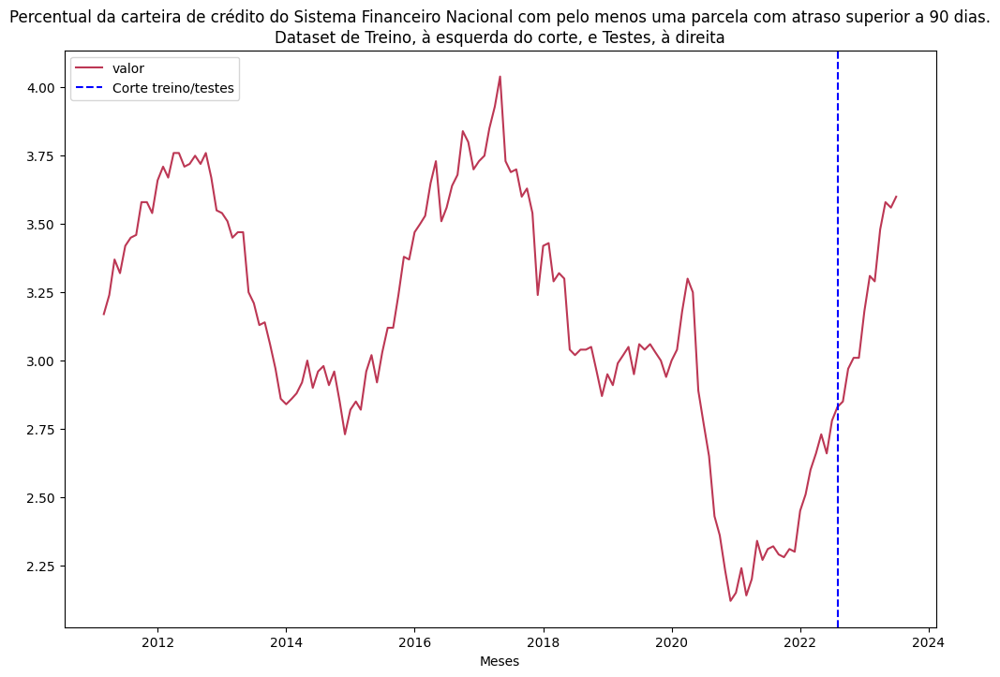

In [3]:
today = datetime.today()

# A base de testes serão os últimos 12 meses
meses_teste = 12
data_corte_treino = df.index[-meses_teste]
data_treino = df.loc[(df.index < data_corte_treino)]
data_teste = df.loc[(df.index >= data_corte_treino)]

print('Data Inicial Treino: ', data_treino.index.min())
print('Data Final   Treino: ', data_treino.index.max())
print('Tamanho      Treino: ', len(data_treino))
print('')

print('Data Inicial Teste: ', data_teste.index.min())
print('Data Final   Teste: ', data_teste.index.max())
print('Tamanho      Teste: ', len(data_teste))

fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
sns.lineplot(data=df, palette='inferno', ax=ax)
plt.axvline(x=data_corte_treino, color='blue', linestyle='--', label='Corte treino/testes', )
ax.set_xlabel('Meses')
ax.set_title('Percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias.\nDataset de Treino, à esquerda do corte, e Testes, à direita')
# ax.set_ylim([0, 80])
plt.legend()

## 3) Pré Processamento
- função preprocess_rnn: usada para transformação da série em subseries de treinamento

In [4]:
def preprocess(dataset, feature, timesteps, TesteLen):
# Função utilizada para transformação da série em subseries:
#
# 1. Uma sequência para treinamento do tamanho Batch Size;
# 2. Um ponto de observação para a sequência de treinamento

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = df_scal
    X_samples = list()
    y_samples = list()

    NumerOfRows = len(X)
    for i in range(int(timesteps) , NumerOfRows , 1):
        x_sample = X[i-timesteps:i]
        y_sample = X[i]
        X_samples.append(x_sample)
        y_samples.append(y_sample)

    X_data=np.array(X_samples)
    X_data=X_data.reshape(X_data.shape[0],X_data.shape[1], 1)

    y_data=np.array(y_samples)
    y_data=y_data.reshape(y_data.shape[0], 1)

    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train=X_data[:-TesteLen]
      X_test=X_data[-TesteLen:]
      y_train=y_data[:-TesteLen]
      y_test=y_data[-TesteLen:]
    else:
      X_train=X_data
      X_test=[]
      y_train=y_data
      y_test=[]
    return scaler, X_train, X_test, y_train, y_test


def preprocess_CNN1D(dataset, feature, TesteLen):

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = np.array(df_scal)
    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train = X[:-TesteLen]
      X_test = X[-TesteLen:]
    else:
      X_train = X_train
      X_test = []

    y_train, y_test = X_train, X_test
    X_train = X_train.reshape(X_train.shape[0], 1, 1)
    X_test = X_test.reshape(X_test.shape[0], 1, 1)

    return scaler, X_train, X_test, y_train, y_test

Exemplo de transformação do dataset, utilizando sequência de 10 observações por batch, separando os ultimos len(data_teste) registros como base de testes



In [5]:
timesteps = 6
print('RNN data\n')
scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

print('\n\nCNN1D data\n')
scaler, X_train, X_test, y_train, y_test = preprocess_CNN1D(df, feature, len(data_teste))
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

RNN data

[[0.05950369]
 [0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]] -- [0.70068934]
[[0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]
 [0.70068934]] -- [0.96600754]


CNN1D data

(137, 1, 1) (12, 1, 1) (137, 1) (12, 1)
[[0.05950369]] -- [0.05950369]
[[0.21427264]] -- [0.21427264]


## 4) Construção dos modelos RNN

Para desenvolvimento do projeto foram testados os modelos LSTM e GRU abaixo.

O modelo GRU foi testada uma arquitetura simples, enquanto que os LSTMS foram avaliadas arquiteturas com regularização e dropouts para evitar o overfitting e curvas tendenciosas ao usar o modelo iterativamente

In [6]:
def GRU_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

  mod = Sequential()
  mod.add(GRU(unit, input_shape=(timesteps, 1)))
  mod.add(Dense(1, activation='linear'))
  return mod


def LSTM_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v2(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v3(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, dropout_rate=0.3, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dropout(dropout_rate))
    mod.add(Dense(1, activation='linear'))
    return mod


def model_type(mod_type, unit, optimizer, timesteps, X, y, epochs=60, batch_size=32, patience=5, train=True):
  func = globals()[mod_type]
  mod = func(unit, optimizer, timesteps, X, y, epochs, batch_size, patience)
  hist = None
  if train:
    mod, hist = train_model(mod, optimizer, X, y, batch_size, patience, epochs)
  return mod, hist


def train_model(mod, optimizer, X, y, batch_size, patience, epochs):

  callback = tf.keras.callbacks.EarlyStopping(monitor='val_mean_absolute_error', patience=patience, mode='min',
                                              restore_best_weights=True)

  # only Adam implemented
  if optimizer == 'Adam':
    adam = tf.keras.optimizers.Adam()
    mod.compile(loss=tf.losses.MeanSquaredError(),optimizer=adam, metrics=[tf.metrics.MeanAbsoluteError()])

  hist = mod.fit(X, y, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback], verbose=0,
                  shuffle=False)

  loss_metric_train = mod.evaluate(X, y, verbose=0, batch_size=batch_size, use_multiprocessing=True)
  dsp.display( 'TRAINING set. Loss = {} , MAE = {}'.format(loss_metric_train[0], loss_metric_train[1]))

  plt.figure(figsize=(3,3))
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.plot(hist.history['loss'], label='Loss Treino')
  plt.plot(hist.history['val_loss'], label='Loss Validação')
  plt.plot(hist.history['mean_absolute_error'], label='MAE Treino')
  plt.ylim([0.0, 2])
  plt.xlim([0.0, epochs])
  plt.legend()
  plt.show()

  return mod, hist

### Treinamento e Hiperparâmetrização

A metodologia de escolha de melhor modelo consiste em variar modelos e parâmetros das RNNs e testar na base de testes. Os treinamentos serão executados 3 vezes para cada combinanação, e uma média sobre o MAE será feita. A melhor combinação de modelos e parâmetros, em razão da média calculada, determinará o melhor modelo.

Parâmetros variados

1. Modelos
2. Timesteps (tamanho da subséries de treinamento): será de semestres, anuais e bianuais, para encontrar padrões das sazonalidades
3. Numéro de Neurônios nas camadas ocultas
4. Batch size


X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


'TRAINING set. Loss = 0.047703348100185394 , MAE = 0.16660189628601074'

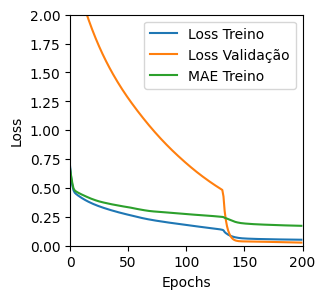

Tempo de treino: 1.4528631528218587 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19082005321979523 , MAE = 0.3190177083015442'

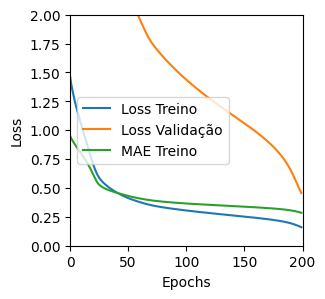

Tempo de treino: 0.3466686010360718 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16127420961856842 , MAE = 0.28978049755096436'

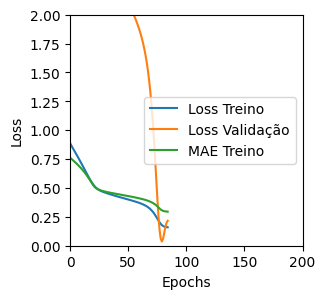

Tempo de treino: 0.20271856387456258 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14786125719547272 , MAE = 0.2947641611099243'

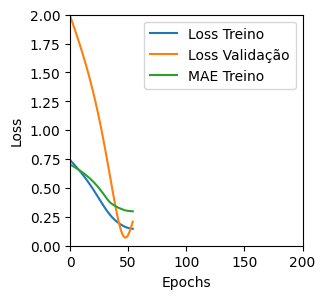

Tempo de treino: 0.07637691100438436 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12467390298843384 , MAE = 0.26848679780960083'

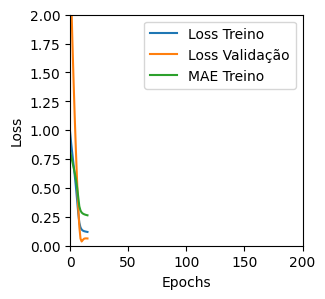

Tempo de treino: 0.11752994457880656 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14536800980567932 , MAE = 0.28996074199676514'

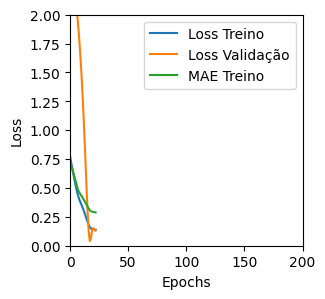

Tempo de treino: 0.06964863538742065 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14456911385059357 , MAE = 0.2791616916656494'

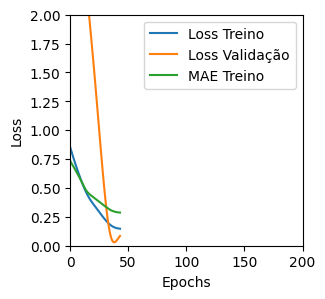

Tempo de treino: 0.1255100965499878 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1185457780957222 , MAE = 0.2598715126514435'

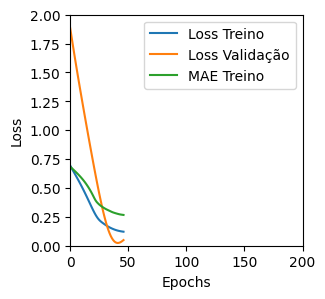

Tempo de treino: 0.07135089635848998 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1618036925792694 , MAE = 0.3096158504486084'

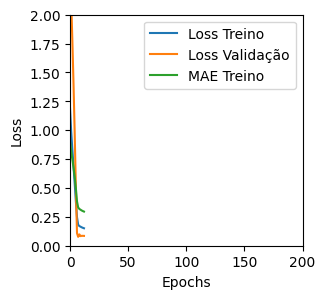

Tempo de treino: 0.07839794953664143 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6010485887527466 , MAE = 0.5891005396842957'

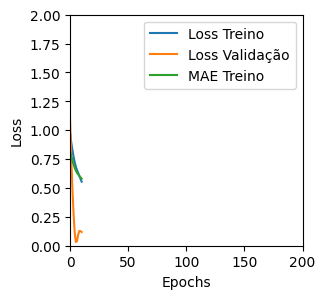

Tempo de treino: 0.05565799474716186 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14194735884666443 , MAE = 0.28357020020484924'

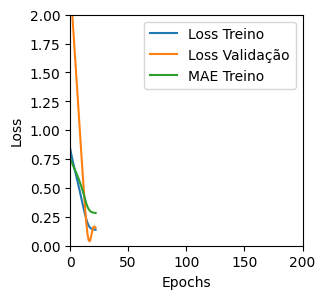

Tempo de treino: 0.07451977332433064 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16931208968162537 , MAE = 0.3165837526321411'

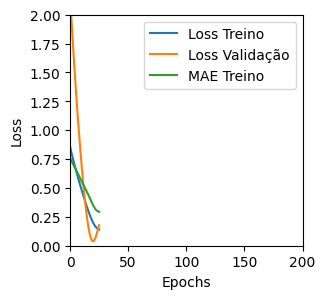

Tempo de treino: 0.0610573132832845 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1341954618692398 , MAE = 0.27784428000450134'

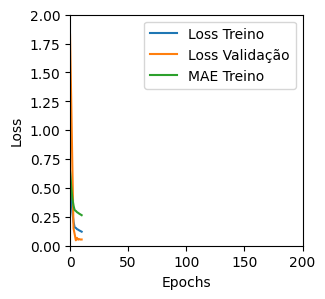

Tempo de treino: 0.09740315278371176 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1554354876279831 , MAE = 0.30211785435676575'

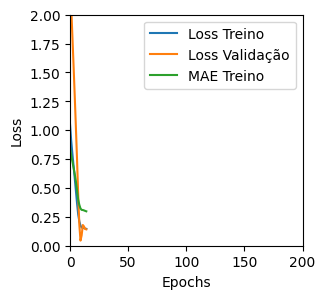

Tempo de treino: 0.07552262147267659 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1977395862340927 , MAE = 0.34643444418907166'

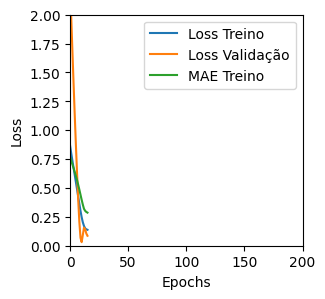

Tempo de treino: 0.08140101432800292 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1404101550579071 , MAE = 0.2844342589378357'

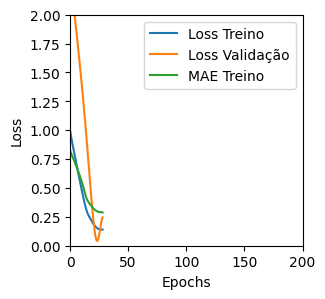

Tempo de treino: 0.058206077416737875 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14365124702453613 , MAE = 0.2824876010417938'

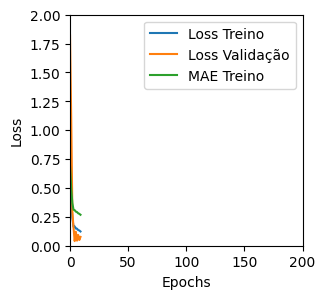

Tempo de treino: 0.06840339104334513 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14324817061424255 , MAE = 0.2911211848258972'

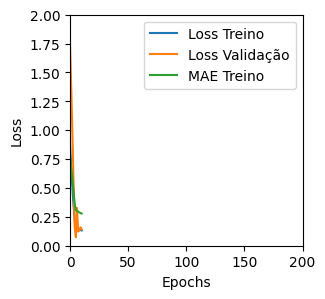

Tempo de treino: 0.0902889609336853 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16066083312034607 , MAE = 0.30348604917526245'

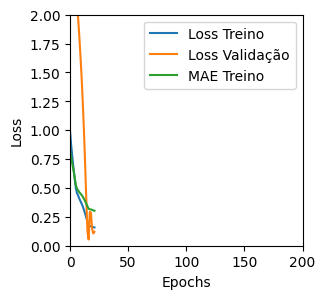

Tempo de treino: 0.07444577217102051 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14729073643684387 , MAE = 0.2951306402683258'

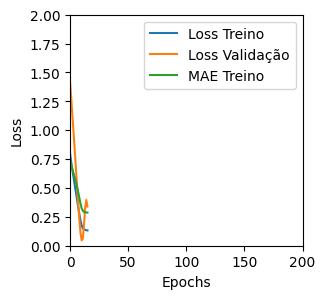

Tempo de treino: 0.0711797555287679 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09976481646299362 , MAE = 0.2273750603199005'

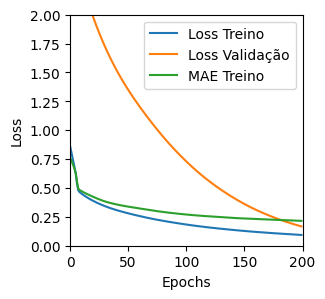

Tempo de treino: 0.5468223214149475 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5346121788024902 , MAE = 0.5564849972724915'

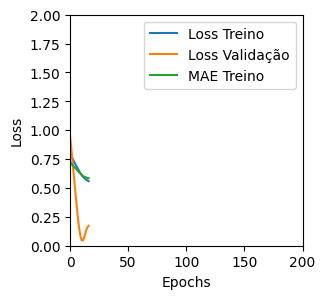

Tempo de treino: 0.07927923997243246 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1130904108285904 , MAE = 0.2652449607849121'

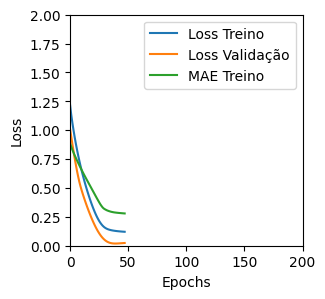

Tempo de treino: 0.12791436910629272 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.4753799438476562 , MAE = 1.0099903345108032'

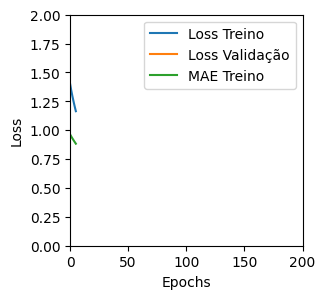

Tempo de treino: 0.04164677460988363 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12321380525827408 , MAE = 0.2684125602245331'

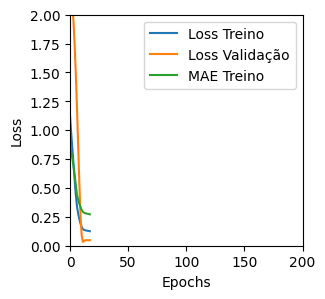

Tempo de treino: 0.09053575992584229 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13113269209861755 , MAE = 0.27714571356773376'

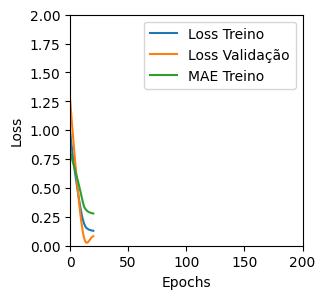

Tempo de treino: 0.06612061262130738 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1388489454984665 , MAE = 0.2811484634876251'

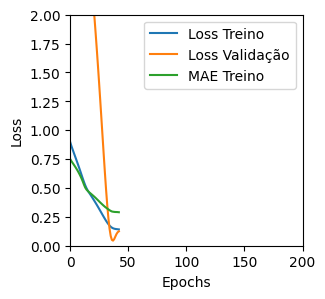

Tempo de treino: 0.1112569769223531 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2531798481941223 , MAE = 0.3940928280353546'

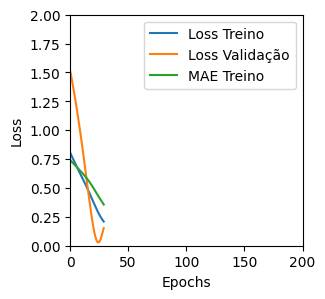

Tempo de treino: 0.06493020057678223 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06095452234148979 , MAE = 0.1956387162208557'

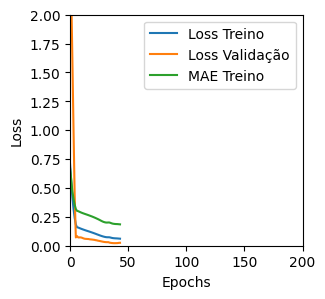

Tempo de treino: 0.1527158816655477 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15809810161590576 , MAE = 0.3045477271080017'

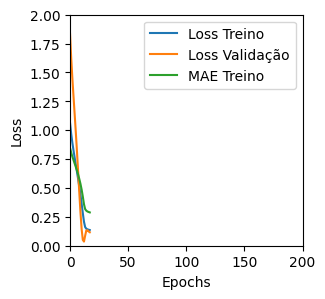

Tempo de treino: 0.06492854754130045 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15796047449111938 , MAE = 0.29763561487197876'

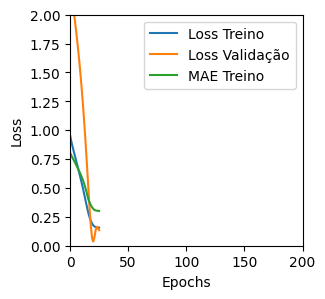

Tempo de treino: 0.07508859634399415 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16282345354557037 , MAE = 0.3021272122859955'

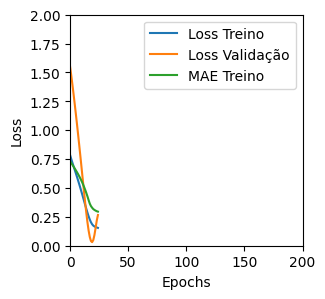

Tempo de treino: 0.08057262897491455 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14173322916030884 , MAE = 0.28274813294410706'

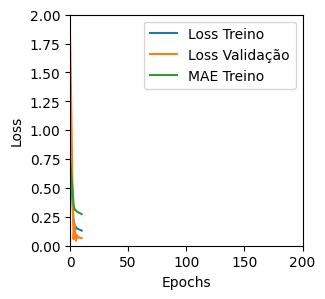

Tempo de treino: 0.08328025341033936 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13623206317424774 , MAE = 0.27589792013168335'

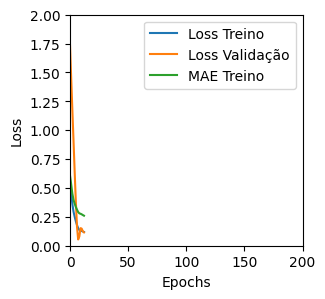

Tempo de treino: 0.05875724156697591 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15783555805683136 , MAE = 0.3035910725593567'

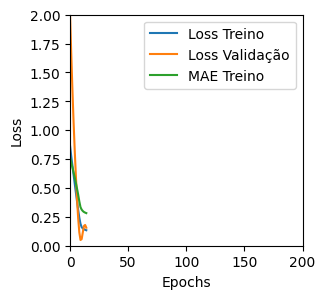

Tempo de treino: 0.0692108949025472 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1340421885251999 , MAE = 0.27494576573371887'

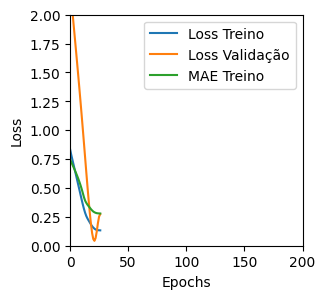

Tempo de treino: 0.05749487082163493 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13038122653961182 , MAE = 0.26994776725769043'

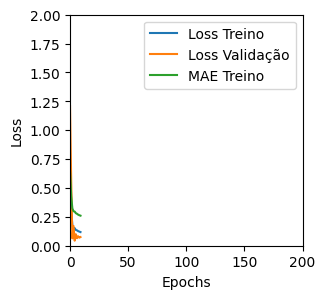

Tempo de treino: 0.07646113634109497 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14707279205322266 , MAE = 0.2920834422111511'

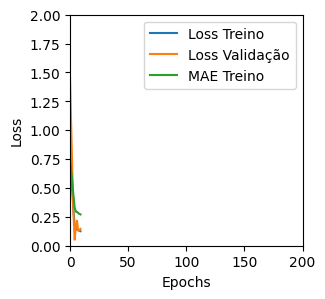

Tempo de treino: 0.08814388910929362 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1643305867910385 , MAE = 0.3058389127254486'

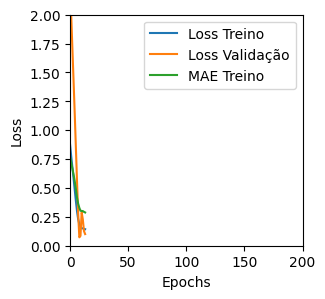

Tempo de treino: 0.051427956422170004 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15457238256931305 , MAE = 0.29489192366600037'

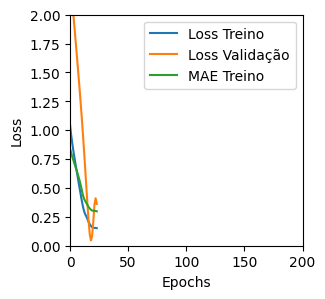

Tempo de treino: 0.09621020555496215 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19630253314971924 , MAE = 0.3495744466781616'

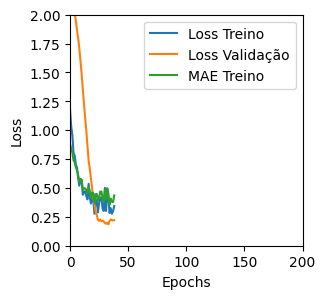

Tempo de treino: 0.22203785578409832 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49474748969078064 , MAE = 0.539355456829071'

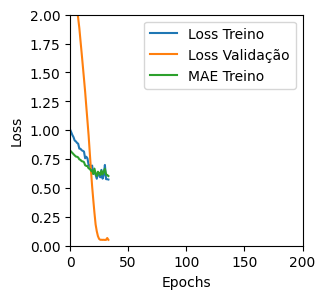

Tempo de treino: 0.11914174556732178 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7105886340141296 , MAE = 0.6534474492073059'

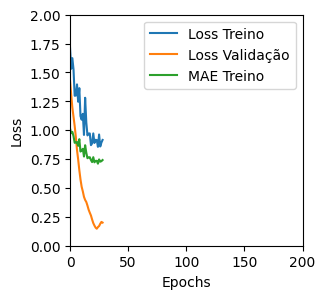

Tempo de treino: 0.12384724219640096 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15672637522220612 , MAE = 0.30308282375335693'

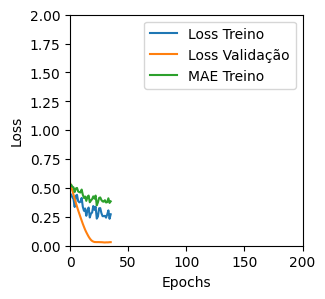

Tempo de treino: 0.06608535846074422 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16481317579746246 , MAE = 0.3064897656440735'

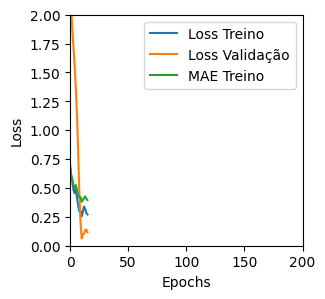

Tempo de treino: 0.08559852838516235 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4142076373100281 , MAE = 0.4929240047931671'

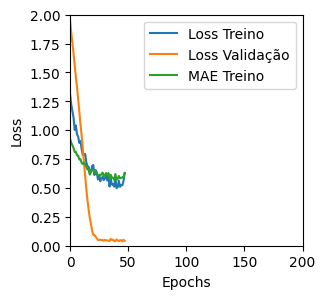

Tempo de treino: 0.11862634817759196 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2653646469116211 , MAE = 0.3974289894104004'

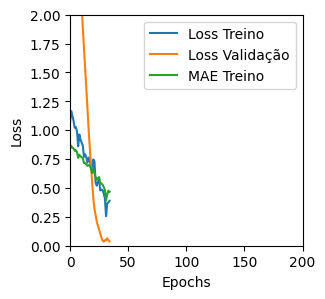

Tempo de treino: 0.1234262506167094 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17391206324100494 , MAE = 0.3140013515949249'

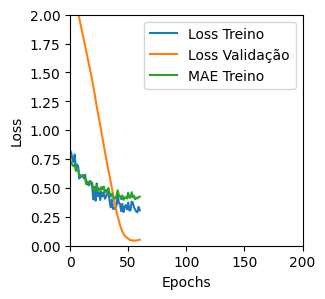

Tempo de treino: 0.12026313145955404 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15852230787277222 , MAE = 0.2996188700199127'

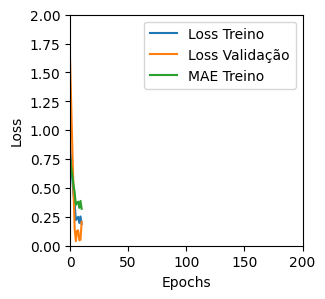

Tempo de treino: 0.07712421417236329 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13139013946056366 , MAE = 0.27361130714416504'

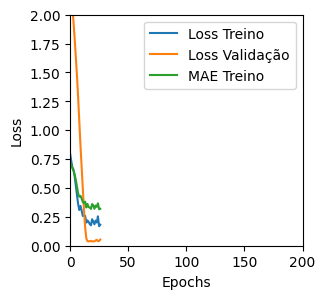

Tempo de treino: 0.11921403010686239 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12607377767562866 , MAE = 0.27069196105003357'

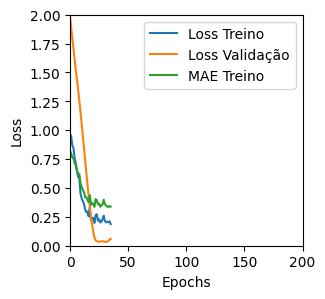

Tempo de treino: 0.12942483027776083 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14269383251667023 , MAE = 0.28725793957710266'

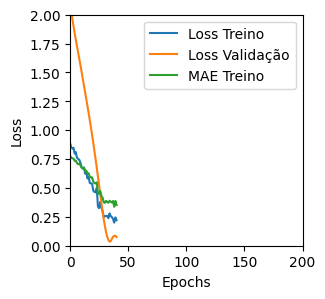

Tempo de treino: 0.07585482994715373 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13802209496498108 , MAE = 0.2837495505809784'

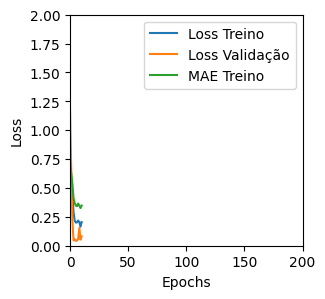

Tempo de treino: 0.09526802698771158 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14578649401664734 , MAE = 0.2837454080581665'

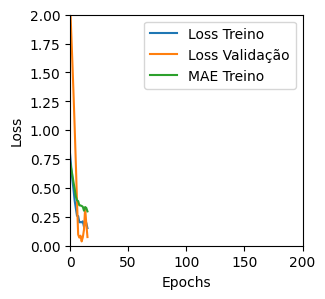

Tempo de treino: 0.06613934437433878 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14274607598781586 , MAE = 0.2841445803642273'

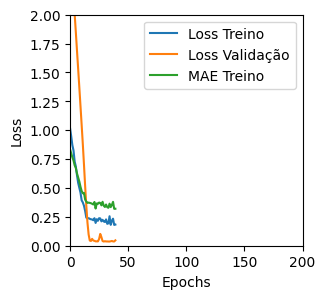

Tempo de treino: 0.09581041733423869 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14153443276882172 , MAE = 0.27832698822021484'

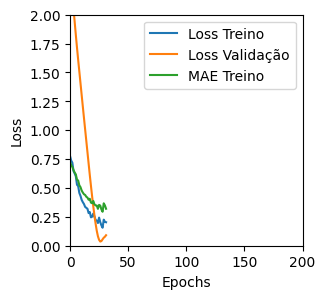

Tempo de treino: 0.06396769682566325 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12541909515857697 , MAE = 0.2682191729545593'

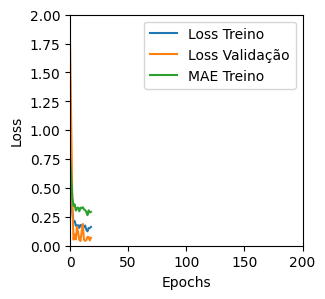

Tempo de treino: 0.08742847442626953 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1559504121541977 , MAE = 0.2967986762523651'

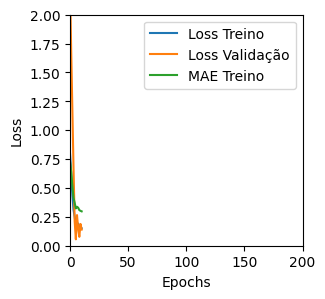

Tempo de treino: 0.08799442847569784 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14819468557834625 , MAE = 0.28791362047195435'

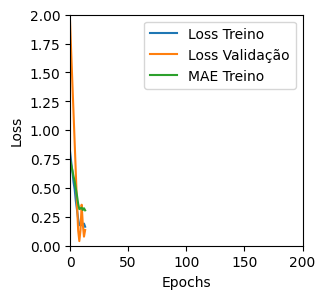

Tempo de treino: 0.06673767964045206 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1499522477388382 , MAE = 0.2942728102207184'

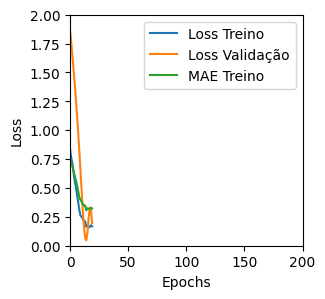

Tempo de treino: 0.08153127431869507 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04532144218683243 , MAE = 0.16504313051700592'

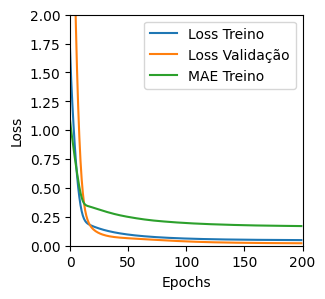

Tempo de treino: 0.6093464334805806 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04656326025724411 , MAE = 0.16684336960315704'

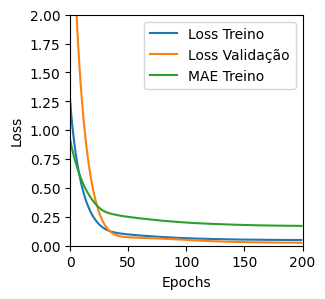

Tempo de treino: 0.4082738002141317 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06236080080270767 , MAE = 0.19465188682079315'

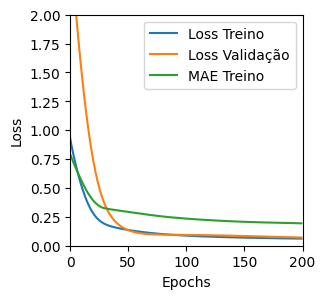

Tempo de treino: 0.3963886022567749 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06179286167025566 , MAE = 0.19769449532032013'

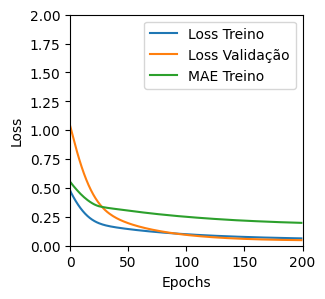

Tempo de treino: 0.2597249945004781 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043852414935827255 , MAE = 0.16043131053447723'

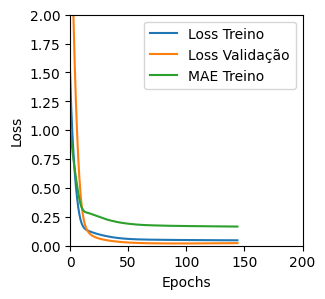

Tempo de treino: 0.4675852060317993 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0437166690826416 , MAE = 0.15965628623962402'

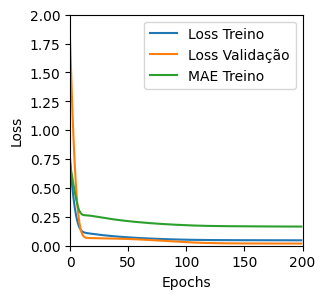

Tempo de treino: 0.4067517558733622 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045742426067590714 , MAE = 0.16508132219314575'

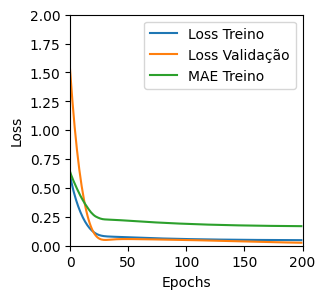

Tempo de treino: 0.38479297161102294 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11251100152730942 , MAE = 0.270364373922348'

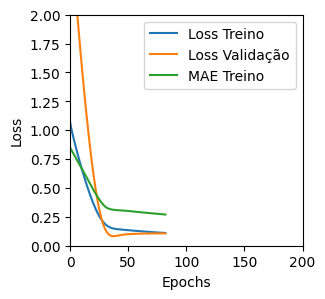

Tempo de treino: 0.2312548597653707 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046963319182395935 , MAE = 0.1666213423013687'

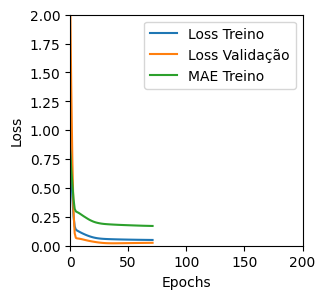

Tempo de treino: 0.25992090702056886 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04438372328877449 , MAE = 0.16187340021133423'

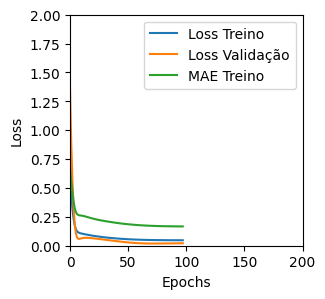

Tempo de treino: 0.3856853127479553 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1260620653629303 , MAE = 0.2891225814819336'

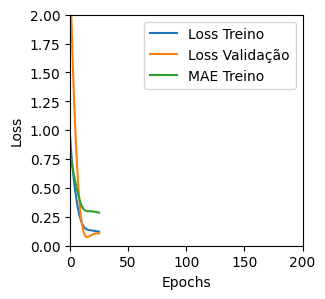

Tempo de treino: 0.08312122821807862 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04683030769228935 , MAE = 0.16924063861370087'

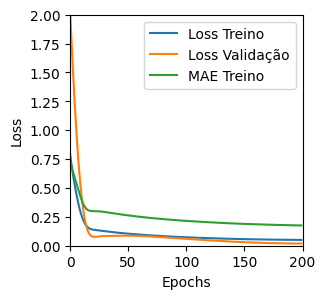

Tempo de treino: 0.2833531459172567 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04843920096755028 , MAE = 0.1700064092874527'

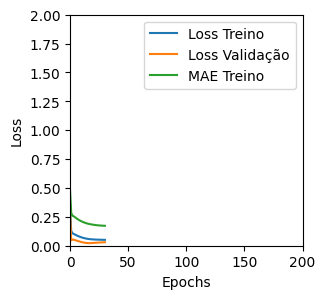

Tempo de treino: 0.14711055755615235 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11094485968351364 , MAE = 0.258642315864563'

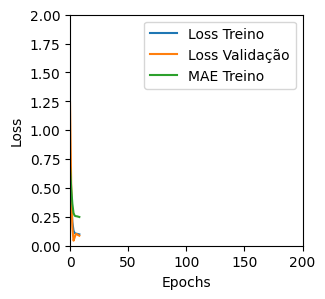

Tempo de treino: 0.09385084708531698 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13827960193157196 , MAE = 0.2967221438884735'

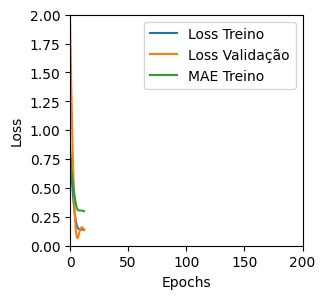

Tempo de treino: 0.08512471119562785 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11268950998783112 , MAE = 0.2642519176006317'

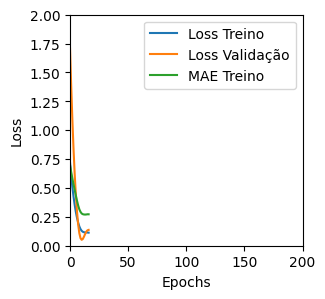

Tempo de treino: 0.11271153688430786 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05445892736315727 , MAE = 0.181870236992836'

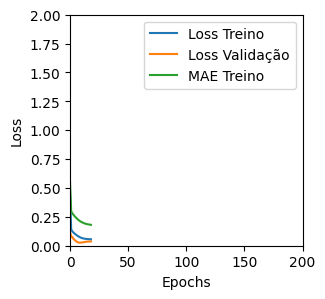

Tempo de treino: 0.1241958220799764 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1569841206073761 , MAE = 0.306824266910553'

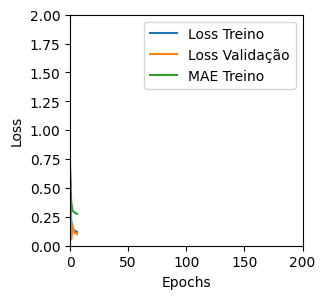

Tempo de treino: 0.09265143076578776 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14147156476974487 , MAE = 0.2939850986003876'

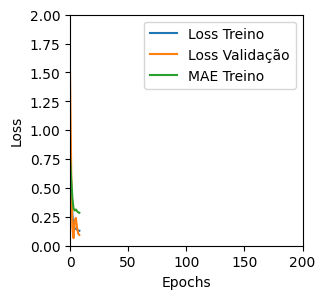

Tempo de treino: 0.0671497941017151 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13536126911640167 , MAE = 0.287553071975708'

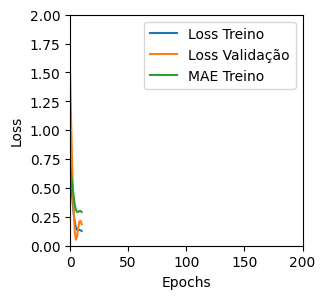

Tempo de treino: 0.07986188729604085 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2253877818584442 , MAE = 0.3557984232902527'

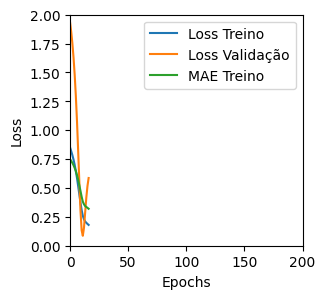

Tempo de treino: 0.13441034158070883 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40866944193840027 , MAE = 0.49237585067749023'

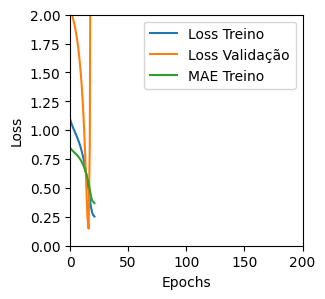

Tempo de treino: 0.12043340603510538 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2106340527534485 , MAE = 0.33840319514274597'

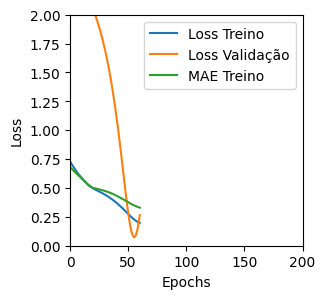

Tempo de treino: 0.09117784897486368 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5739574432373047 , MAE = 0.5763140916824341'

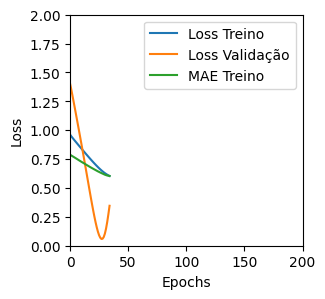

Tempo de treino: 0.089141050974528 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.290053129196167 , MAE = 0.39801278710365295'

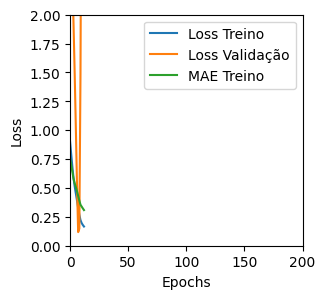

Tempo de treino: 0.06302333275477091 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2488173246383667 , MAE = 0.3621031641960144'

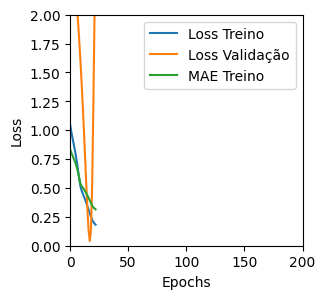

Tempo de treino: 0.08723444143931071 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4313002824783325 , MAE = 0.5127192139625549'

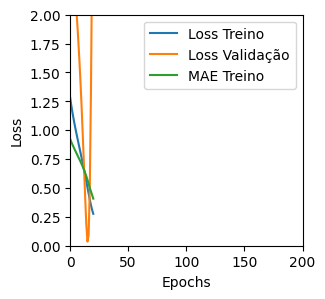

Tempo de treino: 0.07446800072987875 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2814077138900757 , MAE = 0.40829867124557495'

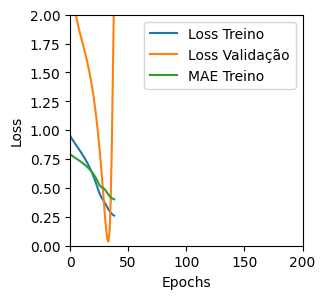

Tempo de treino: 0.06975653171539306 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7092226147651672 , MAE = 0.6518936157226562'

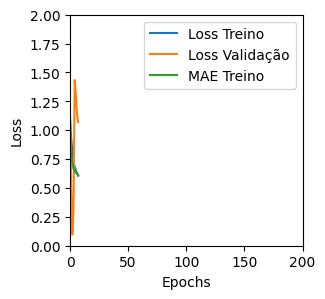

Tempo de treino: 0.0880645195643107 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21300095319747925 , MAE = 0.3465007543563843'

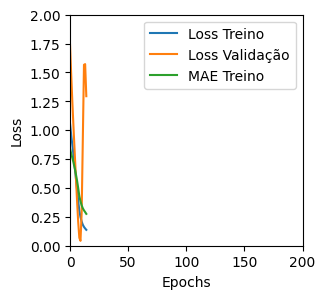

Tempo de treino: 0.058104419708251955 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7277594208717346 , MAE = 0.6472293138504028'

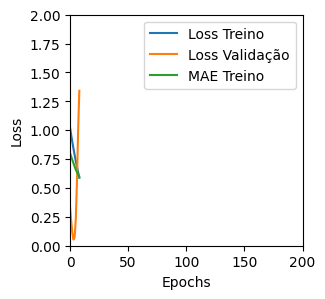

Tempo de treino: 0.04207197825113932 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24813330173492432 , MAE = 0.3618175685405731'

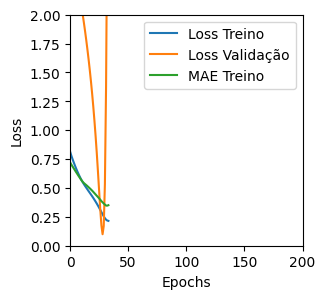

Tempo de treino: 0.11916471322377523 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23051336407661438 , MAE = 0.36414915323257446'

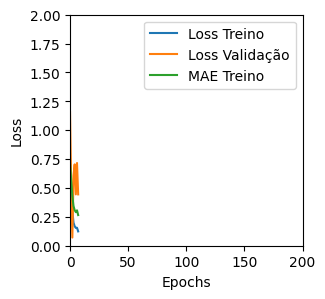

Tempo de treino: 0.0537114421526591 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40853169560432434 , MAE = 0.4979352653026581'

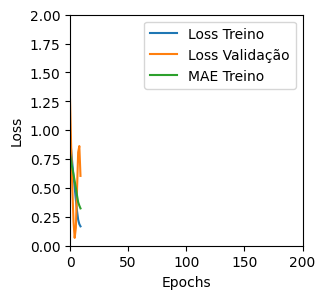

Tempo de treino: 0.07113151947657267 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2651609778404236 , MAE = 0.37582844495773315'

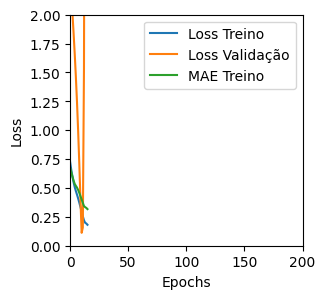

Tempo de treino: 0.08008338610331217 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2809688448905945 , MAE = 0.4066471457481384'

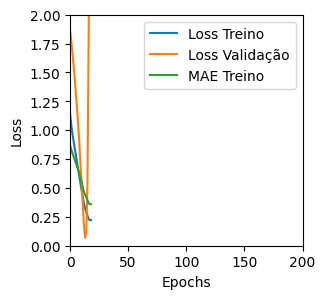

Tempo de treino: 0.07523101170857747 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


'TRAINING set. Loss = 0.3410847783088684 , MAE = 0.4572031497955322'

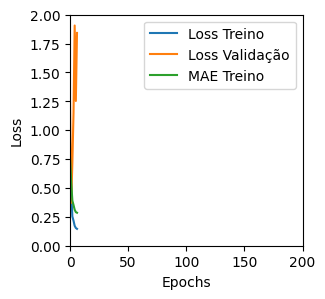

Tempo de treino: 0.06650295654932657 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2070712000131607 , MAE = 0.3329826891422272'

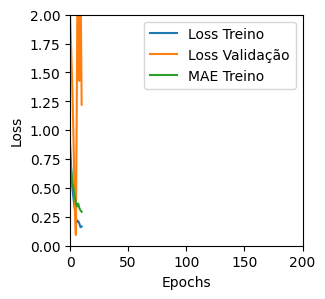

Tempo de treino: 0.05701064666112264 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27475908398628235 , MAE = 0.399630069732666'

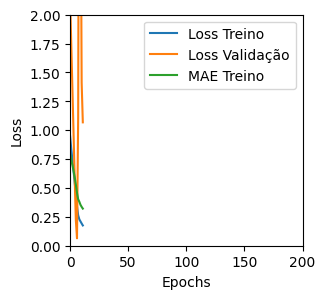

Tempo de treino: 0.04797486066818237 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20747321844100952 , MAE = 0.3359517455101013'

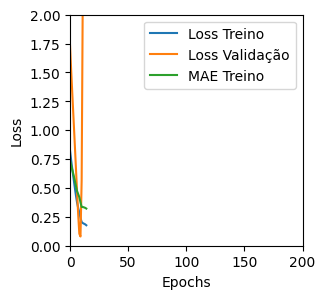

Tempo de treino: 0.05306888421376546 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2101871520280838 , MAE = 0.3447943329811096'

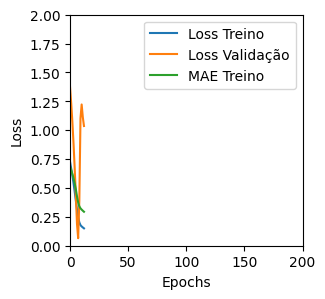

Tempo de treino: 0.07518677314122518 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.636718213558197 , MAE = 0.6196091771125793'

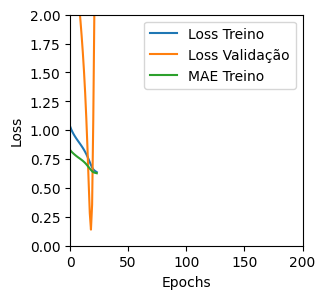

Tempo de treino: 0.07038814226786295 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6618454456329346 , MAE = 0.6395119428634644'

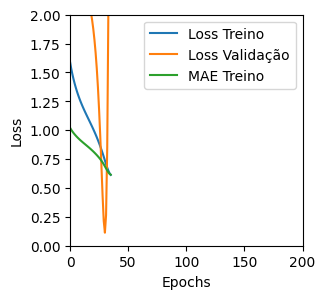

Tempo de treino: 0.06967468659083048 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3117114305496216 , MAE = 0.43045496940612793'

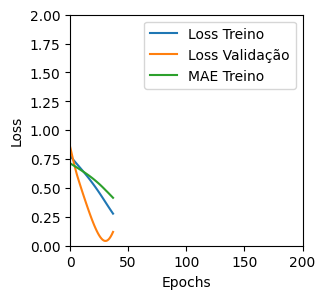

Tempo de treino: 0.10383929808934529 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2630908191204071 , MAE = 0.39393916726112366'

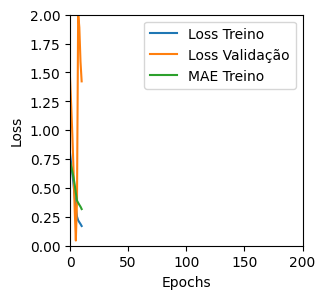

Tempo de treino: 0.05940654675165812 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2152496576309204 , MAE = 0.3552027642726898'

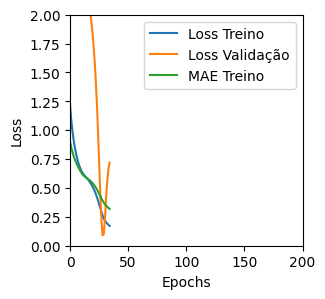

Tempo de treino: 0.09777090946833293 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21685448288917542 , MAE = 0.31842488050460815'

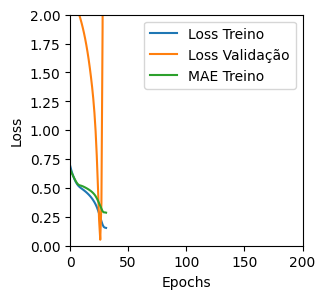

Tempo de treino: 0.06325396299362182 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4143109619617462 , MAE = 0.4939185380935669'

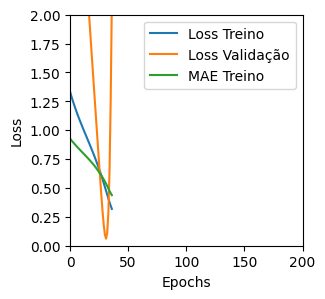

Tempo de treino: 0.07631047964096069 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31982341408729553 , MAE = 0.4422905743122101'

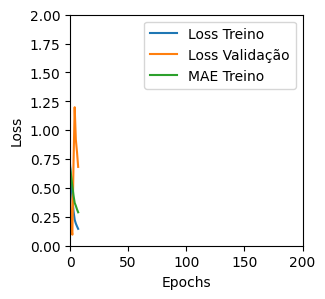

Tempo de treino: 0.0768125295639038 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39122438430786133 , MAE = 0.46870043873786926'

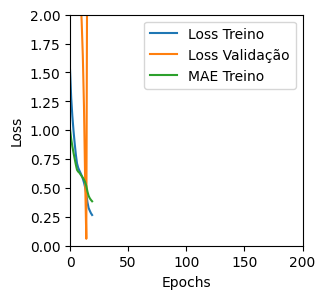

Tempo de treino: 0.0699030876159668 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20848985016345978 , MAE = 0.3284960389137268'

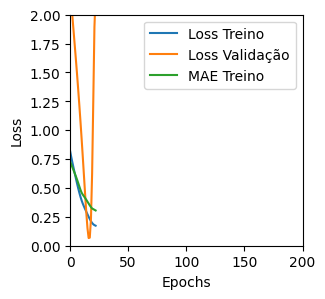

Tempo de treino: 0.11283480723698934 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21518555283546448 , MAE = 0.34467369318008423'

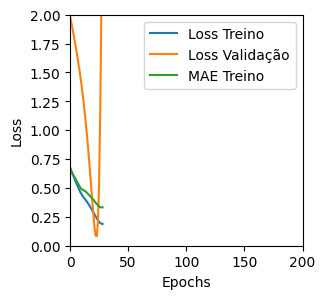

Tempo de treino: 0.07038871049880982 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2644614279270172 , MAE = 0.3883792757987976'

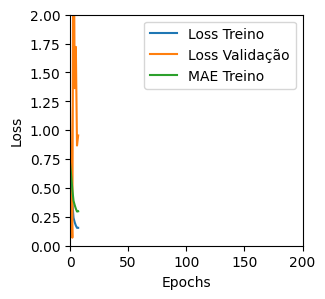

Tempo de treino: 0.053529600302378334 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2223827838897705 , MAE = 0.350465327501297'

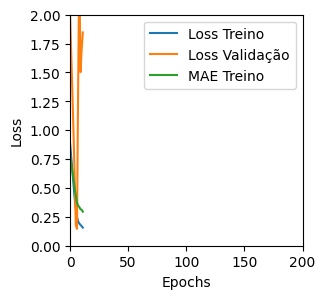

Tempo de treino: 0.06449430783589681 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24297434091567993 , MAE = 0.34635478258132935'

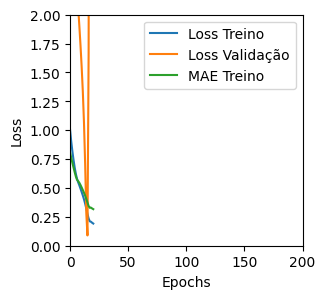

Tempo de treino: 0.05298783779144287 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21898041665554047 , MAE = 0.34943732619285583'

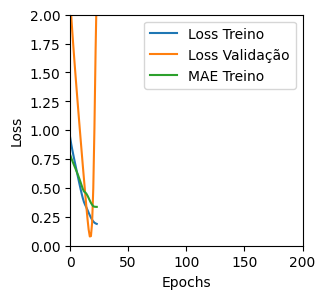

Tempo de treino: 0.07659931977589925 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30766478180885315 , MAE = 0.41241025924682617'

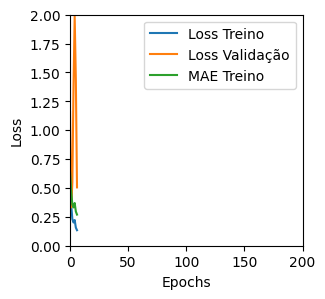

Tempo de treino: 0.06137338081995646 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3669433295726776 , MAE = 0.47161105275154114'

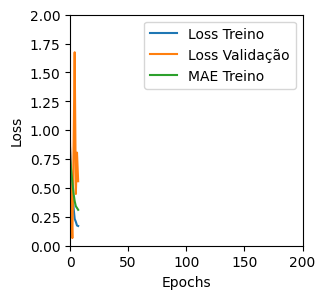

Tempo de treino: 0.05014406442642212 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23531857132911682 , MAE = 0.3701748847961426'

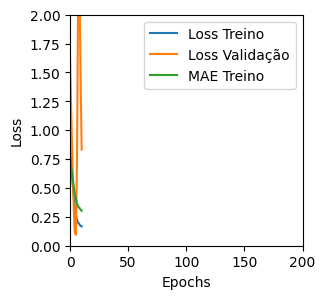

Tempo de treino: 0.09272231260935465 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24602322280406952 , MAE = 0.376449853181839'

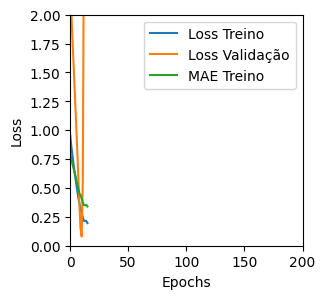

Tempo de treino: 0.07255632082621256 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1989906281232834 , MAE = 0.33640381693840027'

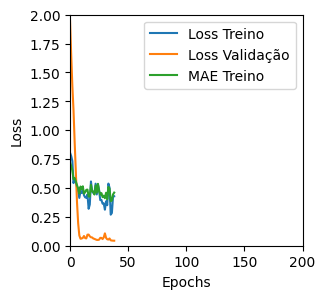

Tempo de treino: 0.12210116783777873 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6015926599502563 , MAE = 0.5982072353363037'

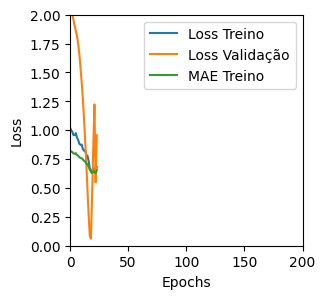

Tempo de treino: 0.11428592602411906 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5705929398536682 , MAE = 0.5703309178352356'

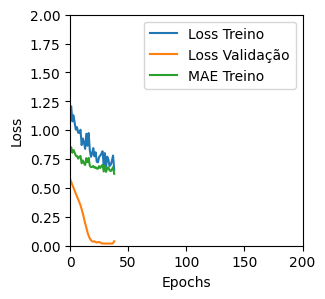

Tempo de treino: 0.06819469531377156 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5656769871711731 , MAE = 0.5427287817001343'

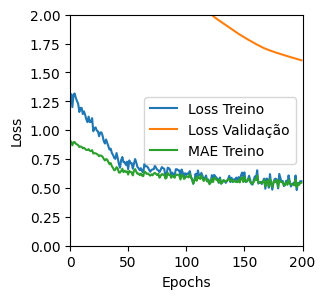

Tempo de treino: 0.223443341255188 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2266816645860672 , MAE = 0.3693677484989166'

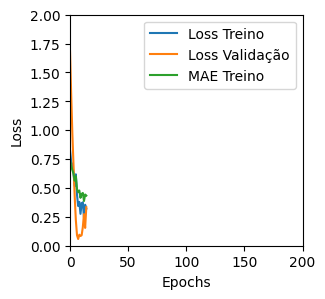

Tempo de treino: 0.11410428285598755 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2088560312986374 , MAE = 0.3294977843761444'

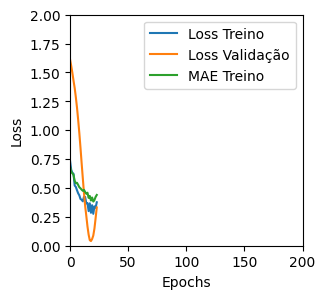

Tempo de treino: 0.08220696846644084 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20648954808712006 , MAE = 0.34351640939712524'

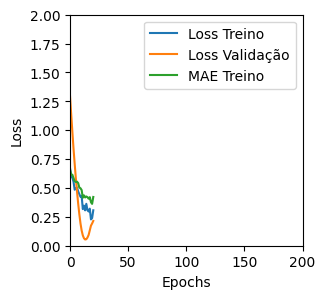

Tempo de treino: 0.06559483607610067 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28245922923088074 , MAE = 0.3901204764842987'

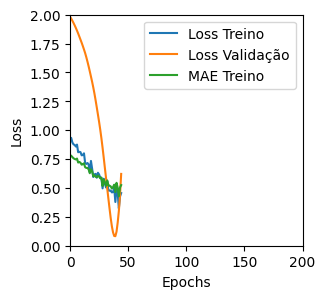

Tempo de treino: 0.0916053056716919 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3109508454799652 , MAE = 0.4323081374168396'

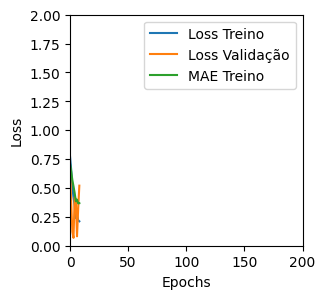

Tempo de treino: 0.07275952498118082 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.402584046125412 , MAE = 0.4955928325653076'

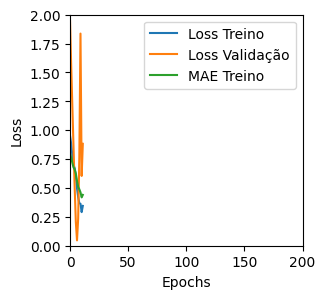

Tempo de treino: 0.06456547180811564 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20244939625263214 , MAE = 0.32755839824676514'

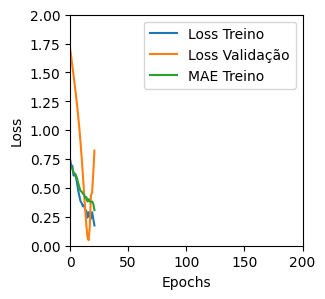

Tempo de treino: 0.055570534865061444 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1873665452003479 , MAE = 0.31787145137786865'

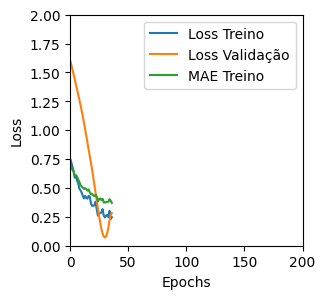

Tempo de treino: 0.07057048479715983 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15490858256816864 , MAE = 0.29096314311027527'

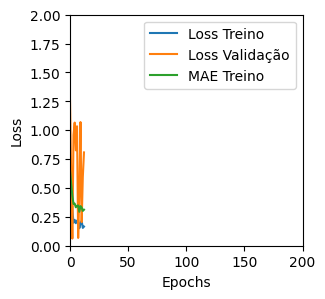

Tempo de treino: 0.11429946025212606 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24433152377605438 , MAE = 0.3582784831523895'

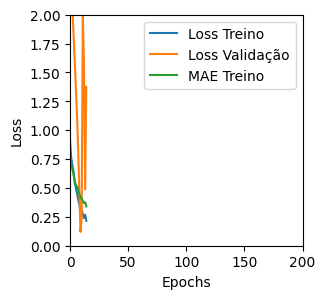

Tempo de treino: 0.08258343935012817 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4231359660625458 , MAE = 0.5025191903114319'

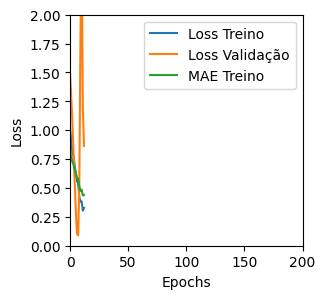

Tempo de treino: 0.05449522336324056 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4465319812297821 , MAE = 0.5155391097068787'

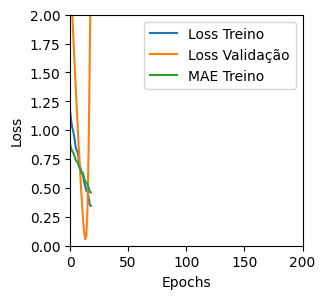

Tempo de treino: 0.0889006773630778 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2272496223449707 , MAE = 0.3626002073287964'

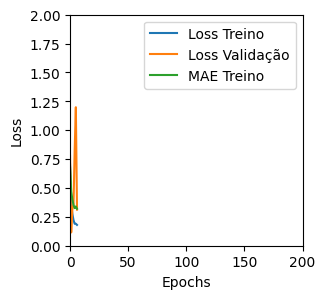

Tempo de treino: 0.07306223710378011 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27777934074401855 , MAE = 0.39972710609436035'

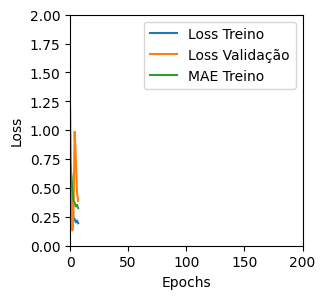

Tempo de treino: 0.07160725990931192 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3098592162132263 , MAE = 0.43338310718536377'

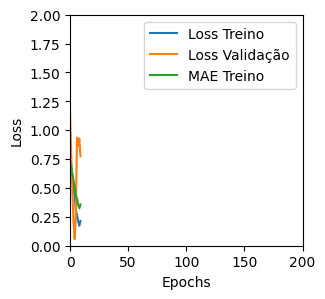

Tempo de treino: 0.04650814135869344 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21964110434055328 , MAE = 0.3486841320991516'

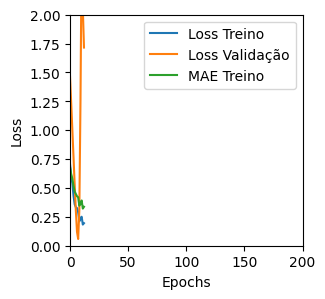

Tempo de treino: 0.05583800077438354 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05284835770726204 , MAE = 0.17790313065052032'

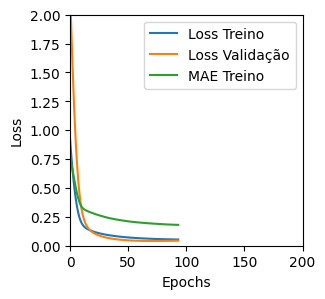

Tempo de treino: 0.3245964606602987 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044829707592725754 , MAE = 0.16220241785049438'

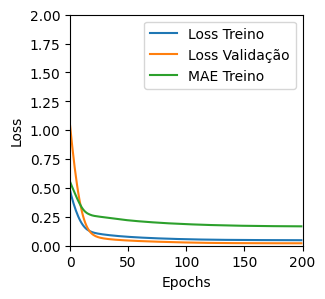

Tempo de treino: 0.38819138209025067 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05100707709789276 , MAE = 0.17993655800819397'

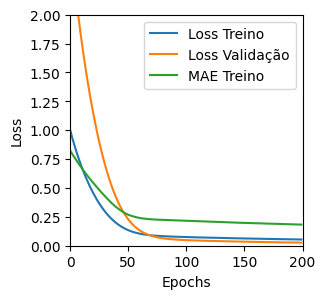

Tempo de treino: 0.2563068906466166 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1004546508193016 , MAE = 0.24624216556549072'

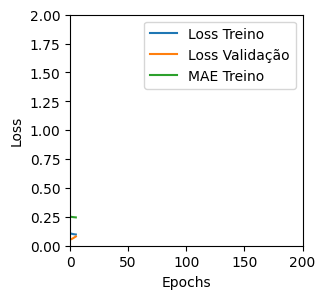

Tempo de treino: 0.06596622069676718 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042152781039476395 , MAE = 0.15734964609146118'

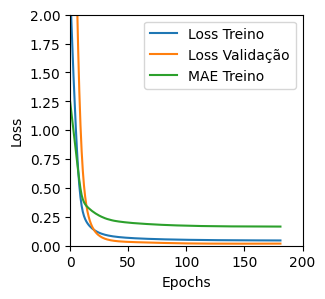

Tempo de treino: 0.49352861642837526 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049517080187797546 , MAE = 0.1737150102853775'

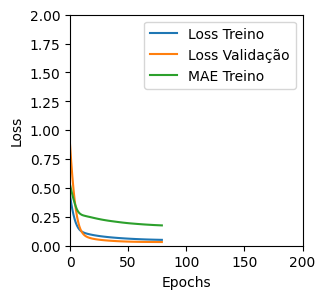

Tempo de treino: 0.21274495522181194 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05211774259805679 , MAE = 0.17755311727523804'

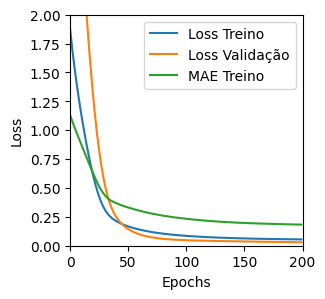

Tempo de treino: 0.38572509288787843 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1463060975074768 , MAE = 0.3061958849430084'

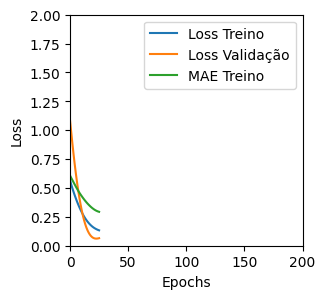

Tempo de treino: 0.1003013014793396 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.040306080132722855 , MAE = 0.1532285511493683'

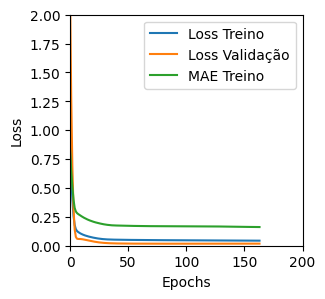

Tempo de treino: 0.4579085946083069 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042302876710891724 , MAE = 0.15671807527542114'

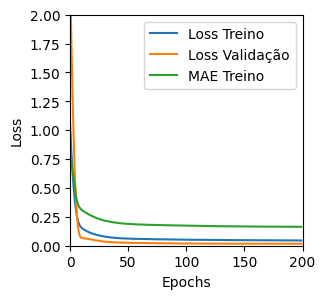

Tempo de treino: 0.35908097426096597 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045890823006629944 , MAE = 0.16319087147712708'

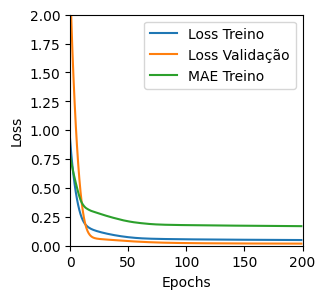

Tempo de treino: 0.3209796905517578 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19734595715999603 , MAE = 0.3637888729572296'

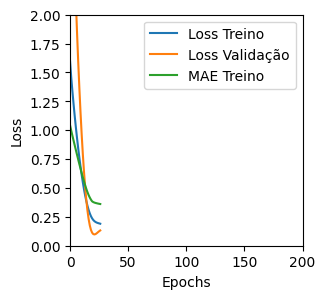

Tempo de treino: 0.10296763976414998 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04221007227897644 , MAE = 0.1557053029537201'

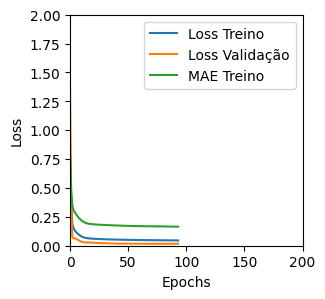

Tempo de treino: 0.3798608740170797 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04343726485967636 , MAE = 0.1587013155221939'

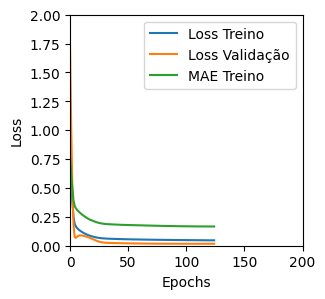

Tempo de treino: 0.25235210259755453 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11372775584459305 , MAE = 0.26526951789855957'

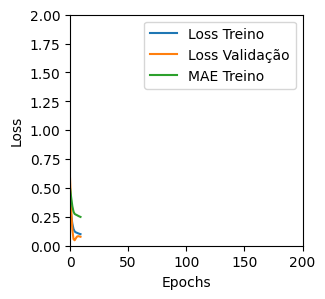

Tempo de treino: 0.057578206062316895 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12124229222536087 , MAE = 0.27299612760543823'

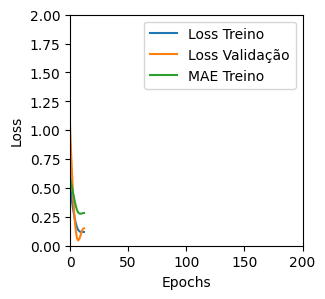

Tempo de treino: 0.11988760232925415 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04336472228169441 , MAE = 0.15733841061592102'

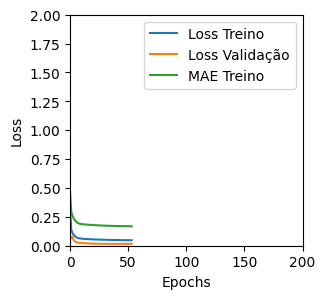

Tempo de treino: 0.21030041376749675 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03932427242398262 , MAE = 0.14892840385437012'

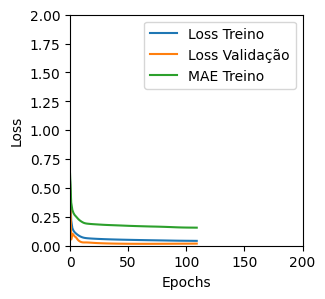

Tempo de treino: 0.379688024520874 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04357399791479111 , MAE = 0.15868614614009857'

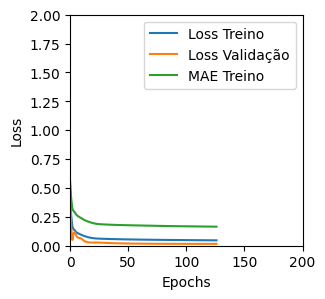

Tempo de treino: 0.19869574705759685 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18234281241893768 , MAE = 0.3370107412338257'

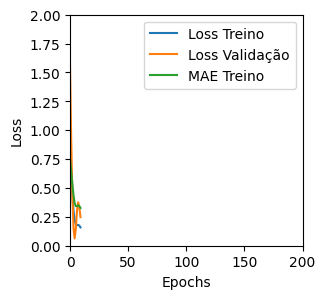

Tempo de treino: 0.06464242935180664 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6664494872093201 , MAE = 0.630526065826416'

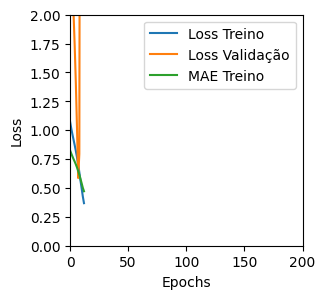

Tempo de treino: 0.1471457839012146 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3355266749858856 , MAE = 0.4433797597885132'

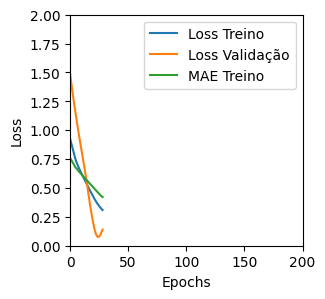

Tempo de treino: 0.11180830796559652 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.321463942527771 , MAE = 0.3659954369068146'

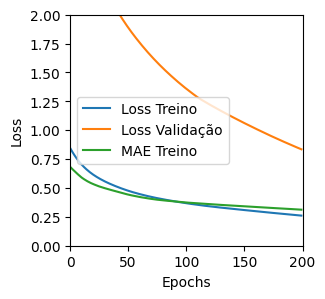

Tempo de treino: 0.7253768841425577 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8957936763763428 , MAE = 0.731587827205658'

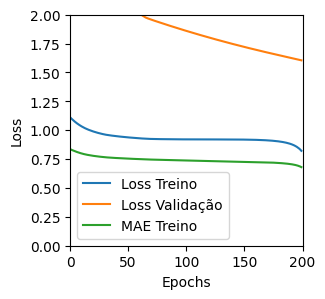

Tempo de treino: 0.27508872747421265 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5338449478149414 , MAE = 0.5743939280509949'

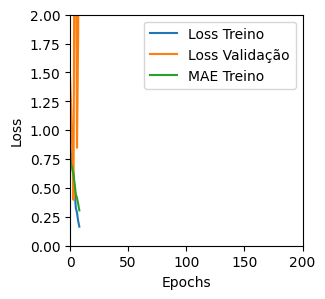

Tempo de treino: 0.12831817070643106 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46044108271598816 , MAE = 0.5113908648490906'

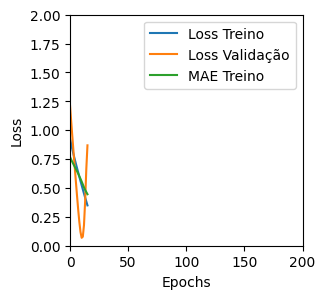

Tempo de treino: 0.07355340719223022 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2590950131416321 , MAE = 0.37540048360824585'

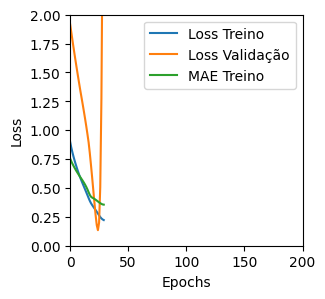

Tempo de treino: 0.13862097660700481 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23447737097740173 , MAE = 0.36062395572662354'

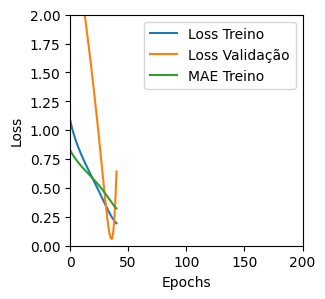

Tempo de treino: 0.12567325035730997 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48956847190856934 , MAE = 0.541012167930603'

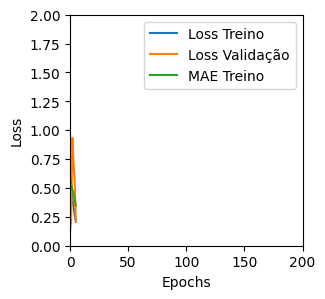

Tempo de treino: 0.08518618742624919 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3411731421947479 , MAE = 0.41905128955841064'

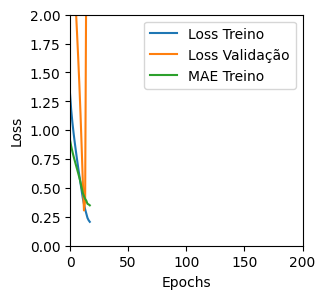

Tempo de treino: 0.09094456831614177 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18785588443279266 , MAE = 0.3075779974460602'

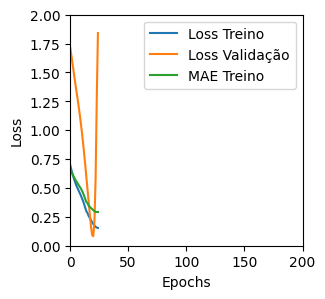

Tempo de treino: 0.12633437315622967 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6656351685523987 , MAE = 0.6327707171440125'

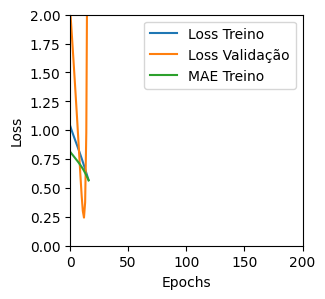

Tempo de treino: 0.07974316676457723 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4309975504875183 , MAE = 0.5130589008331299'

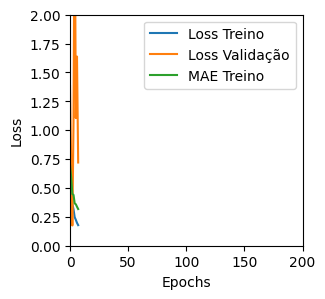

Tempo de treino: 0.08165420691172282 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3765122890472412 , MAE = 0.45805439352989197'

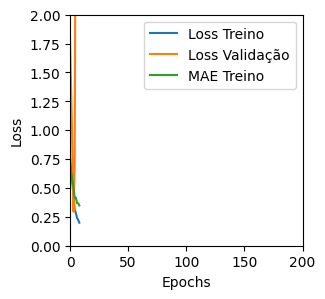

Tempo de treino: 0.09083507061004639 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35201817750930786 , MAE = 0.4476429522037506'

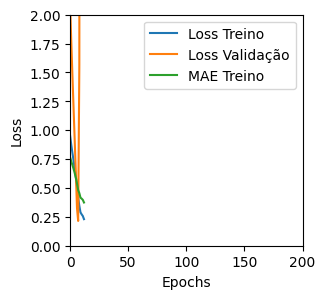

Tempo de treino: 0.09211072524388632 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3468586504459381 , MAE = 0.45158112049102783'

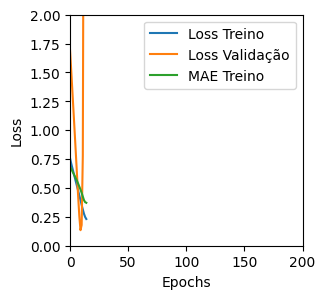

Tempo de treino: 0.07932116985321044 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25732851028442383 , MAE = 0.39611807465553284'

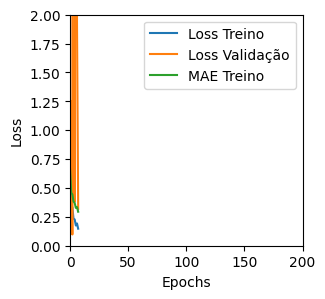

Tempo de treino: 0.12388196388880411 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34598278999328613 , MAE = 0.44529008865356445'

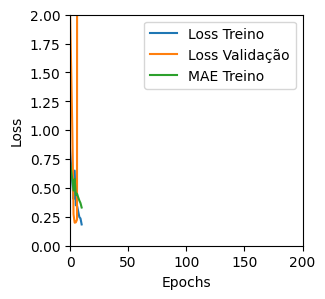

Tempo de treino: 0.076687753200531 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31673476099967957 , MAE = 0.43351098895072937'

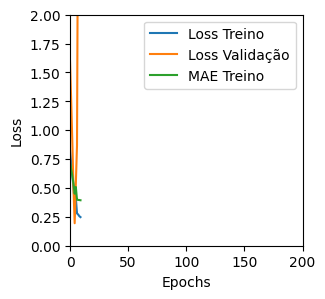

Tempo de treino: 0.07974555492401122 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3587762713432312 , MAE = 0.4450518786907196'

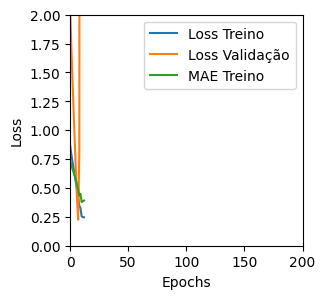

Tempo de treino: 0.07576368649800619 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17108209431171417 , MAE = 0.30777058005332947'

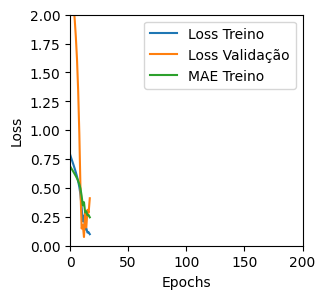

Tempo de treino: 0.23349287907282512 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34936201572418213 , MAE = 0.45668965578079224'

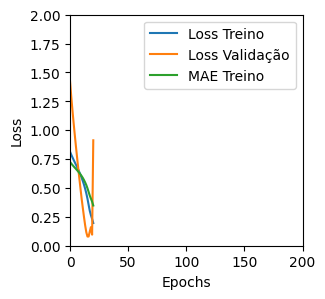

Tempo de treino: 0.12287166913350424 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.536152184009552 , MAE = 0.5530135035514832'

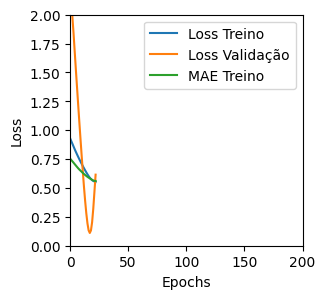

Tempo de treino: 0.07913539012273153 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7782260775566101 , MAE = 0.6928083896636963'

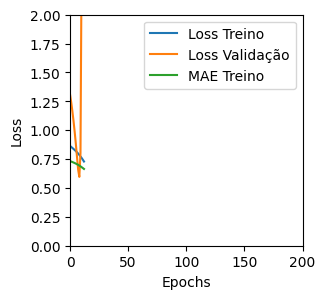

Tempo de treino: 0.05566453536351522 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6840513944625854 , MAE = 0.6277868151664734'

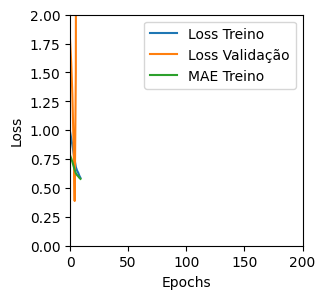

Tempo de treino: 0.0990467389424642 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35962122678756714 , MAE = 0.4582878649234772'

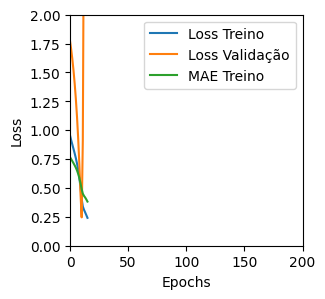

Tempo de treino: 0.0759343425432841 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6526153087615967 , MAE = 0.6043744087219238'

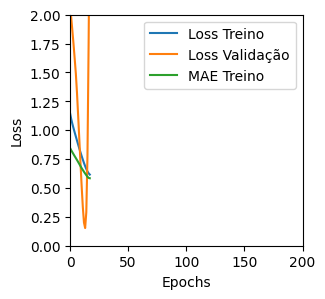

Tempo de treino: 0.11875813404719035 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4802839457988739 , MAE = 0.5401514172554016'

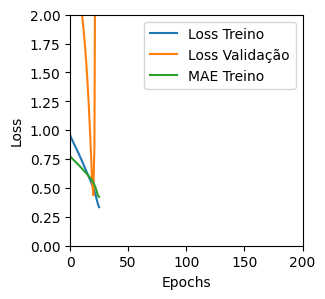

Tempo de treino: 0.09708335002263387 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5546039342880249 , MAE = 0.5825456380844116'

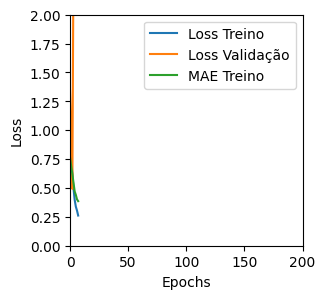

Tempo de treino: 0.1336201508839925 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3562810719013214 , MAE = 0.4425526559352875'

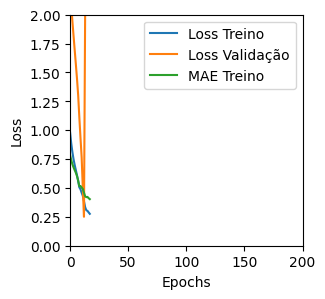

Tempo de treino: 0.08503153324127197 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22890397906303406 , MAE = 0.34582018852233887'

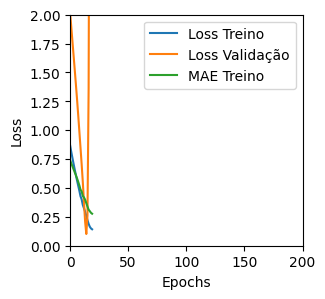

Tempo de treino: 0.0893846074740092 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4449431300163269 , MAE = 0.509638786315918'

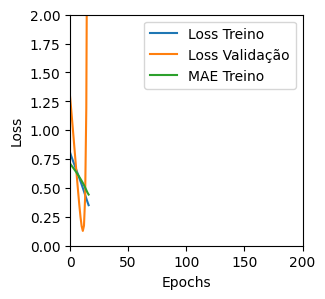

Tempo de treino: 0.057793561617533365 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34635287523269653 , MAE = 0.4207485020160675'

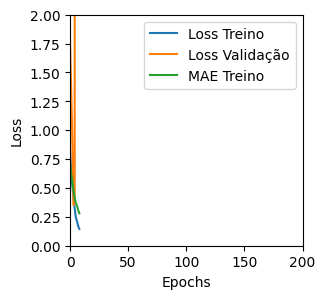

Tempo de treino: 0.12321763833363851 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5568547248840332 , MAE = 0.5660127401351929'

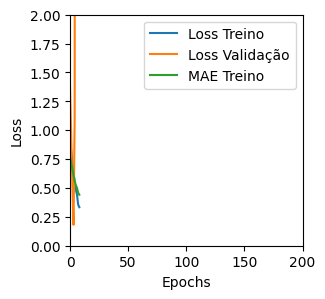

Tempo de treino: 0.076642640431722 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33632591366767883 , MAE = 0.42674118280410767'

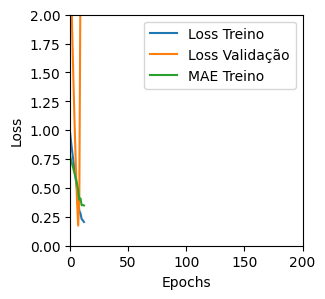

Tempo de treino: 0.10171797672907511 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3955642580986023 , MAE = 0.44570136070251465'

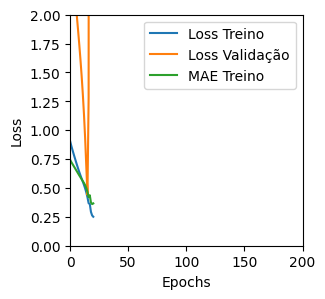

Tempo de treino: 0.0803484837214152 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30667728185653687 , MAE = 0.3975396156311035'

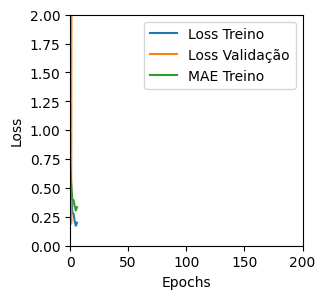

Tempo de treino: 0.08270240624745687 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.293751060962677 , MAE = 0.42494648694992065'

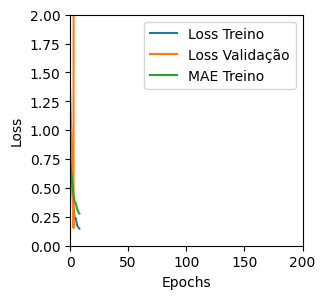

Tempo de treino: 0.08050753672917683 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31270936131477356 , MAE = 0.4036831259727478'

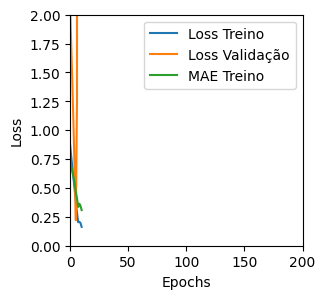

Tempo de treino: 0.07639867067337036 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.398612380027771 , MAE = 0.4853098392486572'

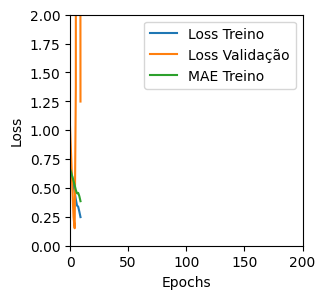

Tempo de treino: 0.055452263355255126 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


'TRAINING set. Loss = 0.568082332611084 , MAE = 0.5657590627670288'

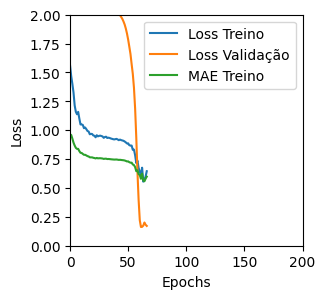

Tempo de treino: 0.39571069478988646 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21406513452529907 , MAE = 0.34357354044914246'

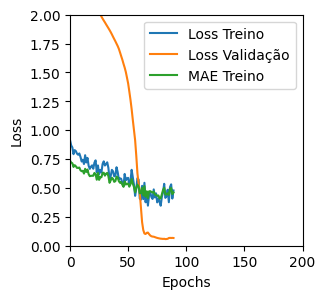

Tempo de treino: 0.31097413698832194 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5883020162582397 , MAE = 0.5911469459533691'

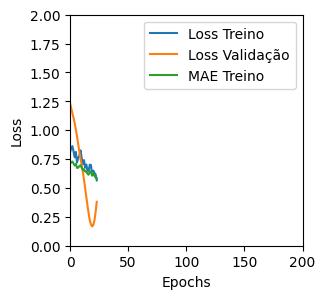

Tempo de treino: 0.08070656458536783 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.516221284866333 , MAE = 0.5407942533493042'

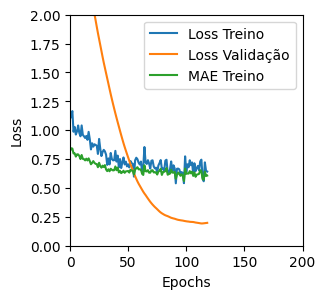

Tempo de treino: 0.20700389941533406 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33557263016700745 , MAE = 0.4351028800010681'

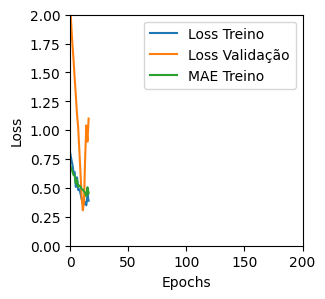

Tempo de treino: 0.21202386617660524 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4681982398033142 , MAE = 0.5216253995895386'

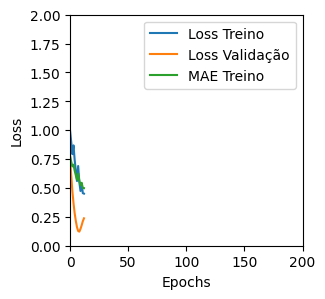

Tempo de treino: 0.11970878442128499 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7564329504966736 , MAE = 0.6697555780410767'

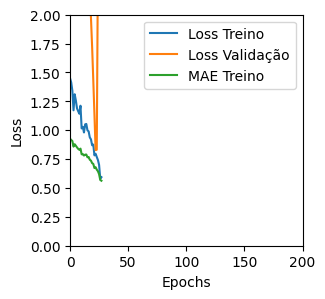

Tempo de treino: 0.11991081635157268 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7270877361297607 , MAE = 0.6574571132659912'

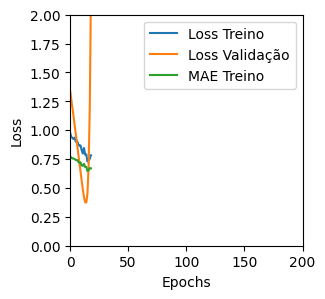

Tempo de treino: 0.10069918235143026 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1246655061841011 , MAE = 0.2574103772640228'

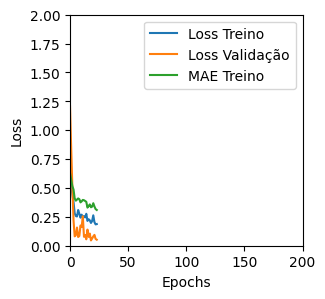

Tempo de treino: 0.21613220771153768 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4038533568382263 , MAE = 0.48171088099479675'

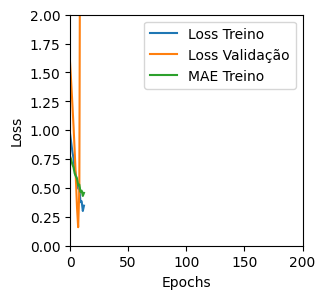

Tempo de treino: 0.07944915692011516 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5928083658218384 , MAE = 0.5920457243919373'

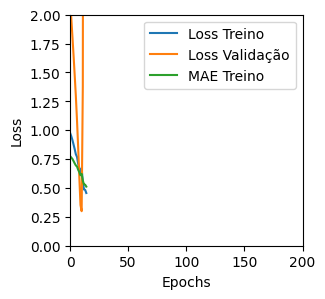

Tempo de treino: 0.08014164368311565 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2841753363609314 , MAE = 0.3993486166000366'

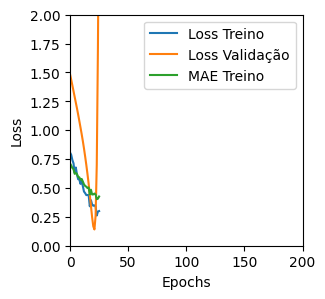

Tempo de treino: 0.07735650539398194 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32168325781822205 , MAE = 0.426936537027359'

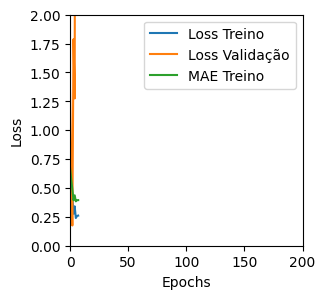

Tempo de treino: 0.08604198694229126 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3286356031894684 , MAE = 0.4326252341270447'

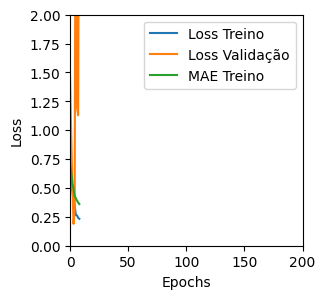

Tempo de treino: 0.11334263483683268 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5442559123039246 , MAE = 0.5657950639724731'

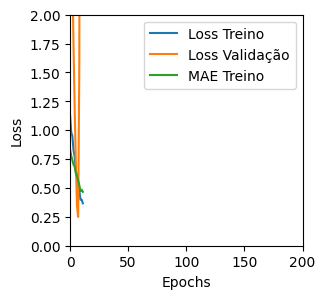

Tempo de treino: 0.08524507284164429 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5066138505935669 , MAE = 0.5390353202819824'

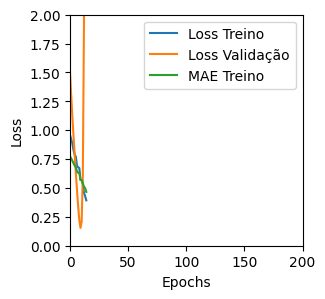

Tempo de treino: 0.0914375106493632 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19143255054950714 , MAE = 0.3180164694786072'

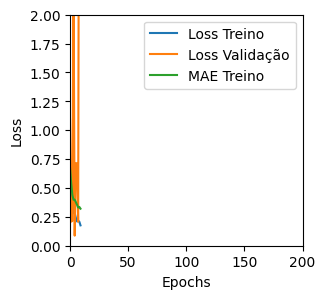

Tempo de treino: 0.09475230773289998 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31766843795776367 , MAE = 0.40018895268440247'

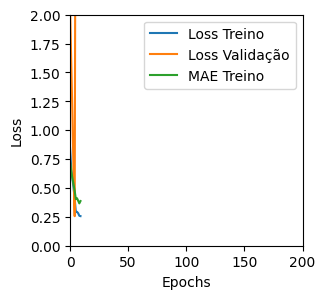

Tempo de treino: 0.08416265646616618 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29871684312820435 , MAE = 0.3968070447444916'

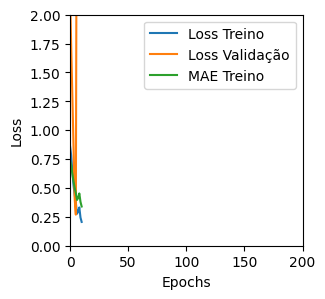

Tempo de treino: 0.07729068597157797 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3185948133468628 , MAE = 0.40541529655456543'

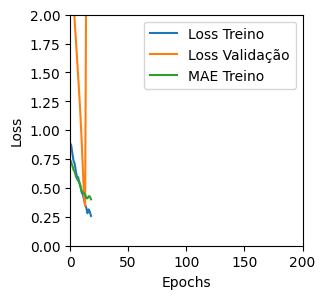

Tempo de treino: 0.09874141613642375 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045697249472141266 , MAE = 0.16521967947483063'

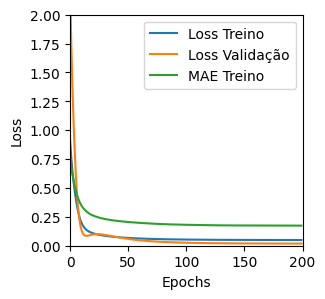

Tempo de treino: 1.4325991868972778 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05927904695272446 , MAE = 0.19183449447155'

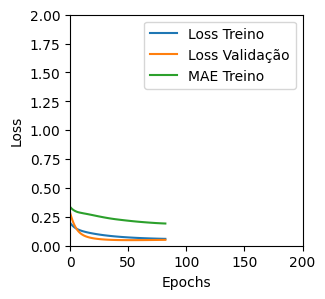

Tempo de treino: 0.31500366926193235 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13203389942646027 , MAE = 0.29075655341148376'

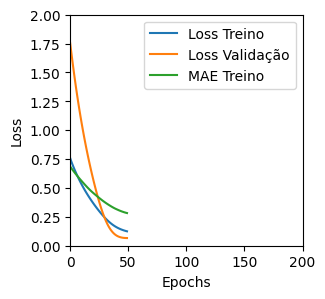

Tempo de treino: 0.15970875024795533 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13923189043998718 , MAE = 0.3086910545825958'

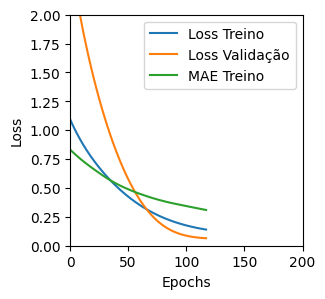

Tempo de treino: 0.2083516319592794 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04624973237514496 , MAE = 0.16589367389678955'

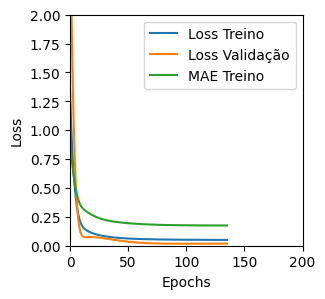

Tempo de treino: 1.4427101651827494 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14608652889728546 , MAE = 0.2995142936706543'

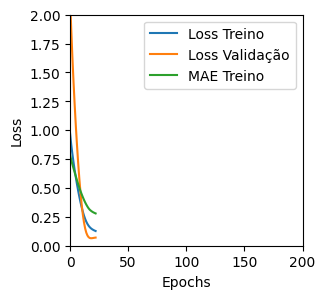

Tempo de treino: 0.14035263458887737 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06125278398394585 , MAE = 0.1921035498380661'

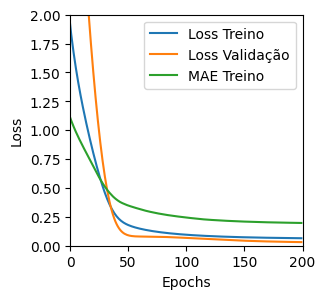

Tempo de treino: 0.7285389343897501 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13643021881580353 , MAE = 0.3010317385196686'

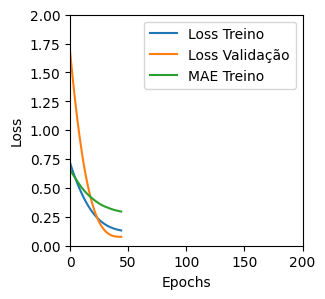

Tempo de treino: 0.14268640279769898 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04415695369243622 , MAE = 0.1626567393541336'

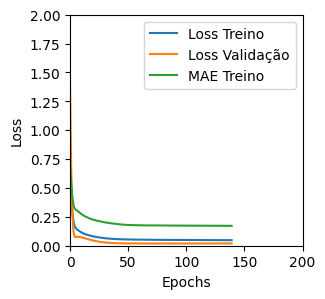

Tempo de treino: 0.9036612510681152 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04755955561995506 , MAE = 0.16802971065044403'

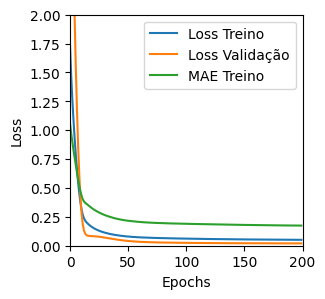

Tempo de treino: 0.7441746592521667 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12372393161058426 , MAE = 0.2758570611476898'

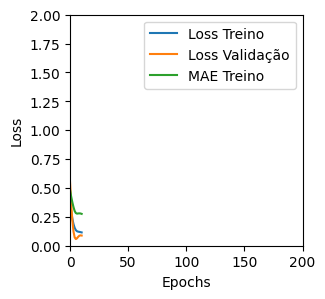

Tempo de treino: 0.07779359817504883 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1300479620695114 , MAE = 0.2831120789051056'

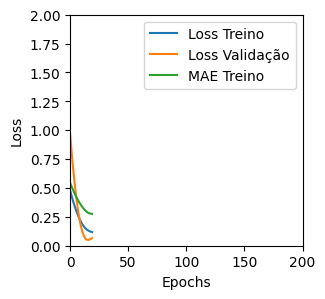

Tempo de treino: 0.10031303962071737 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046097282320261 , MAE = 0.16594412922859192'

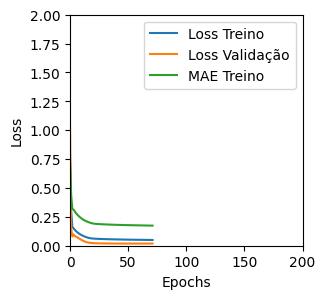

Tempo de treino: 0.7652647217114766 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04493805021047592 , MAE = 0.16314277052879333'

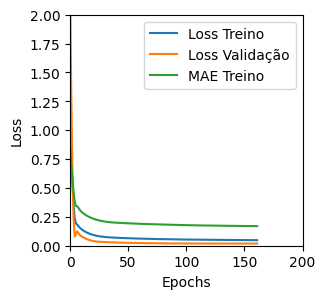

Tempo de treino: 0.7354024847348531 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10737423598766327 , MAE = 0.2544000446796417'

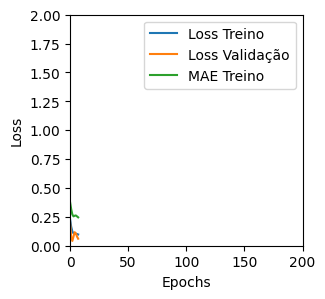

Tempo de treino: 0.0828994075457255 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18743358552455902 , MAE = 0.33971890807151794'

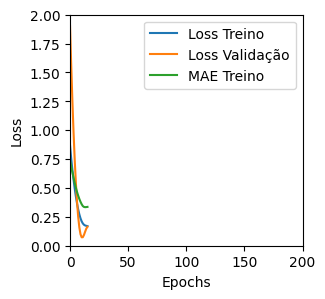

Tempo de treino: 0.08274378379185994 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04234364628791809 , MAE = 0.16014604270458221'

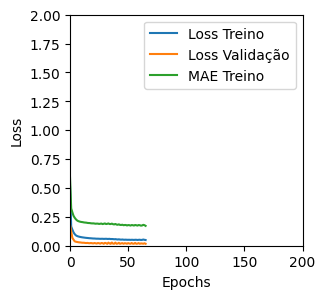

Tempo de treino: 0.455251407623291 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04883309453725815 , MAE = 0.16953901946544647'

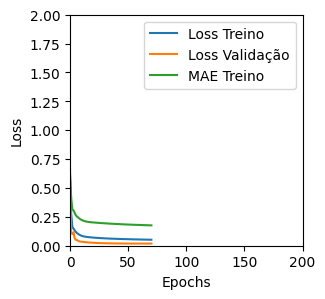

Tempo de treino: 0.33476506868998207 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.039859142154455185 , MAE = 0.15231209993362427'

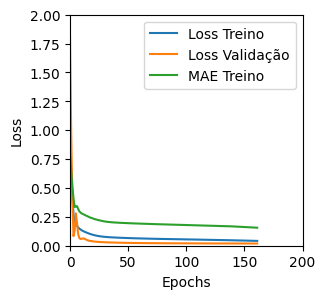

Tempo de treino: 0.41348254680633545 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21229659020900726 , MAE = 0.3575984239578247'

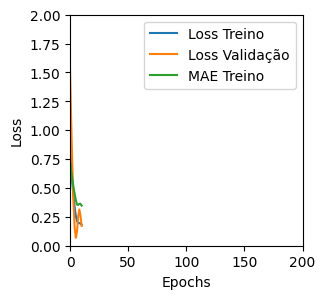

Tempo de treino: 0.08652931054433187 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4992118179798126 , MAE = 0.5208276510238647'

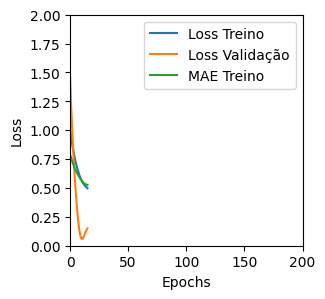

Tempo de treino: 0.20568513870239258 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.516514241695404 , MAE = 0.5615264773368835'

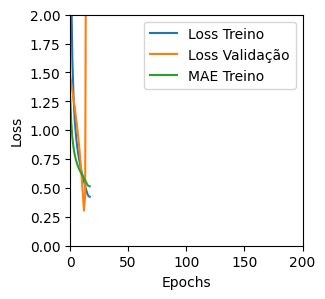

Tempo de treino: 0.10338784456253051 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4797712564468384 , MAE = 0.5187548398971558'

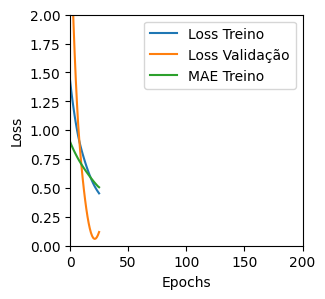

Tempo de treino: 0.13190449873606364 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6024976372718811 , MAE = 0.6220894455909729'

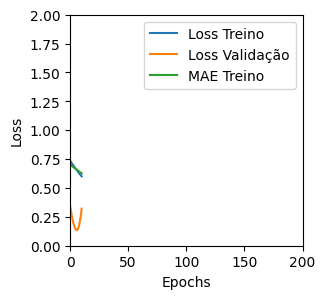

Tempo de treino: 0.06892343759536743 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48786547780036926 , MAE = 0.5287932753562927'

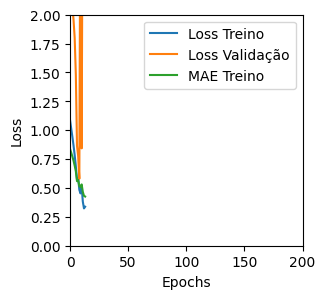

Tempo de treino: 0.11550793647766114 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43124207854270935 , MAE = 0.5121469497680664'

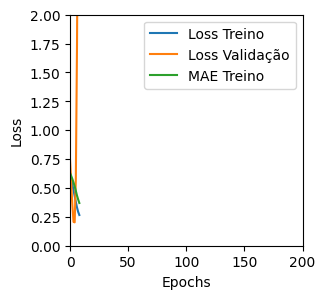

Tempo de treino: 0.07976280848185222 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48646673560142517 , MAE = 0.49843642115592957'

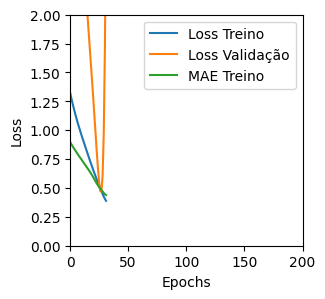

Tempo de treino: 0.09736106793085735 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4693431258201599 , MAE = 0.4833521842956543'

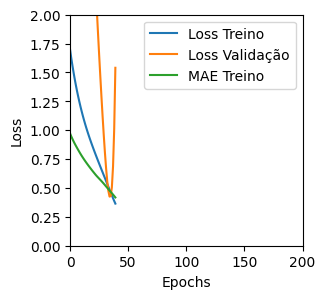

Tempo de treino: 0.08400417963663737 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23588061332702637 , MAE = 0.36755651235580444'

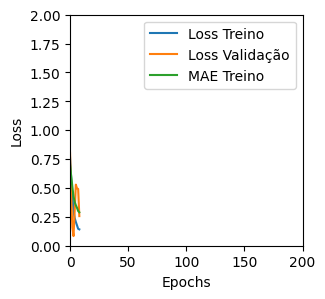

Tempo de treino: 0.13130855957667034 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5174203515052795 , MAE = 0.5527328252792358'

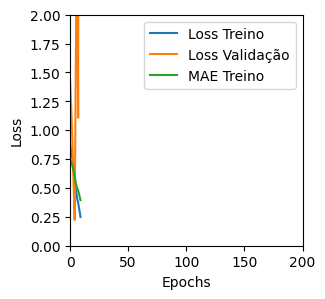

Tempo de treino: 0.10351923306783041 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5469272136688232 , MAE = 0.5801467299461365'

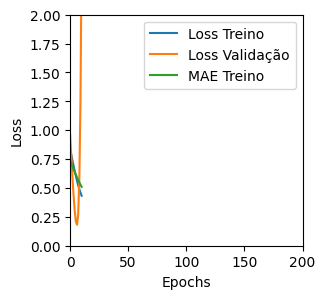

Tempo de treino: 0.06868833700815836 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.506722092628479 , MAE = 0.4825917184352875'

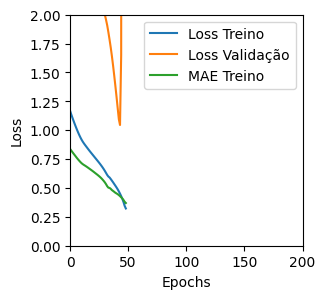

Tempo de treino: 0.12535722653071085 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.315731942653656 , MAE = 0.4042375683784485'

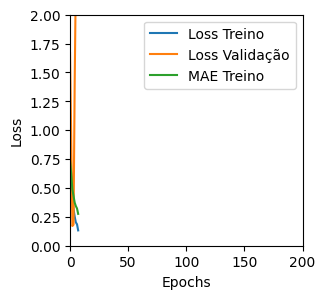

Tempo de treino: 0.13060076634089152 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5603898763656616 , MAE = 0.5884583592414856'

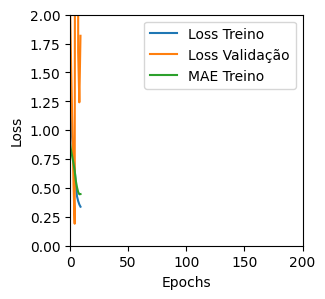

Tempo de treino: 0.08130491574605306 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16

<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4029248058795929 , MAE = 0.4711601734161377'

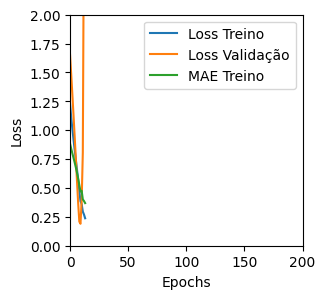

Tempo de treino: 0.07048911253611247 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2800348401069641 , MAE = 0.37930989265441895'

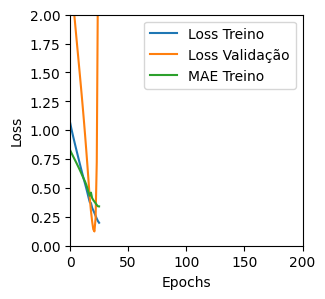

Tempo de treino: 0.07035380999247233 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26704880595207214 , MAE = 0.39629366993904114'

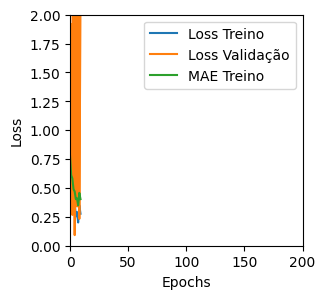

Tempo de treino: 0.142901341120402 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32133567333221436 , MAE = 0.44897758960723877'

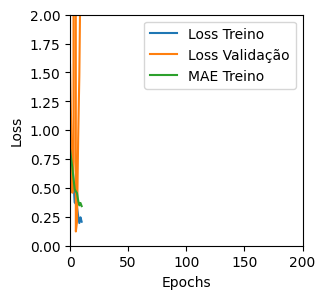

Tempo de treino: 0.12757679224014282 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


'TRAINING set. Loss = 0.37521272897720337 , MAE = 0.4666667878627777'

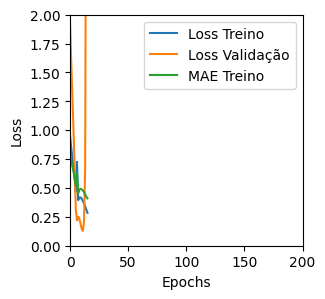

Tempo de treino: 0.08632182677586873 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32735109329223633 , MAE = 0.43158581852912903'

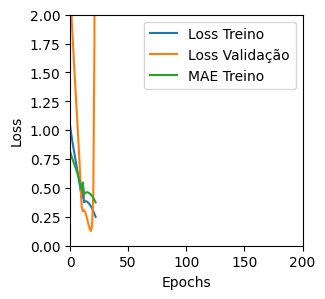

Tempo de treino: 0.07762478192647299 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4282382130622864 , MAE = 0.5021148920059204'

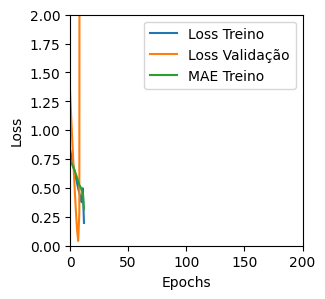

Tempo de treino: 0.12742465337117512 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.071144238114357 , MAE = 0.20731522142887115'

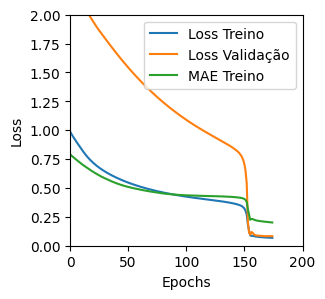

Tempo de treino: 0.7176253994305929 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46921029686927795 , MAE = 0.5029669404029846'

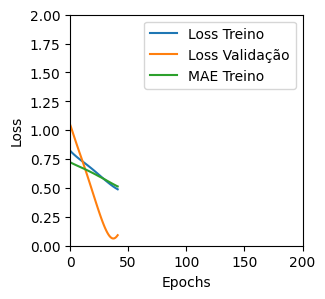

Tempo de treino: 0.13990614414215088 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3928014636039734 , MAE = 0.4767889380455017'

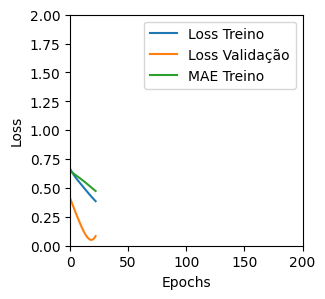

Tempo de treino: 0.07927598158518473 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7426717877388 , MAE = 0.6849545836448669'

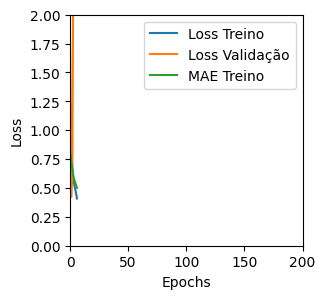

Tempo de treino: 0.09720223347345988 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.92169189453125 , MAE = 0.7731388211250305'

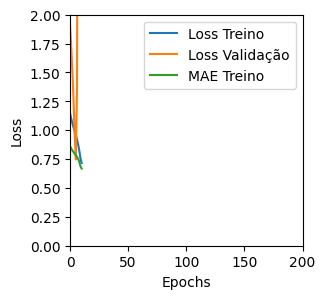

Tempo de treino: 0.0745545506477356 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7395327687263489 , MAE = 0.6898535490036011'

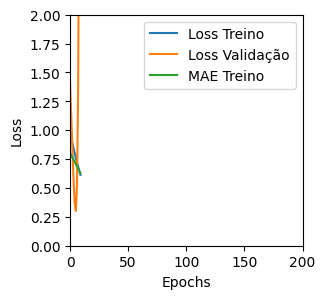

Tempo de treino: 0.08200331926345825 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3565567433834076 , MAE = 0.4068150222301483'

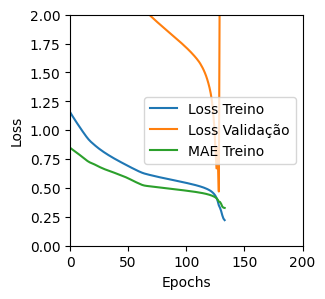

Tempo de treino: 0.38051936229070027 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28379374742507935 , MAE = 0.40782126784324646'

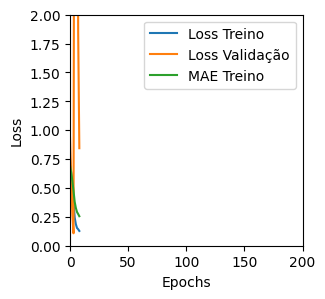

Tempo de treino: 0.132609756787618 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44256591796875 , MAE = 0.5224653482437134'

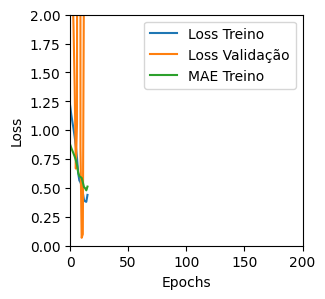

Tempo de treino: 0.13669753074645996 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4476138949394226 , MAE = 0.4767131209373474'

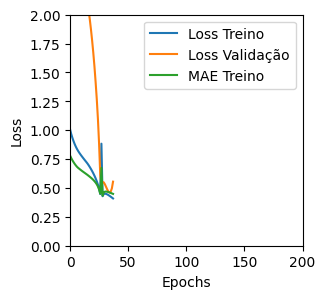

Tempo de treino: 0.11528018315633139 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6374834775924683 , MAE = 0.6307871341705322'

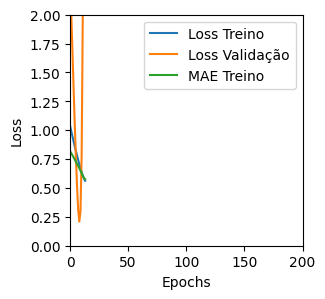

Tempo de treino: 0.07557245890299479 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.659385621547699 , MAE = 0.6297376155853271'

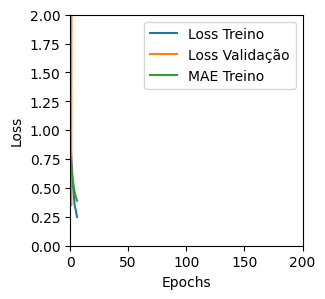

Tempo de treino: 0.12336339155832926 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5666577816009521 , MAE = 0.5785382986068726'

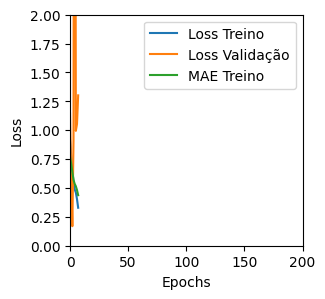

Tempo de treino: 0.08382376432418823 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41422930359840393 , MAE = 0.4906718134880066'

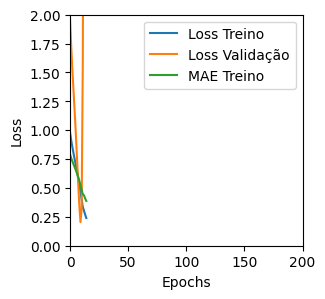

Tempo de treino: 0.07741761604944865 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4486055374145508 , MAE = 0.5168244242668152'

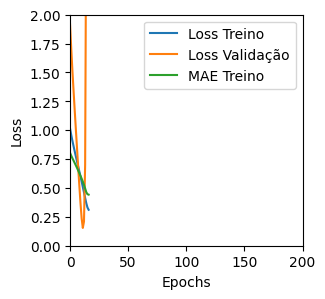

Tempo de treino: 0.05903716087341308 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49770328402519226 , MAE = 0.5658378601074219'

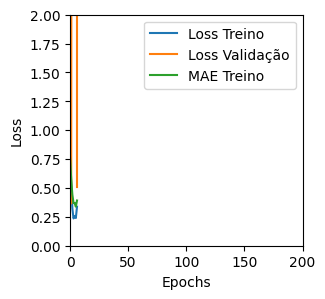

Tempo de treino: 0.16141223510106403 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.255924254655838 , MAE = 0.39066386222839355'

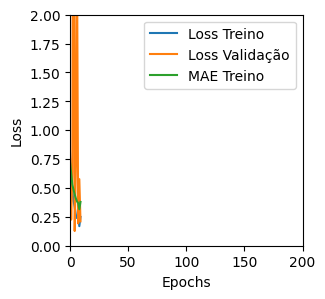

Tempo de treino: 0.09730387131373087 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3623887896537781 , MAE = 0.4587608575820923'

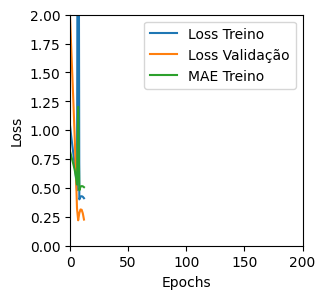

Tempo de treino: 0.0720699946085612 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5066397190093994 , MAE = 0.5404890775680542'

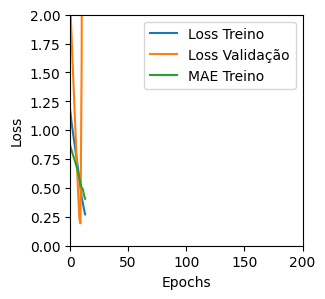

Tempo de treino: 0.06255175669987996 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.223866268992424 , MAE = 0.34575966000556946'

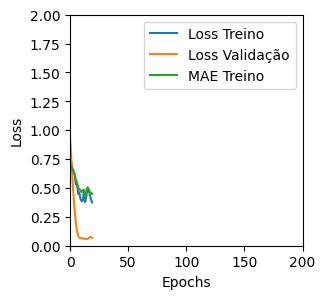

Tempo de treino: 0.16031949917475383 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43068233132362366 , MAE = 0.48907598853111267'

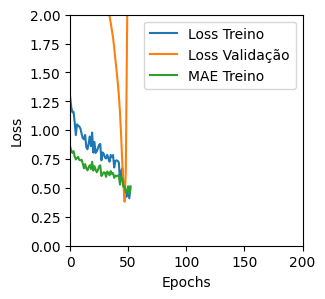

Tempo de treino: 0.38846139510472616 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4554142653942108 , MAE = 0.5065741539001465'

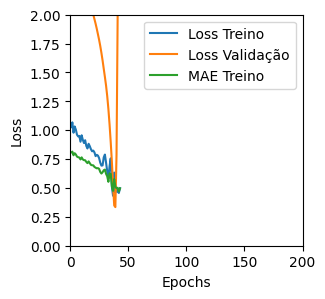

Tempo de treino: 0.12661858399709067 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2186548262834549 , MAE = 0.35297638177871704'

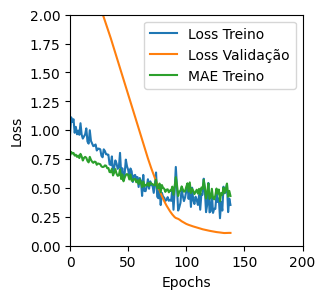

Tempo de treino: 0.4046615997950236 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35956713557243347 , MAE = 0.44657477736473083'

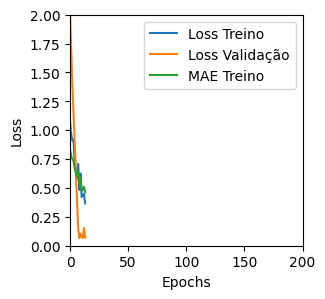

Tempo de treino: 0.12120863596598307 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6835542917251587 , MAE = 0.6235374808311462'

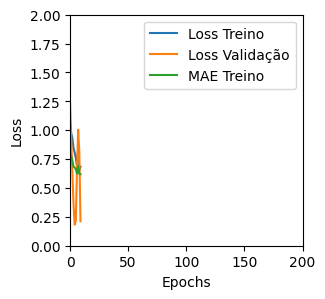

Tempo de treino: 0.08896761337916057 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6828418374061584 , MAE = 0.6396339535713196'

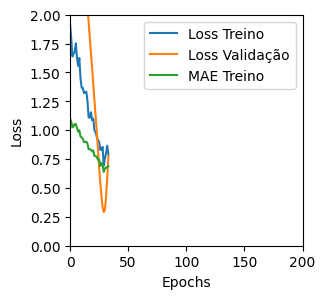

Tempo de treino: 0.12204364935557048 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6101943850517273 , MAE = 0.5352894067764282'

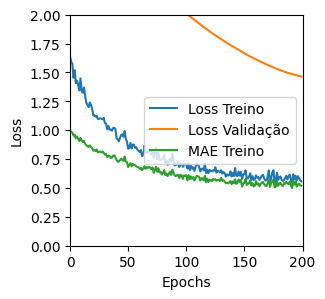

Tempo de treino: 0.37831206719080607 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7294816374778748 , MAE = 0.6758888959884644'

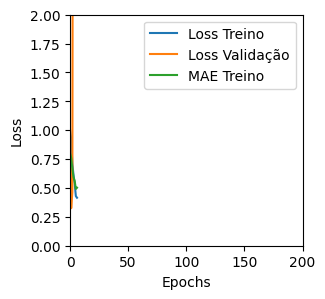

Tempo de treino: 0.08055009444554646 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34373873472213745 , MAE = 0.4252457320690155'

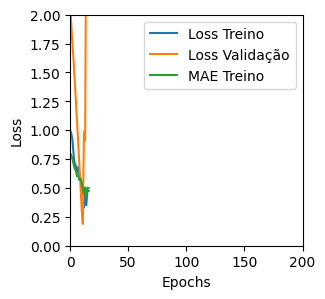

Tempo de treino: 0.0961095929145813 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4487655460834503 , MAE = 0.5182629823684692'

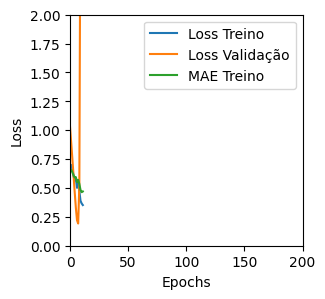

Tempo de treino: 0.10506584246953328 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32856684923171997 , MAE = 0.4375089108943939'

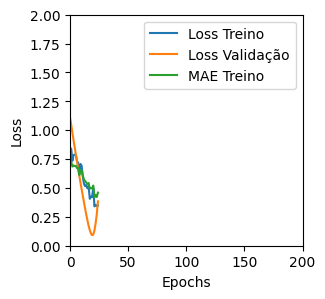

Tempo de treino: 0.09410853385925293 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12295164912939072 , MAE = 0.253350168466568'

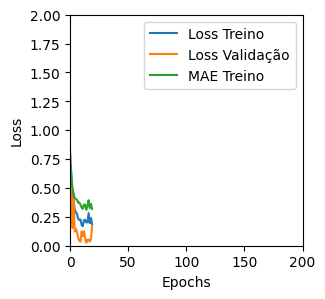

Tempo de treino: 0.21014540195465087 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5875425338745117 , MAE = 0.5872443318367004'

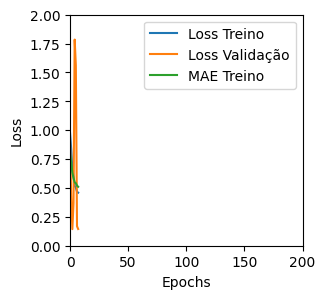

Tempo de treino: 0.07957606315612793 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45470044016838074 , MAE = 0.5137516260147095'

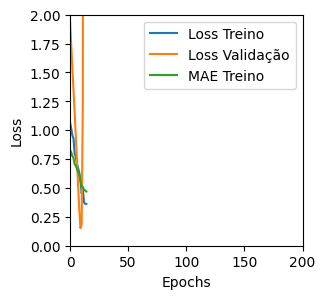

Tempo de treino: 0.08389988740285238 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40122464299201965 , MAE = 0.4452904760837555'

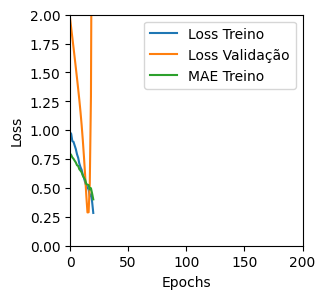

Tempo de treino: 0.08041512966156006 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23372113704681396 , MAE = 0.3470115661621094'

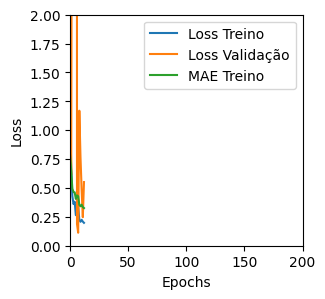

Tempo de treino: 0.14748428662618002 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16428054869174957 , MAE = 0.28604426980018616'

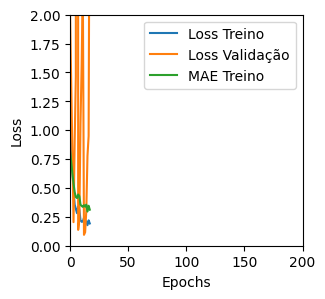

Tempo de treino: 0.11812993685404459 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.586669921875 , MAE = 0.5932730436325073'

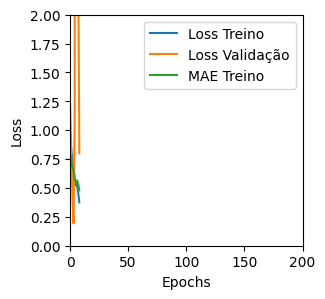

Tempo de treino: 0.09661373694737753 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4060429036617279 , MAE = 0.48829829692840576'

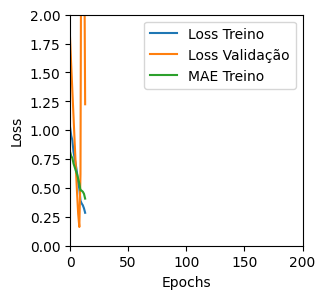

Tempo de treino: 0.06327002048492432 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11065790802240372 , MAE = 0.26142221689224243'

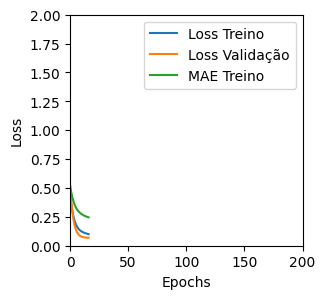

Tempo de treino: 0.21868640581766766 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14818668365478516 , MAE = 0.3138500452041626'

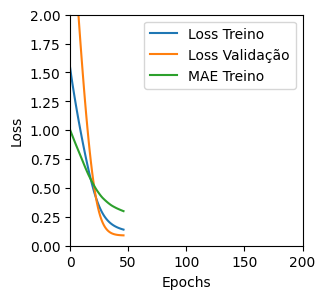

Tempo de treino: 0.3860153277715047 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11063190549612045 , MAE = 0.2632751166820526'

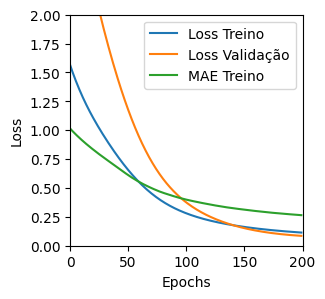

Tempo de treino: 0.7579200903574626 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19045844674110413 , MAE = 0.32896432280540466'

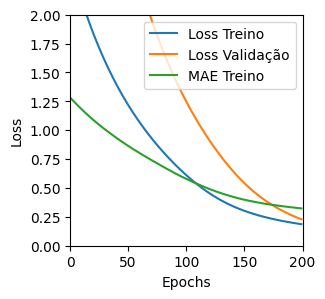

Tempo de treino: 0.35830961863199867 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12965907156467438 , MAE = 0.2876974940299988'

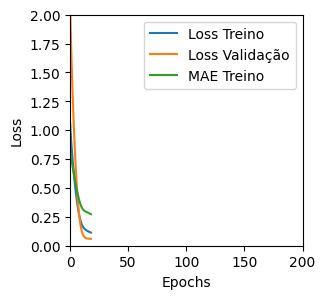

Tempo de treino: 0.22016900777816772 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13981188833713531 , MAE = 0.28651607036590576'

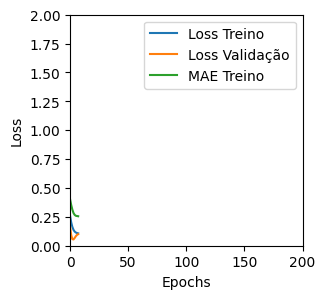

Tempo de treino: 0.09744648933410645 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21282808482646942 , MAE = 0.37709033489227295'

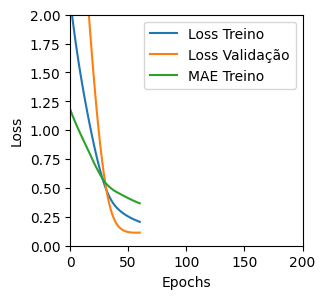

Tempo de treino: 0.3862199306488037 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15246941149234772 , MAE = 0.313320130109787'

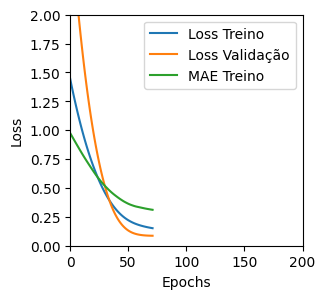

Tempo de treino: 0.1786215901374817 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13148468732833862 , MAE = 0.27693334221839905'

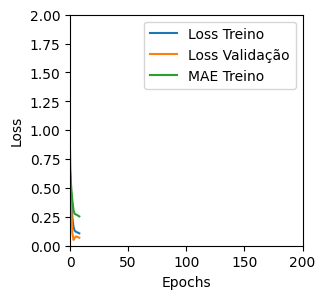

Tempo de treino: 0.13263129790623981 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2293439656496048 , MAE = 0.3757835626602173'

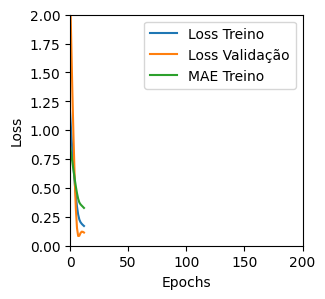

Tempo de treino: 0.10229057470957438 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2013588696718216 , MAE = 0.3500644266605377'

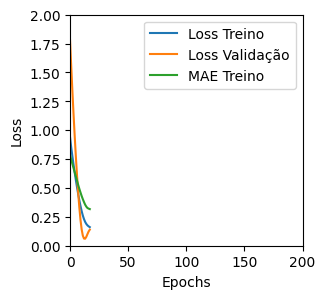

Tempo de treino: 0.10604006052017212 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1563166379928589 , MAE = 0.3060254156589508'

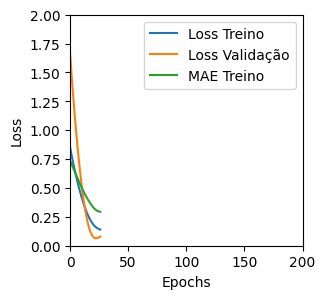

Tempo de treino: 0.12916475931803387 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0491604320704937 , MAE = 0.1716790348291397'

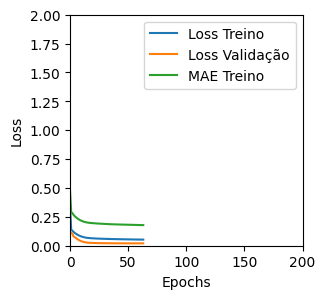

Tempo de treino: 0.5097387234369913 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17996105551719666 , MAE = 0.3212510049343109'

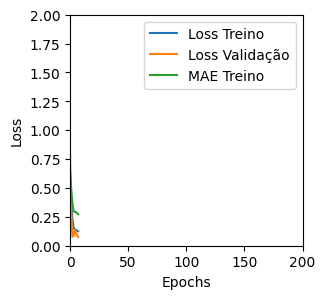

Tempo de treino: 0.08989761273066203 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14369267225265503 , MAE = 0.28980863094329834'

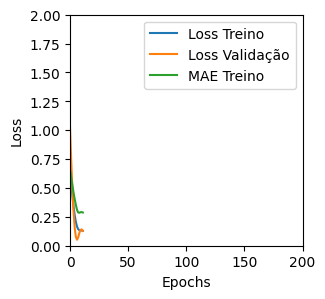

Tempo de treino: 0.1341023643811544 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16061915457248688 , MAE = 0.30371785163879395'

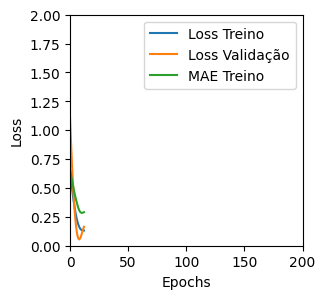

Tempo de treino: 0.10069897969563803 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05334603041410446 , MAE = 0.17798854410648346'

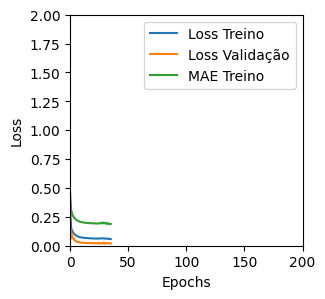

Tempo de treino: 0.339145294825236 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049715522676706314 , MAE = 0.17349450290203094'

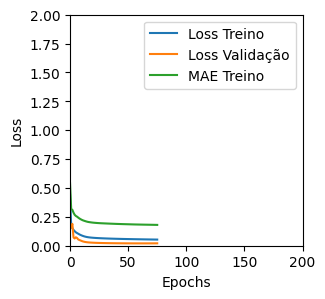

Tempo de treino: 0.7347612937291463 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1976529061794281 , MAE = 0.3383365571498871'

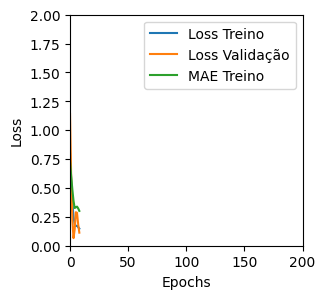

Tempo de treino: 0.09756577014923096 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20135991275310516 , MAE = 0.3406207263469696'

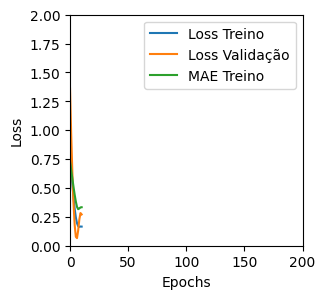

Tempo de treino: 0.07183674176534018 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1621309220790863 , MAE = 0.31335940957069397'

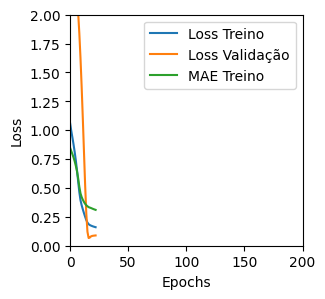

Tempo de treino: 0.135386860370636 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5365883708000183 , MAE = 0.5612706542015076'

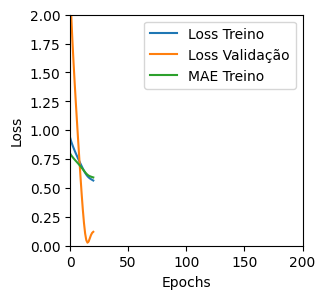

Tempo de treino: 0.07996556758880616 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.0913126468658447 , MAE = 0.864519476890564'

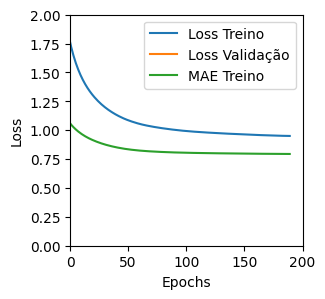

Tempo de treino: 0.39058053493499756 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1307273507118225 , MAE = 0.2805820107460022'

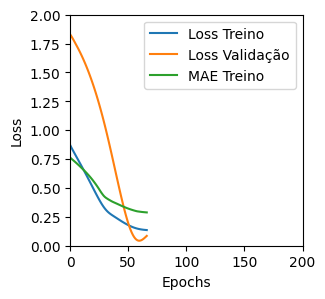

Tempo de treino: 0.10665255784988403 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12538368999958038 , MAE = 0.2672306001186371'

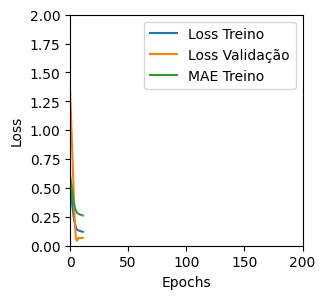

Tempo de treino: 0.07796350320180258 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18933504819869995 , MAE = 0.3262733817100525'

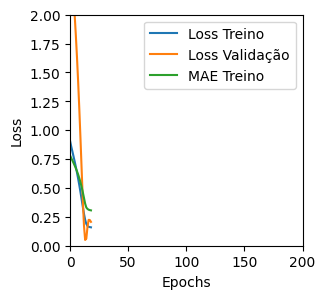

Tempo de treino: 0.07274141709009806 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1826028823852539 , MAE = 0.3253539502620697'

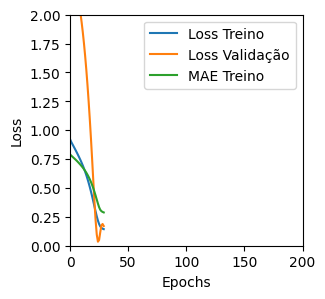

Tempo de treino: 0.06570708751678467 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17220516502857208 , MAE = 0.3087754547595978'

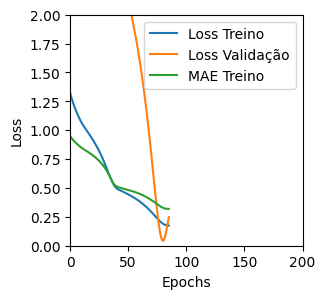

Tempo de treino: 0.20551966428756713 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1462830901145935 , MAE = 0.2954264283180237'

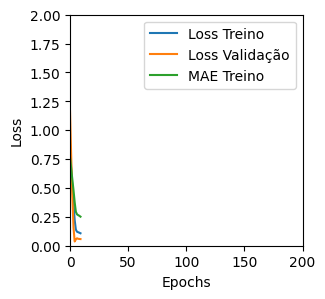

Tempo de treino: 0.09070934454600016 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1213943287730217 , MAE = 0.2640816569328308'

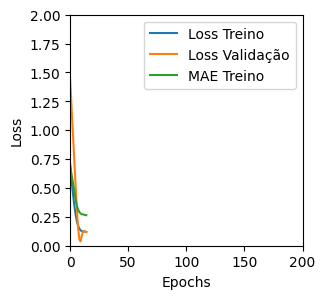

Tempo de treino: 0.06864155133565267 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1282016783952713 , MAE = 0.2689867615699768'

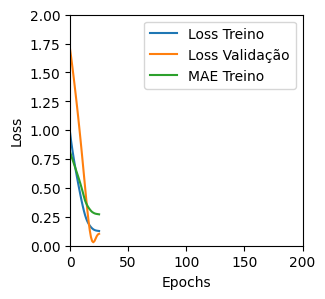

Tempo de treino: 0.06763923565546671 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14675502479076385 , MAE = 0.2915560007095337'

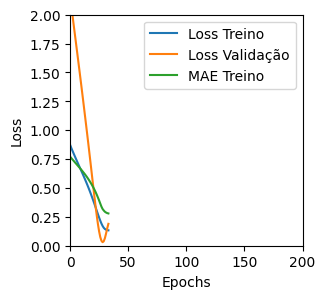

Tempo de treino: 0.08263781468073526 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1580231636762619 , MAE = 0.2986004650592804'

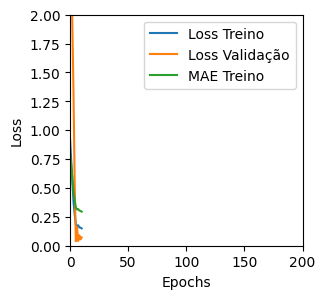

Tempo de treino: 0.0786220113436381 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14472655951976776 , MAE = 0.28463464975357056'

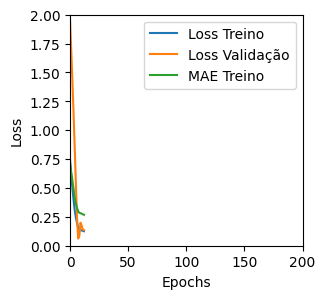

Tempo de treino: 0.06365436712900797 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21674996614456177 , MAE = 0.3640734851360321'

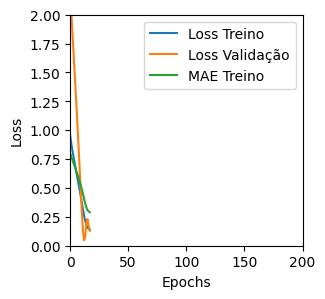

Tempo de treino: 0.08249510526657104 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14664456248283386 , MAE = 0.28563958406448364'

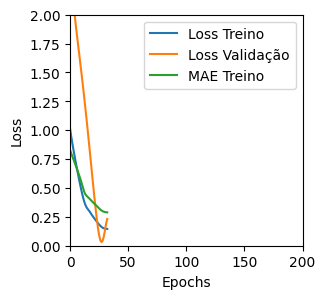

Tempo de treino: 0.0985743522644043 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1368224322795868 , MAE = 0.276595801115036'

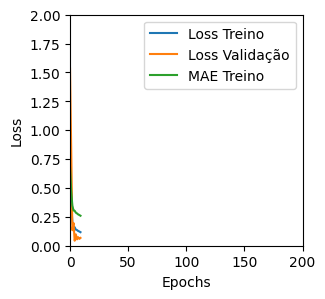

Tempo de treino: 0.07962694962819418 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13943538069725037 , MAE = 0.2812662720680237'

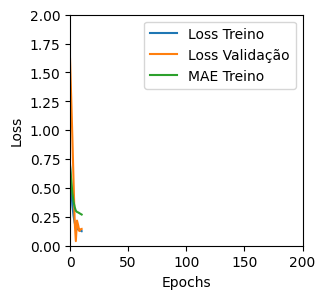

Tempo de treino: 0.06001324653625488 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14372500777244568 , MAE = 0.2868126630783081'

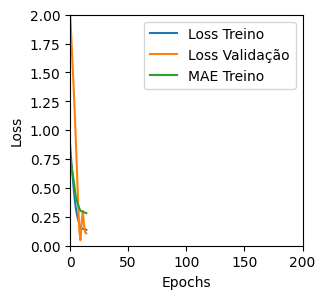

Tempo de treino: 0.057379345099131264 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14302781224250793 , MAE = 0.2867830991744995'

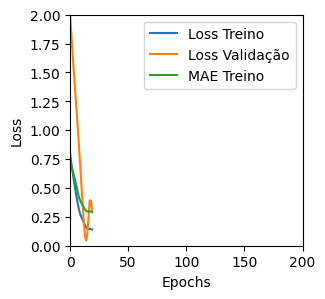

Tempo de treino: 0.06342130899429321 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13081301748752594 , MAE = 0.2716001868247986'

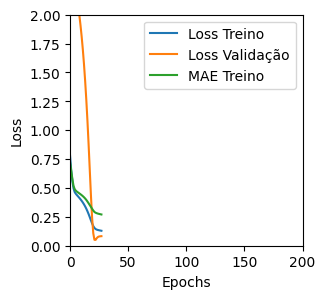

Tempo de treino: 0.11980272531509399 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47872409224510193 , MAE = 0.5242392420768738'

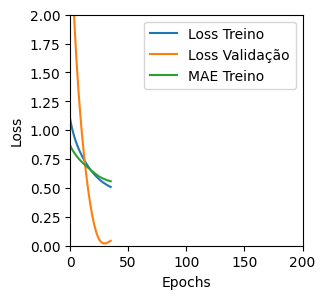

Tempo de treino: 0.12829127311706542 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31859397888183594 , MAE = 0.379981130361557'

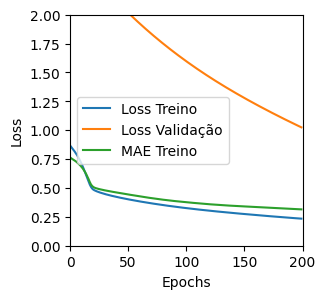

Tempo de treino: 0.40347845951716105 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45386236906051636 , MAE = 0.45873457193374634'

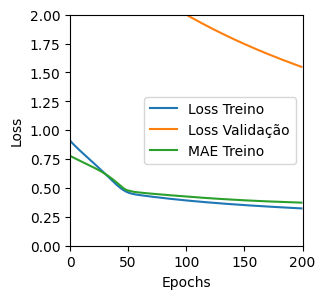

Tempo de treino: 0.21485843658447265 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12317117303609848 , MAE = 0.26655760407447815'

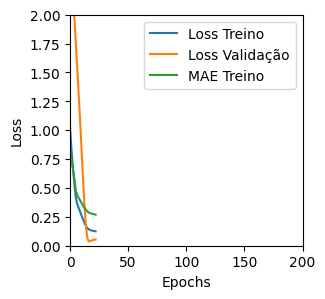

Tempo de treino: 0.10639021794001262 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1270628720521927 , MAE = 0.26431435346603394'

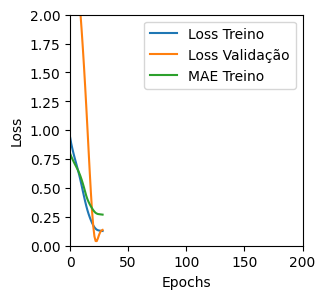

Tempo de treino: 0.08608259757359822 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10107088834047318 , MAE = 0.23870331048965454'

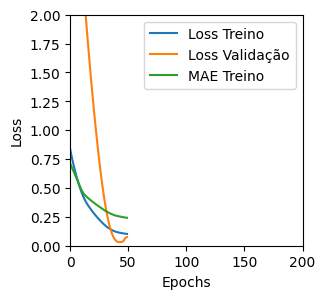

Tempo de treino: 0.09945637782414754 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13766731321811676 , MAE = 0.2796245813369751'

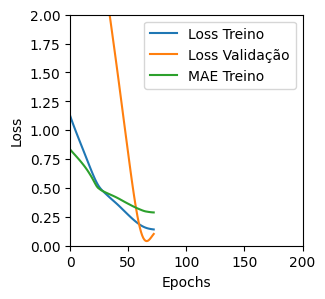

Tempo de treino: 0.1211663842201233 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14993813633918762 , MAE = 0.2898872196674347'

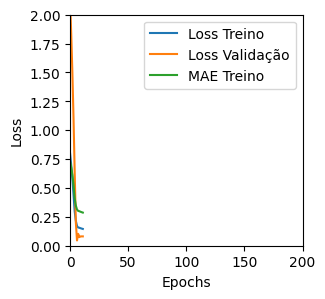

Tempo de treino: 0.07071001132329305 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15132521092891693 , MAE = 0.29377320408821106'

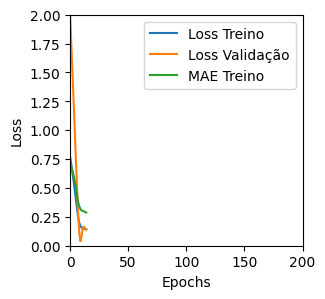

Tempo de treino: 0.10551029046376546 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18846212327480316 , MAE = 0.33129164576530457'

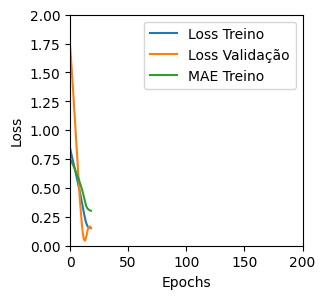

Tempo de treino: 0.09326240221659342 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17512673139572144 , MAE = 0.3184334635734558'

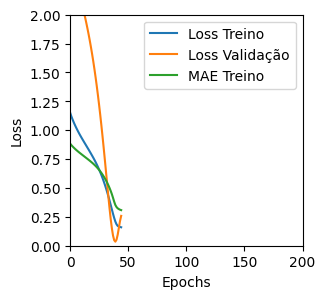

Tempo de treino: 0.08148280779520671 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2660548686981201 , MAE = 0.4055039882659912'

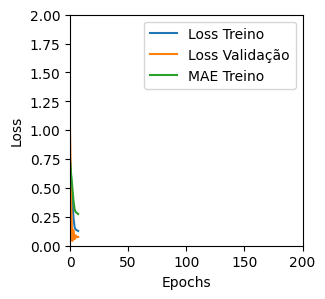

Tempo de treino: 0.08469699621200562 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15188470482826233 , MAE = 0.2903062701225281'

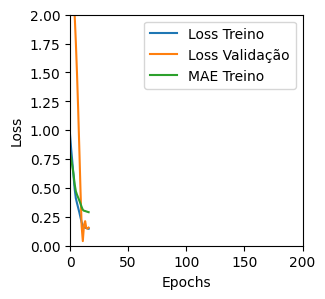

Tempo de treino: 0.06616667906443278 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14656338095664978 , MAE = 0.2871547341346741'

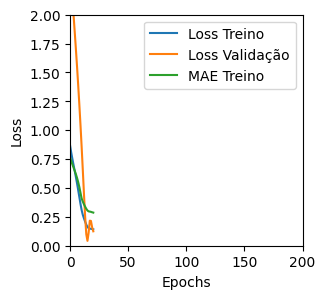

Tempo de treino: 0.06044767697652181 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14853747189044952 , MAE = 0.28807979822158813'

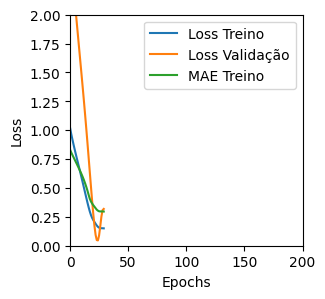

Tempo de treino: 0.08540787696838378 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13398469984531403 , MAE = 0.27240434288978577'

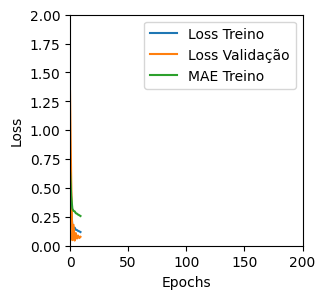

Tempo de treino: 0.10552740097045898 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14407101273536682 , MAE = 0.28469932079315186'

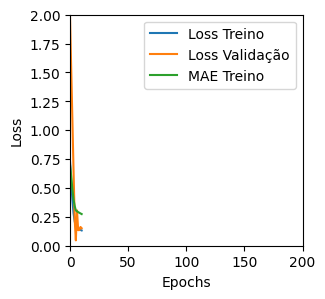

Tempo de treino: 0.09342426856358846 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15357168018817902 , MAE = 0.29635095596313477'

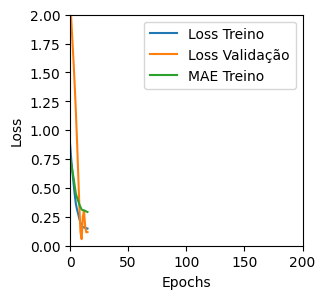

Tempo de treino: 0.06201563278834025 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15404480695724487 , MAE = 0.29403093457221985'

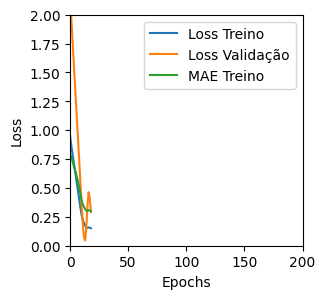

Tempo de treino: 0.07845264275868734 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1232064962387085 , MAE = 0.8844069838523865'

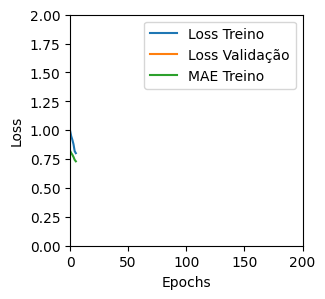

Tempo de treino: 0.05487653414408366 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17943349480628967 , MAE = 0.325116366147995'

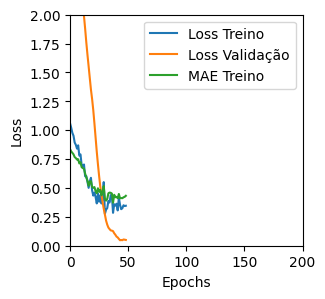

Tempo de treino: 0.12110721270243327 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5644205212593079 , MAE = 0.5771912336349487'

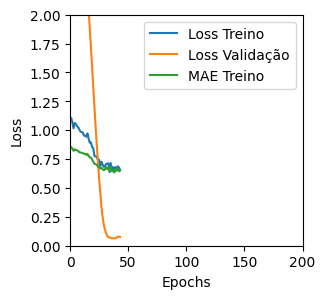

Tempo de treino: 0.12011833985646565 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17101351916790009 , MAE = 0.316783607006073'

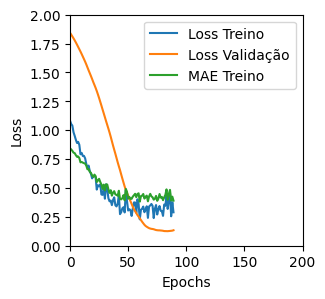

Tempo de treino: 0.12061855792999268 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.139521986246109 , MAE = 0.2786543667316437'

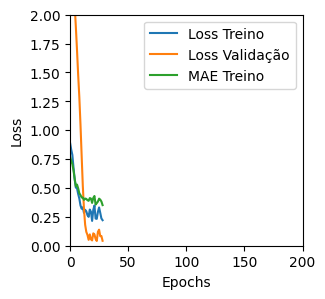

Tempo de treino: 0.1522969961166382 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10848964750766754 , MAE = 0.24697183072566986'

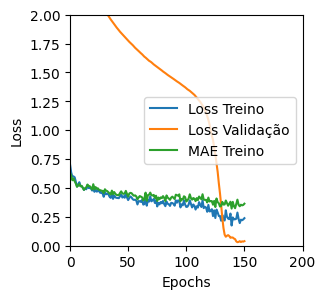

Tempo de treino: 0.28130149046579994 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15624038875102997 , MAE = 0.30176952481269836'

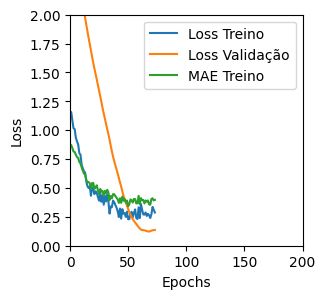

Tempo de treino: 0.208560574054718 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2037678360939026 , MAE = 0.3371550440788269'

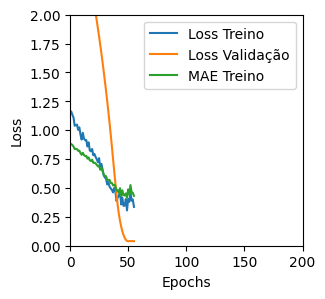

Tempo de treino: 0.12155818939208984 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11312460154294968 , MAE = 0.25678762793540955'

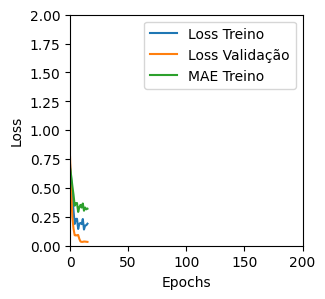

Tempo de treino: 0.07781151135762533 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1550430953502655 , MAE = 0.29238662123680115'

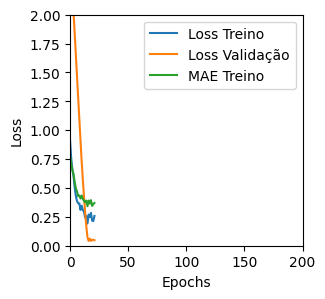

Tempo de treino: 0.12282311121622722 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13310536742210388 , MAE = 0.27303722500801086'

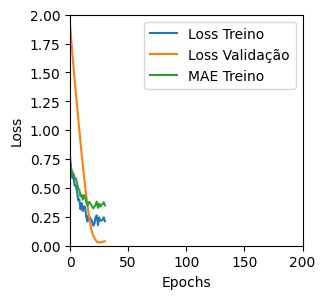

Tempo de treino: 0.07723333835601806 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24027572572231293 , MAE = 0.3791870176792145'

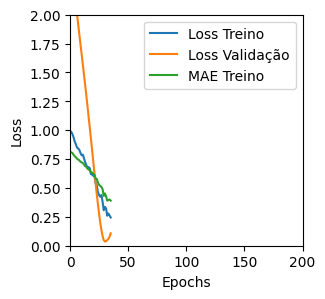

Tempo de treino: 0.11146740913391114 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1281963586807251 , MAE = 0.2650517225265503'

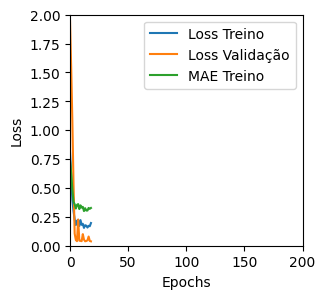

Tempo de treino: 0.09346196254094442 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1462758183479309 , MAE = 0.28828197717666626'

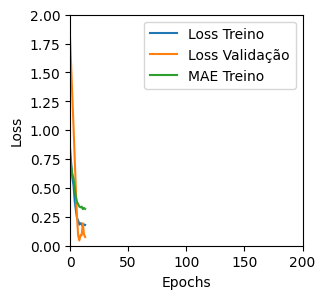

Tempo de treino: 0.07343069314956666 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1506115198135376 , MAE = 0.2927318513393402'

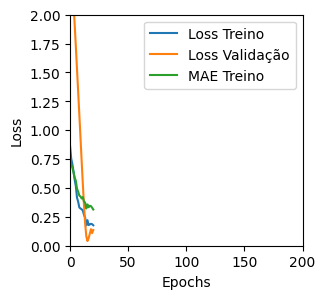

Tempo de treino: 0.06269288063049316 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14809127151966095 , MAE = 0.2910514771938324'

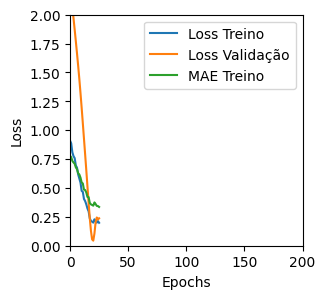

Tempo de treino: 0.061809174219767254 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13872931897640228 , MAE = 0.28356578946113586'

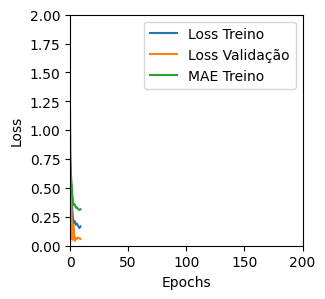

Tempo de treino: 0.08505709966023763 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11343106627464294 , MAE = 0.25169315934181213'

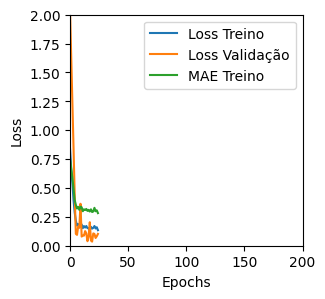

Tempo de treino: 0.12186015049616496 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2694076597690582 , MAE = 0.40544167160987854'

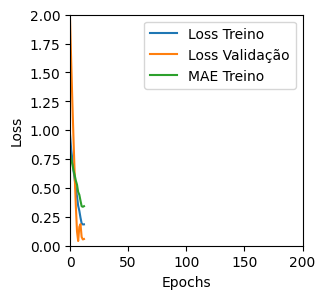

Tempo de treino: 0.06776973406473795 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14864081144332886 , MAE = 0.29022789001464844'

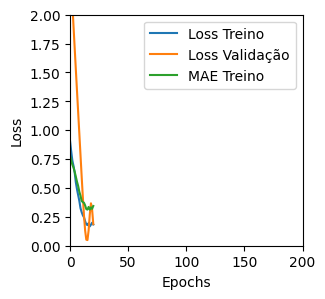

Tempo de treino: 0.07118172248204549 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04404826834797859 , MAE = 0.1623120754957199'

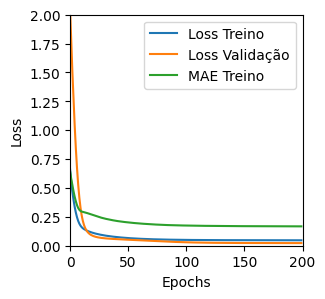

Tempo de treino: 0.5980833848317464 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04511582851409912 , MAE = 0.16372746229171753'

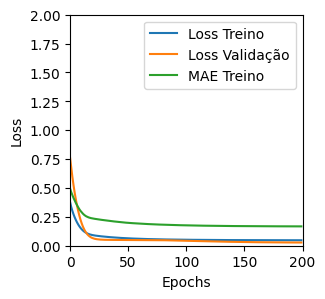

Tempo de treino: 0.3949246128400167 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.056666143238544464 , MAE = 0.18514509499073029'

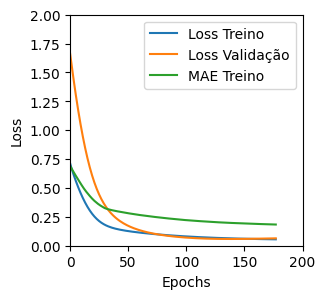

Tempo de treino: 0.3961416403452555 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10674294084310532 , MAE = 0.26659712195396423'

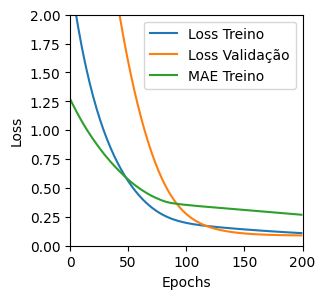

Tempo de treino: 0.2579454302787781 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04396327584981918 , MAE = 0.16074343025684357'

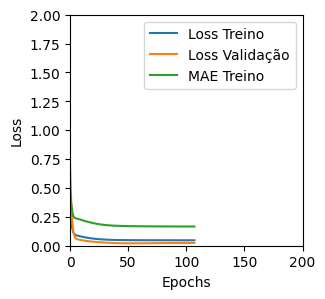

Tempo de treino: 0.3558099945386251 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04484798386693001 , MAE = 0.16218538582324982'

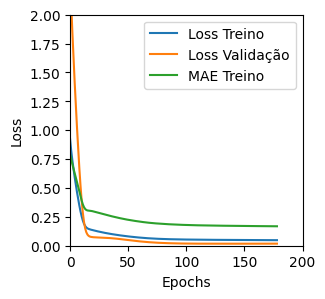

Tempo de treino: 0.3900179902712504 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10351580381393433 , MAE = 0.2584158480167389'

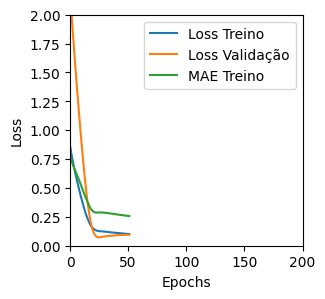

Tempo de treino: 0.11063410838445027 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.060437463223934174 , MAE = 0.19531072676181793'

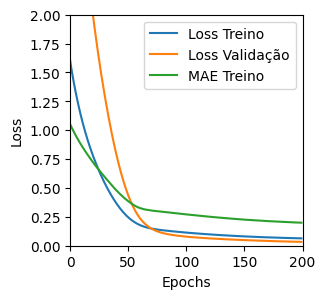

Tempo de treino: 0.2872527758280436 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04903706908226013 , MAE = 0.17172227799892426'

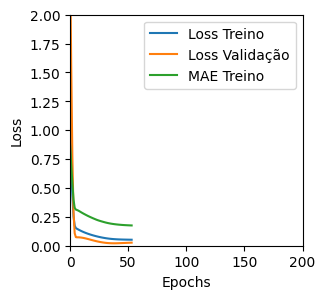

Tempo de treino: 0.2200470487276713 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04453163966536522 , MAE = 0.1615123152732849'

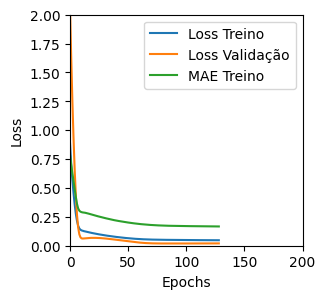

Tempo de treino: 0.2684723416964213 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11486388742923737 , MAE = 0.2712670862674713'

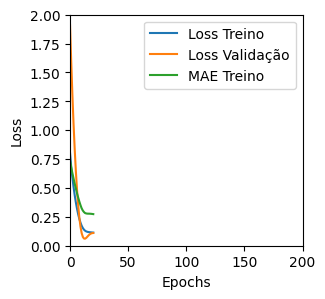

Tempo de treino: 0.08896530866622925 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11980873346328735 , MAE = 0.28069937229156494'

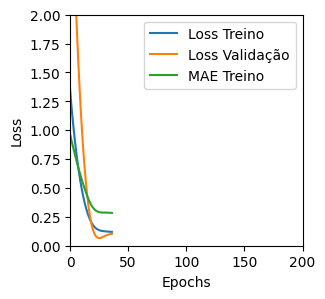

Tempo de treino: 0.08382750749588012 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06477019190788269 , MAE = 0.20013020932674408'

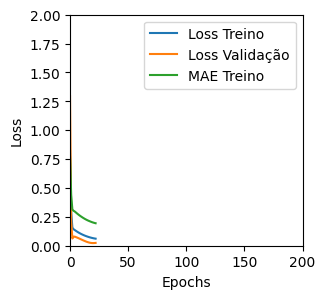

Tempo de treino: 0.1605773647626241 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1338370144367218 , MAE = 0.2906944751739502'

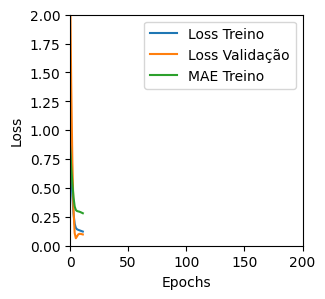

Tempo de treino: 0.08876806497573853 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13307607173919678 , MAE = 0.2932289242744446'

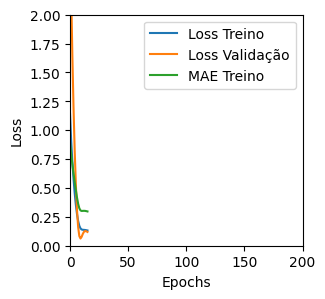

Tempo de treino: 0.07715242306391398 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11750554293394089 , MAE = 0.26969751715660095'

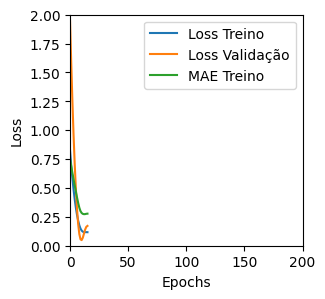

Tempo de treino: 0.0688824733098348 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07560557126998901 , MAE = 0.214084193110466'

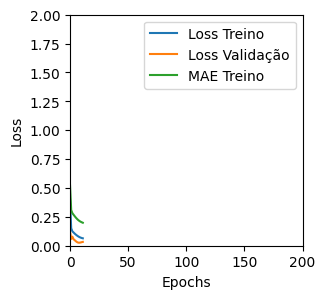

Tempo de treino: 0.13600651025772095 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1441350132226944 , MAE = 0.29387301206588745'

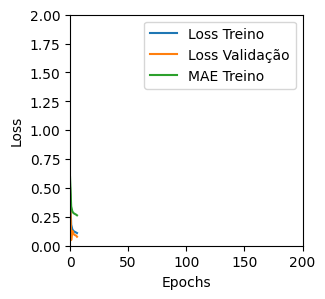

Tempo de treino: 0.07986202637354532 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15382784605026245 , MAE = 0.3088918924331665'

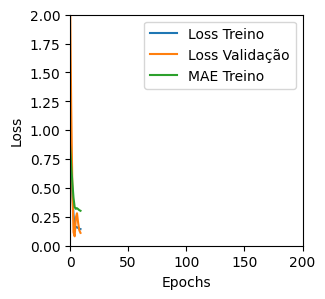

Tempo de treino: 0.07898109356562297 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13739252090454102 , MAE = 0.2892802357673645'

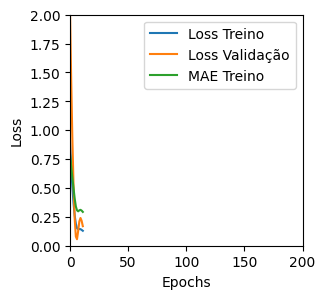

Tempo de treino: 0.06853825648625692 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.771363377571106 , MAE = 0.6995619535446167'

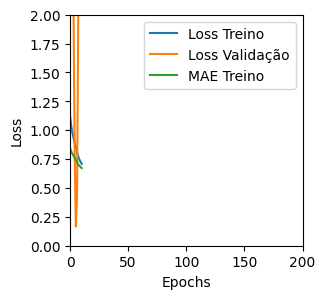

Tempo de treino: 0.07266801993052165 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.3523801565170288 , MAE = 0.9670388698577881'

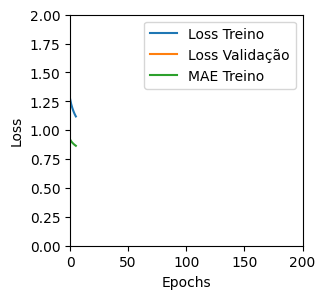

Tempo de treino: 0.05086896022160848 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2657736539840698 , MAE = 0.3886292576789856'

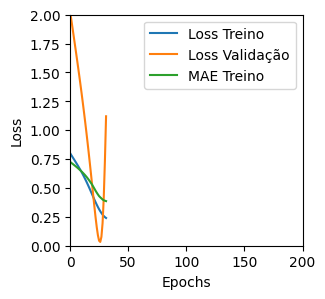

Tempo de treino: 0.09816931486129761 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16885605454444885 , MAE = 0.2967219352722168'

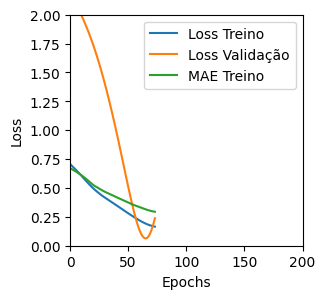

Tempo de treino: 0.1348369836807251 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2409300059080124 , MAE = 0.3820635676383972'

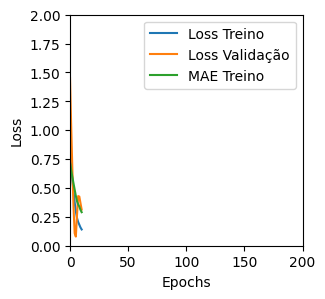

Tempo de treino: 0.07783530950546265 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23903252184391022 , MAE = 0.35532256960868835'

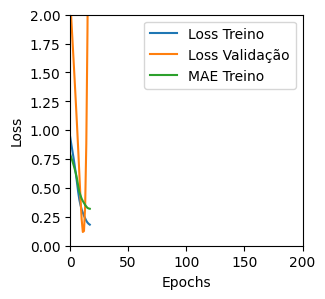

Tempo de treino: 0.0647906502087911 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24982242286205292 , MAE = 0.3785748779773712'

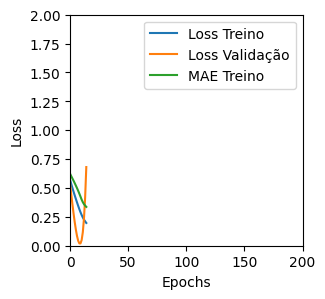

Tempo de treino: 0.04964572588602702 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33343133330345154 , MAE = 0.43807607889175415'

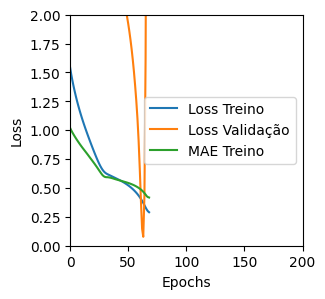

Tempo de treino: 0.1205145796140035 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2026510387659073 , MAE = 0.3424232304096222'

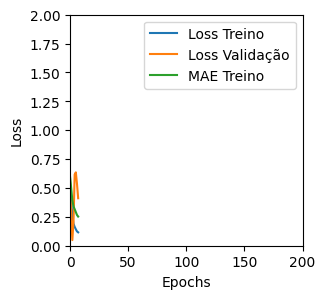

Tempo de treino: 0.051573650042215986 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2246217131614685 , MAE = 0.3617902398109436'

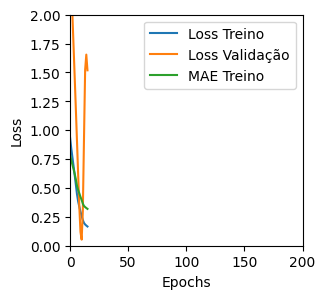

Tempo de treino: 0.07163045008977255 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1870029866695404 , MAE = 0.3093150556087494'

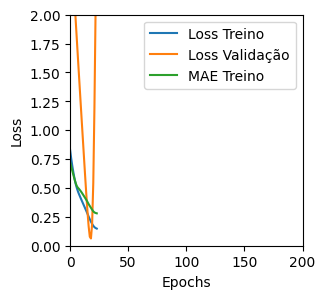

Tempo de treino: 0.09664047559102376 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32522088289260864 , MAE = 0.42593249678611755'

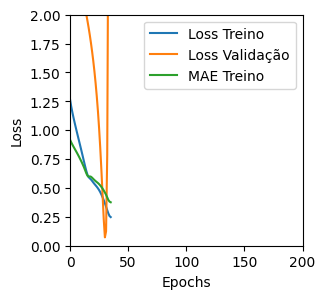

Tempo de treino: 0.08427862723668417 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2265227735042572 , MAE = 0.35904523730278015'

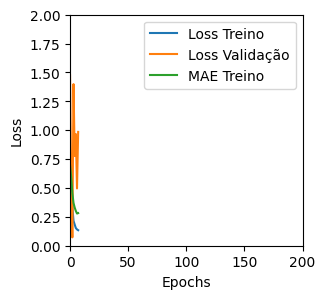

Tempo de treino: 0.06681309541066488 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23828603327274323 , MAE = 0.35914361476898193'

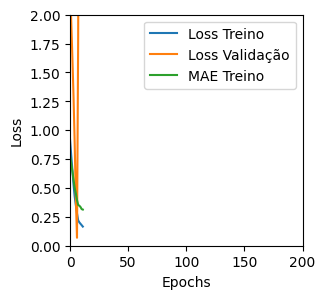

Tempo de treino: 0.07448439200719198 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3407478332519531 , MAE = 0.45769667625427246'

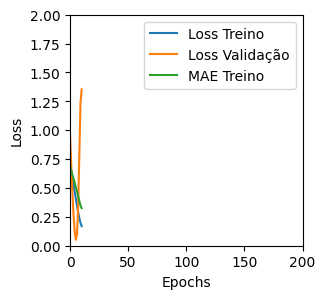

Tempo de treino: 0.04670913219451904 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2575593590736389 , MAE = 0.39148280024528503'

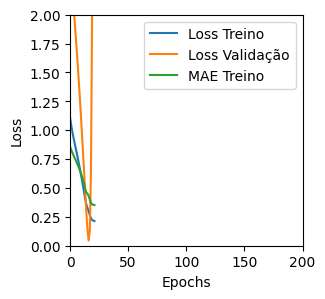

Tempo de treino: 0.07047433455785115 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1561603993177414 , MAE = 0.2956792414188385'

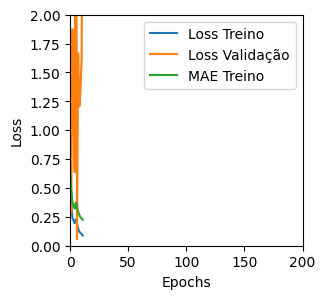

Tempo de treino: 0.07237879037857056 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2839930057525635 , MAE = 0.3851657211780548'

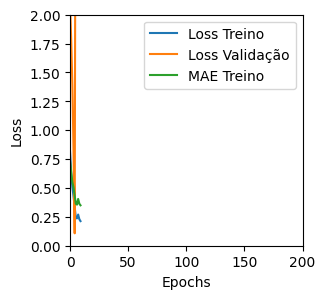

Tempo de treino: 0.05102590719858805 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21786059439182281 , MAE = 0.3479384779930115'

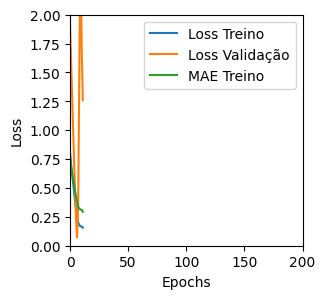

Tempo de treino: 0.0798264503479004 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2453332543373108 , MAE = 0.361965149641037'

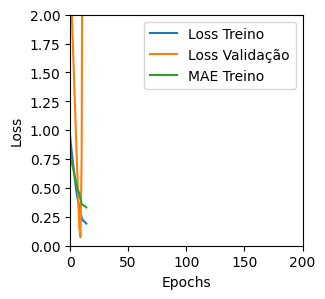

Tempo de treino: 0.08737310965855917 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19172275066375732 , MAE = 0.3130326569080353'

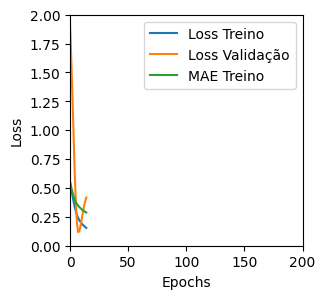

Tempo de treino: 0.1189668854077657 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3173404335975647 , MAE = 0.43237054347991943'

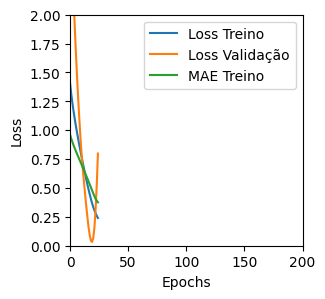

Tempo de treino: 0.07561111052831014 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2161639779806137 , MAE = 0.34583184123039246'

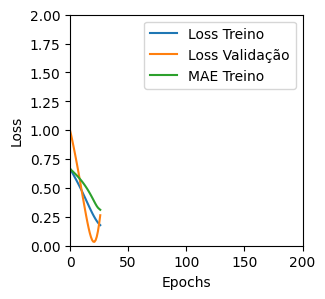

Tempo de treino: 0.07119845151901245 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8044410347938538 , MAE = 0.7109270691871643'

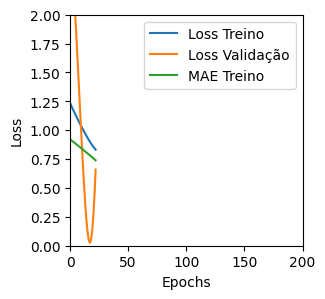

Tempo de treino: 0.07998867034912109 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2260304093360901 , MAE = 0.3493596613407135'

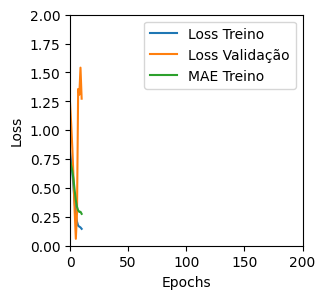

Tempo de treino: 0.058557156721750894 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21380957961082458 , MAE = 0.3346274495124817'

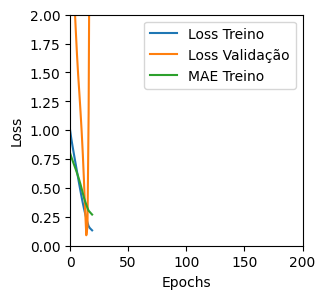

Tempo de treino: 0.07067710161209106 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18944433331489563 , MAE = 0.32084420323371887'

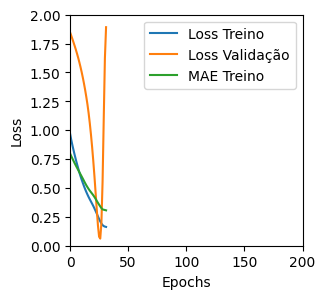

Tempo de treino: 0.09043479760487874 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19389520585536957 , MAE = 0.3247222304344177'

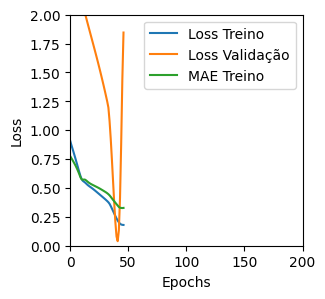

Tempo de treino: 0.10632793108622234 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2665223181247711 , MAE = 0.37273192405700684'

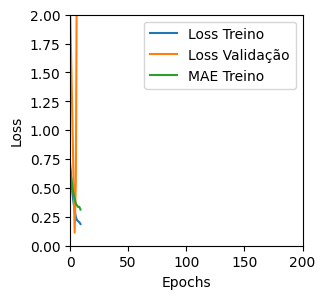

Tempo de treino: 0.06231337785720825 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2371291220188141 , MAE = 0.361253947019577'

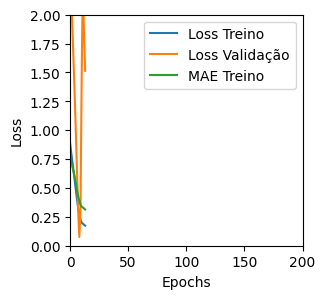

Tempo de treino: 0.05941445032755534 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6443744897842407 , MAE = 0.6174594759941101'

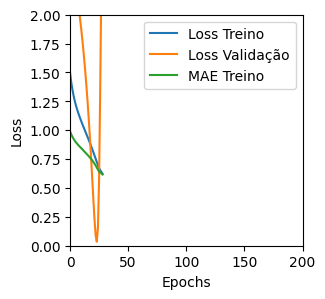

Tempo de treino: 0.07254718939463298 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24133551120758057 , MAE = 0.3583267033100128'

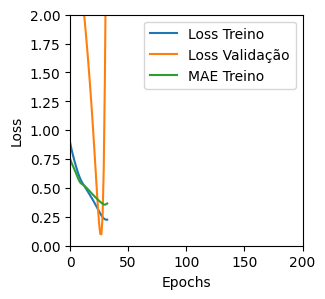

Tempo de treino: 0.06982658704121908 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23456306755542755 , MAE = 0.3567812740802765'

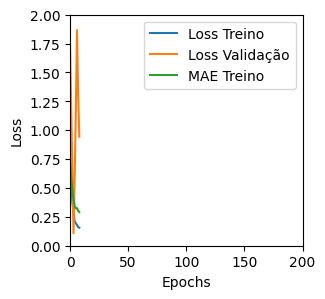

Tempo de treino: 0.05963544845581055 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2537018358707428 , MAE = 0.36784517765045166'

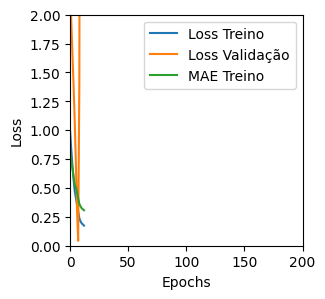

Tempo de treino: 0.07896740039189656 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29248520731925964 , MAE = 0.4155246913433075'

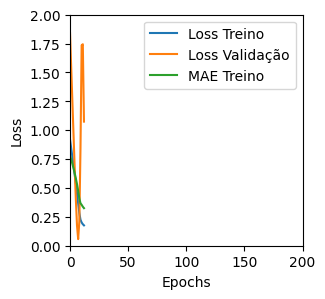

Tempo de treino: 0.07819358507792155 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24343618750572205 , MAE = 0.36910945177078247'

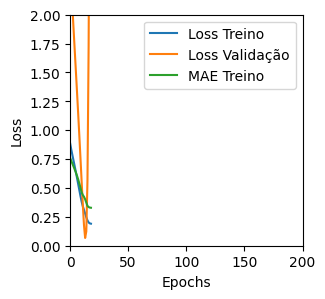

Tempo de treino: 0.0768774668375651 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25024905800819397 , MAE = 0.37781041860580444'

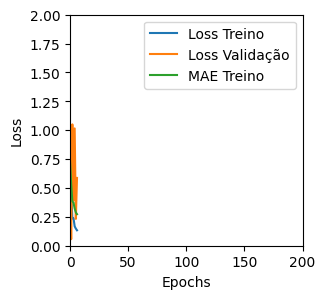

Tempo de treino: 0.05737300316492717 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2608144283294678 , MAE = 0.3810945451259613'

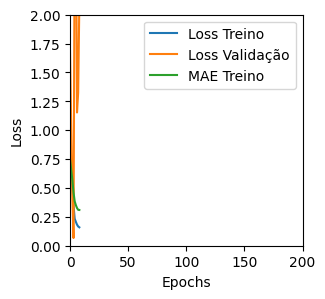

Tempo de treino: 0.05243536631266276 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2977689802646637 , MAE = 0.41800305247306824'

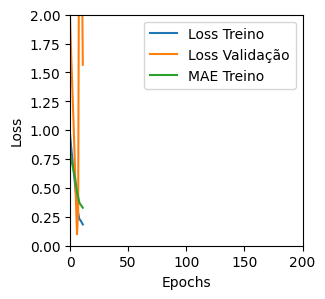

Tempo de treino: 0.05831151405970256 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22350531816482544 , MAE = 0.3440632224082947'

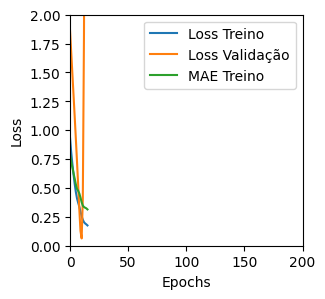

Tempo de treino: 0.06350444555282593 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3933052122592926 , MAE = 0.4466206431388855'

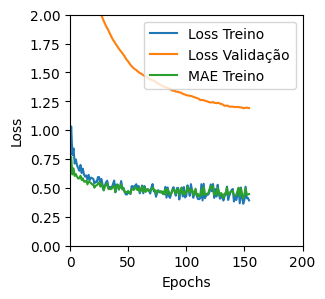

Tempo de treino: 0.7167787551879883 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22727887332439423 , MAE = 0.3655379116535187'

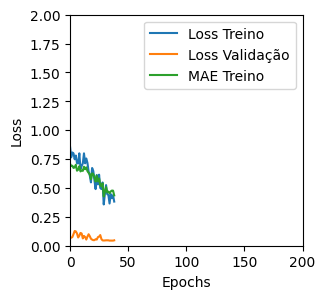

Tempo de treino: 0.08916673262914022 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9788200855255127 , MAE = 0.7938284277915955'

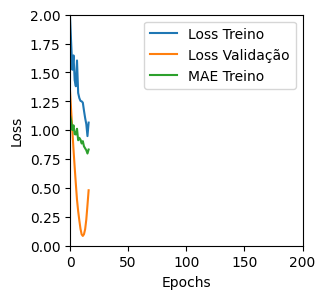

Tempo de treino: 0.09077065388361613 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29535600543022156 , MAE = 0.4062364995479584'

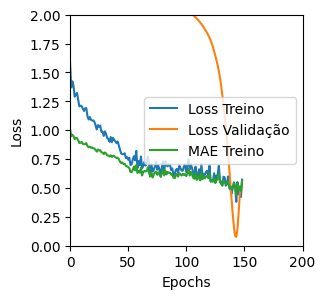

Tempo de treino: 0.21444149414698283 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2272830605506897 , MAE = 0.3364735543727875'

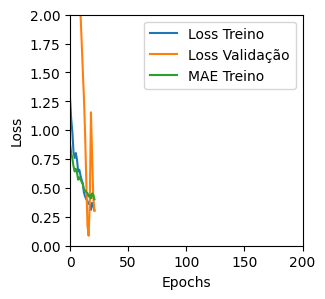

Tempo de treino: 0.09009398619333903 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18524682521820068 , MAE = 0.3074865937232971'

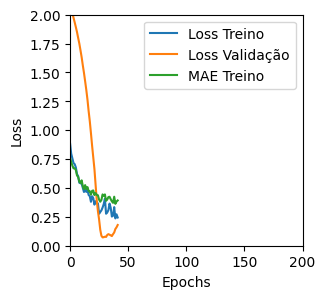

Tempo de treino: 0.10553636153539021 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6682155132293701 , MAE = 0.6147093772888184'

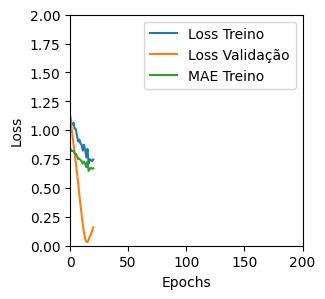

Tempo de treino: 0.07363627751668295 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2306862771511078 , MAE = 0.3441743850708008'

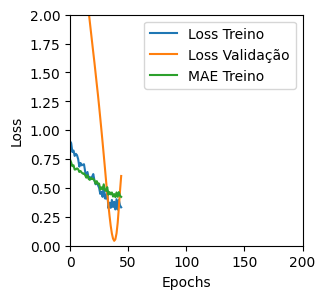

Tempo de treino: 0.12168696324030558 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5153738260269165 , MAE = 0.5532427430152893'

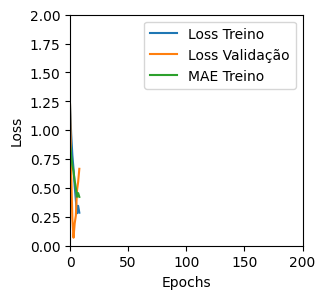

Tempo de treino: 0.054910091559092204 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2873602509498596 , MAE = 0.4143688678741455'

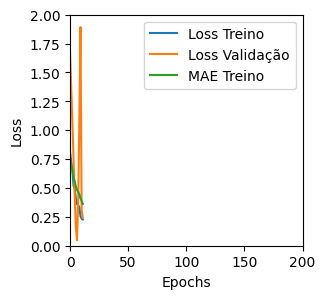

Tempo de treino: 0.07213555574417115 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5033571124076843 , MAE = 0.5428644418716431'

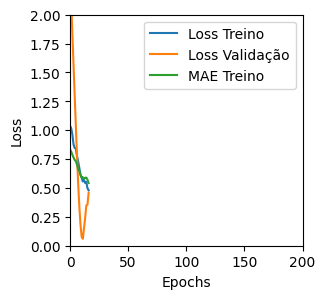

Tempo de treino: 0.08392628828684488 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24397429823875427 , MAE = 0.3566104769706726'

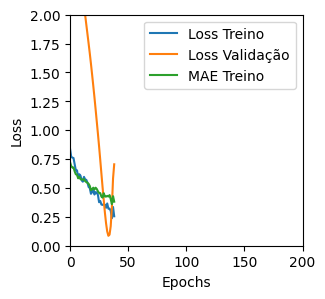

Tempo de treino: 0.12946877082188923 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3267277479171753 , MAE = 0.44474902749061584'

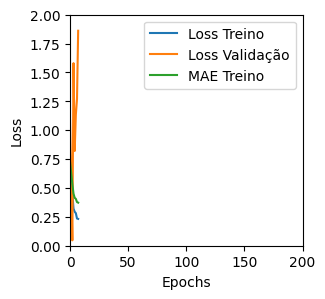

Tempo de treino: 0.06064809958140056 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2515256404876709 , MAE = 0.36717838048934937'

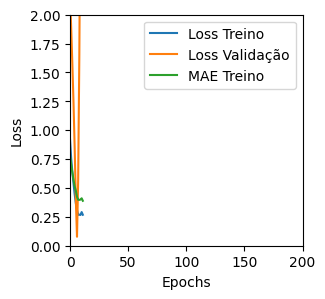

Tempo de treino: 0.07697770992914836 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2674200236797333 , MAE = 0.39059868454933167'

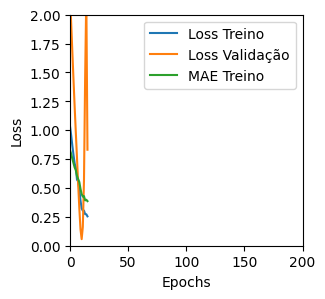

Tempo de treino: 0.05793216625849406 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2477816641330719 , MAE = 0.3653873801231384'

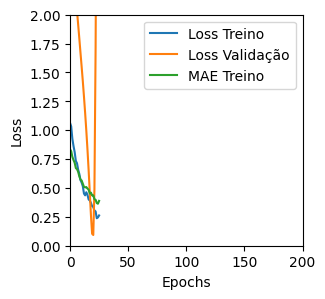

Tempo de treino: 0.06558378140131632 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3320108652114868 , MAE = 0.44012537598609924'

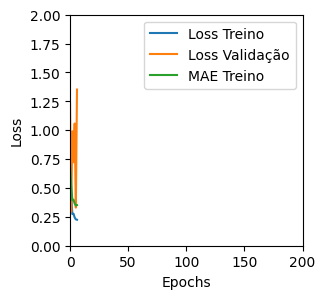

Tempo de treino: 0.07519555886586507 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.228643536567688 , MAE = 0.36101728677749634'

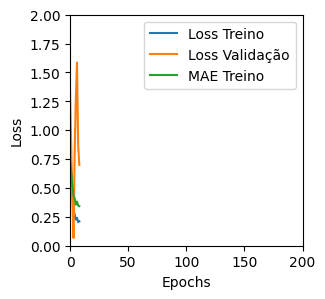

Tempo de treino: 0.056445387999216716 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26288366317749023 , MAE = 0.37646129727363586'

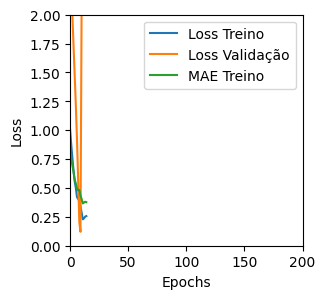

Tempo de treino: 0.09987044334411621 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.274936705827713 , MAE = 0.4019278585910797'

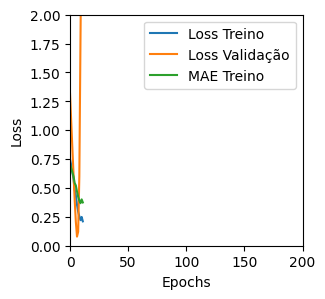

Tempo de treino: 0.06972151597340902 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044531628489494324 , MAE = 0.16163039207458496'

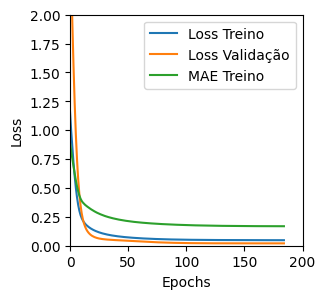

Tempo de treino: 0.5150857130686443 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049510907381772995 , MAE = 0.17109917104244232'

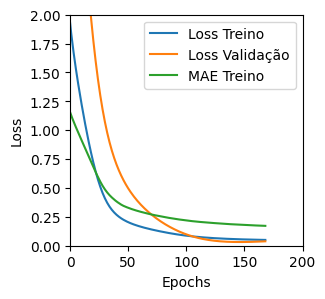

Tempo de treino: 0.3901410142580668 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08118284493684769 , MAE = 0.22549712657928467'

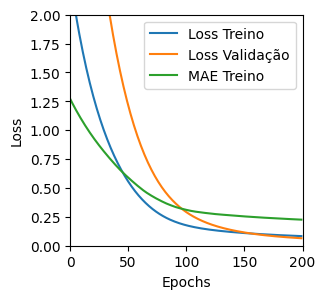

Tempo de treino: 0.3889309565226237 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11045266687870026 , MAE = 0.2647557258605957'

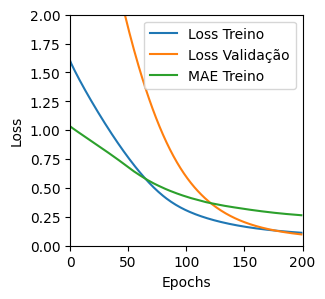

Tempo de treino: 0.24869186878204347 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042309217154979706 , MAE = 0.15762875974178314'

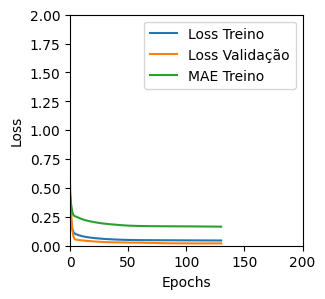

Tempo de treino: 0.7472757379213969 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04451762139797211 , MAE = 0.16241562366485596'

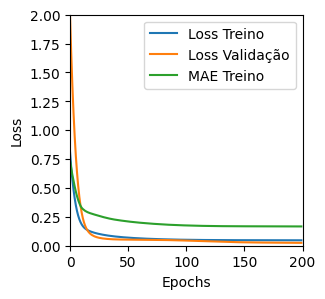

Tempo de treino: 0.3872371673583984 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04397999122738838 , MAE = 0.16319642961025238'

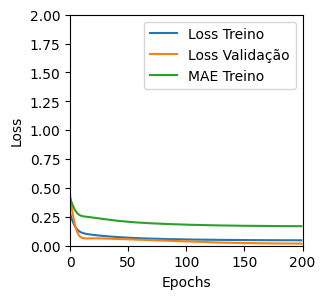

Tempo de treino: 0.38240413268407186 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05512673407793045 , MAE = 0.1855219155550003'

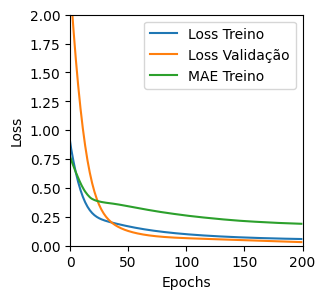

Tempo de treino: 0.38771945238113403 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04238828644156456 , MAE = 0.15669092535972595'

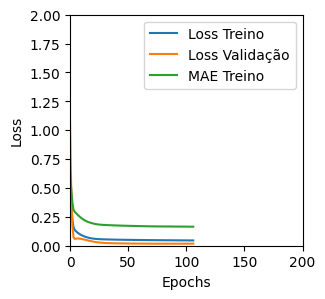

Tempo de treino: 0.38149970372517905 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04240303486585617 , MAE = 0.15786106884479523'

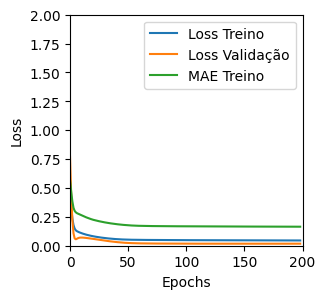

Tempo de treino: 0.7481252948443095 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044746942818164825 , MAE = 0.16214372217655182'

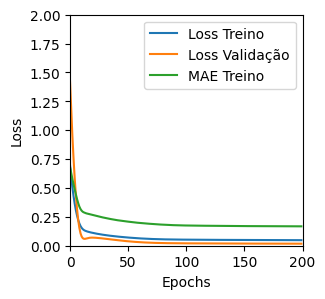

Tempo de treino: 0.38346632321675617 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17760688066482544 , MAE = 0.34673747420310974'

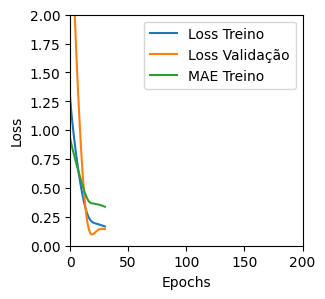

Tempo de treino: 0.09317409197489421 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043026573956012726 , MAE = 0.15732961893081665'

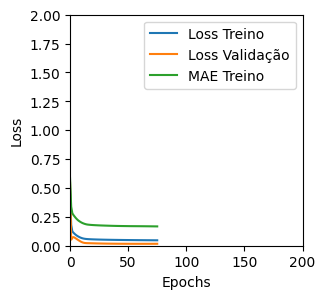

Tempo de treino: 0.3864368995030721 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04206171631813049 , MAE = 0.1567857563495636'

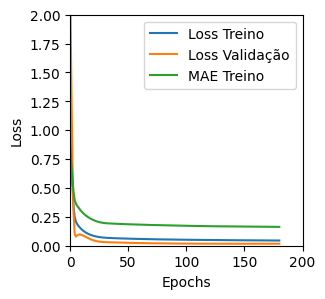

Tempo de treino: 0.3829406976699829 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20198653638362885 , MAE = 0.3549703359603882'

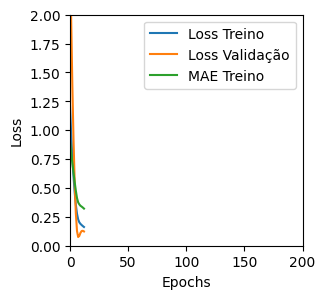

Tempo de treino: 0.10616294542948405 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1657918244600296 , MAE = 0.32476159930229187'

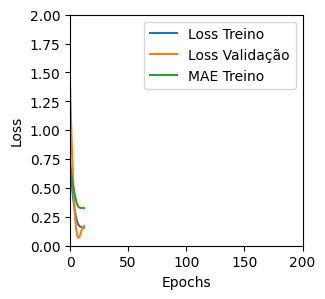

Tempo de treino: 0.07652889092763265 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042764075100421906 , MAE = 0.15537549555301666'

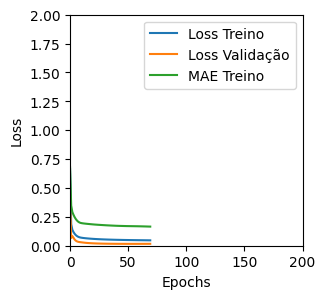

Tempo de treino: 0.38289265235265096 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03985008969902992 , MAE = 0.14964976906776428'

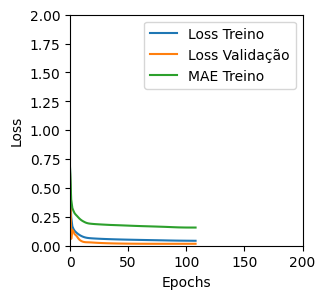

Tempo de treino: 0.24411388238271078 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1594705432653427 , MAE = 0.31202512979507446'

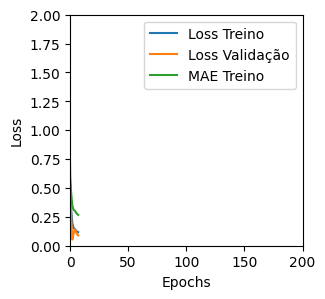

Tempo de treino: 0.06532793839772542 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17614178359508514 , MAE = 0.32675790786743164'

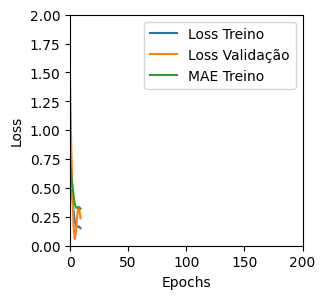

Tempo de treino: 0.10019787947336832 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12235646694898605 , MAE = 0.25925520062446594'

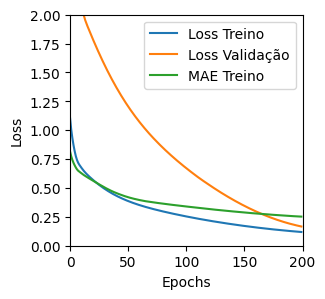

Tempo de treino: 0.9252144376436869 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06116696447134018 , MAE = 0.18544574081897736'

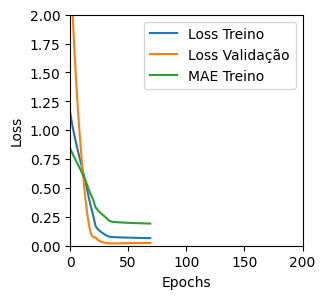

Tempo de treino: 0.22159007390340169 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3438725471496582 , MAE = 0.44258952140808105'

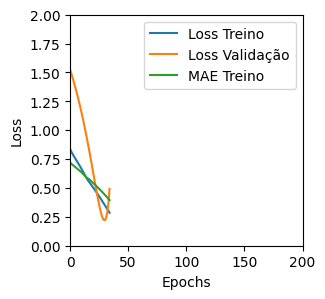

Tempo de treino: 0.103672989209493 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.576621413230896 , MAE = 0.5725414752960205'

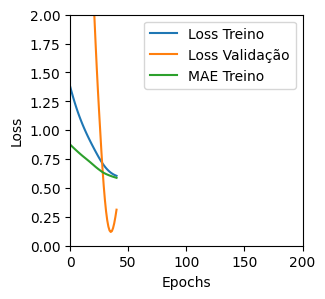

Tempo de treino: 0.12088900407155355 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33236703276634216 , MAE = 0.42627111077308655'

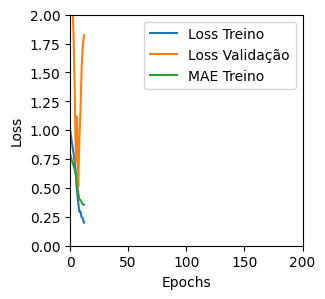

Tempo de treino: 0.13438407182693482 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19867722690105438 , MAE = 0.31821030378341675'

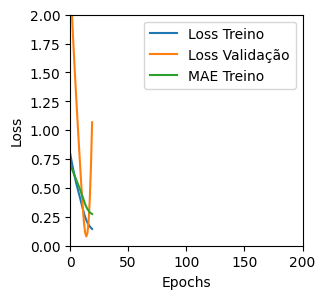

Tempo de treino: 0.2064988096555074 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36341679096221924 , MAE = 0.3982163965702057'

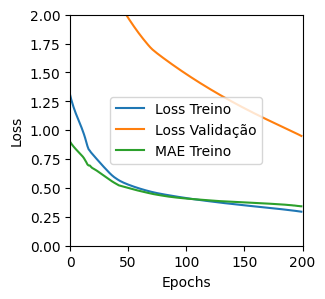

Tempo de treino: 0.4223299225171407 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6054622530937195 , MAE = 0.6136612296104431'

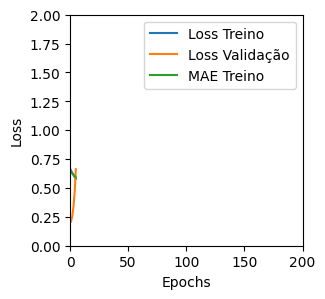

Tempo de treino: 0.06270336310068766 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5443823933601379 , MAE = 0.5632681846618652'

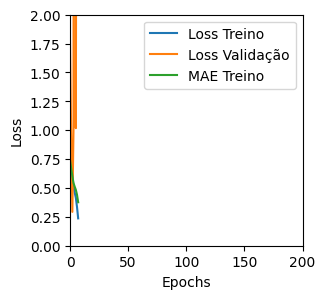

Tempo de treino: 0.08643199205398559 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41208022832870483 , MAE = 0.4940873086452484'

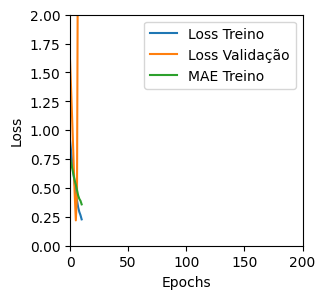

Tempo de treino: 0.08001710573832194 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3821527063846588 , MAE = 0.46807152032852173'

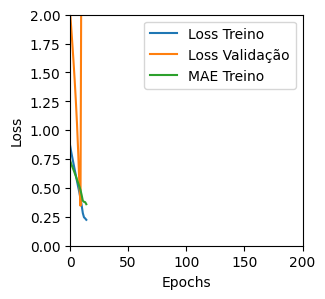

Tempo de treino: 0.06450105905532837 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47139886021614075 , MAE = 0.5170694589614868'

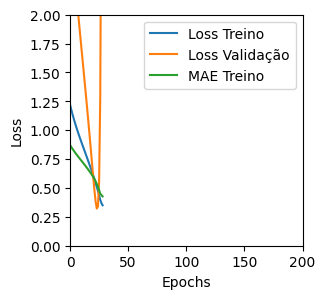

Tempo de treino: 0.07118178208669027 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5293129682540894 , MAE = 0.5773385167121887'

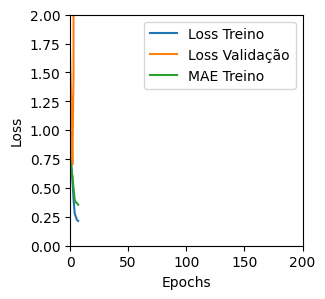

Tempo de treino: 0.08705681165059408 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.471139520406723 , MAE = 0.5254732966423035'

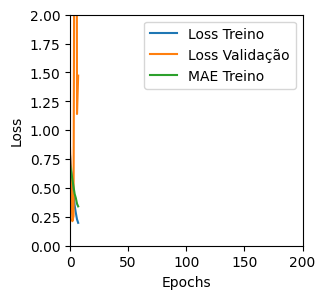

Tempo de treino: 0.09717893600463867 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3107759952545166 , MAE = 0.41430383920669556'

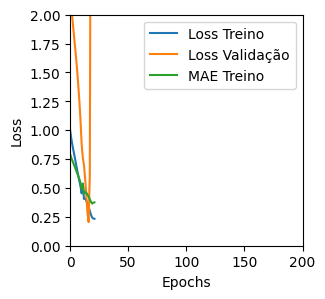

Tempo de treino: 0.09464348157246907 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.358035683631897 , MAE = 0.42902493476867676'

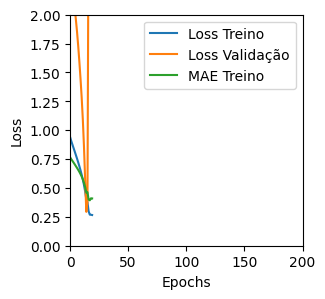

Tempo de treino: 0.08203527927398682 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09464190155267715 , MAE = 0.23031193017959595'

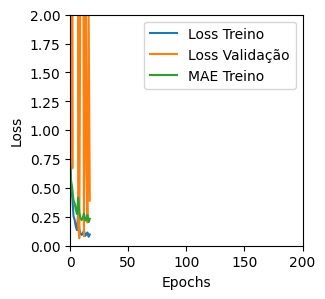

Tempo de treino: 0.149087393283844 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3618098795413971 , MAE = 0.46155864000320435'

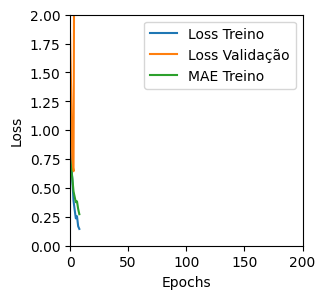

Tempo de treino: 0.0690936009089152 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41577649116516113 , MAE = 0.49514901638031006'

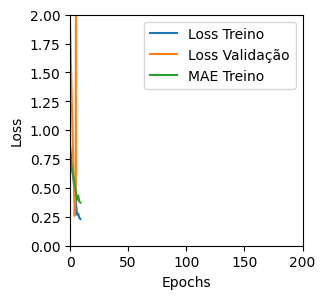

Tempo de treino: 0.06866345008214315 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3990890085697174 , MAE = 0.4812715947628021'

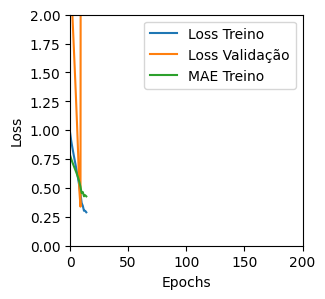

Tempo de treino: 0.06005621751149495 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5878274440765381 , MAE = 0.5592806935310364'

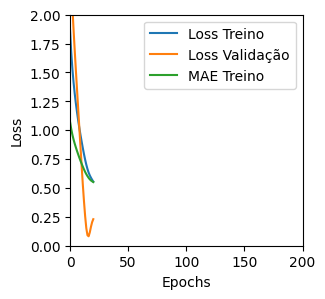

Tempo de treino: 0.24952962398529052 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3408709764480591 , MAE = 0.40664416551589966'

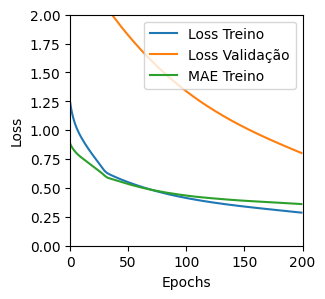

Tempo de treino: 0.735587461789449 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35200235247612 , MAE = 0.44606372714042664'

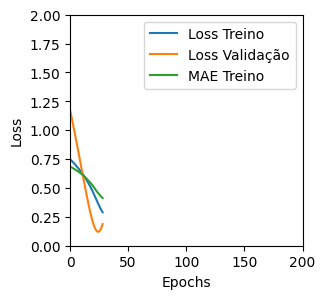

Tempo de treino: 0.1271670619646708 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44915536046028137 , MAE = 0.454738587141037'

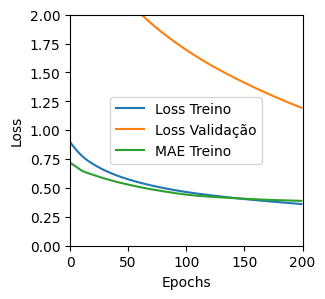

Tempo de treino: 0.37935558557510374 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6004313230514526 , MAE = 0.6043708324432373'

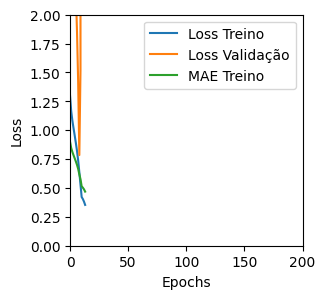

Tempo de treino: 0.10771451791127523 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34294819831848145 , MAE = 0.45060867071151733'

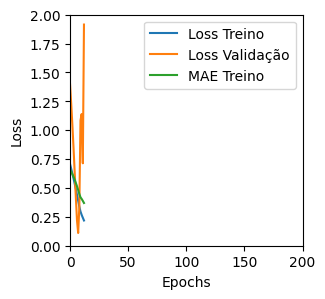

Tempo de treino: 0.07884487311045328 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4570576846599579 , MAE = 0.5104183554649353'

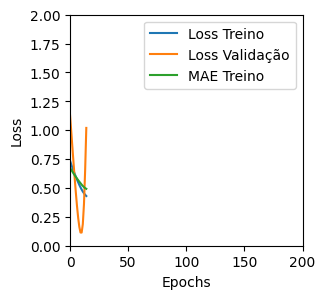

Tempo de treino: 0.06157412926355998 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7005026936531067 , MAE = 0.6441172957420349'

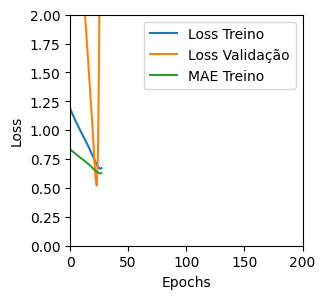

Tempo de treino: 0.1214276949564616 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43170589208602905 , MAE = 0.5017749071121216'

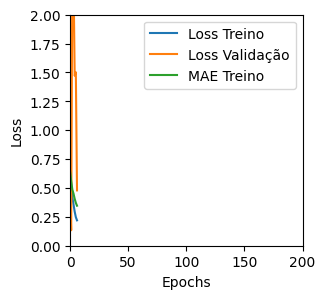

Tempo de treino: 0.11952122449874877 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4478190243244171 , MAE = 0.5090922713279724'

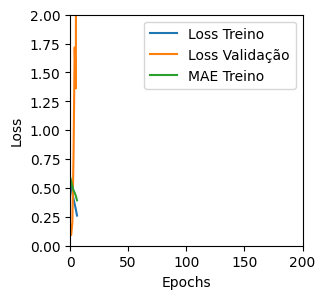

Tempo de treino: 0.09396793047587076 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5525867938995361 , MAE = 0.5659770369529724'

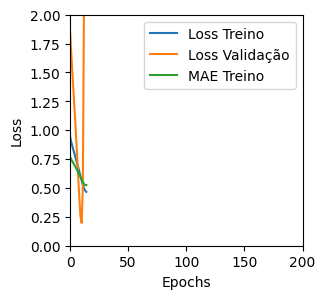

Tempo de treino: 0.06898514827092489 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3113049566745758 , MAE = 0.4121185839176178'

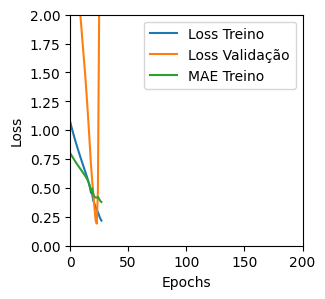

Tempo de treino: 0.0852026104927063 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33546704053878784 , MAE = 0.41260549426078796'

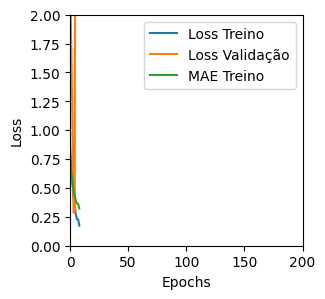

Tempo de treino: 0.12654571930567424 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2838083803653717 , MAE = 0.38610321283340454'

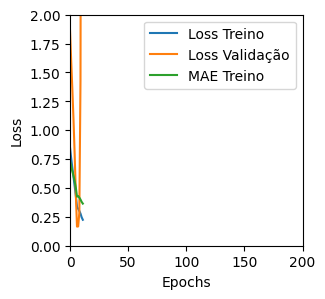

Tempo de treino: 0.0803668220837911 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5724055171012878 , MAE = 0.5752256512641907'

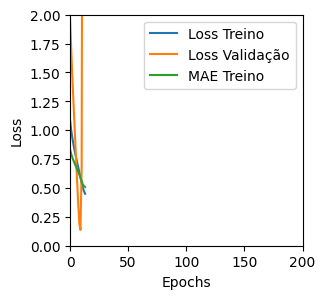

Tempo de treino: 0.08365661303202311 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4776725769042969 , MAE = 0.534721851348877'

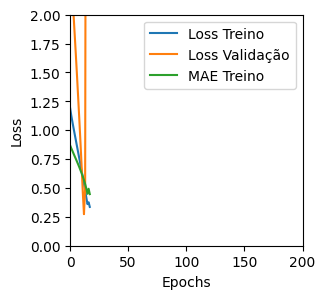

Tempo de treino: 0.09579890171686808 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35552820563316345 , MAE = 0.4630080759525299'

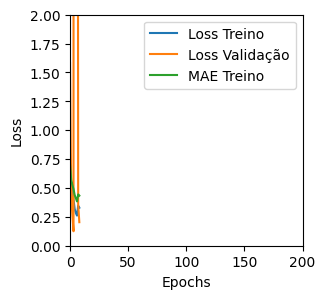

Tempo de treino: 0.09741203784942627 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4951704144477844 , MAE = 0.5472431778907776'

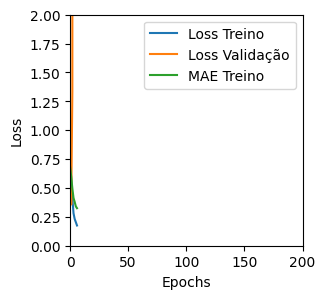

Tempo de treino: 0.08540750741958618 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2919151484966278 , MAE = 0.39235755801200867'

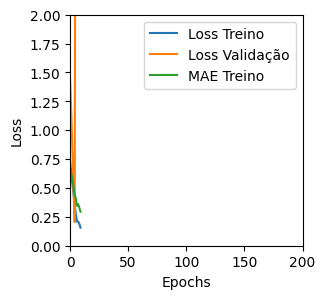

Tempo de treino: 0.08059242963790894 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5061859488487244 , MAE = 0.532588005065918'

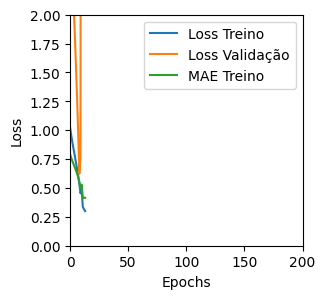

Tempo de treino: 0.06317464907964071 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5747560262680054 , MAE = 0.5811905860900879'

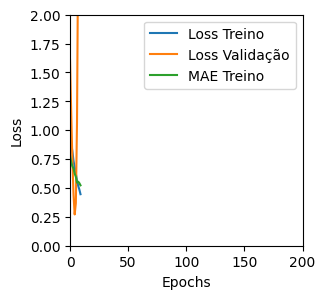

Tempo de treino: 0.08872242371241251 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35685229301452637 , MAE = 0.45903655886650085'

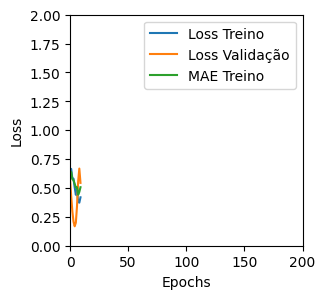

Tempo de treino: 0.08938066562016805 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40511447191238403 , MAE = 0.4422718286514282'

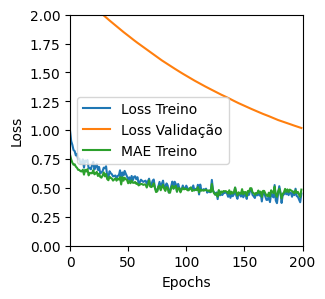

Tempo de treino: 0.4343114574750265 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3149518072605133 , MAE = 0.42527493834495544'

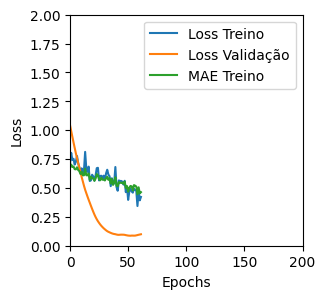

Tempo de treino: 0.12733342250188193 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4931623041629791 , MAE = 0.5337302684783936'

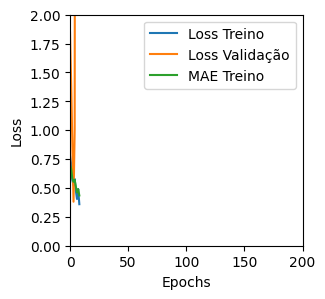

Tempo de treino: 0.13869800964991252 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41237613558769226 , MAE = 0.4969925582408905'

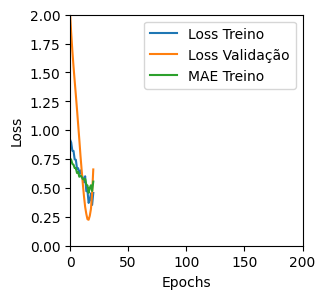

Tempo de treino: 0.12410291830698648 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5410500168800354 , MAE = 0.5397364497184753'

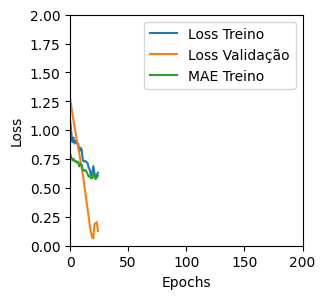

Tempo de treino: 0.08028036753336588 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6068479418754578 , MAE = 0.5973862409591675'

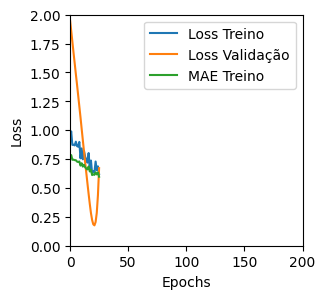

Tempo de treino: 0.08005188703536988 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3786316215991974 , MAE = 0.44803303480148315'

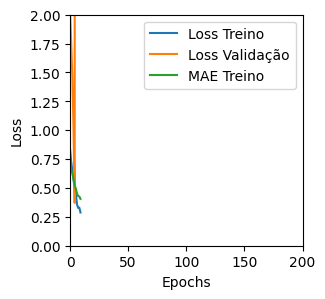

Tempo de treino: 0.10497866868972779 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30982354283332825 , MAE = 0.4288250505924225'

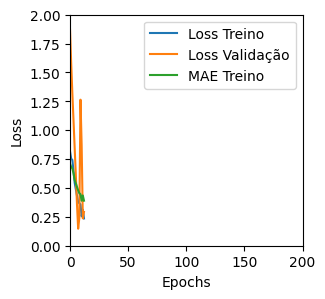

Tempo de treino: 0.09992442925771078 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48272594809532166 , MAE = 0.5211728811264038'

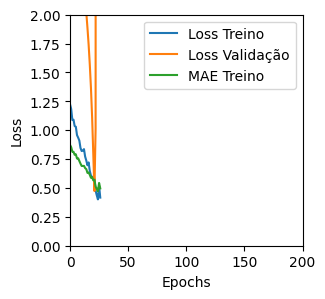

Tempo de treino: 0.1283788800239563 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3140571117401123 , MAE = 0.4294915795326233'

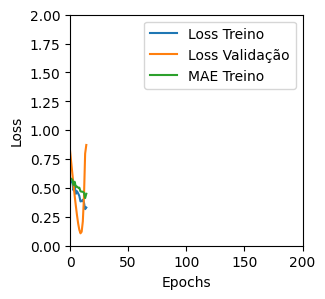

Tempo de treino: 0.0853697419166565 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41465234756469727 , MAE = 0.5021845102310181'

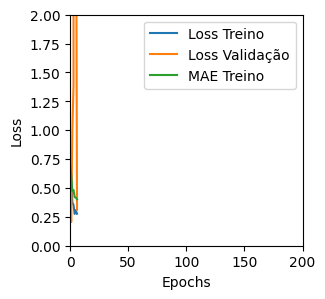

Tempo de treino: 0.07918148040771485 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3846515119075775 , MAE = 0.4228776693344116'

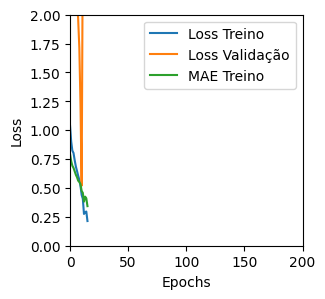

Tempo de treino: 0.12215736309687296 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3850248456001282 , MAE = 0.43253111839294434'

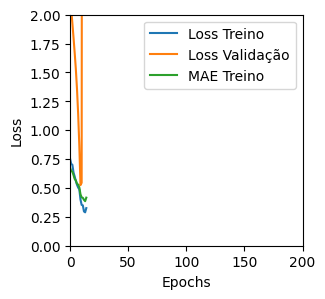

Tempo de treino: 0.07886017163594564 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3716045618057251 , MAE = 0.4677741527557373'

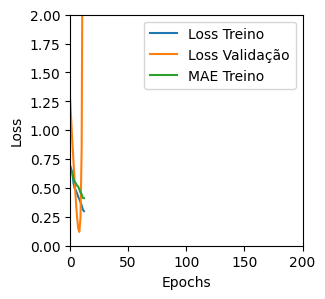

Tempo de treino: 0.07874056498209635 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14332547783851624 , MAE = 0.2688305079936981'

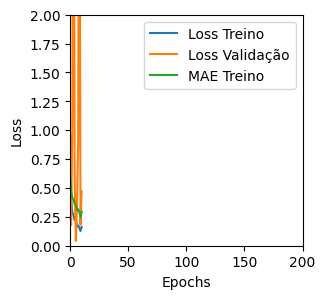

Tempo de treino: 0.16691936254501344 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.543447732925415 , MAE = 0.5688058733940125'

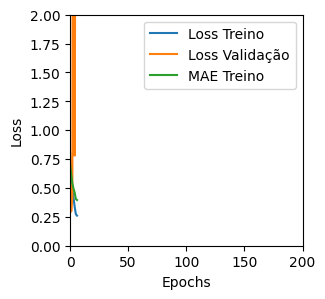

Tempo de treino: 0.07288366556167603 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30894121527671814 , MAE = 0.40049174427986145'

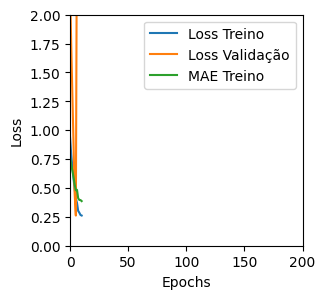

Tempo de treino: 0.08354178269704184 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3105471730232239 , MAE = 0.401864618062973'

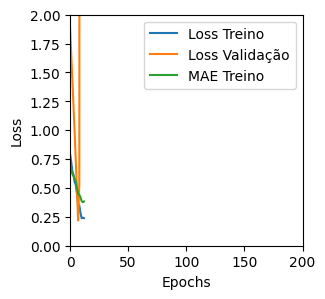

Tempo de treino: 0.07217106024424234 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04540077969431877 , MAE = 0.16416773200035095'

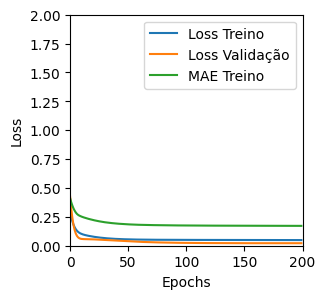

Tempo de treino: 1.420236841837565 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11269295960664749 , MAE = 0.26854822039604187'

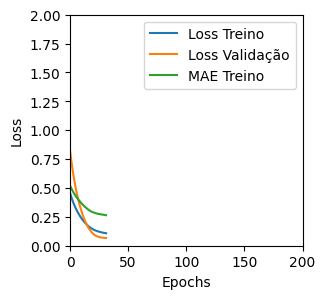

Tempo de treino: 0.1534493645032247 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07210062444210052 , MAE = 0.19709686934947968'

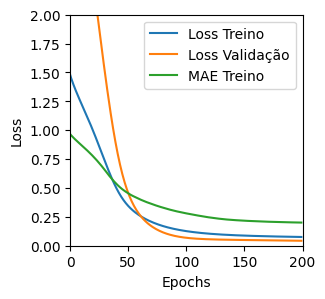

Tempo de treino: 0.4740579207738241 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13152244687080383 , MAE = 0.2958514988422394'

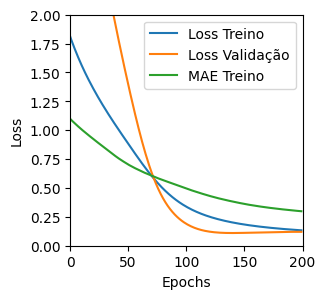

Tempo de treino: 0.3351221323013306 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045534033328294754 , MAE = 0.1656217873096466'

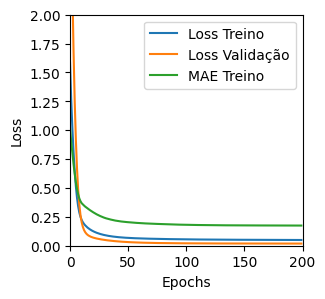

Tempo de treino: 1.428882896900177 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10489609092473984 , MAE = 0.2558237910270691'

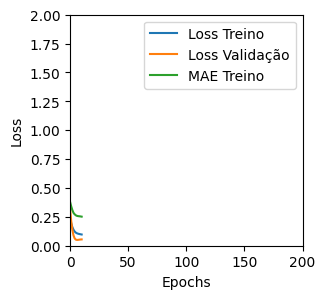

Tempo de treino: 0.09143366813659667 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.052368707954883575 , MAE = 0.17877021431922913'

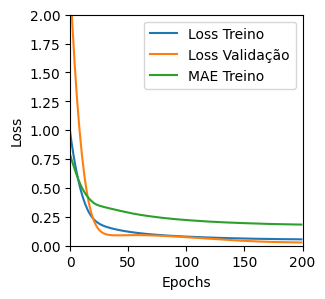

Tempo de treino: 0.7604930917421977 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21138246357440948 , MAE = 0.3847665786743164'

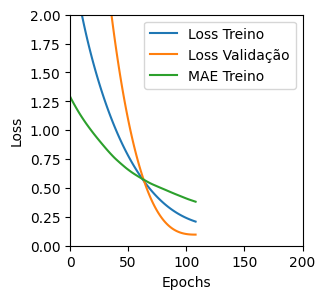

Tempo de treino: 0.39090375502904257 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04457889497280121 , MAE = 0.162605419754982'

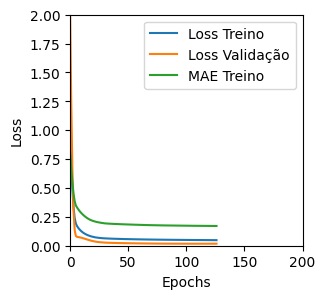

Tempo de treino: 0.7382601459821065 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04606613889336586 , MAE = 0.16520386934280396'

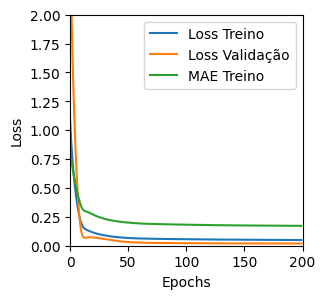

Tempo de treino: 0.6469241380691528 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17914964258670807 , MAE = 0.3320171535015106'

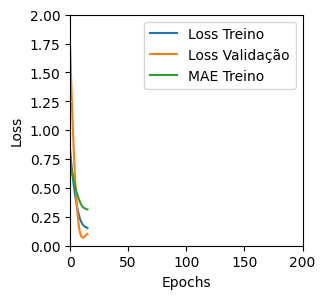

Tempo de treino: 0.09476368029912313 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1908705085515976 , MAE = 0.3500119149684906'

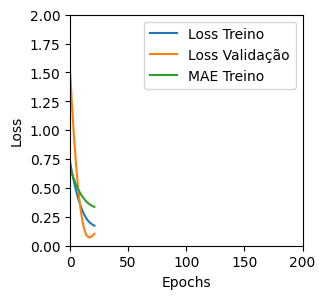

Tempo de treino: 0.12083009481430054 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04675401374697685 , MAE = 0.1681232750415802'

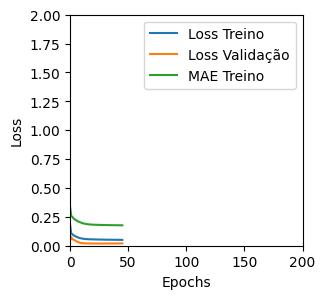

Tempo de treino: 0.3375935594240824 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04621466249227524 , MAE = 0.16642680764198303'

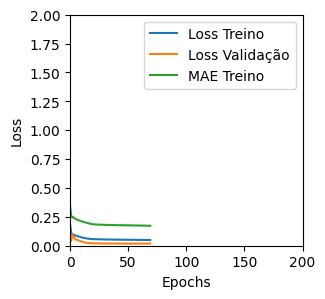

Tempo de treino: 0.290004575252533 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12175726145505905 , MAE = 0.27102023363113403'

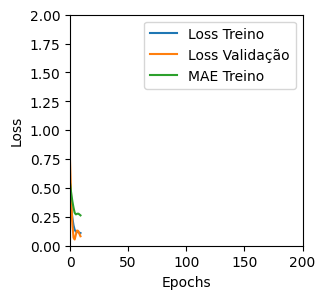

Tempo de treino: 0.07670381069183349 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26844653487205505 , MAE = 0.40675199031829834'

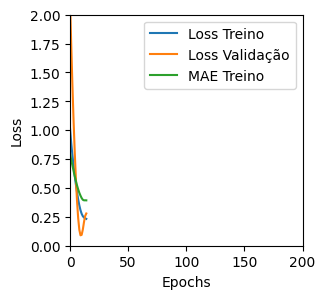

Tempo de treino: 0.133486274878184 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050782497972249985 , MAE = 0.1726110279560089'

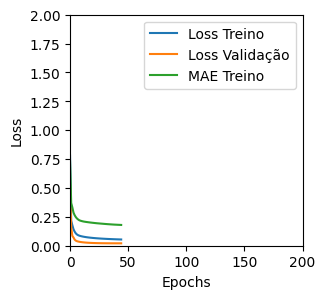

Tempo de treino: 0.4022920767466227 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04125320911407471 , MAE = 0.15376470983028412'

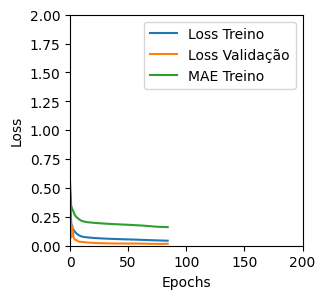

Tempo de treino: 0.389891509215037 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04985608905553818 , MAE = 0.17168717086315155'

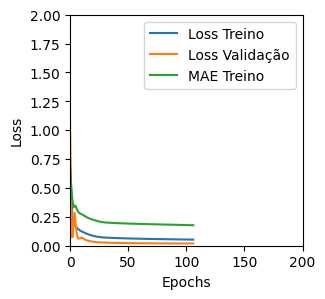

Tempo de treino: 0.2749855875968933 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19188284873962402 , MAE = 0.3386586904525757'

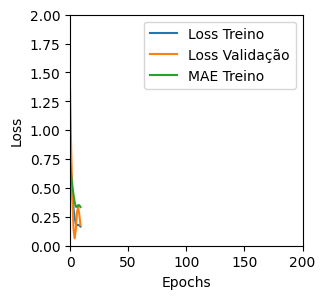

Tempo de treino: 0.07845596869786581 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15579387545585632 , MAE = 0.28283053636550903'

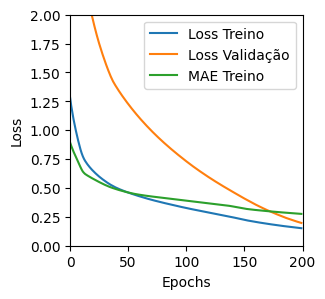

Tempo de treino: 1.4361076871554057 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3770395815372467 , MAE = 0.48416242003440857'

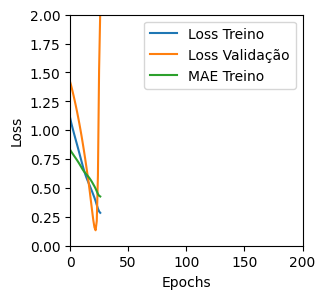

Tempo de treino: 0.14353920618693033 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.213631510734558 , MAE = 0.905514657497406'

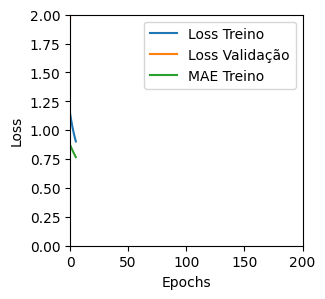

Tempo de treino: 0.0571176290512085 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46315470337867737 , MAE = 0.5517541766166687'

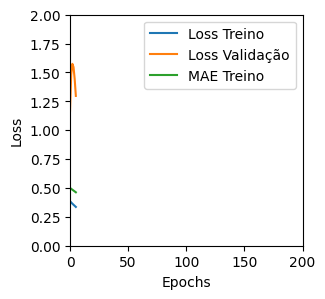

Tempo de treino: 0.06498550573984782 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5028122663497925 , MAE = 0.50704425573349'

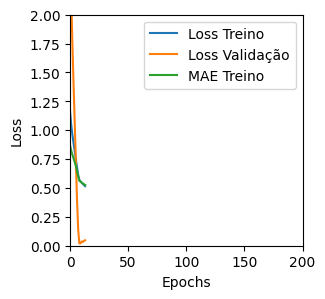

Tempo de treino: 0.11280418237050374 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7583069205284119 , MAE = 0.6631854772567749'

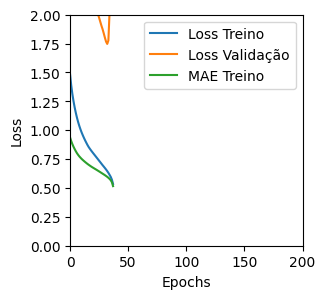

Tempo de treino: 0.20741047859191894 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25928959250450134 , MAE = 0.3696591854095459'

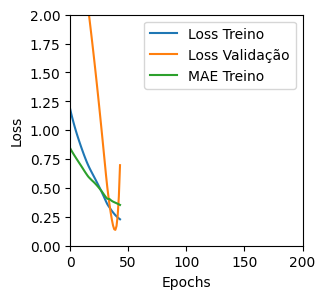

Tempo de treino: 0.12895213762919108 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35291844606399536 , MAE = 0.4295729696750641'

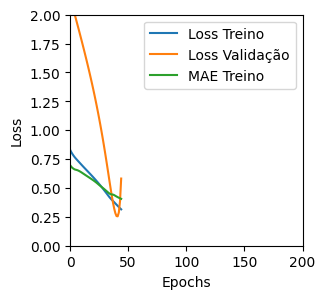

Tempo de treino: 0.1178536335627238 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3432483375072479 , MAE = 0.4328955411911011'

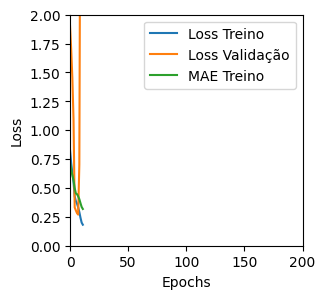

Tempo de treino: 0.13664153416951497 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39750152826309204 , MAE = 0.48549526929855347'

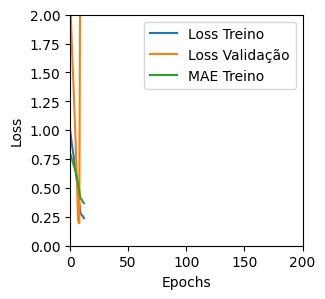

Tempo de treino: 0.13728556235631306 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3212355077266693 , MAE = 0.42264020442962646'

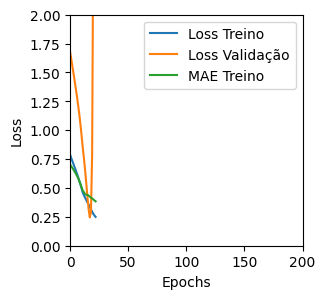

Tempo de treino: 0.09706010421117146 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5045936703681946 , MAE = 0.5500461459159851'

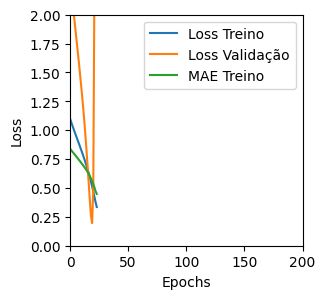

Tempo de treino: 0.07364468971888224 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4300934672355652 , MAE = 0.5047750473022461'

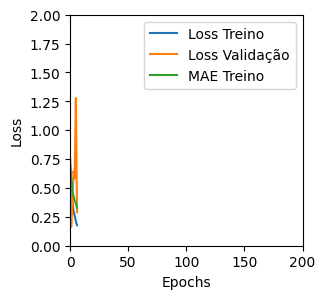

Tempo de treino: 0.08204459349314372 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7132967710494995 , MAE = 0.6634979844093323'

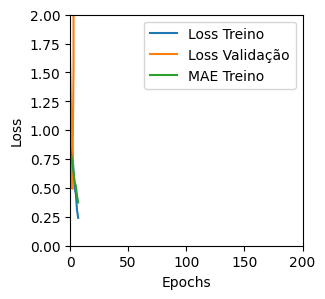

Tempo de treino: 0.08631150722503662 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5891717672348022 , MAE = 0.5921934247016907'

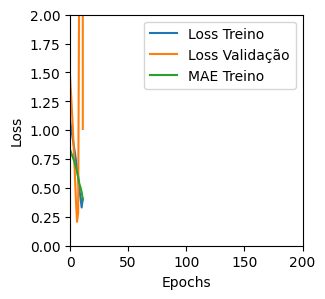

Tempo de treino: 0.06122600634892782 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4164799153804779 , MAE = 0.4916914105415344'

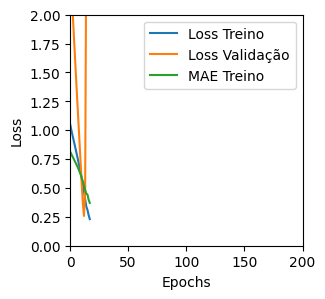

Tempo de treino: 0.11809768279393514 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3141585886478424 , MAE = 0.4273990988731384'

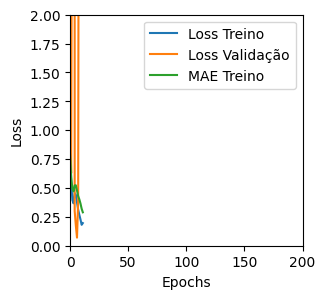

Tempo de treino: 0.12696528434753418 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33190229535102844 , MAE = 0.4418691396713257'

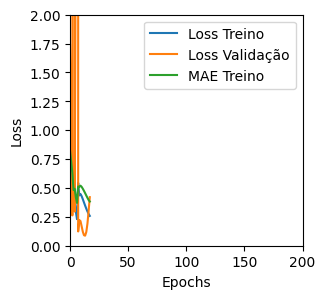

Tempo de treino: 0.13647300799687703 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45600995421409607 , MAE = 0.513121485710144'

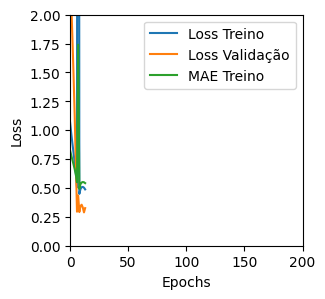

Tempo de treino: 0.08283884525299072 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38781291246414185 , MAE = 0.4786404073238373'

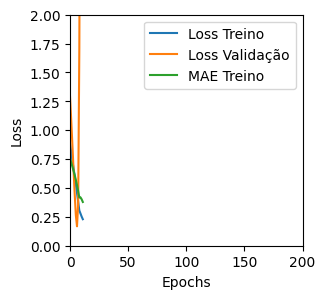

Tempo de treino: 0.0847618818283081 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7258448600769043 , MAE = 0.652102530002594'

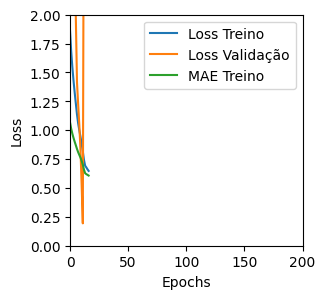

Tempo de treino: 0.13817736705144246 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2778776288032532 , MAE = 0.4203512668609619'

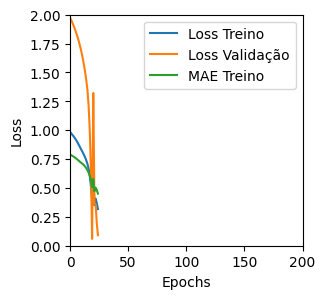

Tempo de treino: 0.12147160371144612 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17678499221801758 , MAE = 0.332241028547287'

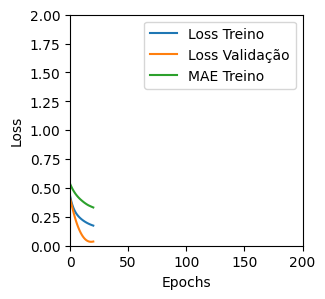

Tempo de treino: 0.12281533082326253 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26855096220970154 , MAE = 0.39087724685668945'

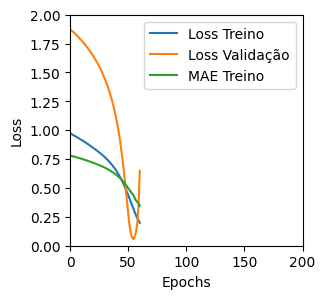

Tempo de treino: 0.14730183283487955 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7211982011795044 , MAE = 0.6739600300788879'

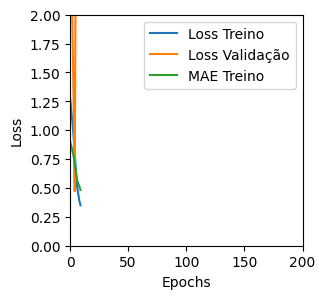

Tempo de treino: 0.09862738450368246 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7906541228294373 , MAE = 0.6940222382545471'

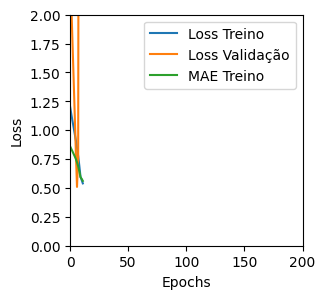

Tempo de treino: 0.12516565720240275 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.445835679769516 , MAE = 0.5259832143783569'

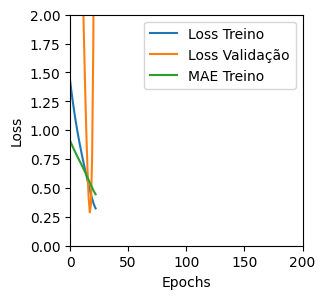

Tempo de treino: 0.08404415845870972 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3434489369392395 , MAE = 0.45476600527763367'

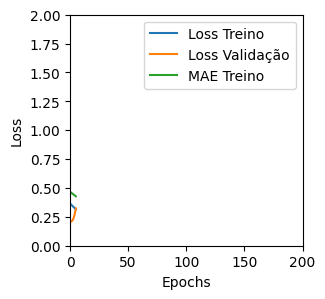

Tempo de treino: 0.05918722152709961 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.317904531955719 , MAE = 0.4276237487792969'

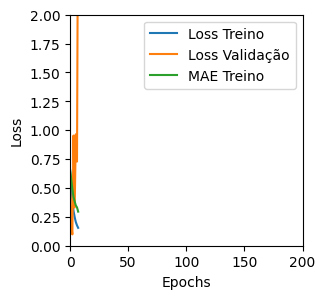

Tempo de treino: 0.12276907761891682 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5113982558250427 , MAE = 0.5435405969619751'

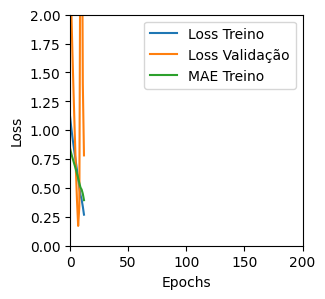

Tempo de treino: 0.162528133392334 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4925956726074219 , MAE = 0.5471886992454529'

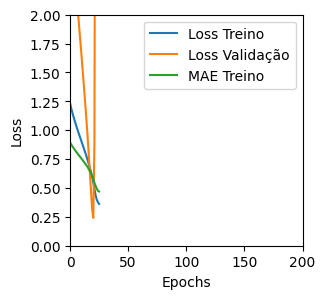

Tempo de treino: 0.10920459429423014 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6210883259773254 , MAE = 0.6032971739768982'

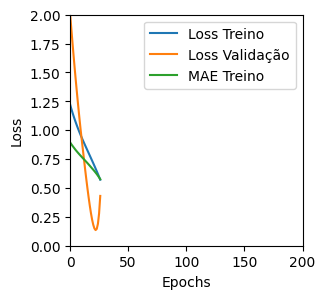

Tempo de treino: 0.083254079023997 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3376884460449219 , MAE = 0.44026607275009155'

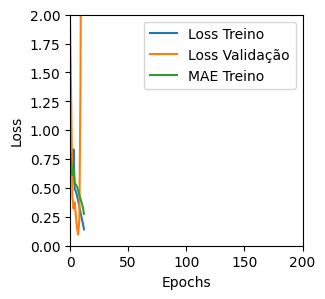

Tempo de treino: 0.21111569007237752 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6651426553726196 , MAE = 0.6210887432098389'

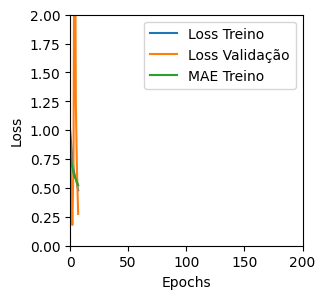

Tempo de treino: 0.08367847998936971 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3551710247993469 , MAE = 0.42509177327156067'

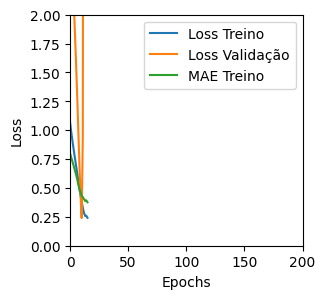

Tempo de treino: 0.07863512833913168 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34496352076530457 , MAE = 0.44800323247909546'

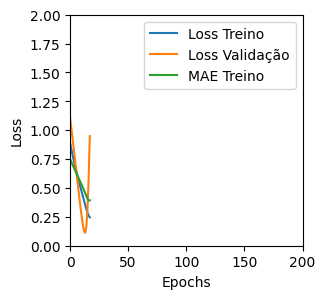

Tempo de treino: 0.07913480997085572 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3923892676830292 , MAE = 0.4746670424938202'

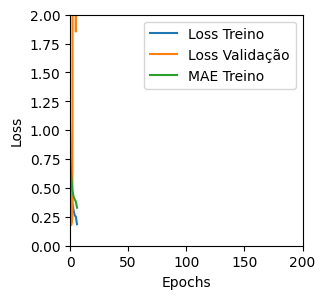

Tempo de treino: 0.12424803972244262 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.458747535943985 , MAE = 0.5257262587547302'

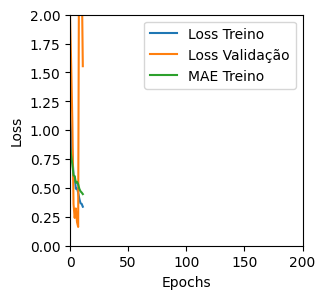

Tempo de treino: 0.13168756564458212 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42673152685165405 , MAE = 0.5010361671447754'

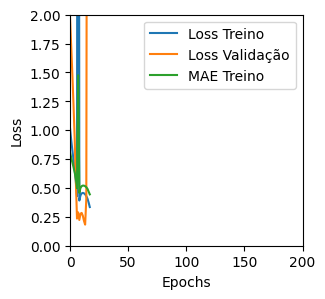

Tempo de treino: 0.08764216899871827 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48272308707237244 , MAE = 0.5320402383804321'

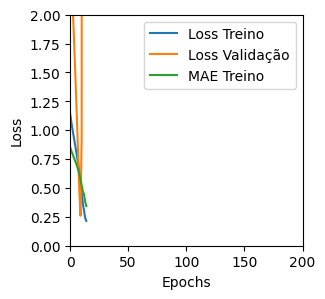

Tempo de treino: 0.07689321041107178 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6484801769256592 , MAE = 0.5886673927307129'

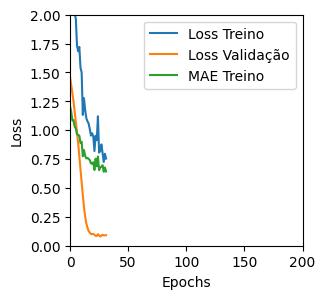

Tempo de treino: 0.2108016053835551 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.047295331954956 , MAE = 0.7934573888778687'

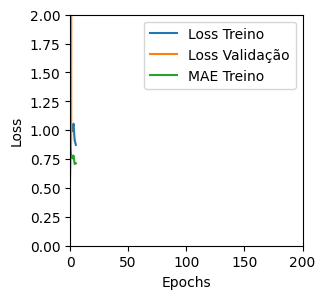

Tempo de treino: 0.0802001953125 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.521001398563385 , MAE = 0.5625463128089905'

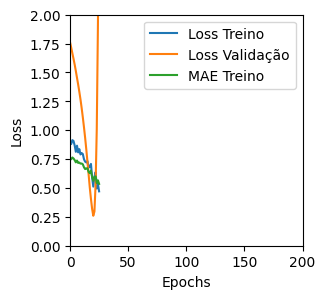

Tempo de treino: 0.1275935928026835 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43191149830818176 , MAE = 0.5156443119049072'

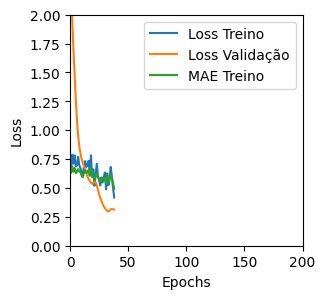

Tempo de treino: 0.1563465714454651 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5228927731513977 , MAE = 0.5578482151031494'

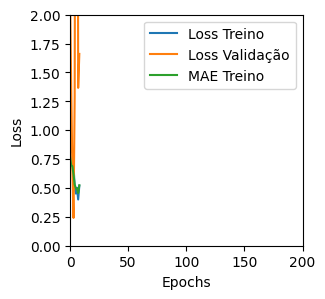

Tempo de treino: 0.10043205817540486 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4058678150177002 , MAE = 0.4848078489303589'

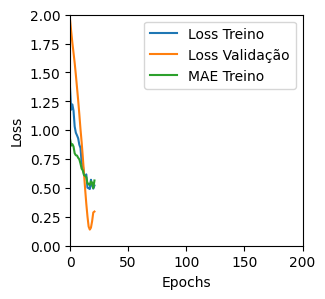

Tempo de treino: 0.13614144325256347 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42244863510131836 , MAE = 0.5071574449539185'

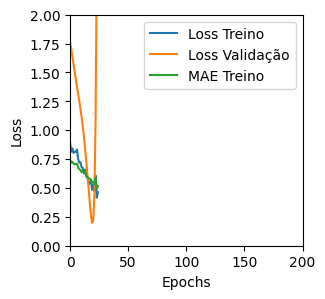

Tempo de treino: 0.09326576789220174 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2906792461872101 , MAE = 0.4113038182258606'

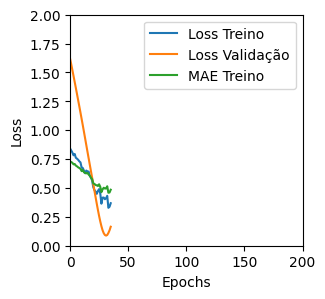

Tempo de treino: 0.12950273354848227 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3792800009250641 , MAE = 0.44921448826789856'

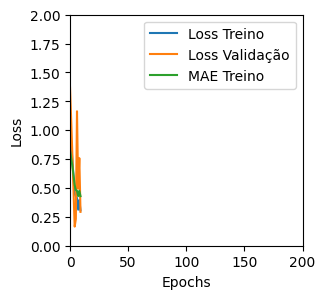

Tempo de treino: 0.10374884208043417 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49176862835884094 , MAE = 0.5306640863418579'

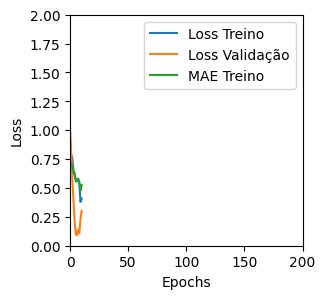

Tempo de treino: 0.0804401159286499 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2338925302028656 , MAE = 0.3633378744125366'

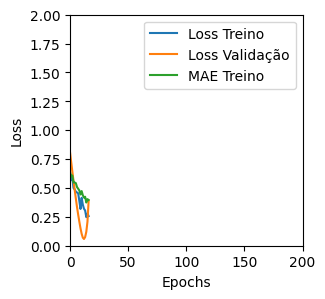

Tempo de treino: 0.10601307948430379 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5081691145896912 , MAE = 0.5445632338523865'

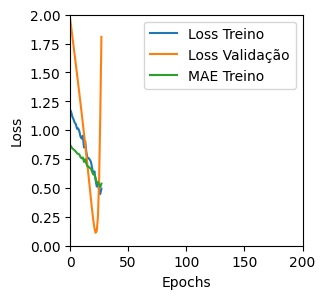

Tempo de treino: 0.09549944003423055 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31858474016189575 , MAE = 0.43560054898262024'

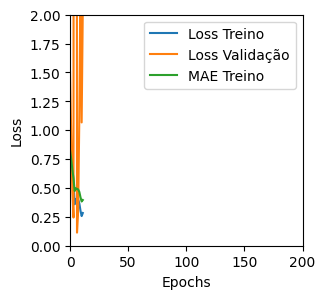

Tempo de treino: 0.13062055905659994 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26857057213783264 , MAE = 0.39425405859947205'

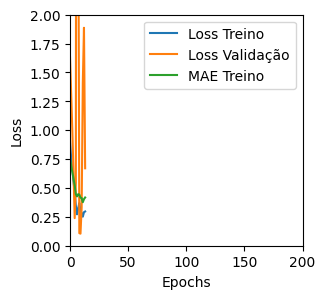

Tempo de treino: 0.1298527757326762 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3277977406978607 , MAE = 0.4275749623775482'

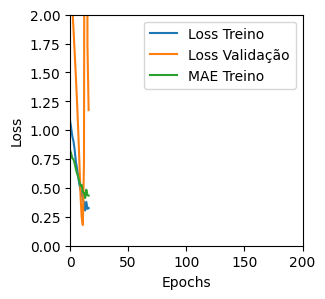

Tempo de treino: 0.08218378623326619 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5142733454704285 , MAE = 0.5524933338165283'

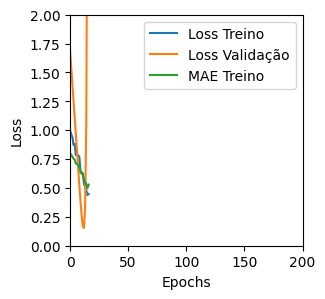

Tempo de treino: 0.08133655389149984 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12035130709409714 , MAE = 0.24495179951190948'

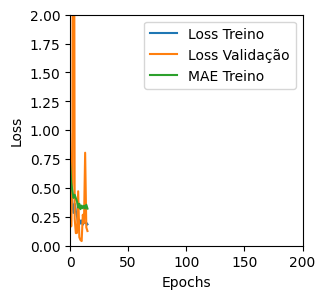

Tempo de treino: 0.15069945255915324 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2689356803894043 , MAE = 0.3853209614753723'

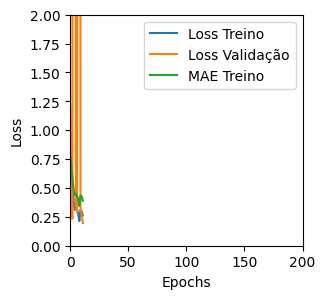

Tempo de treino: 0.1218003233273824 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3946615159511566 , MAE = 0.475101500749588'

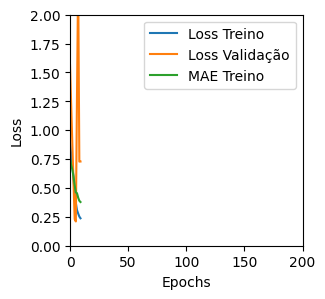

Tempo de treino: 0.10461191336313884 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2828667461872101 , MAE = 0.3903276026248932'

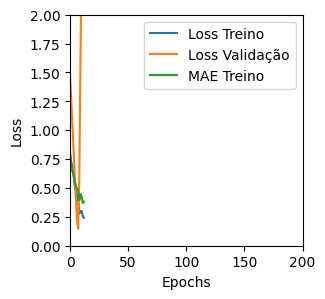

Tempo de treino: 0.10011709531148275 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0997045636177063 , MAE = 0.25177234411239624'

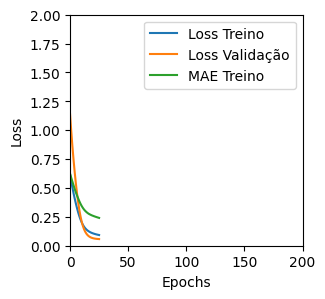

Tempo de treino: 0.23207163016001384 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.055407166481018066 , MAE = 0.1841564178466797'

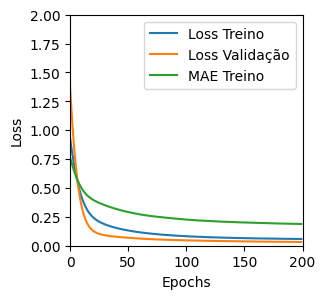

Tempo de treino: 0.8277482827504475 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1136879026889801 , MAE = 0.2667691111564636'

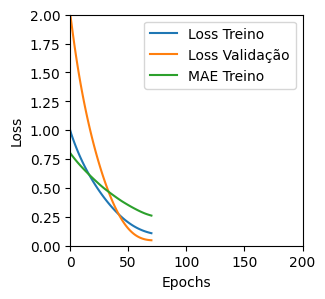

Tempo de treino: 0.2136899471282959 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08449815213680267 , MAE = 0.23204608261585236'

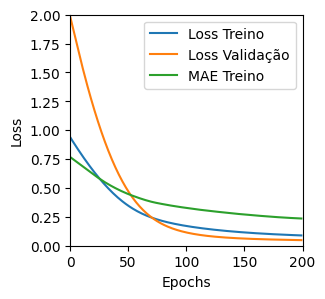

Tempo de treino: 0.4214118719100952 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17742820084095 , MAE = 0.3306642770767212'

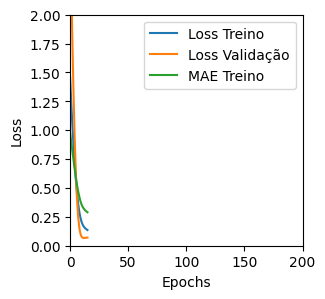

Tempo de treino: 0.23024857838948568 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14592072367668152 , MAE = 0.2988969683647156'

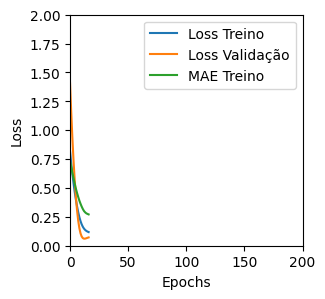

Tempo de treino: 0.13903470834096274 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15008798241615295 , MAE = 0.313009649515152'

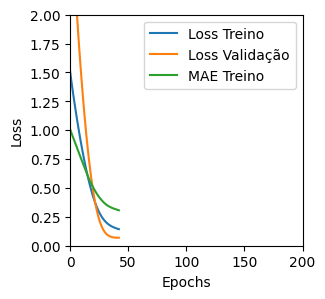

Tempo de treino: 0.152122430006663 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14119285345077515 , MAE = 0.3043712079524994'

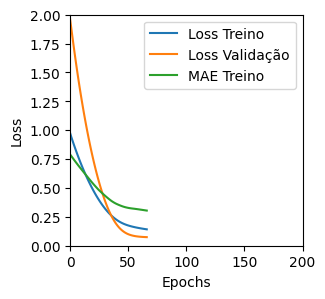

Tempo de treino: 0.228226900100708 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15327565371990204 , MAE = 0.3002876043319702'

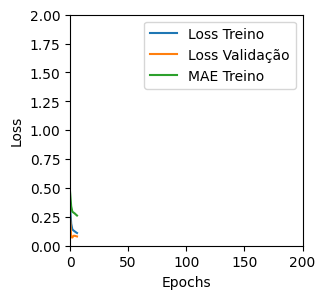

Tempo de treino: 0.15234583218892414 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15189267694950104 , MAE = 0.3025687336921692'

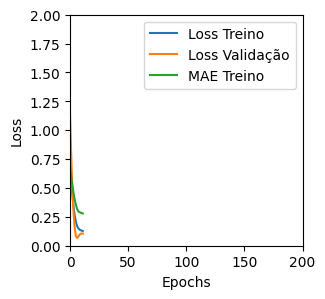

Tempo de treino: 0.12169793844223023 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14305490255355835 , MAE = 0.2903183102607727'

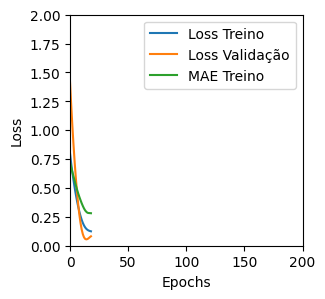

Tempo de treino: 0.10017155011494955 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12780658900737762 , MAE = 0.2713909149169922'

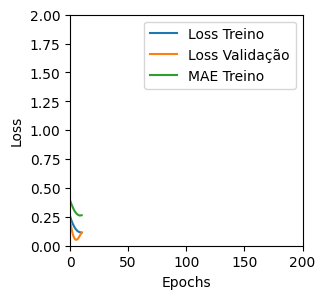

Tempo de treino: 0.08187620639801026 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048856984823942184 , MAE = 0.17125624418258667'

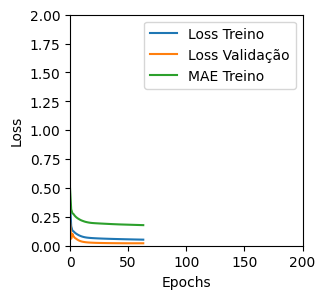

Tempo de treino: 0.730447777112325 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18191054463386536 , MAE = 0.3272697925567627'

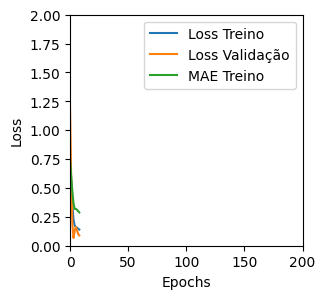

Tempo de treino: 0.13252098162968953 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18520773947238922 , MAE = 0.33408889174461365'

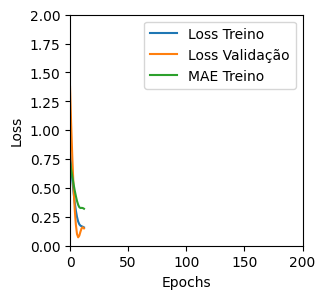

Tempo de treino: 0.10258069038391113 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17468804121017456 , MAE = 0.31910815834999084'

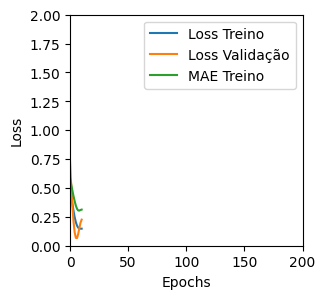

Tempo de treino: 0.09258983135223389 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04871390759944916 , MAE = 0.1693401336669922'

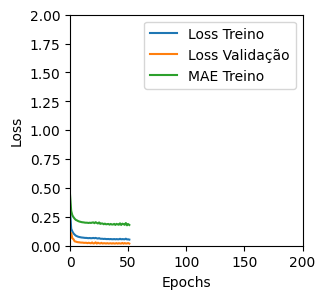

Tempo de treino: 0.7406469980875651 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05019458755850792 , MAE = 0.17331771552562714'

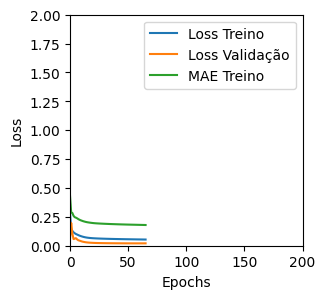

Tempo de treino: 0.3361773769060771 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18819577991962433 , MAE = 0.33287087082862854'

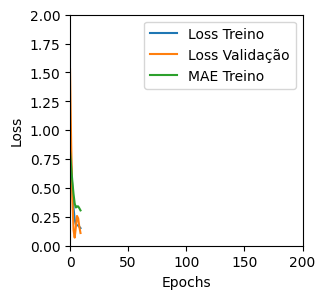

Tempo de treino: 0.10015218257904053 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22442927956581116 , MAE = 0.36782121658325195'

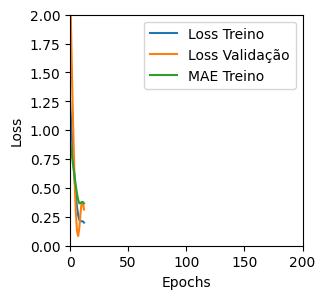

Tempo de treino: 0.08852043549219767 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14536309242248535 , MAE = 0.28388509154319763'

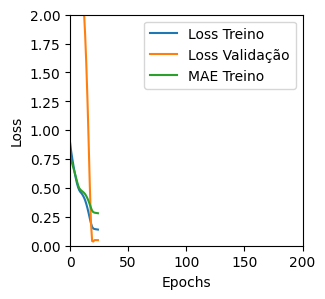

Tempo de treino: 0.10032814741134644 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1235370934009552 , MAE = 0.27772292494773865'

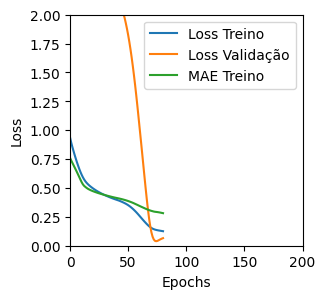

Tempo de treino: 0.22029900550842285 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3769734799861908 , MAE = 0.4288293421268463'

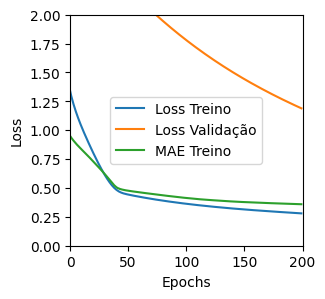

Tempo de treino: 0.383825143178304 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40664854645729065 , MAE = 0.42394477128982544'

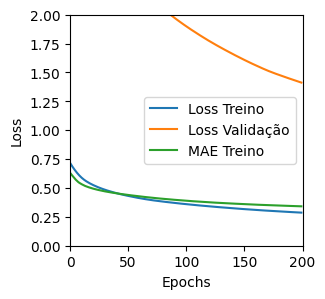

Tempo de treino: 0.23520335753758748 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14513960480690002 , MAE = 0.29274678230285645'

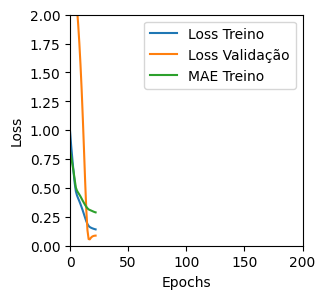

Tempo de treino: 0.11437657674153646 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13374996185302734 , MAE = 0.2776884138584137'

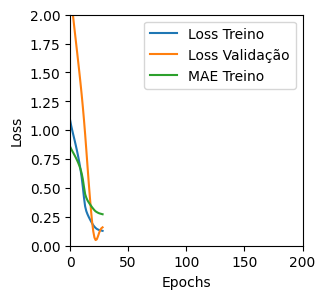

Tempo de treino: 0.13498664697011312 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15716010332107544 , MAE = 0.31479495763778687'

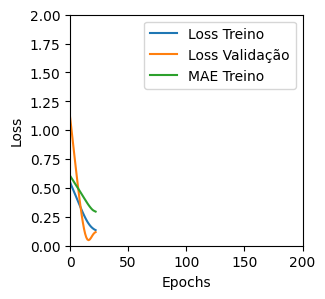

Tempo de treino: 0.08494765361150106 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.586556077003479 , MAE = 0.5798618793487549'

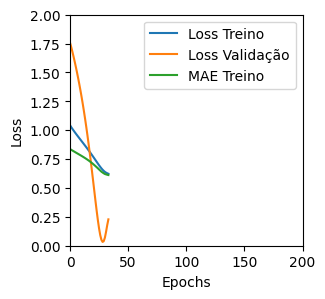

Tempo de treino: 0.07747617165247599 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1370755285024643 , MAE = 0.2777997851371765'

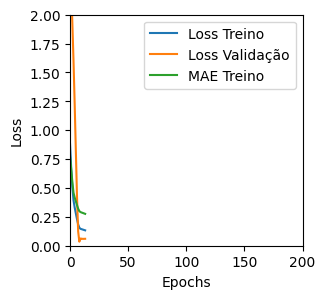

Tempo de treino: 0.07507632970809937 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15173207223415375 , MAE = 0.2903374433517456'

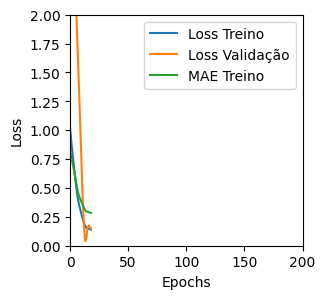

Tempo de treino: 0.07627545197804769 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1327235996723175 , MAE = 0.27507010102272034'

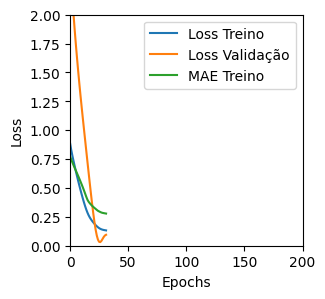

Tempo de treino: 0.07887357870737711 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1859208643436432 , MAE = 0.3254654109477997'

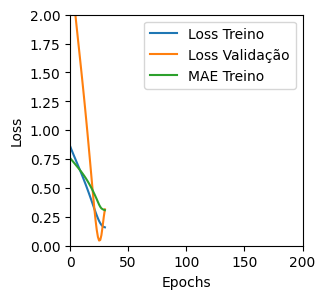

Tempo de treino: 0.11726330121358236 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14913806319236755 , MAE = 0.2952721118927002'

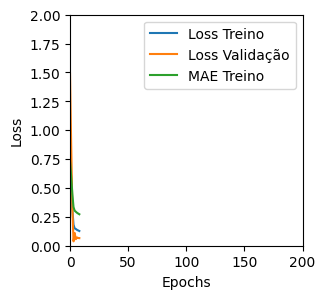

Tempo de treino: 0.07347541252772014 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13000811636447906 , MAE = 0.2809155285358429'

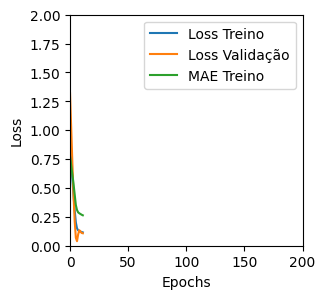

Tempo de treino: 0.0674089789390564 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18398071825504303 , MAE = 0.3223966956138611'

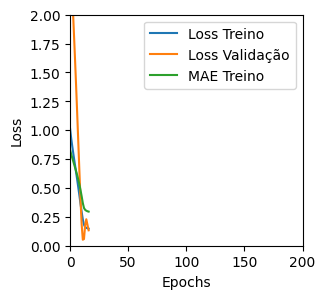

Tempo de treino: 0.09095968008041382 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12854379415512085 , MAE = 0.27314293384552'

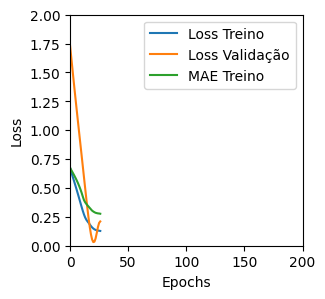

Tempo de treino: 0.06383887926737468 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11437957733869553 , MAE = 0.25526881217956543'

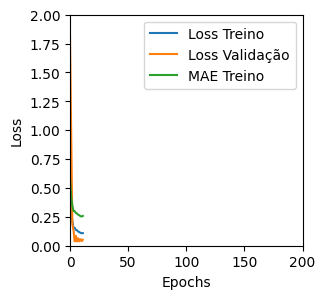

Tempo de treino: 0.07988513708114624 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14826667308807373 , MAE = 0.2948154807090759'

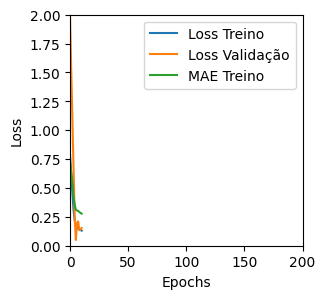

Tempo de treino: 0.05845741033554077 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21134082973003387 , MAE = 0.35897311568260193'

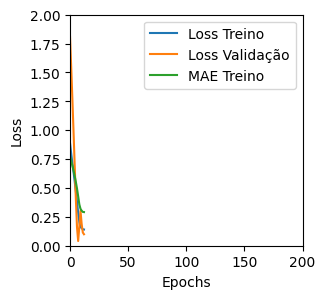

Tempo de treino: 0.12109806934992472 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1478128731250763 , MAE = 0.28964027762413025'

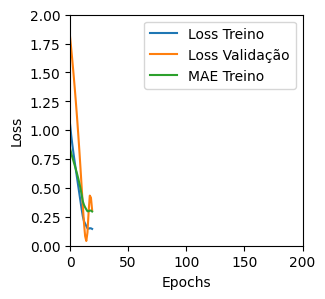

Tempo de treino: 0.07661680380503337 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10773392766714096 , MAE = 0.246505469083786'

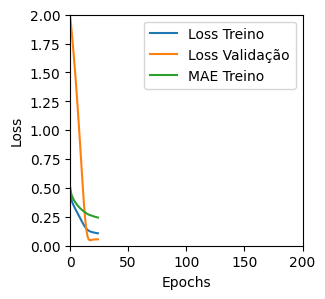

Tempo de treino: 0.13054232597351073 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5006620287895203 , MAE = 0.5480130910873413'

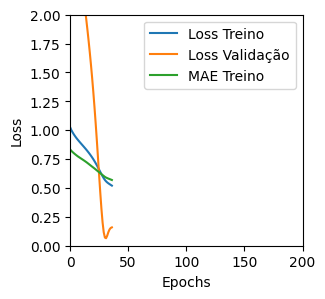

Tempo de treino: 0.126226003964742 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3516462445259094 , MAE = 0.45802462100982666'

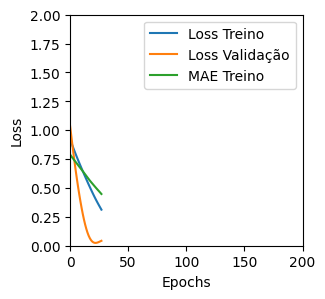

Tempo de treino: 0.07930624087651571 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47829118371009827 , MAE = 0.5576987266540527'

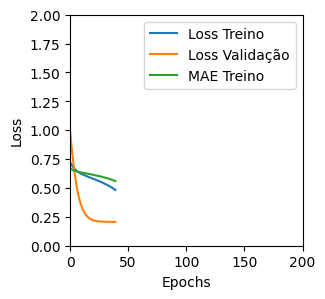

Tempo de treino: 0.12434351046880086 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07418017834424973 , MAE = 0.20622356235980988'

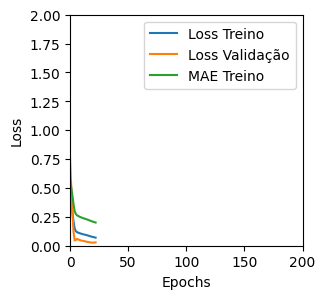

Tempo de treino: 0.10326363245646158 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17192094027996063 , MAE = 0.31387773156166077'

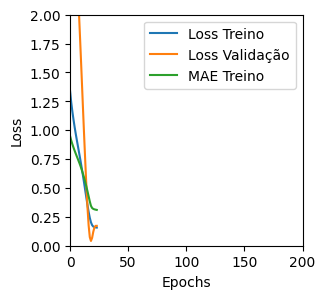

Tempo de treino: 0.07578951915105184 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2511400878429413 , MAE = 0.3949178159236908'

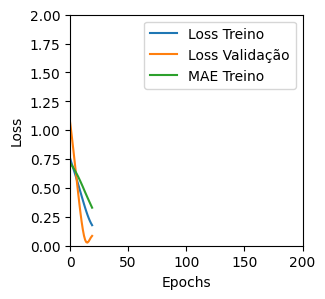

Tempo de treino: 0.10589947700500488 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13968266546726227 , MAE = 0.28559812903404236'

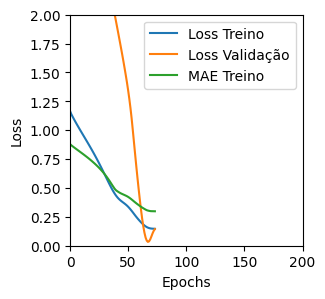

Tempo de treino: 0.12607779900232952 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05864114686846733 , MAE = 0.18113867938518524'

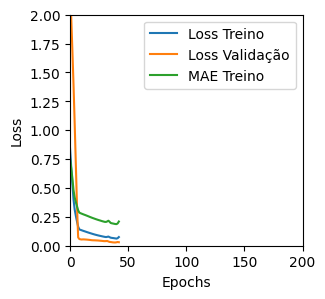

Tempo de treino: 0.1558241844177246 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13896726071834564 , MAE = 0.2832332253456116'

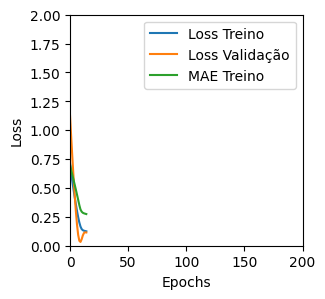

Tempo de treino: 0.09147578477859497 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24852962791919708 , MAE = 0.3914271295070648'

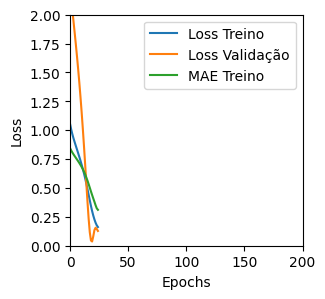

Tempo de treino: 0.07007680336634318 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1478201150894165 , MAE = 0.293760746717453'

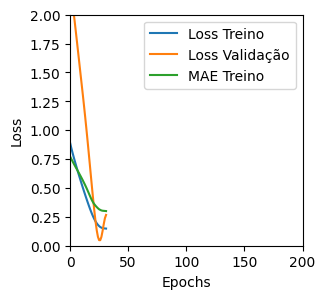

Tempo de treino: 0.07754205862681071 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15583176910877228 , MAE = 0.29789501428604126'

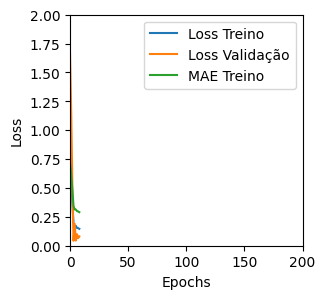

Tempo de treino: 0.06375943024953207 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20204751193523407 , MAE = 0.3498145341873169'

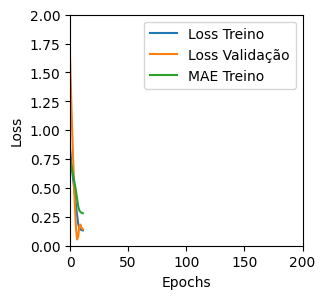

Tempo de treino: 0.07976178328196208 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14291508495807648 , MAE = 0.2850760519504547'

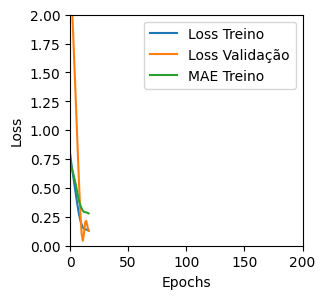

Tempo de treino: 0.10979567766189575 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1615288108587265 , MAE = 0.29796135425567627'

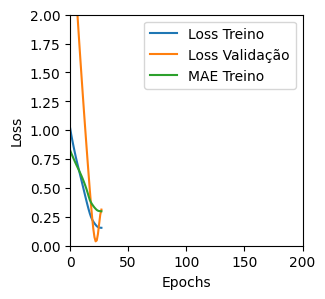

Tempo de treino: 0.08907744487126669 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14092358946800232 , MAE = 0.27829813957214355'

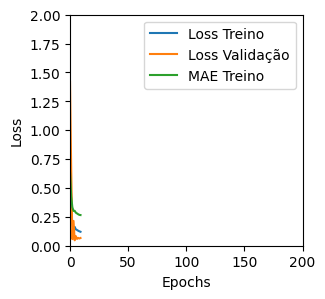

Tempo de treino: 0.09372338453928629 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1532120257616043 , MAE = 0.2941863238811493'

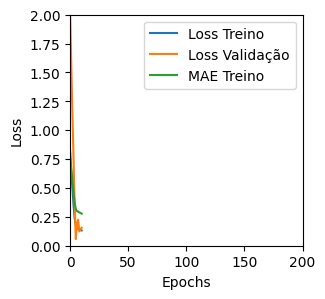

Tempo de treino: 0.06268836259841919 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16780085861682892 , MAE = 0.31088393926620483'

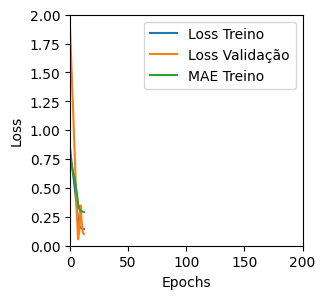

Tempo de treino: 0.066091521581014 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16613346338272095 , MAE = 0.3047357201576233'

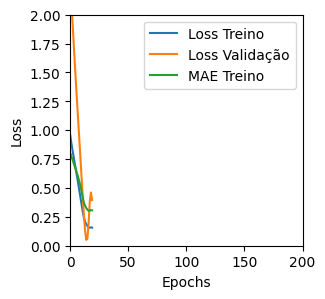

Tempo de treino: 0.061533041795094806 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1033071279525757 , MAE = 0.877469003200531'

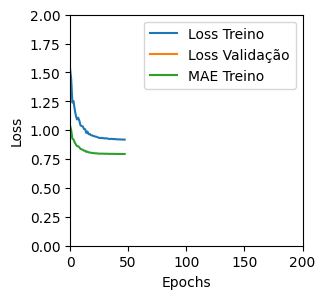

Tempo de treino: 0.20839271148045857 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1766299605369568 , MAE = 0.32468315958976746'

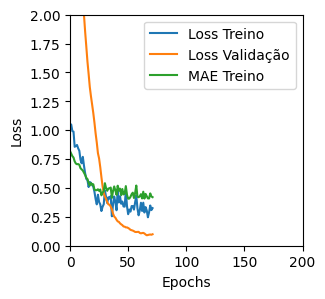

Tempo de treino: 0.24346001942952475 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4357544481754303 , MAE = 0.45920971035957336'

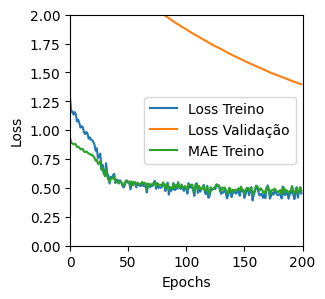

Tempo de treino: 0.38832109371821083 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4611513018608093 , MAE = 0.46139371395111084'

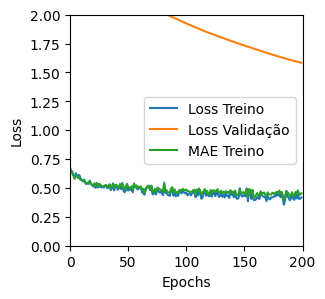

Tempo de treino: 0.21991469462712607 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17501504719257355 , MAE = 0.31144556403160095'

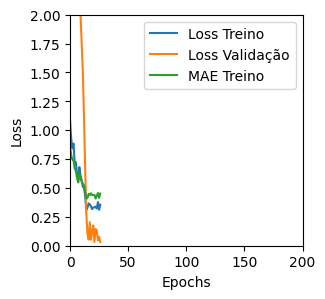

Tempo de treino: 0.13529274066289265 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23430182039737701 , MAE = 0.37053340673446655'

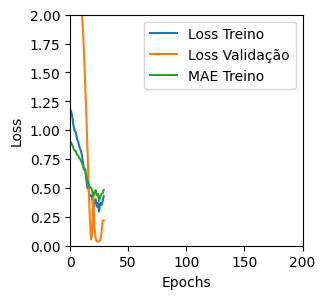

Tempo de treino: 0.12355908155441284 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2082323431968689 , MAE = 0.3584120571613312'

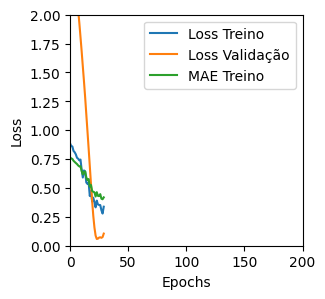

Tempo de treino: 0.07325299183527628 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3011722266674042 , MAE = 0.42983296513557434'

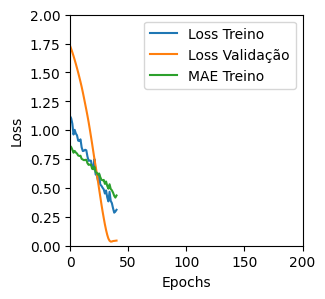

Tempo de treino: 0.07936336596806844 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16759060323238373 , MAE = 0.307608425617218'

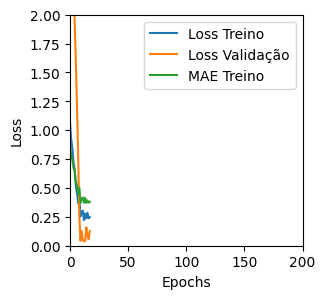

Tempo de treino: 0.16001394192377727 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14754624664783478 , MAE = 0.2928484082221985'

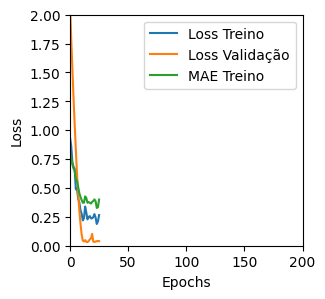

Tempo de treino: 0.10383518934249877 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1332985758781433 , MAE = 0.2752220630645752'

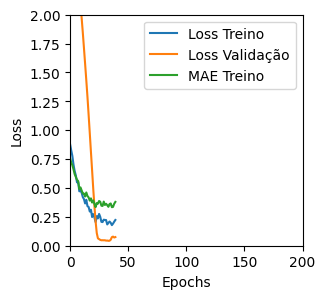

Tempo de treino: 0.1283992648124695 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14084911346435547 , MAE = 0.2853676676750183'

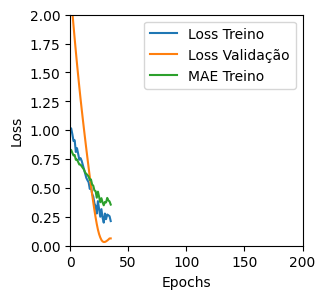

Tempo de treino: 0.07451048692067465 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1405983418226242 , MAE = 0.2823341488838196'

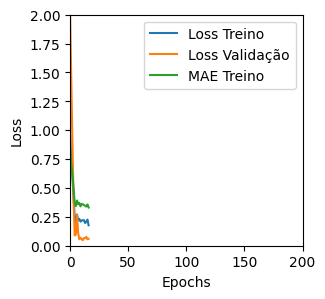

Tempo de treino: 0.12499374151229858 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13714516162872314 , MAE = 0.2788355350494385'

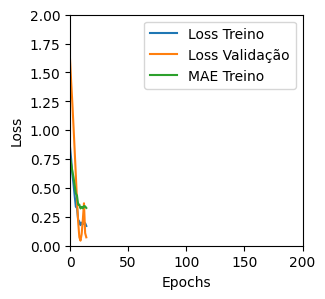

Tempo de treino: 0.06562287012736003 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14569927752017975 , MAE = 0.28533878922462463'

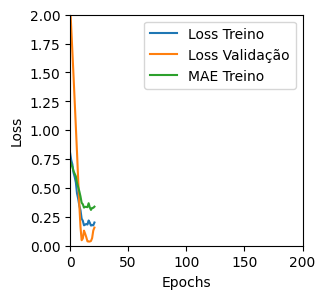

Tempo de treino: 0.08195610046386718 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1610666960477829 , MAE = 0.29820647835731506'

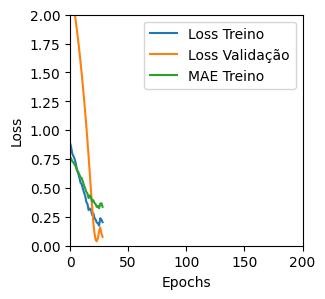

Tempo de treino: 0.09853752454121907 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11683398485183716 , MAE = 0.255886435508728'

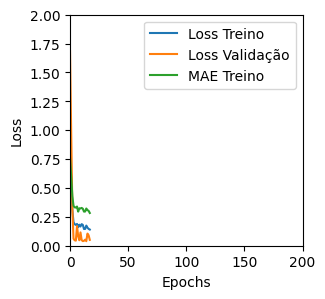

Tempo de treino: 0.11803714434305827 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16345730423927307 , MAE = 0.3006480932235718'

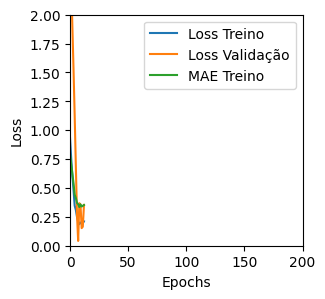

Tempo de treino: 0.08811755577723185 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15560200810432434 , MAE = 0.29652637243270874'

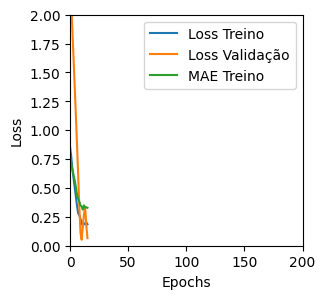

Tempo de treino: 0.08622345527013144 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14319422841072083 , MAE = 0.28873032331466675'

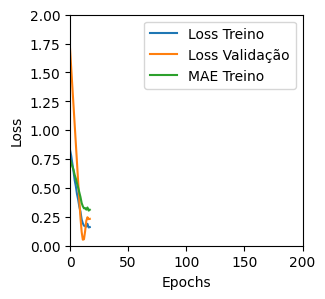

Tempo de treino: 0.06323885122934977 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043018728494644165 , MAE = 0.15862798690795898'

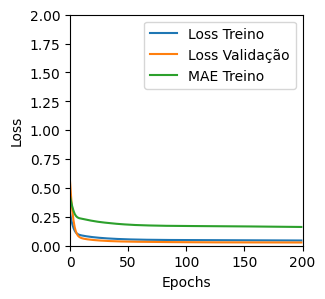

Tempo de treino: 0.7304770151774088 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0581853948533535 , MAE = 0.1883140206336975'

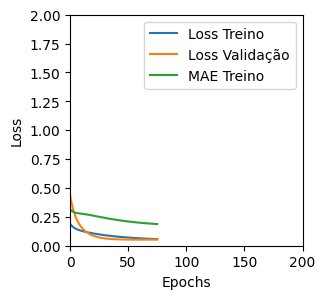

Tempo de treino: 0.21816269159317017 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07241920381784439 , MAE = 0.2090263068675995'

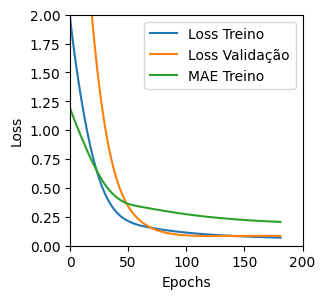

Tempo de treino: 0.4218069712320964 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1451324224472046 , MAE = 0.3060261011123657'

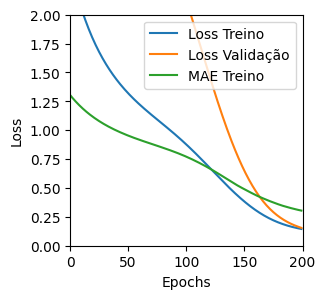

Tempo de treino: 0.2454513430595398 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043516531586647034 , MAE = 0.16123543679714203'

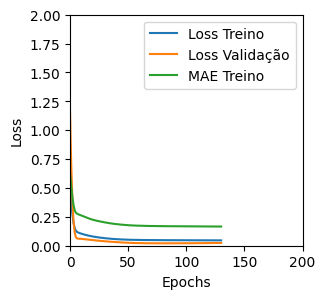

Tempo de treino: 0.7406953612963358 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042811792343854904 , MAE = 0.157906174659729'

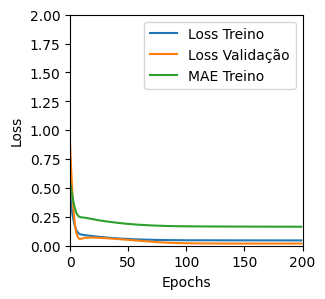

Tempo de treino: 0.7376155932744344 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047812581062316895 , MAE = 0.16952085494995117'

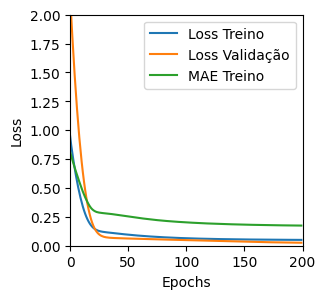

Tempo de treino: 0.3462018450101217 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07501351833343506 , MAE = 0.21756787598133087'

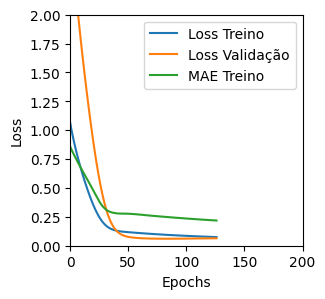

Tempo de treino: 0.19324889183044433 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04826335236430168 , MAE = 0.1710692048072815'

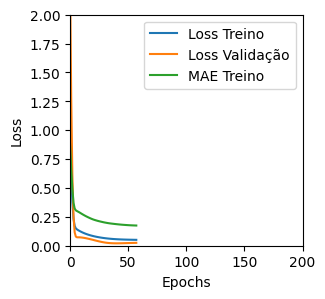

Tempo de treino: 0.3925958275794983 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04405845329165459 , MAE = 0.16050727665424347'

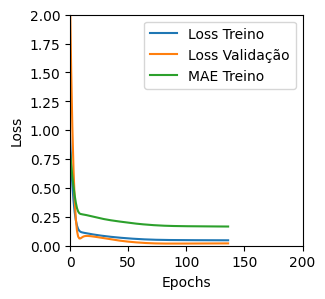

Tempo de treino: 0.38966012398401895 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11364193260669708 , MAE = 0.27424827218055725'

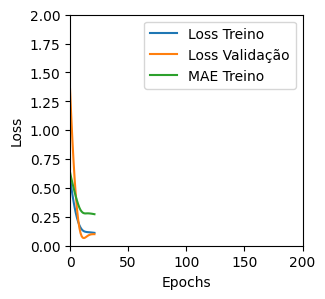

Tempo de treino: 0.09064540068308512 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047556065022945404 , MAE = 0.16834008693695068'

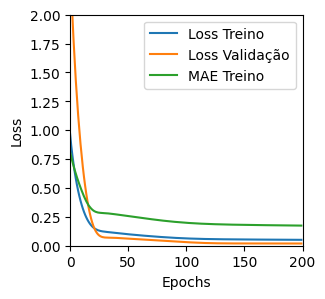

Tempo de treino: 0.4237666408220927 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048510197550058365 , MAE = 0.17033453285694122'

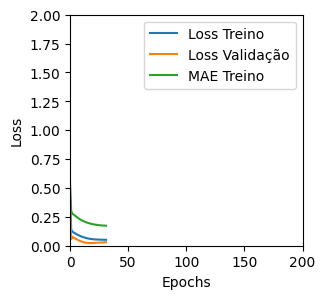

Tempo de treino: 0.1662856976191203 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10335519909858704 , MAE = 0.25191831588745117'

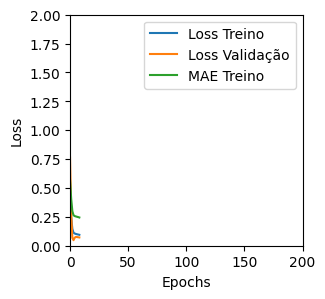

Tempo de treino: 0.09518564542134603 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12825696170330048 , MAE = 0.2817879021167755'

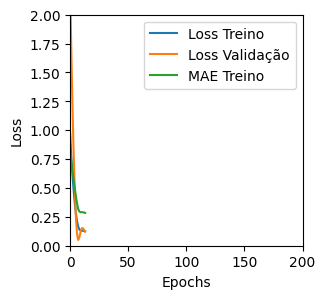

Tempo de treino: 0.10172046820322672 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1369008868932724 , MAE = 0.2929247319698334'

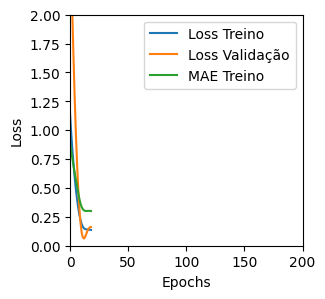

Tempo de treino: 0.07338609298070271 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07517613470554352 , MAE = 0.21273751556873322'

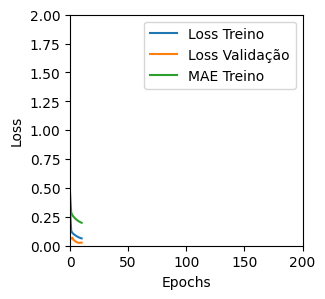

Tempo de treino: 0.1458043138186137 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07777374237775803 , MAE = 0.21689096093177795'

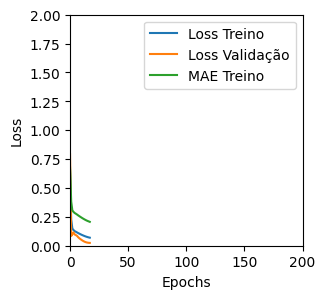

Tempo de treino: 0.1017085631688436 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13595271110534668 , MAE = 0.28903383016586304'

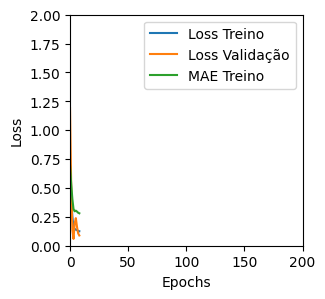

Tempo de treino: 0.07783807516098022 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13936078548431396 , MAE = 0.29259470105171204'

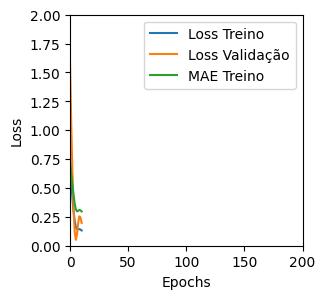

Tempo de treino: 0.0706130067507426 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3276154100894928 , MAE = 0.4205110967159271'

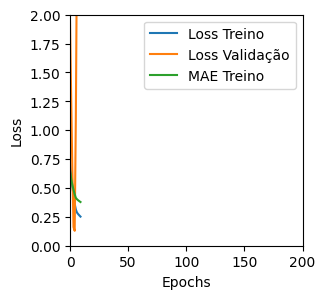

Tempo de treino: 0.06534288326899211 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3928844630718231 , MAE = 0.42497962713241577'

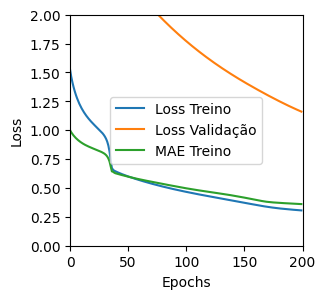

Tempo de treino: 0.31957413752873737 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.140155628323555 , MAE = 0.2811409831047058'

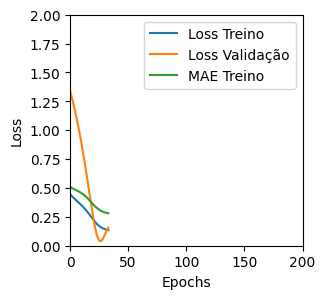

Tempo de treino: 0.11749087969462077 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6573828458786011 , MAE = 0.6312437057495117'

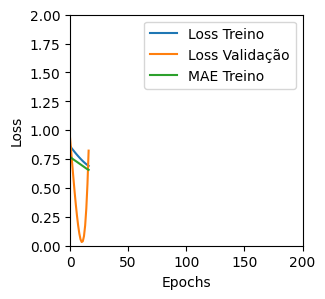

Tempo de treino: 0.08754824002583822 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2013223022222519 , MAE = 0.34019389748573303'

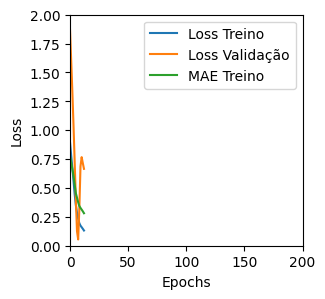

Tempo de treino: 0.07865159908930461 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11194863170385361 , MAE = 0.23826216161251068'

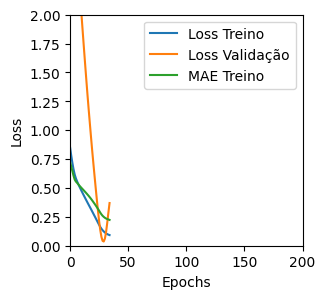

Tempo de treino: 0.08814419110616048 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19185671210289001 , MAE = 0.3198341429233551'

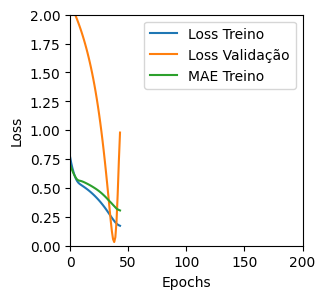

Tempo de treino: 0.11723171869913737 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19625502824783325 , MAE = 0.33252111077308655'

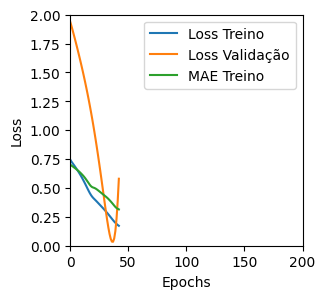

Tempo de treino: 0.08025015195210775 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17542250454425812 , MAE = 0.31445398926734924'

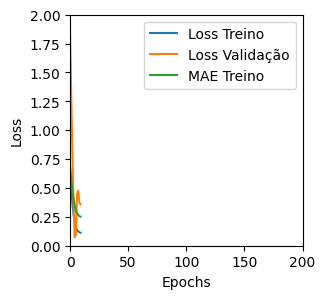

Tempo de treino: 0.07403629223505656 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43930450081825256 , MAE = 0.517173707485199'

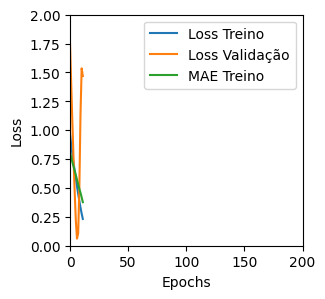

Tempo de treino: 0.07405341863632202 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23991543054580688 , MAE = 0.3659115731716156'

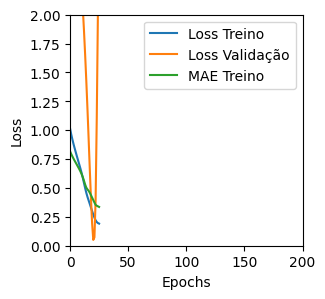

Tempo de treino: 0.11670857270558675 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17775624990463257 , MAE = 0.3176189959049225'

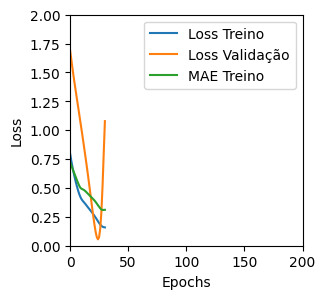

Tempo de treino: 0.09067956606547038 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24172355234622955 , MAE = 0.35538628697395325'

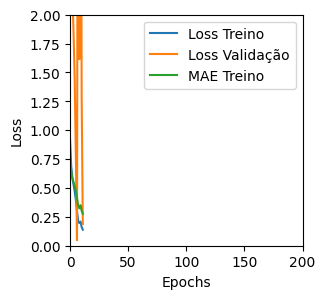

Tempo de treino: 0.08009056647618612 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2165534347295761 , MAE = 0.34642142057418823'

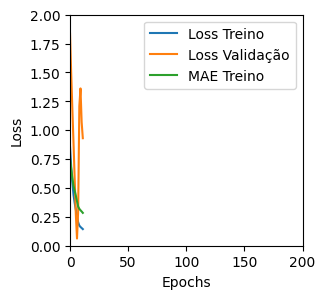

Tempo de treino: 0.07876317898432414 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4748040735721588 , MAE = 0.5320499539375305'

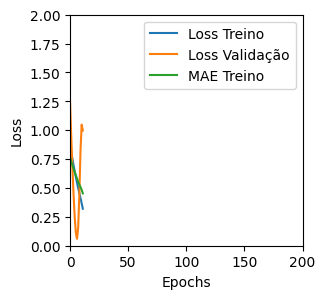

Tempo de treino: 0.05431686639785767 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20810657739639282 , MAE = 0.35273873805999756'

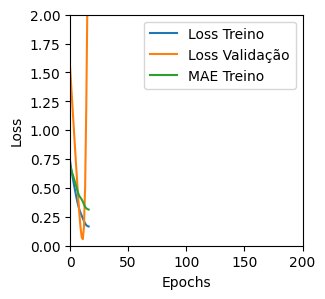

Tempo de treino: 0.0691381573677063 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16897465288639069 , MAE = 0.3091246783733368'

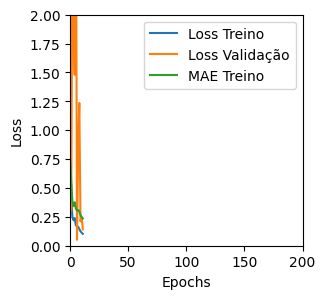

Tempo de treino: 0.0716447114944458 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2715565860271454 , MAE = 0.39607784152030945'

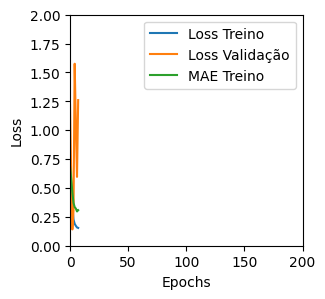

Tempo de treino: 0.05370611747105916 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2330407202243805 , MAE = 0.35379523038864136'

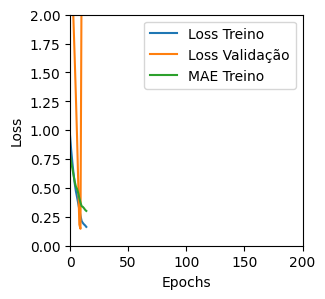

Tempo de treino: 0.12226355870564778 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25349193811416626 , MAE = 0.3614959716796875'

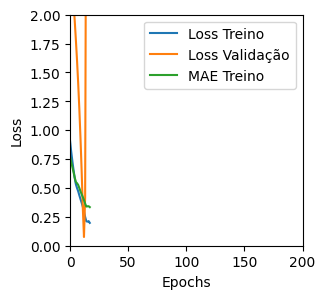

Tempo de treino: 0.09517045021057129 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6422508955001831 , MAE = 0.6251283884048462'

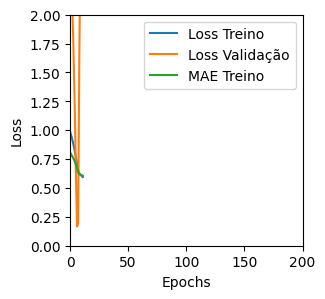

Tempo de treino: 0.08896023035049438 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23586148023605347 , MAE = 0.3645343482494354'

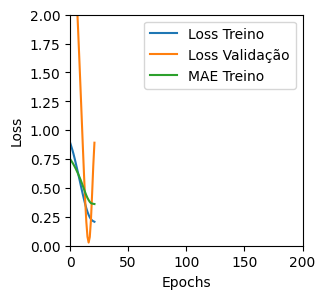

Tempo de treino: 0.08567723830540976 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2966369092464447 , MAE = 0.38233113288879395'

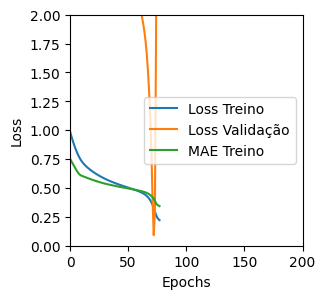

Tempo de treino: 0.1257044474283854 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3114473819732666 , MAE = 0.4285981357097626'

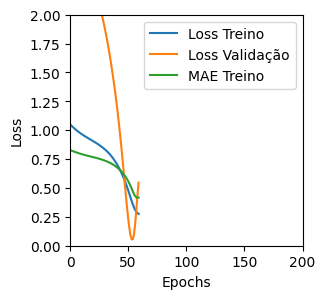

Tempo de treino: 0.12431558767954508 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18443772196769714 , MAE = 0.339551717042923'

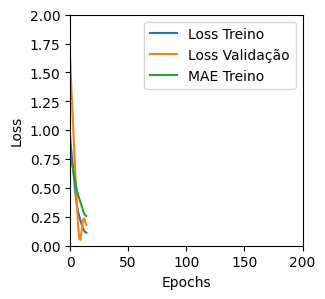

Tempo de treino: 0.07586989402770997 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24298718571662903 , MAE = 0.3534499704837799'

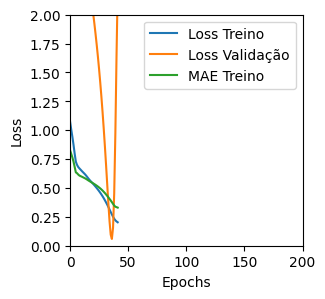

Tempo de treino: 0.11687736511230469 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2327016294002533 , MAE = 0.36771535873413086'

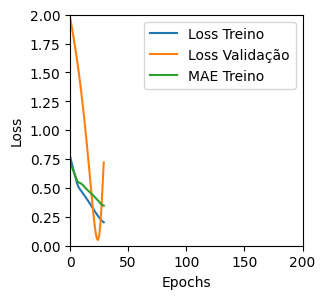

Tempo de treino: 0.07450859149297079 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6266140341758728 , MAE = 0.6049936413764954'

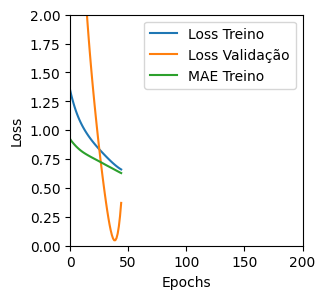

Tempo de treino: 0.15730079412460327 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34943246841430664 , MAE = 0.4548114240169525'

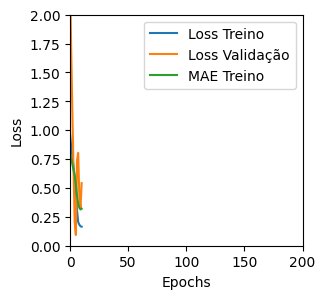

Tempo de treino: 0.08242477575937907 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17110899090766907 , MAE = 0.3132273256778717'

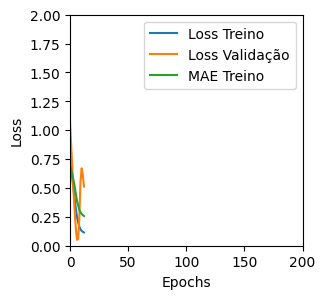

Tempo de treino: 0.06992106437683106 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5691782236099243 , MAE = 0.5778353810310364'

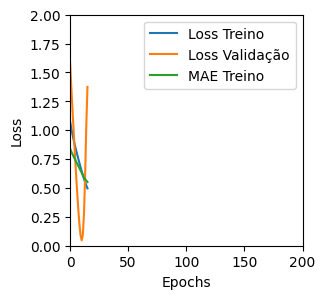

Tempo de treino: 0.05463087956110636 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41541749238967896 , MAE = 0.4987829029560089'

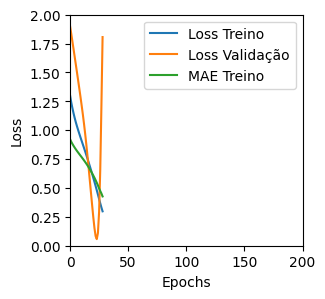

Tempo de treino: 0.07287434736887614 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18814906477928162 , MAE = 0.31219810247421265'

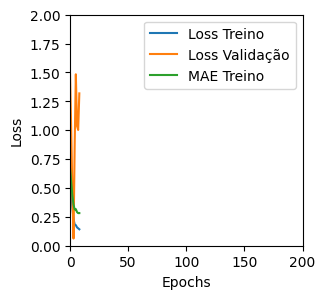

Tempo de treino: 0.0830161452293396 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2505732774734497 , MAE = 0.3609004020690918'

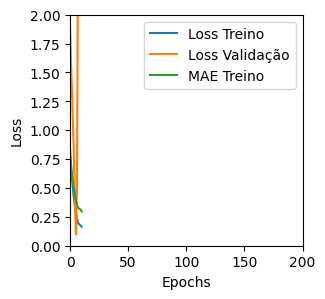

Tempo de treino: 0.07529922326405843 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3035629391670227 , MAE = 0.42435741424560547'

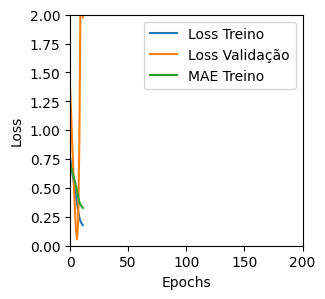

Tempo de treino: 0.04955283403396606 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2322772741317749 , MAE = 0.3578537106513977'

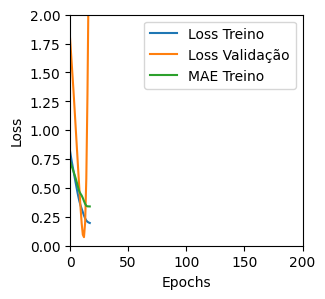

Tempo de treino: 0.12031952142715455 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2271546721458435 , MAE = 0.3554134964942932'

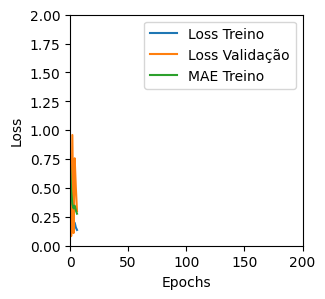

Tempo de treino: 0.08033175468444824 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2659468948841095 , MAE = 0.39198359847068787'

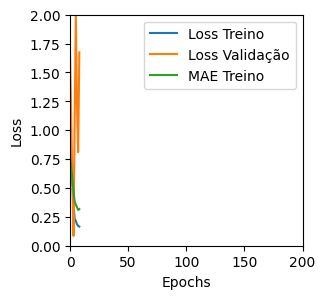

Tempo de treino: 0.06567542950312297 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22833892703056335 , MAE = 0.3505064845085144'

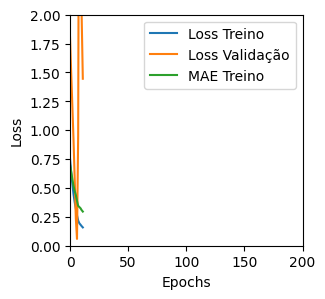

Tempo de treino: 0.05602926810582479 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28266724944114685 , MAE = 0.4010561406612396'

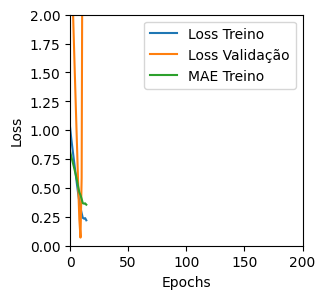

Tempo de treino: 0.06084981362024943 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5513927340507507 , MAE = 0.5446566343307495'

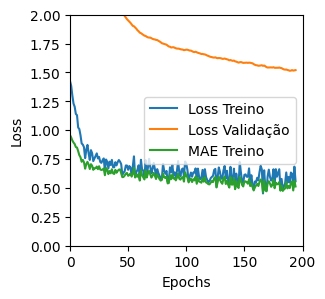

Tempo de treino: 0.7211470007896423 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3919815719127655 , MAE = 0.42862439155578613'

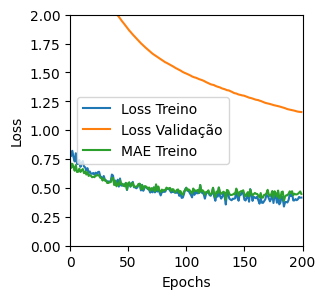

Tempo de treino: 0.3743898789087931 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.516628623008728 , MAE = 0.5006109476089478'

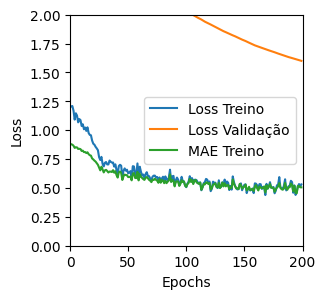

Tempo de treino: 0.22396270831425985 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5553274750709534 , MAE = 0.5607156157493591'

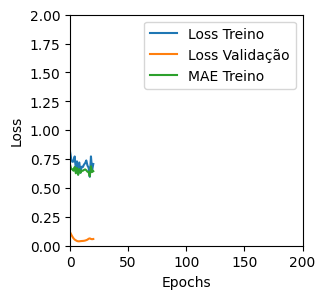

Tempo de treino: 0.12292424043019613 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1988915354013443 , MAE = 0.3025108277797699'

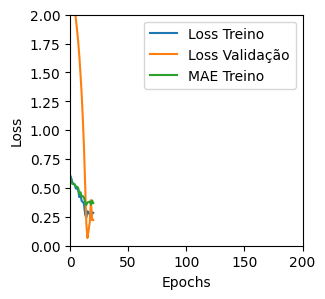

Tempo de treino: 0.12687920729319255 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2175840437412262 , MAE = 0.3374549150466919'

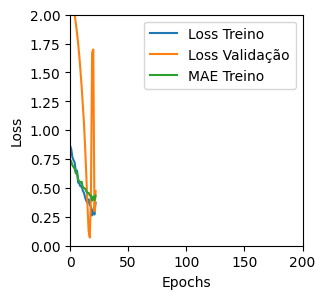

Tempo de treino: 0.08426624139149984 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19472216069698334 , MAE = 0.327800989151001'

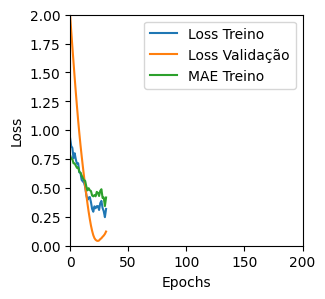

Tempo de treino: 0.07828091780344645 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15823501348495483 , MAE = 0.29807305335998535'

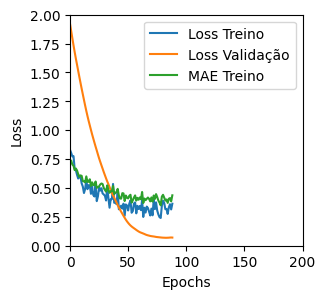

Tempo de treino: 0.21763052543004355 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19779743254184723 , MAE = 0.32208535075187683'

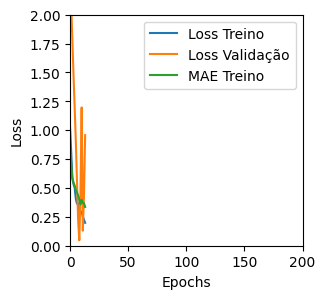

Tempo de treino: 0.08127527236938477 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2748321294784546 , MAE = 0.379844069480896'

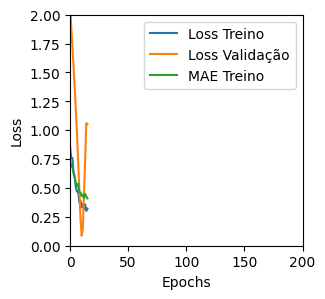

Tempo de treino: 0.07657527526219686 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21206426620483398 , MAE = 0.332617849111557'

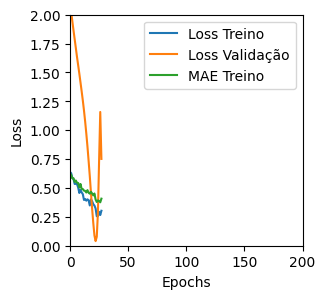

Tempo de treino: 0.0916882832845052 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25024938583374023 , MAE = 0.3574388325214386'

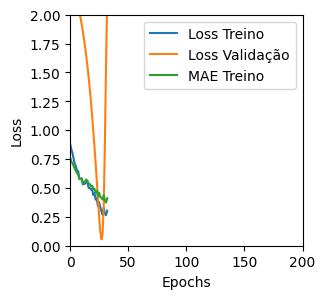

Tempo de treino: 0.1378169814745585 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4492688477039337 , MAE = 0.5269487500190735'

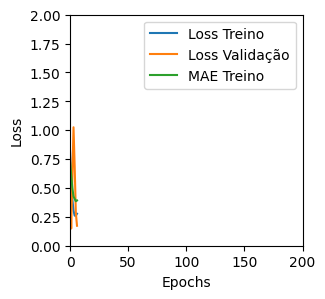

Tempo de treino: 0.06924344698588053 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2919701337814331 , MAE = 0.40097764134407043'

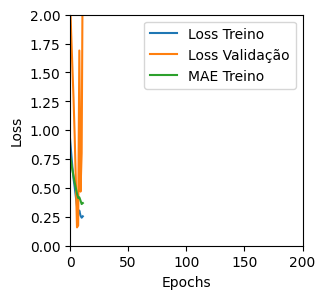

Tempo de treino: 0.06244887908299764 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23491720855236053 , MAE = 0.36688193678855896'

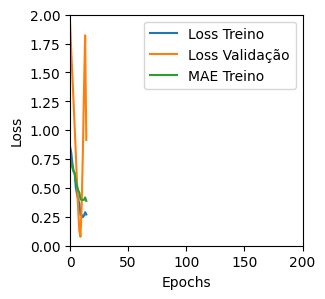

Tempo de treino: 0.0561003843943278 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28627514839172363 , MAE = 0.40713831782341003'

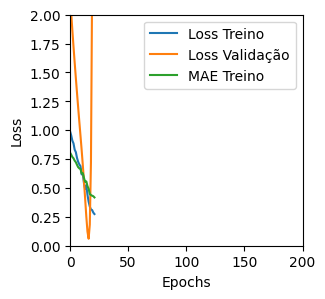

Tempo de treino: 0.09183015425999959 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2731077969074249 , MAE = 0.3952054977416992'

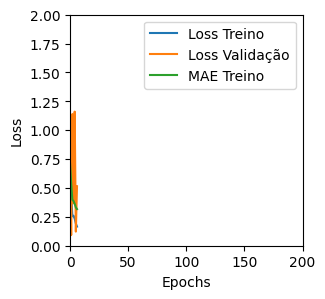

Tempo de treino: 0.05960226058959961 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2419212907552719 , MAE = 0.3656458258628845'

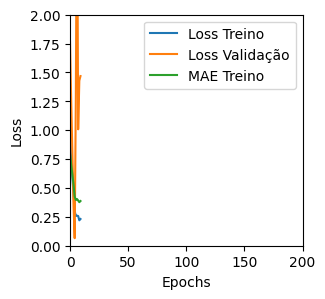

Tempo de treino: 0.054296569029490156 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26938456296920776 , MAE = 0.3959990441799164'

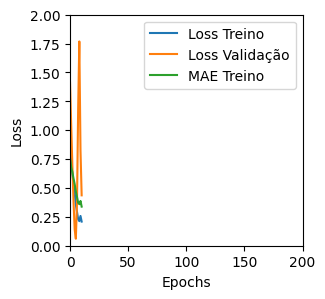

Tempo de treino: 0.05850144227345785 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26293107867240906 , MAE = 0.3758654296398163'

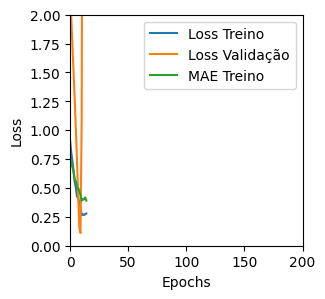

Tempo de treino: 0.09889676968256632 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04600206017494202 , MAE = 0.16347810626029968'

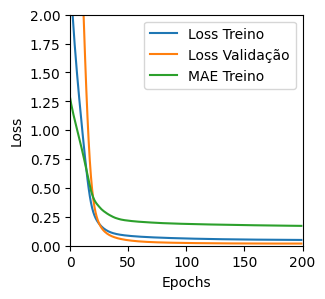

Tempo de treino: 0.7295870780944824 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05246300995349884 , MAE = 0.18068142235279083'

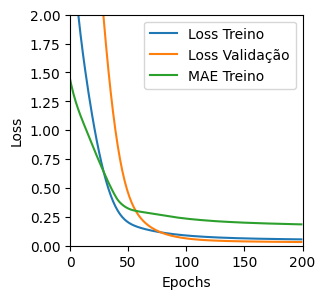

Tempo de treino: 0.3946218411127726 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05758066102862358 , MAE = 0.19104056060314178'

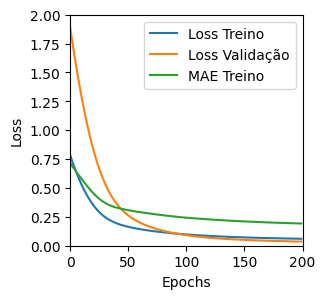

Tempo de treino: 0.3848581830660502 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07107746601104736 , MAE = 0.21373416483402252'

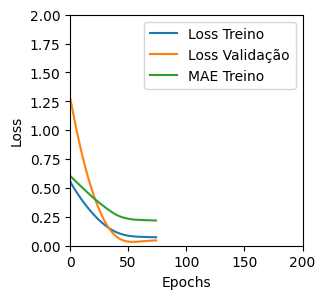

Tempo de treino: 0.13637280066808063 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04223347827792168 , MAE = 0.15709516406059265'

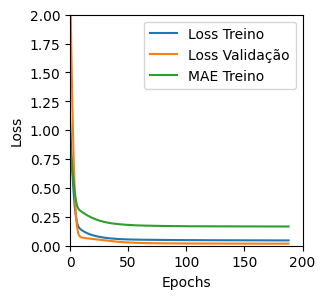

Tempo de treino: 0.5927569746971131 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08088287711143494 , MAE = 0.22080683708190918'

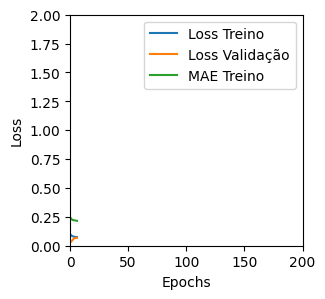

Tempo de treino: 0.07298584779103597 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05829232558608055 , MAE = 0.18340124189853668'

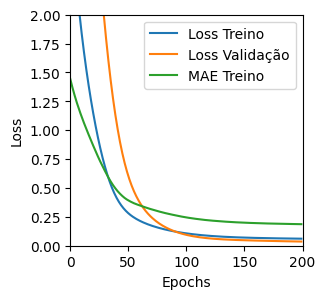

Tempo de treino: 0.274658473332723 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0453035794198513 , MAE = 0.1640966832637787'

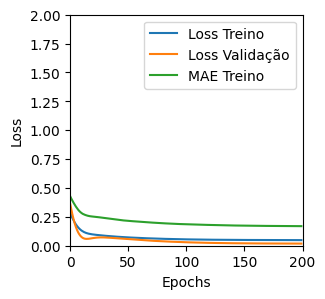

Tempo de treino: 0.25280222098032634 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03969700261950493 , MAE = 0.15018726885318756'

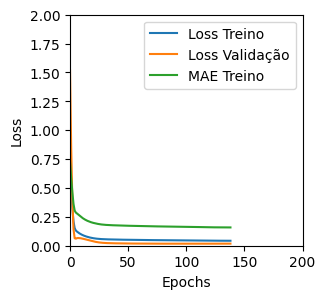

Tempo de treino: 0.7239181876182557 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042603883892297745 , MAE = 0.1581616997718811'

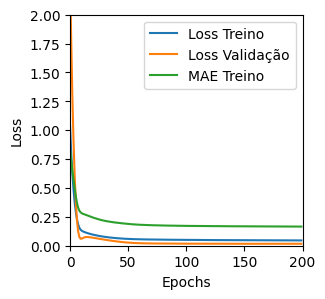

Tempo de treino: 0.3818620483080546 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04466739669442177 , MAE = 0.16148461401462555'

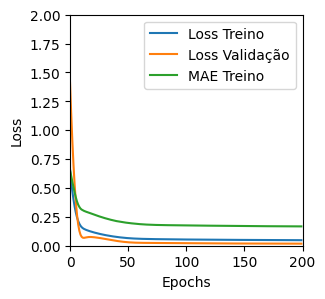

Tempo de treino: 0.3436461369196574 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12529797852039337 , MAE = 0.28270861506462097'

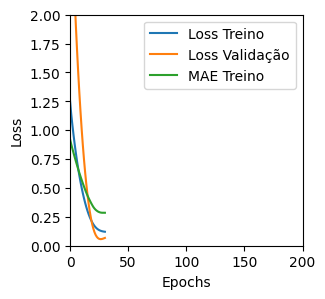

Tempo de treino: 0.10124374628067016 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04091962054371834 , MAE = 0.1529872864484787'

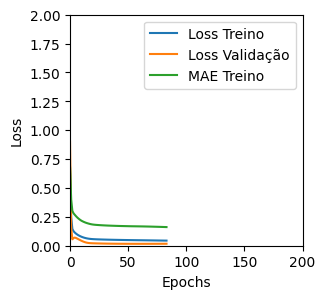

Tempo de treino: 0.3951759060223897 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1762457638978958 , MAE = 0.3270242512226105'

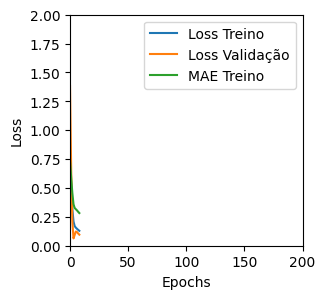

Tempo de treino: 0.09386748472849528 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11615844815969467 , MAE = 0.26763594150543213'

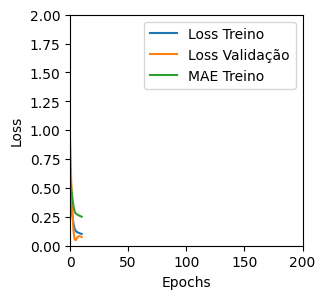

Tempo de treino: 0.06330121358235677 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14874602854251862 , MAE = 0.30011194944381714'

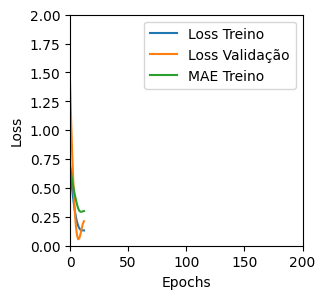

Tempo de treino: 0.12921574513117473 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042683906853199005 , MAE = 0.15592311322689056'

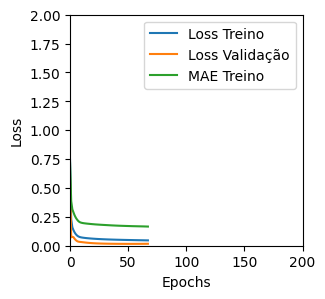

Tempo de treino: 0.2560458580652873 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04002869501709938 , MAE = 0.15152280032634735'

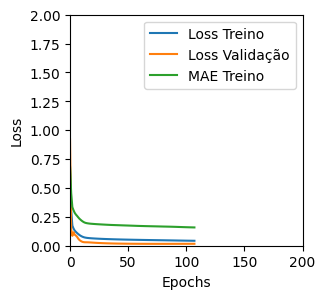

Tempo de treino: 0.25354204177856443 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15225473046302795 , MAE = 0.3053698241710663'

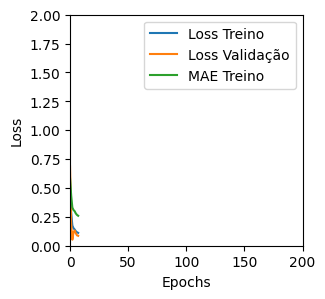

Tempo de treino: 0.06899608373641967 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1910446137189865 , MAE = 0.34728917479515076'

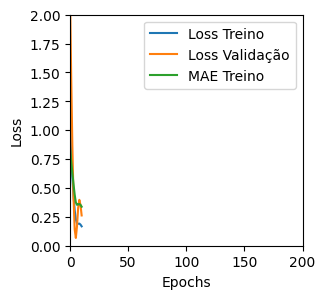

Tempo de treino: 0.09070945978164673 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43376439809799194 , MAE = 0.49384647607803345'

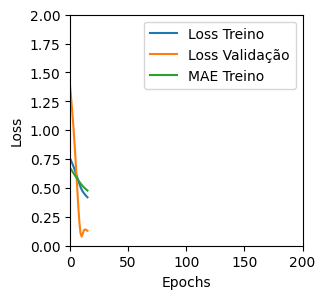

Tempo de treino: 0.11771497329076132 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28323066234588623 , MAE = 0.35564348101615906'

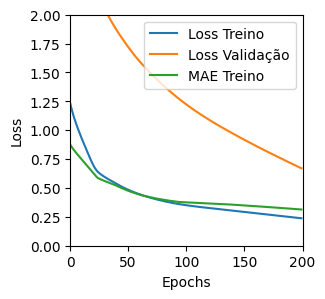

Tempo de treino: 0.6520565787951151 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3596125841140747 , MAE = 0.40988922119140625'

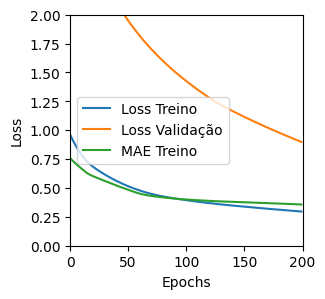

Tempo de treino: 0.3950196623802185 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6907795071601868 , MAE = 0.6497020125389099'

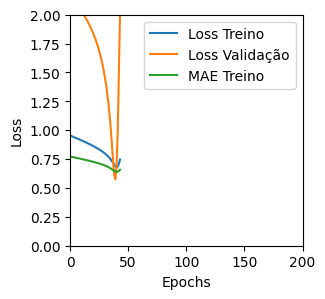

Tempo de treino: 0.13593929608662922 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.057251449674367905 , MAE = 0.18329240381717682'

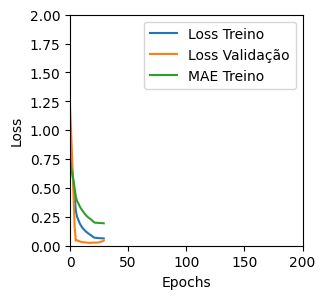

Tempo de treino: 0.21618404785792034 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3784351050853729 , MAE = 0.47382715344429016'

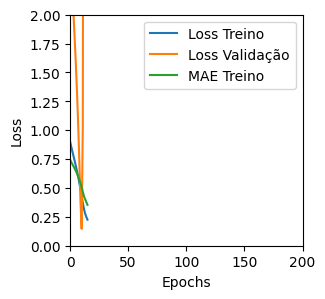

Tempo de treino: 0.09148050944010416 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3791489601135254 , MAE = 0.4772997498512268'

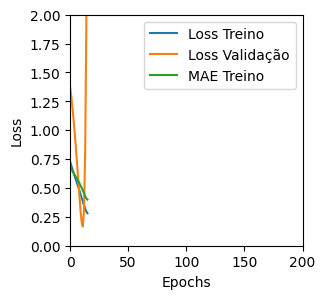

Tempo de treino: 0.08141250610351562 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3823893666267395 , MAE = 0.4781114161014557'

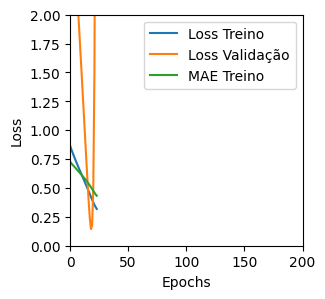

Tempo de treino: 0.06784082253774007 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27256152033805847 , MAE = 0.39929333329200745'

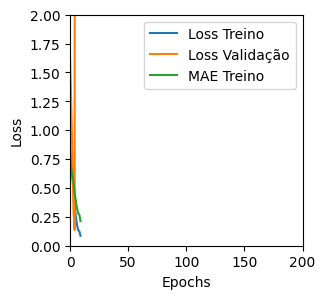

Tempo de treino: 0.12018786668777466 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22458039224147797 , MAE = 0.34925928711891174'

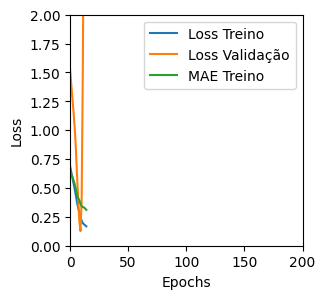

Tempo de treino: 0.10564748843510946 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28772932291030884 , MAE = 0.3966691792011261'

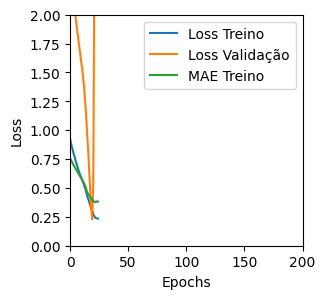

Tempo de treino: 0.09574577411015829 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49582818150520325 , MAE = 0.5157467126846313'

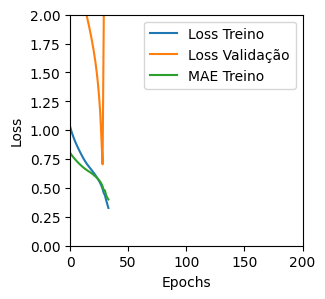

Tempo de treino: 0.09007649024327596 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2750948369503021 , MAE = 0.38395294547080994'

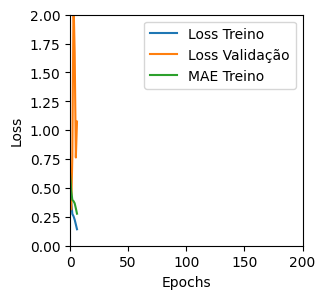

Tempo de treino: 0.08794758319854737 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42863911390304565 , MAE = 0.4967634081840515'

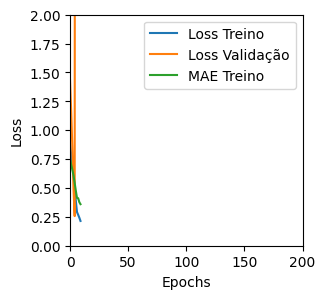

Tempo de treino: 0.08272918462753295 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3704396188259125 , MAE = 0.4650965929031372'

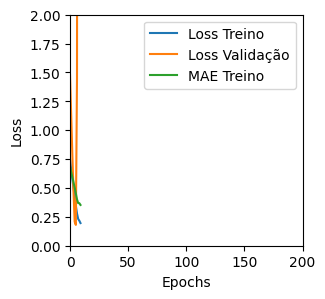

Tempo de treino: 0.08921062548955282 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37223175168037415 , MAE = 0.4633539915084839'

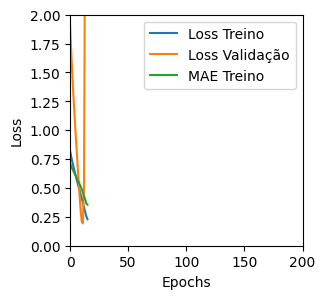

Tempo de treino: 0.08005573352177937 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


'TRAINING set. Loss = 0.18702350556850433 , MAE = 0.3319564163684845'

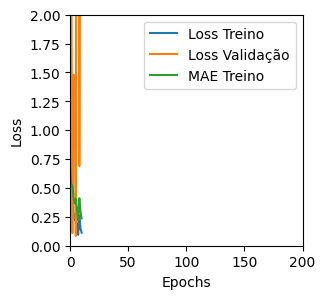

Tempo de treino: 0.13326584498087565 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4611937701702118 , MAE = 0.5198574662208557'

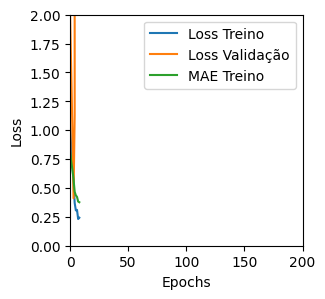

Tempo de treino: 0.08409215609232584 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4465200901031494 , MAE = 0.49861064553260803'

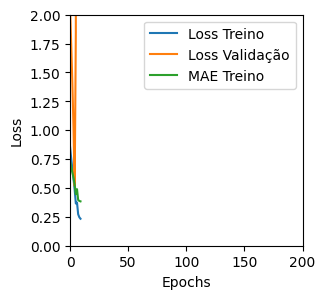

Tempo de treino: 0.09624131123224894 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36315032839775085 , MAE = 0.4447650611400604'

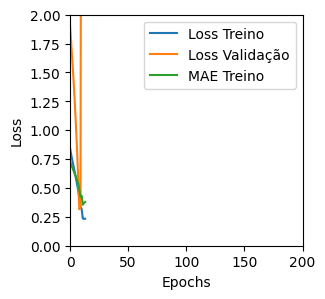

Tempo de treino: 0.08416921297709147 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41223371028900146 , MAE = 0.4691653847694397'

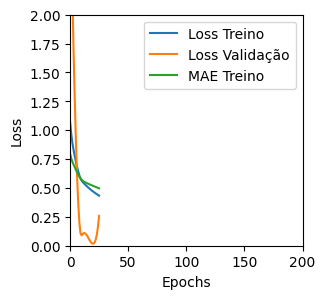

Tempo de treino: 0.22297272682189942 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3044911026954651 , MAE = 0.3921193778514862'

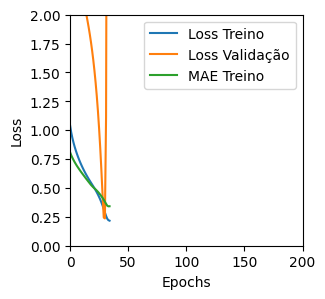

Tempo de treino: 0.22130120197931927 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41007035970687866 , MAE = 0.4583253860473633'

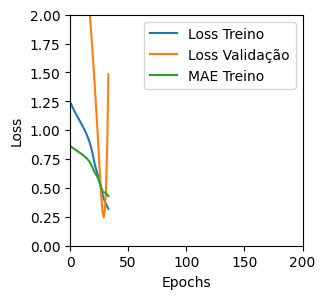

Tempo de treino: 0.09568043947219848 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2841565012931824 , MAE = 0.3997637629508972'

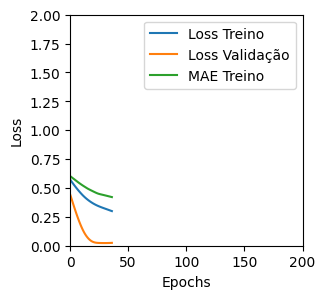

Tempo de treino: 0.08123661279678344 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24980461597442627 , MAE = 0.36062338948249817'

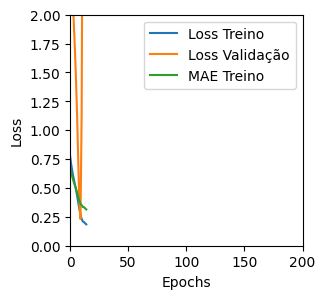

Tempo de treino: 0.17178383668263753 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25625455379486084 , MAE = 0.38922226428985596'

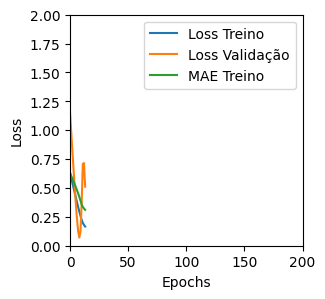

Tempo de treino: 0.13605202039082845 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6462349891662598 , MAE = 0.6117849349975586'

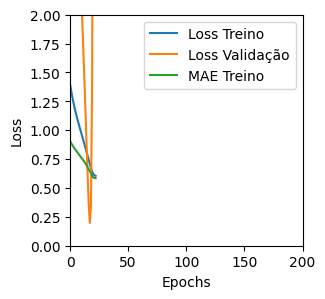

Tempo de treino: 0.08685948053995768 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5555427074432373 , MAE = 0.5724315643310547'

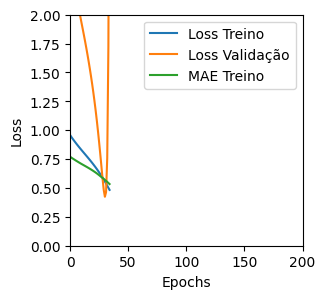

Tempo de treino: 0.13598689238230388 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46884962916374207 , MAE = 0.5030460357666016'

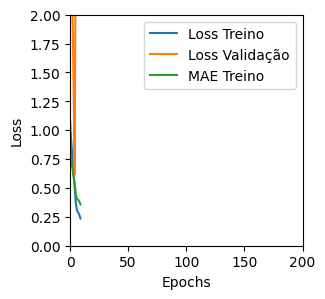

Tempo de treino: 0.09984561602274576 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3578638732433319 , MAE = 0.45320385694503784'

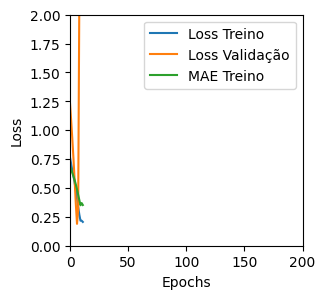

Tempo de treino: 0.0736147403717041 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5601674914360046 , MAE = 0.5613022446632385'

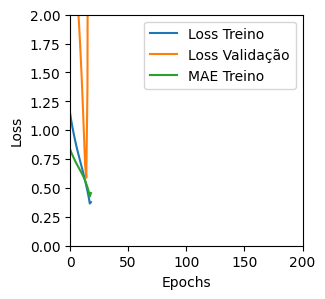

Tempo de treino: 0.08136980136235555 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3824484348297119 , MAE = 0.47095948457717896'

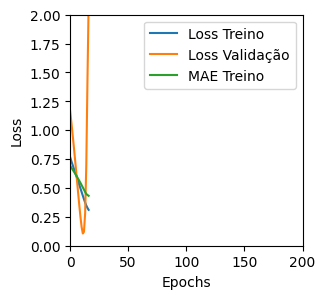

Tempo de treino: 0.11126101016998291 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4565637409687042 , MAE = 0.5196941494941711'

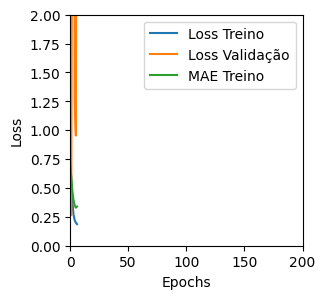

Tempo de treino: 0.10081396500269572 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29285547137260437 , MAE = 0.4112214744091034'

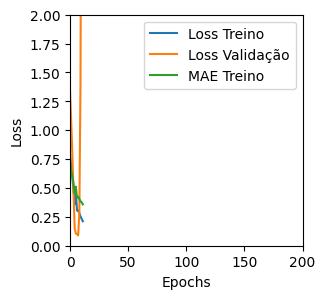

Tempo de treino: 0.09487857023874918 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4968894124031067 , MAE = 0.538669228553772'

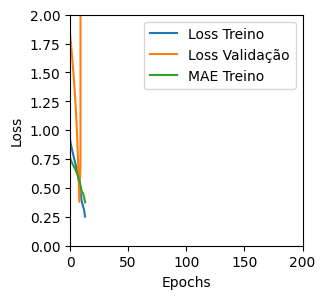

Tempo de treino: 0.07131918271382649 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5658433437347412 , MAE = 0.5763220191001892'

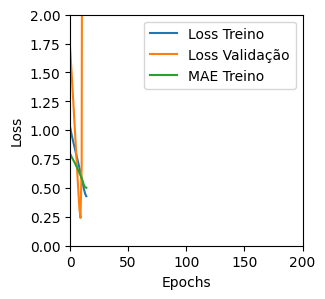

Tempo de treino: 0.07274561723073324 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2074979990720749 , MAE = 0.3402268886566162'

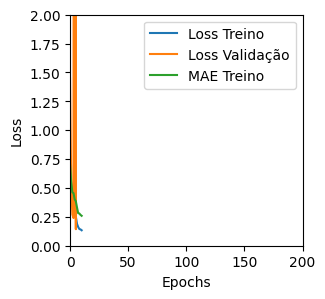

Tempo de treino: 0.10162185033162435 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40992307662963867 , MAE = 0.4809964895248413'

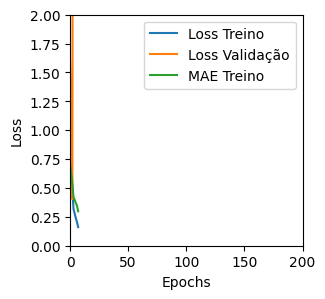

Tempo de treino: 0.07680366436640422 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32626602053642273 , MAE = 0.442049115896225'

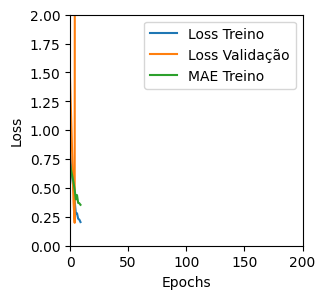

Tempo de treino: 0.08066385984420776 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4995935261249542 , MAE = 0.5305711030960083'

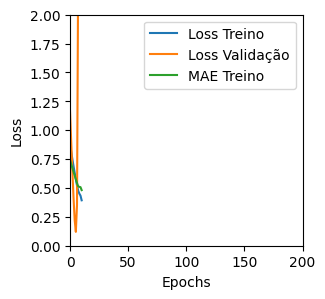

Tempo de treino: 0.10619537432988485 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6533004641532898 , MAE = 0.6194615364074707'

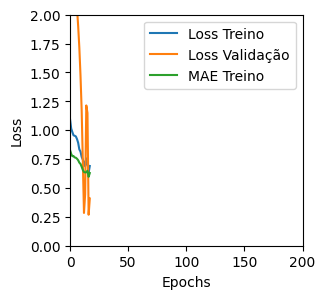

Tempo de treino: 0.1386781891187032 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37253087759017944 , MAE = 0.45160728693008423'

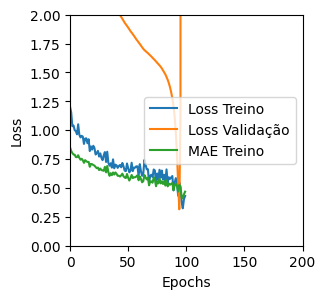

Tempo de treino: 0.3159734129905701 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9136928915977478 , MAE = 0.7614273428916931'

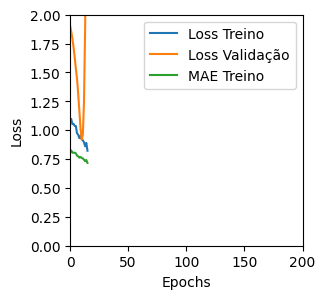

Tempo de treino: 0.07168794870376587 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6175775527954102 , MAE = 0.600594162940979'

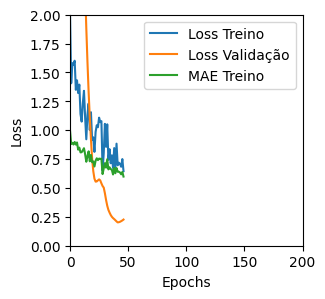

Tempo de treino: 0.1052264412244161 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13328684866428375 , MAE = 0.2713963985443115'

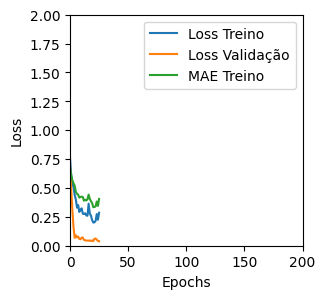

Tempo de treino: 0.1643496553103129 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38628047704696655 , MAE = 0.46233707666397095'

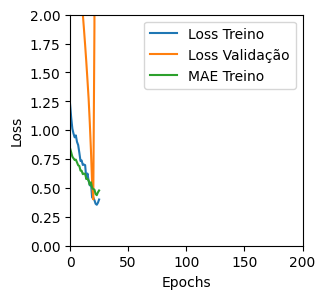

Tempo de treino: 0.10562687714894613 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18697722256183624 , MAE = 0.3295287787914276'

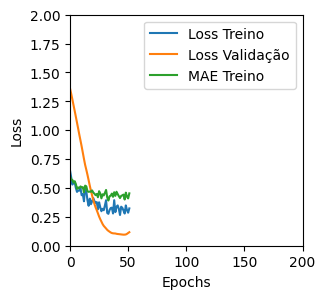

Tempo de treino: 0.25154327154159545 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4918183982372284 , MAE = 0.5612456798553467'

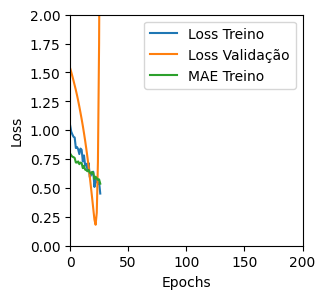

Tempo de treino: 0.09428648551305135 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1519726663827896 , MAE = 0.2715144157409668'

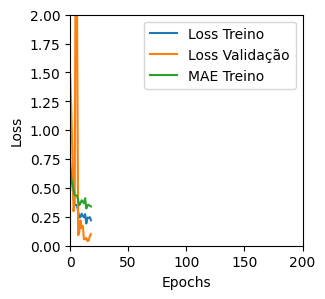

Tempo de treino: 0.16176812648773192 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22479145228862762 , MAE = 0.3467539846897125'

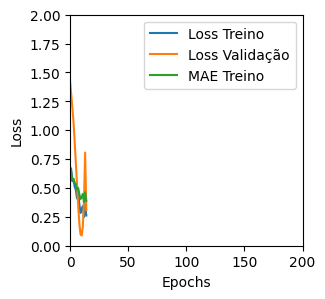

Tempo de treino: 0.08596968650817871 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34499111771583557 , MAE = 0.44641414284706116'

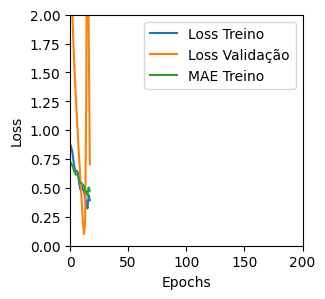

Tempo de treino: 0.08218790292739868 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46129658818244934 , MAE = 0.5262633562088013'

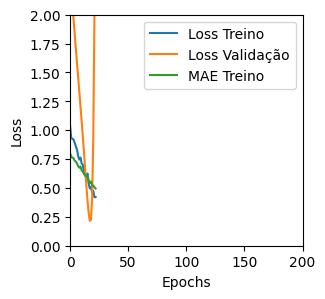

Tempo de treino: 0.08277324438095093 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1767474114894867 , MAE = 0.30774256587028503'

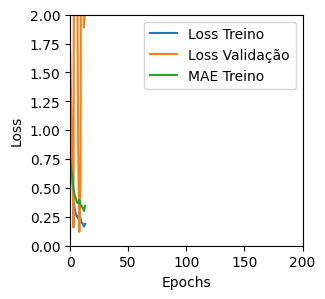

Tempo de treino: 0.12825007836023966 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38338732719421387 , MAE = 0.4597369134426117'

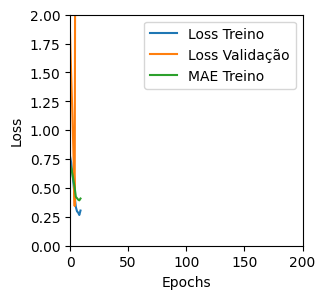

Tempo de treino: 0.10438383420308431 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4001392722129822 , MAE = 0.4603313207626343'

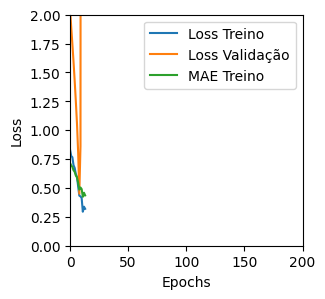

Tempo de treino: 0.1053532878557841 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36554640531539917 , MAE = 0.428917795419693'

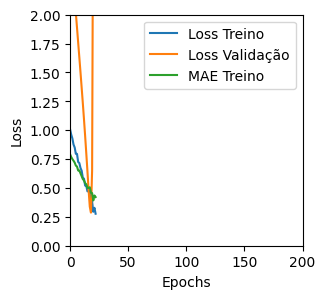

Tempo de treino: 0.09086724519729614 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3226587474346161 , MAE = 0.43129661679267883'

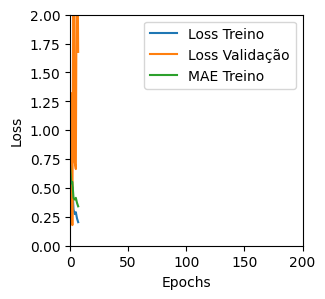

Tempo de treino: 0.14418320655822753 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23290176689624786 , MAE = 0.3713175654411316'

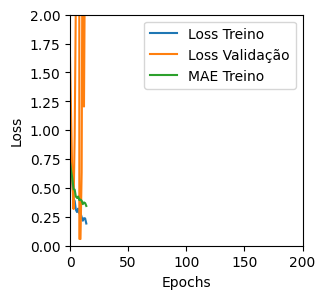

Tempo de treino: 0.1272427558898926 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31458133459091187 , MAE = 0.4244721531867981'

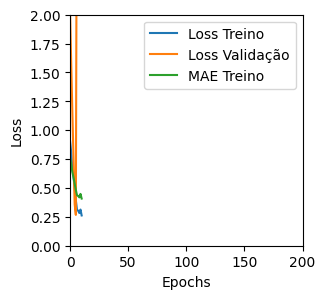

Tempo de treino: 0.08244477907816569 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4190549850463867 , MAE = 0.4888441562652588'

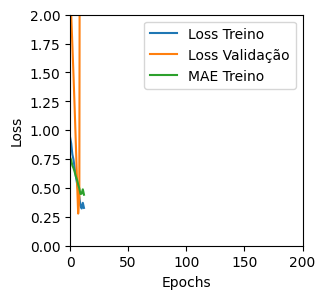

Tempo de treino: 0.08244879643122355 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047689903527498245 , MAE = 0.1700356900691986'

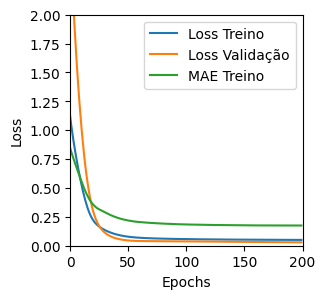

Tempo de treino: 1.4478475769360861 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10994969308376312 , MAE = 0.2629499137401581'

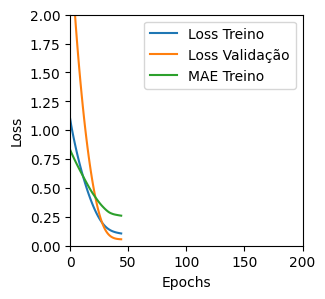

Tempo de treino: 0.2421536644299825 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14244093000888824 , MAE = 0.3103131353855133'

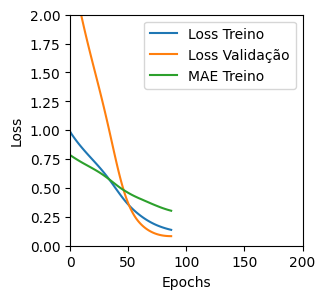

Tempo de treino: 0.41155503193537396 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6677950024604797 , MAE = 0.6319866180419922'

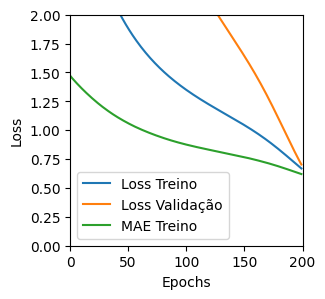

Tempo de treino: 0.321751602490743 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04593738168478012 , MAE = 0.16556380689144135'

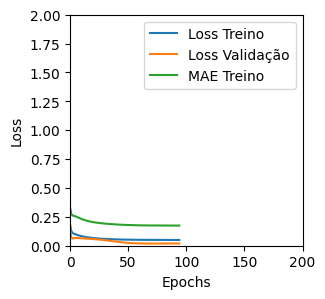

Tempo de treino: 0.5536220947901408 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048935726284980774 , MAE = 0.17163030803203583'

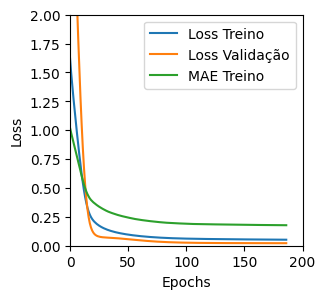

Tempo de treino: 0.7299995581309001 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06417975574731827 , MAE = 0.19137264788150787'

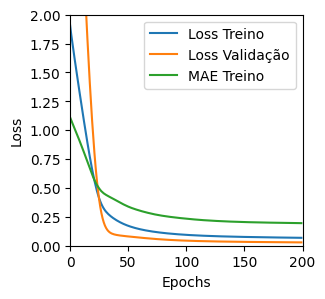

Tempo de treino: 0.7434626976648967 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17343685030937195 , MAE = 0.34718450903892517'

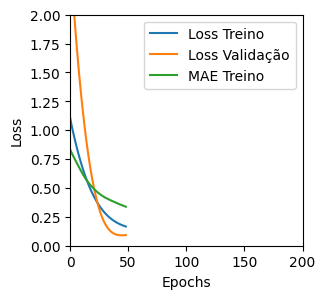

Tempo de treino: 0.14008629322052002 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04456103965640068 , MAE = 0.16284514963626862'

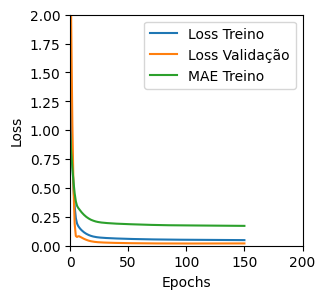

Tempo de treino: 1.4243939439455668 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12722131609916687 , MAE = 0.27707770466804504'

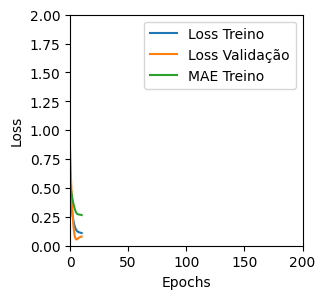

Tempo de treino: 0.13464184602101645 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14087198674678802 , MAE = 0.29164549708366394'

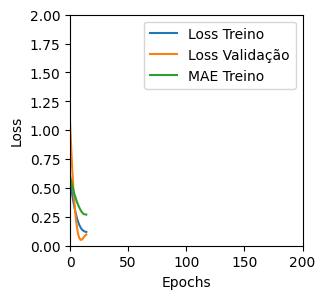

Tempo de treino: 0.11558318932851155 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.170693039894104 , MAE = 0.32662633061408997'

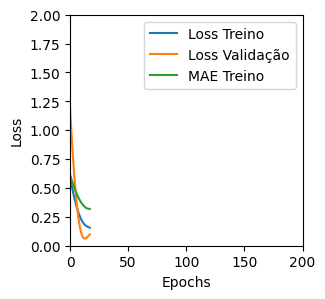

Tempo de treino: 0.11083561976750692 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04602990671992302 , MAE = 0.1660756766796112'

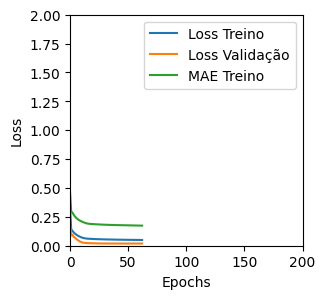

Tempo de treino: 0.7431274493535359 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18844205141067505 , MAE = 0.3359699845314026'

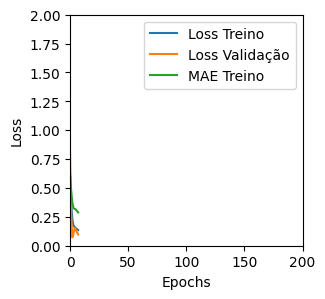

Tempo de treino: 0.0933059016863505 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20305541157722473 , MAE = 0.35093608498573303'

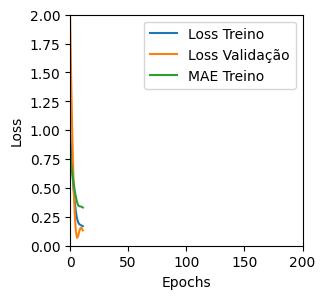

Tempo de treino: 0.10025031963984171 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20296010375022888 , MAE = 0.3510179817676544'

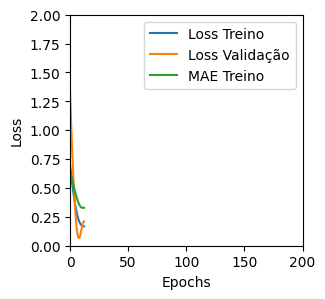

Tempo de treino: 0.10793943802515665 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04723075404763222 , MAE = 0.16750971972942352'

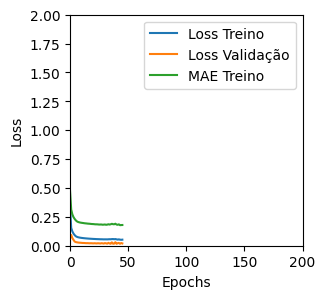

Tempo de treino: 0.3679179867108663 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04770531877875328 , MAE = 0.16734658181667328'

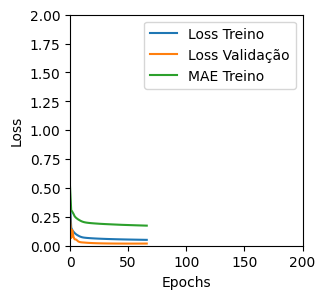

Tempo de treino: 0.2922482450803121 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.049670733511447906 , MAE = 0.1705811619758606'

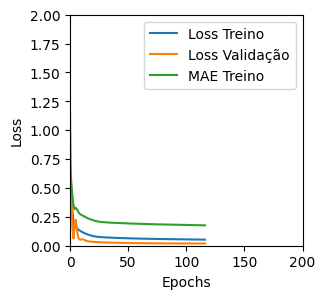

Tempo de treino: 0.29667123158772785 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2722647190093994 , MAE = 0.4059242308139801'

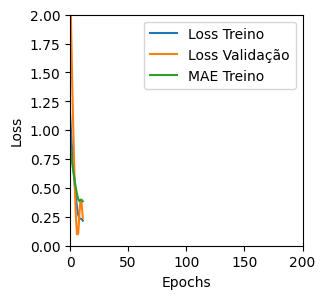

Tempo de treino: 0.09882002671559652 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27671340107917786 , MAE = 0.39795249700546265'

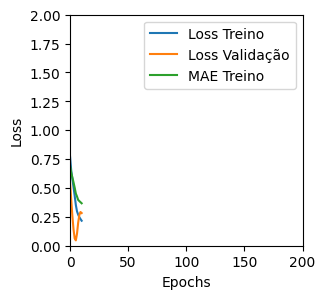

Tempo de treino: 0.09261259237925211 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


'TRAINING set. Loss = 0.605320930480957 , MAE = 0.6133564710617065'

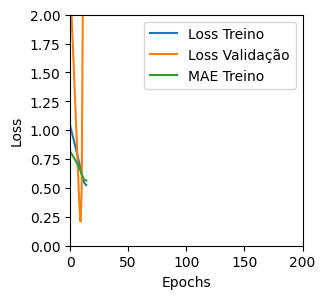

Tempo de treino: 0.11149842341740926 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3030833303928375 , MAE = 0.40487948060035706'

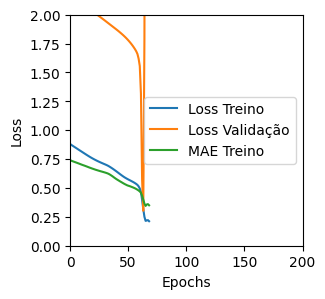

Tempo de treino: 0.21627678076426188 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4564974308013916 , MAE = 0.5166205763816833'

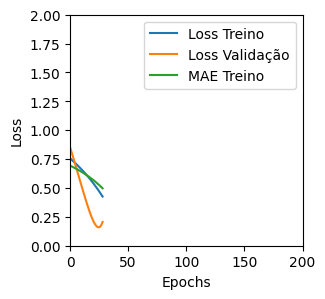

Tempo de treino: 0.09110777775446574 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24970793724060059 , MAE = 0.3636073172092438'

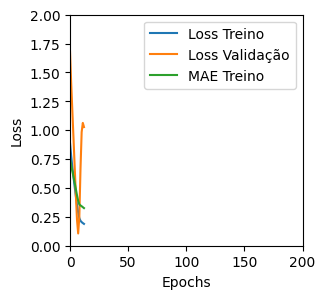

Tempo de treino: 0.12606035470962523 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6190265417098999 , MAE = 0.6079177260398865'

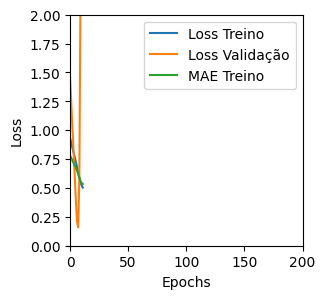

Tempo de treino: 0.08857875267664592 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4346845746040344 , MAE = 0.5062394738197327'

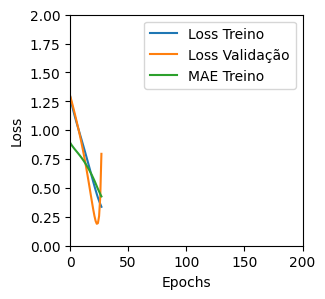

Tempo de treino: 0.09095102151234945 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24501962959766388 , MAE = 0.3683207035064697'

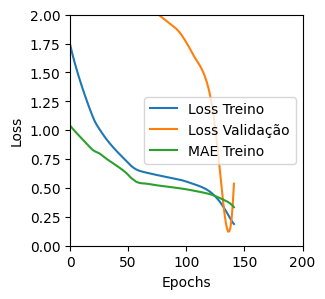

Tempo de treino: 0.21052478551864623 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2812517285346985 , MAE = 0.39416399598121643'

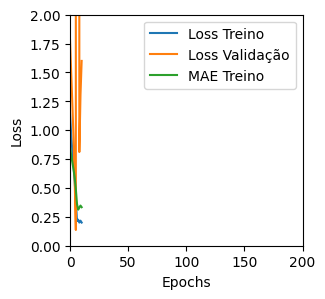

Tempo de treino: 0.16792443593343098 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31315869092941284 , MAE = 0.4010525047779083'

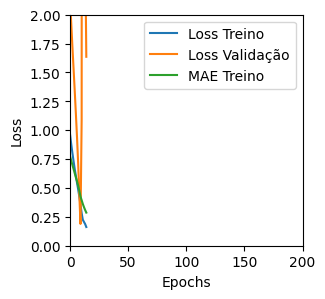

Tempo de treino: 0.1152937094370524 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6096731424331665 , MAE = 0.611869752407074'

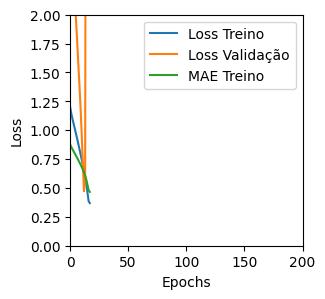

Tempo de treino: 0.08793886105219523 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6036520600318909 , MAE = 0.6094263195991516'

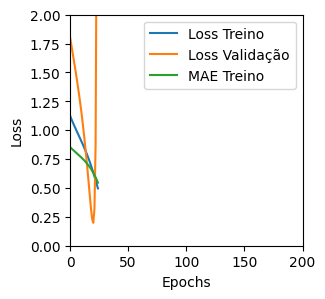

Tempo de treino: 0.09217772881189983 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22186824679374695 , MAE = 0.3270997107028961'

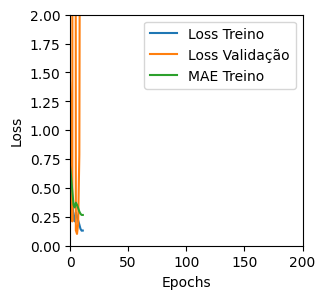

Tempo de treino: 0.12798762718836468 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3737408518791199 , MAE = 0.4657304286956787'

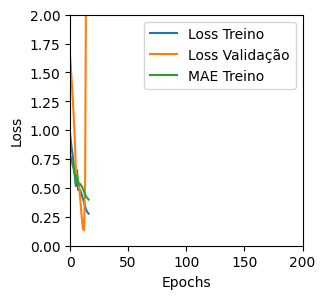

Tempo de treino: 0.1065421462059021 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40189582109451294 , MAE = 0.46166613698005676'

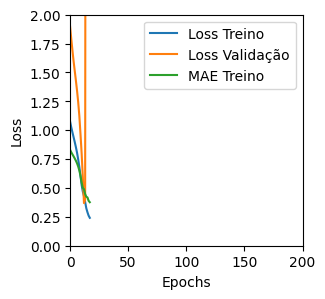

Tempo de treino: 0.08192841211954753 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4111613929271698 , MAE = 0.4743070602416992'

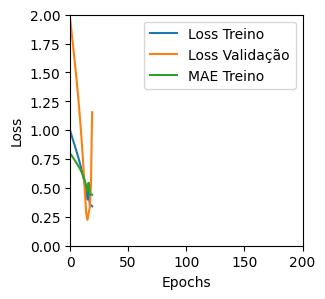

Tempo de treino: 0.09173163970311483 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38824647665023804 , MAE = 0.47923585772514343'

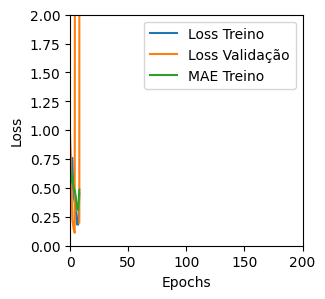

Tempo de treino: 0.15202653010686237 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29197144508361816 , MAE = 0.41390371322631836'

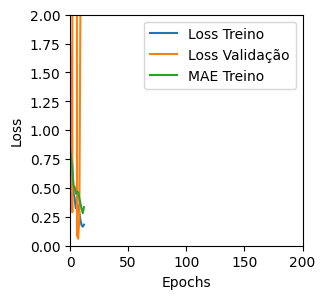

Tempo de treino: 0.1341144601504008 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4101850688457489 , MAE = 0.4761260449886322'

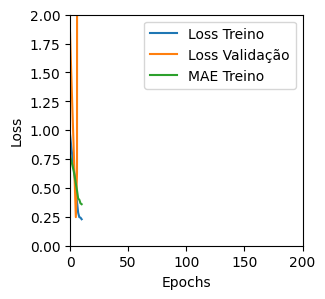

Tempo de treino: 0.08098016182581584 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.403496116399765 , MAE = 0.4925828278064728'

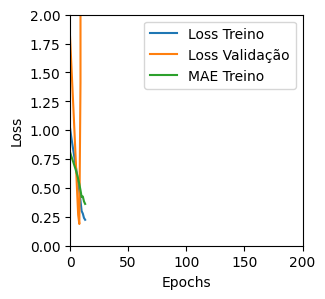

Tempo de treino: 0.08290026585261027 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14658485352993011 , MAE = 0.27299410104751587'

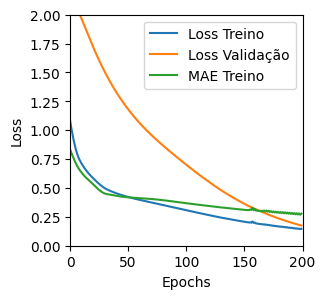

Tempo de treino: 1.4099476218223572 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5719372630119324 , MAE = 0.5485864877700806'

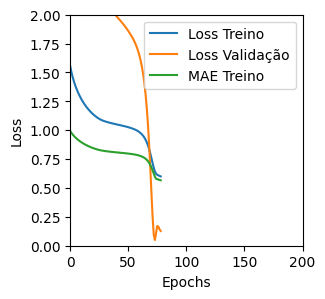

Tempo de treino: 0.38463178475697835 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5105515122413635 , MAE = 0.5276492834091187'

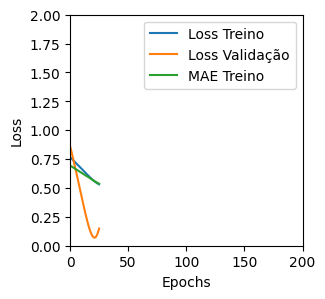

Tempo de treino: 0.12556585470835369 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5289568305015564 , MAE = 0.5029295086860657'

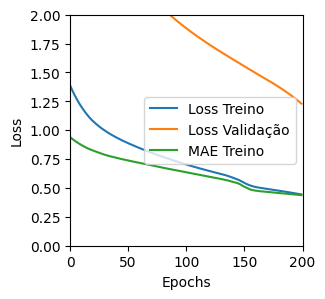

Tempo de treino: 0.3807628512382507 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3688904345035553 , MAE = 0.4356032609939575'

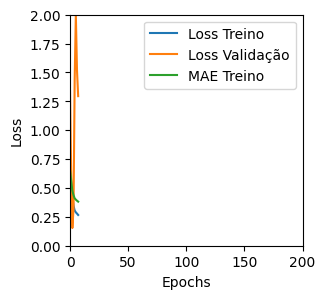

Tempo de treino: 0.14084198077519736 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3156813681125641 , MAE = 0.3965833783149719'

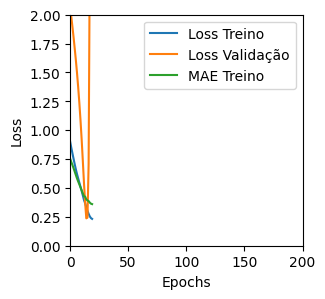

Tempo de treino: 0.125777534643809 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47968244552612305 , MAE = 0.4880867004394531'

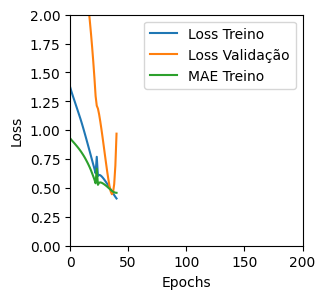

Tempo de treino: 0.12866619030634563 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.611384391784668 , MAE = 0.5566224455833435'

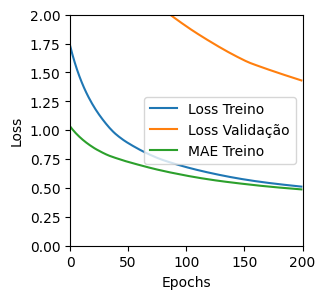

Tempo de treino: 0.38942845662434894 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7066234946250916 , MAE = 0.6636185646057129'

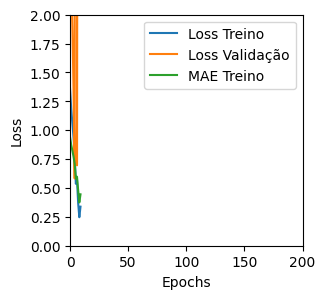

Tempo de treino: 0.10571953058242797 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44165560603141785 , MAE = 0.510601282119751'

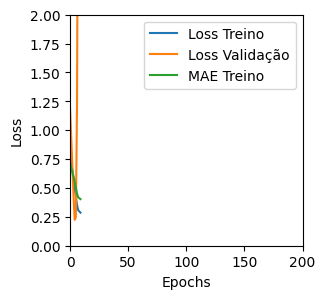

Tempo de treino: 0.0823219895362854 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3701413869857788 , MAE = 0.46313953399658203'

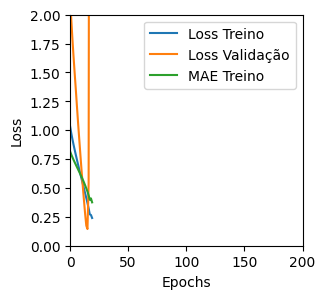

Tempo de treino: 0.08785377740859986 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3358736038208008 , MAE = 0.41799473762512207'

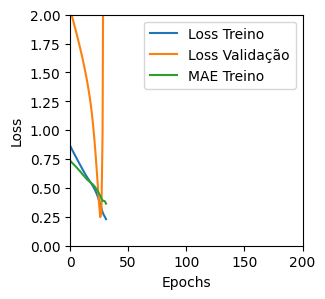

Tempo de treino: 0.12689583301544188 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5544865727424622 , MAE = 0.5754270553588867'

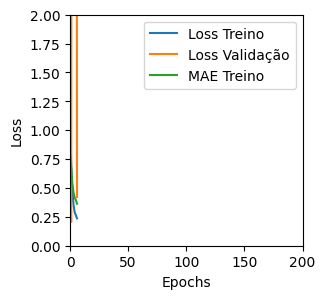

Tempo de treino: 0.1439919153849284 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4093727171421051 , MAE = 0.4821837544441223'

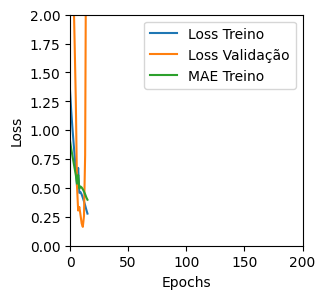

Tempo de treino: 0.11175856590270997 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5845803618431091 , MAE = 0.5919461250305176'

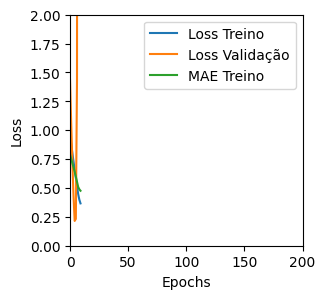

Tempo de treino: 0.08381493886311848 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2953510284423828 , MAE = 0.38592076301574707'

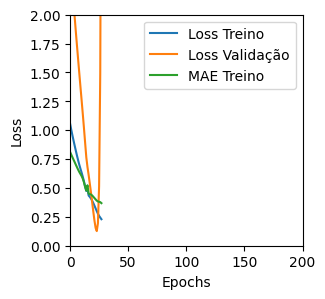

Tempo de treino: 0.09043466250101725 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16826346516609192 , MAE = 0.29384759068489075'

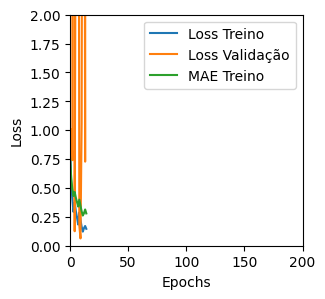

Tempo de treino: 0.13263908227284749 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2609962224960327 , MAE = 0.38599690794944763'

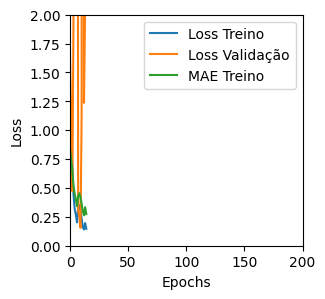

Tempo de treino: 0.13031104405721028 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3483930826187134 , MAE = 0.4454975724220276'

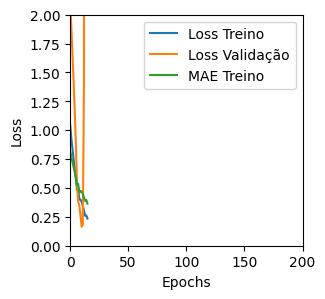

Tempo de treino: 0.11027372678120931 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4364379644393921 , MAE = 0.5011187791824341'

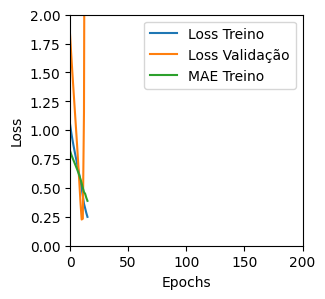

Tempo de treino: 0.08668859402338663 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3525269031524658 , MAE = 0.43498876690864563'

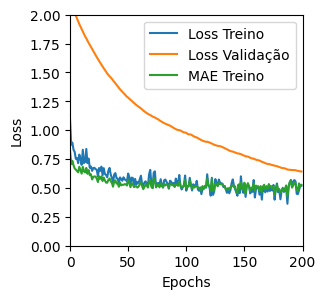

Tempo de treino: 1.1236002246538799 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5173875093460083 , MAE = 0.5393286943435669'

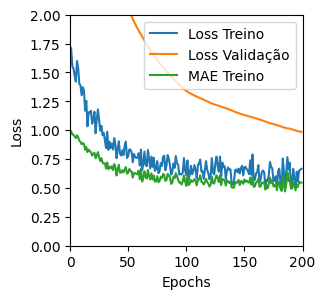

Tempo de treino: 0.6618596275647481 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4574528634548187 , MAE = 0.4877484440803528'

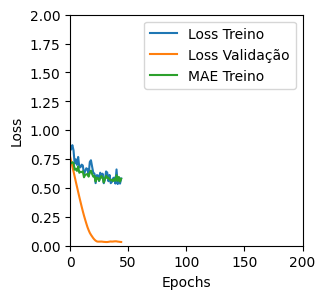

Tempo de treino: 0.2155664602915446 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4897620379924774 , MAE = 0.5382931232452393'

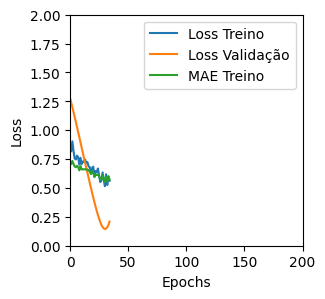

Tempo de treino: 0.09412408272425334 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3421516418457031 , MAE = 0.4229353070259094'

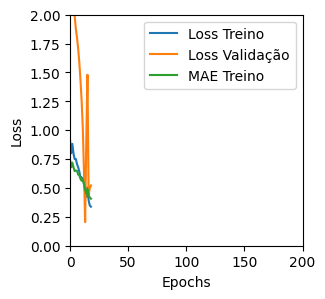

Tempo de treino: 0.20965314706166585 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2935744524002075 , MAE = 0.4059736132621765'

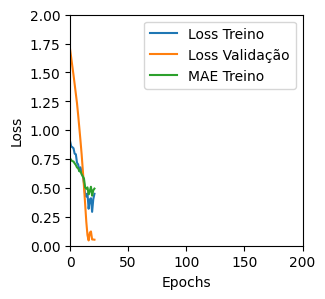

Tempo de treino: 0.1094778060913086 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3401346802711487 , MAE = 0.43335071206092834'

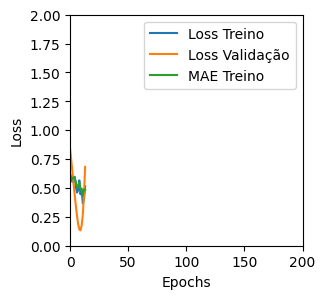

Tempo de treino: 0.13130967219670614 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5168781280517578 , MAE = 0.5426192879676819'

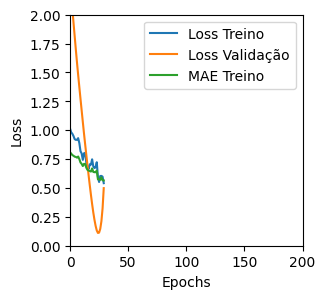

Tempo de treino: 0.14020775159200033 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23641733825206757 , MAE = 0.36357825994491577'

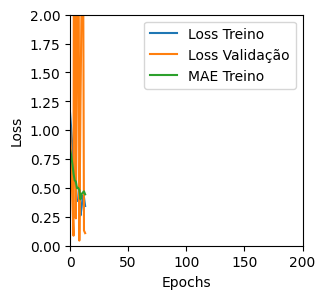

Tempo de treino: 0.1407400091489156 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4381549060344696 , MAE = 0.5174521207809448'

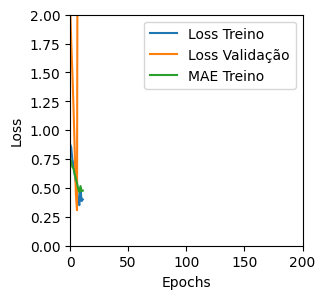

Tempo de treino: 0.0867470105489095 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43216362595558167 , MAE = 0.4931491017341614'

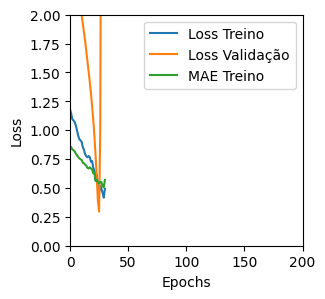

Tempo de treino: 0.1263944943745931 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3497643768787384 , MAE = 0.41374093294143677'

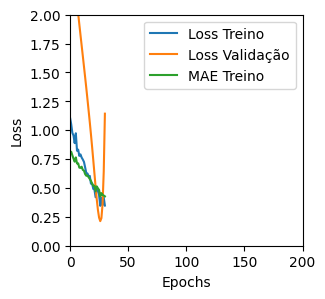

Tempo de treino: 0.08329962491989136 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34178364276885986 , MAE = 0.4314768612384796'

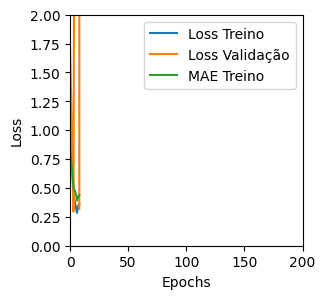

Tempo de treino: 0.10326850811640421 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3817516267299652 , MAE = 0.44620755314826965'

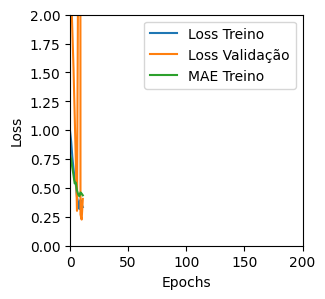

Tempo de treino: 0.08029991388320923 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


'TRAINING set. Loss = 0.37628474831581116 , MAE = 0.45601770281791687'

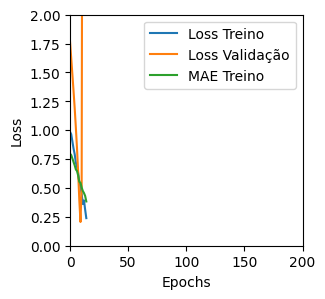

Tempo de treino: 0.10027012427647909 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41758596897125244 , MAE = 0.4906674027442932'

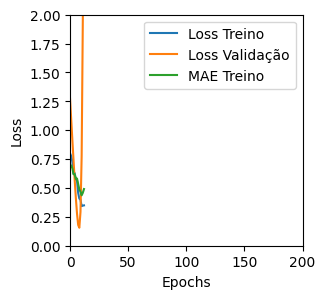

Tempo de treino: 0.07241212526957194 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11522619426250458 , MAE = 0.244949072599411'

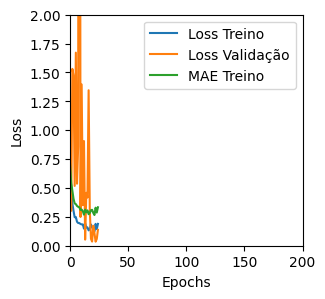

Tempo de treino: 0.38619224627812704 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5111385583877563 , MAE = 0.5499662160873413'

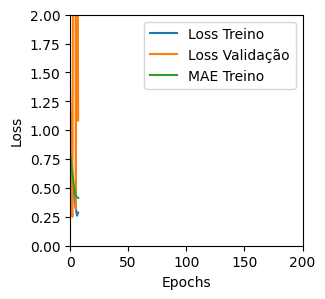

Tempo de treino: 0.08584226369857788 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4187864661216736 , MAE = 0.4934762716293335'

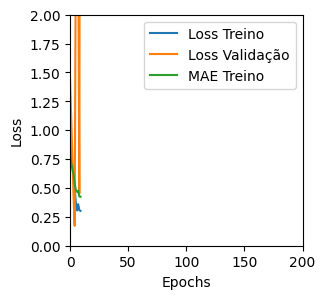

Tempo de treino: 0.08241334358851114 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31735697388648987 , MAE = 0.4059606194496155'

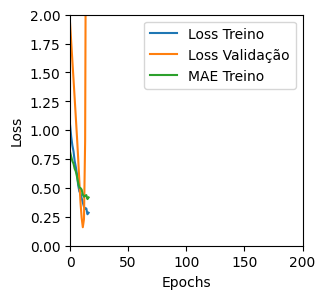

Tempo de treino: 0.08286924759546915 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10620009899139404 , MAE = 0.25699520111083984'

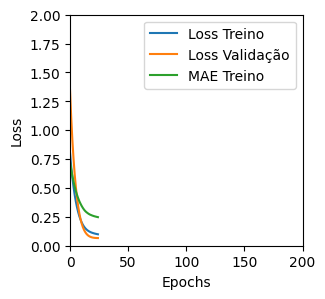

Tempo de treino: 0.2538265387217204 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06073085218667984 , MAE = 0.19068169593811035'

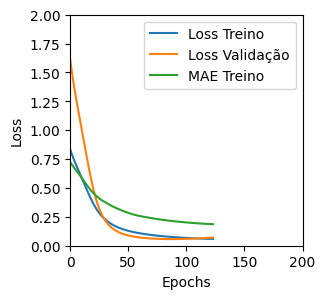

Tempo de treino: 0.5571398615837098 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051883067935705185 , MAE = 0.17816831171512604'

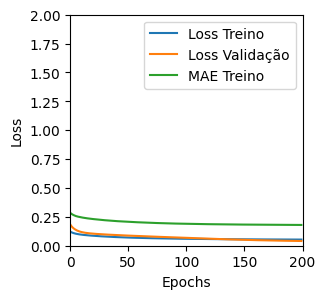

Tempo de treino: 0.7378156224886576 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08112271130084991 , MAE = 0.22012662887573242'

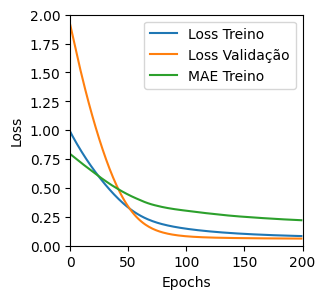

Tempo de treino: 0.3935043493906657 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14902524650096893 , MAE = 0.3003138601779938'

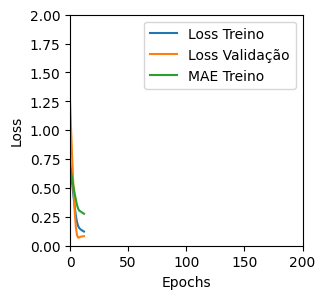

Tempo de treino: 0.1461147387822469 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14128173887729645 , MAE = 0.30692175030708313'

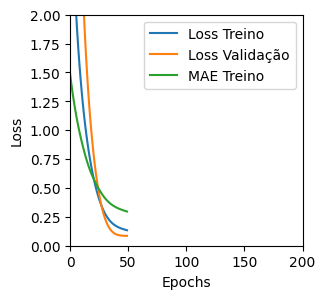

Tempo de treino: 0.4117578943570455 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15054693818092346 , MAE = 0.315269410610199'

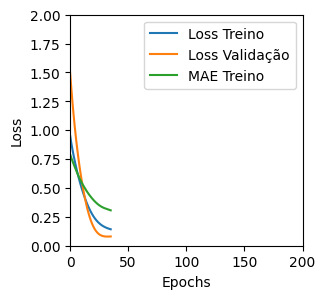

Tempo de treino: 0.22845343748728433 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13549311459064484 , MAE = 0.304989218711853'

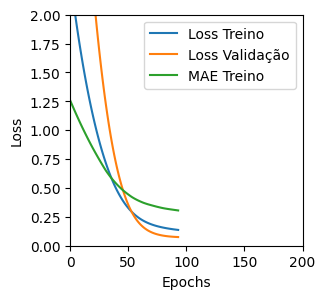

Tempo de treino: 0.22310040394465128 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19121602177619934 , MAE = 0.3401290476322174'

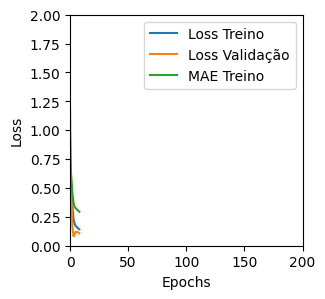

Tempo de treino: 0.13619829416275026 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14666496217250824 , MAE = 0.2940165400505066'

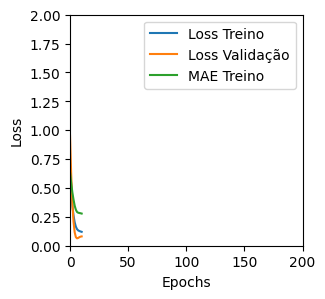

Tempo de treino: 0.13739776611328125 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16680830717086792 , MAE = 0.31633853912353516'

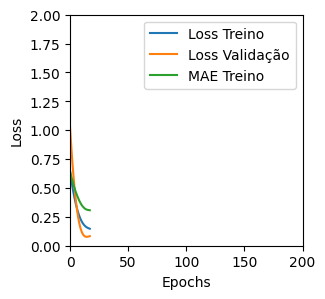

Tempo de treino: 0.13434649705886842 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22348706424236298 , MAE = 0.36871442198753357'

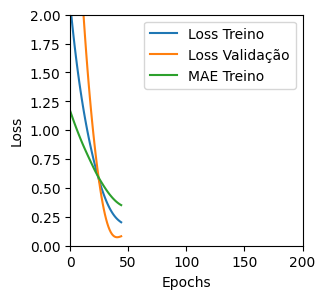

Tempo de treino: 0.1538400888442993 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17547237873077393 , MAE = 0.31815776228904724'

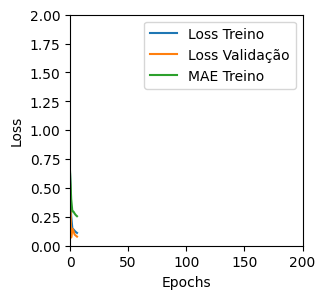

Tempo de treino: 0.12362194061279297 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04913533106446266 , MAE = 0.17333410680294037'

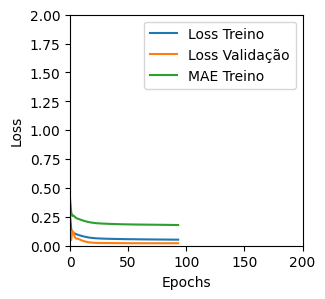

Tempo de treino: 0.4288253664970398 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21244388818740845 , MAE = 0.35241416096687317'

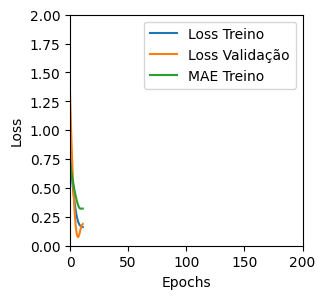

Tempo de treino: 0.09115492502848307 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16775646805763245 , MAE = 0.3118182420730591'

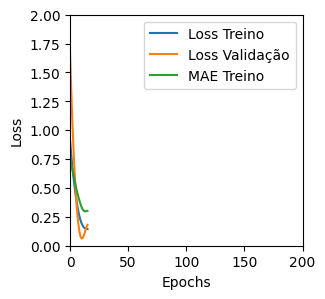

Tempo de treino: 0.11085368394851684 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05314329266548157 , MAE = 0.17790894210338593'

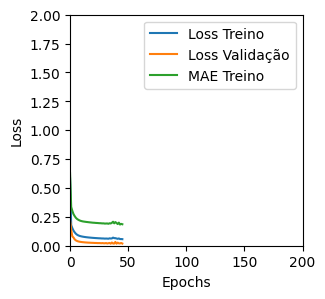

Tempo de treino: 0.43294864892959595 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048238687217235565 , MAE = 0.16893735527992249'

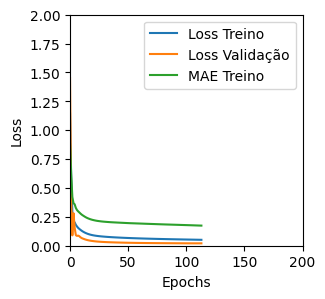

Tempo de treino: 0.5712112188339233 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2659180760383606 , MAE = 0.3923386037349701'

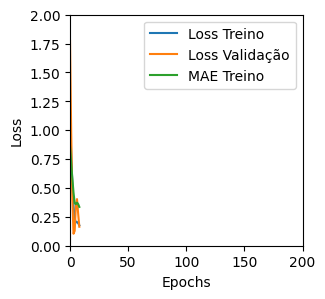

Tempo de treino: 0.13663758834203085 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23202912509441376 , MAE = 0.3668269217014313'

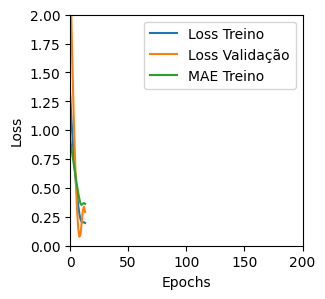

Tempo de treino: 0.0822634736696879 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


In [7]:
all_results = pd.DataFrame(columns=['model_type','model',feature,'unit','optimizer', 'batch_size', 'timesteps', 'loss','mae'])

# hyper parâmetros testados
model_hyperparams = ['LSTM_v1', 'LSTM_v2', 'LSTM_v3', 'GRU_v1']
timesteps_hyperparams = [6, 12, 24, 36]
units_hyperparams = [4, 8, 16, 32, 64]
batch_hyperparams = [4, 8, 16, 32]

epochs = 200
times_exec = 3

for times in range(times_exec):
  for timesteps in timesteps_hyperparams:
    for model_type_str in model_hyperparams:
      if model_type_str[:3] in ['LST', 'GRU']:
        scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
        print('X_train.shape, X_test.shape, y_train.shape, y_test.shape = ', X_train.shape, X_test.shape, y_train.shape, y_test.shape)
      for optimizer in ['Adam']:
        for unit in units_hyperparams:
          for batch_size in batch_hyperparams:

            inittime = time()
            print(f'Treinando com {model_type_str} , timesteps={timesteps}, units={unit}, batch={batch_size}')
            m, h = model_type(model_type_str, unit=unit, optimizer=optimizer, timesteps=timesteps, X=X_train, y=y_train, epochs=epochs, batch_size=batch_size)
            endtime = time()
            print(f'Tempo de treino: {(endtime-inittime)/60} minutos' )
            score = m.evaluate(X_test, y_test, batch_size=batch_size, verbose=0)
            all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,
                                              'optimizer':optimizer, 'batch_size':batch_size, 'timesteps':timesteps,
                                              'loss':score[0], 'mae':score[1]}, ignore_index=True)
            del m, h

### Desempenho ordenado por menor MAE na base de validação
É considerada a melhor média, em termos de MAE, das três execuções

In [8]:
print(len(all_results))
mean_mae = all_results.groupby(['model_type', 'unit', 'batch_size', 'optimizer', 'timesteps'])['mae'].mean().reset_index()
mean_mae.sort_values(by=['mae'])
print(len(mean_mae))
mean_mae

960
320


,model_type,unit,batch_size,optimizer,timesteps,mae
0,GRU_v1,4,4,Adam,6,0.148822
1,GRU_v1,4,4,Adam,12,0.168058
2,GRU_v1,4,4,Adam,24,0.140371
3,GRU_v1,4,4,Adam,36,0.331199
4,GRU_v1,4,8,Adam,6,0.195943
...,...,...,...,...,...,...
315,LSTM_v3,64,16,Adam,36,0.815329
316,LSTM_v3,64,32,Adam,6,0.503213
317,LSTM_v3,64,32,Adam,12,0.629309
318,LSTM_v3,64,32,Adam,24,0.808229


## 5) Avaliação na base de testes


Seleção dos melhores modelos de cada arquitetura


In [9]:
best_models_arr = []

for model_str in model_hyperparams:
  best_model = mean_mae[mean_mae['model_type'] == model_str].sort_values('mae', ascending=True).head(1)
  best_models_arr.append(best_model)

best_models_df = pd.concat(best_models_arr)
del best_models_arr
print("Melhores modelos")
dsp.display(best_models_df.sort_values('mae', ascending=True))



Melhores modelos


,model_type,unit,batch_size,optimizer,timesteps,mae
33,GRU_v1,16,4,Adam,12,0.130599
192,LSTM_v2,16,4,Adam,6,0.317177
86,LSTM_v1,4,8,Adam,24,0.376161
252,LSTM_v3,4,32,Adam,6,0.402491


### Avaliação últimos 12 meses - usando dados reais
Construção dos dados de predição, também usados no Boxplot e Swarmplot

Aqui treinamos novamente o modelo para aferição dos resultados anteriores e comparação com os 12 últimos meses da série

'TRAINING set. Loss = 0.2001085728406906 , MAE = 0.3282887637615204'

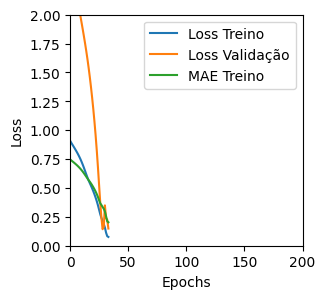

1/1 [==============================] - 0s 218ms/step


'TRAINING set. Loss = 0.21844980120658875 , MAE = 0.367267370223999'

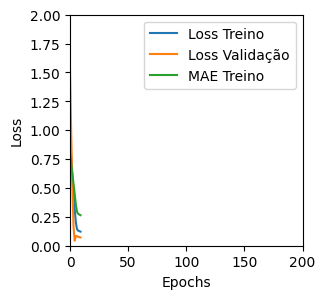

1/1 [==============================] - 0s 399ms/step


'TRAINING set. Loss = 0.2035328894853592 , MAE = 0.34906095266342163'

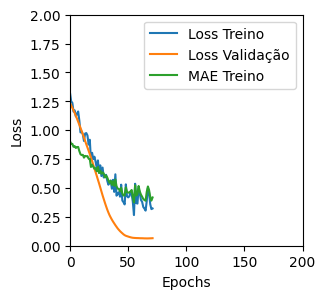

1/1 [==============================] - 0s 245ms/step


'TRAINING set. Loss = 0.04234232380986214 , MAE = 0.15700863301753998'

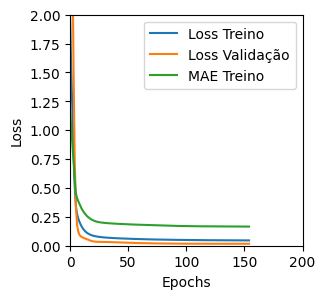

1/1 [==============================] - 0s 401ms/step
     LSTM_v1  LSTM_v1_Real   LSTM_v2  LSTM_v2_Real   LSTM_v3  LSTM_v3_Real  \
0   2.682248          2.83  2.745456          2.83  2.771448          2.83   
1   2.709800          2.85  2.787288          2.85  2.817159          2.85   
2   2.735698          2.97  2.819171          2.97  2.855411          2.97   
3   2.775526          3.01  2.864927          3.01  2.893615          3.01   
4   2.819694          3.01  2.905092          3.01  2.936855          3.01   
5   2.857895          3.18  2.943480          3.18  2.982939          3.18   
6   2.936128          3.31  3.003814          3.31  3.046322          3.31   
7   3.030879          3.29  3.080077          3.29  3.122581          3.29   
8   3.103932          3.48  3.136201          3.48  3.186278          3.48   
9   3.206303          3.58  3.207855          3.58  3.242469          3.58   
10  3.310036          3.56  3.266917          3.56  3.301442          3.56   
11  3.39198

In [10]:
aval = pd.DataFrame()

for index, setup in best_models_df.iterrows():
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], len(data_teste))
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)
  best_models_df['model'] = mod
  y_pred = mod.predict(X_test)
  y_pred = scaler.inverse_transform(y_pred)
  y_real = scaler.inverse_transform(y_test)

  aval[f'{setup["model_type"]}'] = y_pred[:,0]
  aval[f'{setup["model_type"]}_Real'] = y_real[:,0]

print(aval)

#### Boxplot e Swarmplot

In [ ]:
def box_swarm_plots(aval):
  fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
  sns.boxplot(data=aval, dodge=False, palette='Blues', ax=ax)
  sns.swarmplot(data=aval, color='.25', alpha=0.8, ax=ax)

In [ ]:
box_swarm_plots(aval)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto dos últimos 12 meses da série

In [ ]:
def plot_aval(aval):
  min_val, max_val = aval.min().min(), aval.max().max()
  fig, ax = plt.subplots(figsize=(30, 12), nrows=1, ncols=len(best_models_df))
  i = 0
  for model_str in best_models_df['model_type']:
    filt = aval.filter(regex=model_str)
    sns.lineplot(data=filt, palette='inferno', ax=ax[i], hue_order=filt.columns)
    ax[i].set_xlabel('Meses')
    ax[i].set_title(model_str)
    ax[i].set_ylim(min_val, max_val)
    i += 1


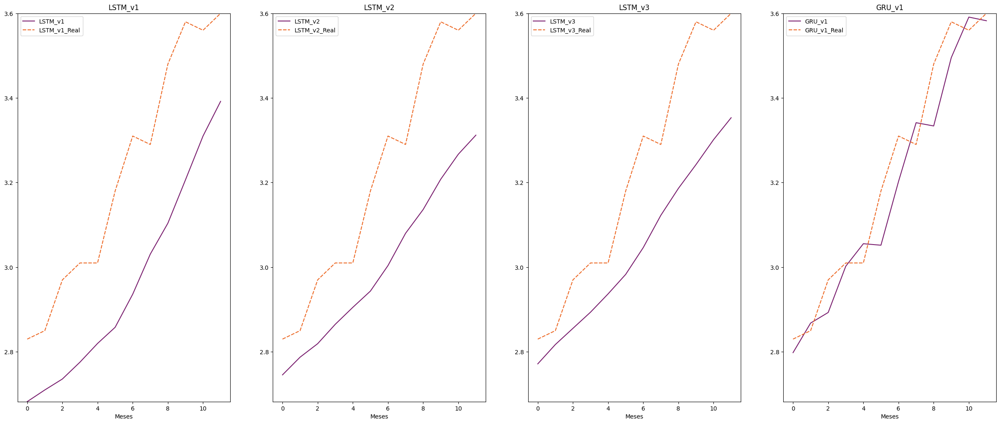

In [14]:
plot_aval(aval)

### Avaliação últimos 12 meses - usando dados previstos iterativamente
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Mas desta vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes. Este passo é necessário para identificar se o processo de prever o fututo está consistente. Ainda estamos comparando com a base de testes

Usou-se ruído nas saídas para simular curvas mais realísticas. A análise empírica deste método revelou predições superiores.

---



In [15]:
aval_pre_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', timesteps, future_size)

  initial_sequence = X_test[0]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  y_real = scaler.inverse_transform(y_test)
  aval_pre_fut[f'{setup["model_type"]}'] = y_pred[:,0]
  aval_pre_fut[f'{setup["model_type"]}_Real'] = y_real[:,0]


#### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


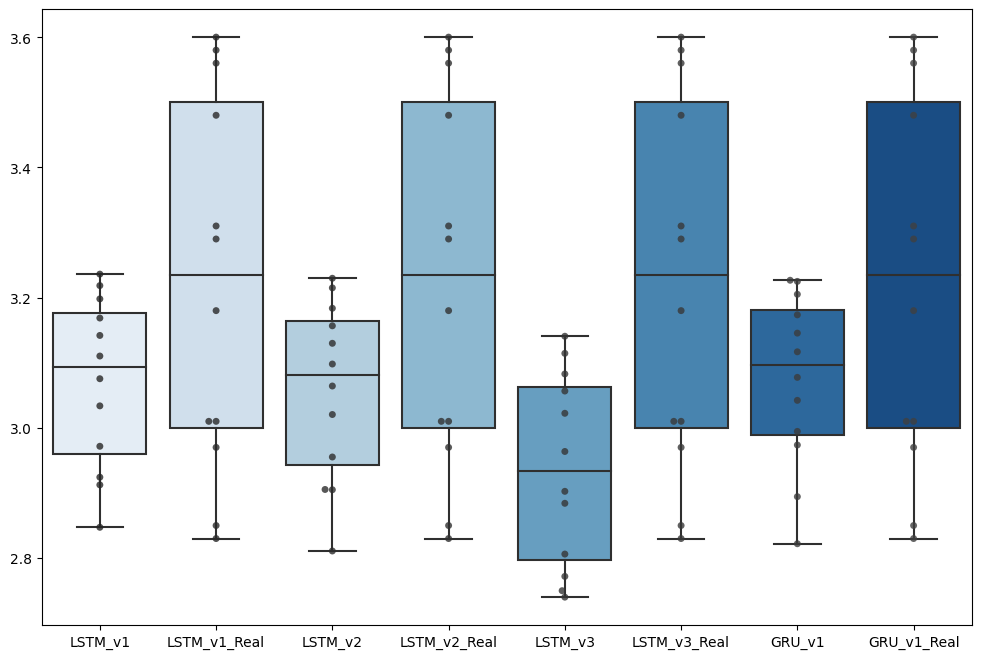

In [16]:
box_swarm_plots(aval_pre_fut)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

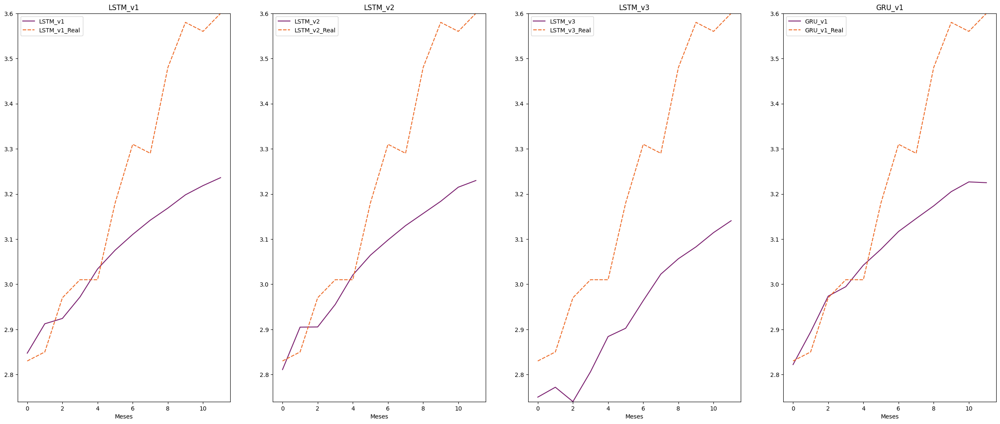

In [17]:
plot_aval(aval_pre_fut)

# Resultados

## Avaliação dos 12 meses futuros
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Desta vez, o treinamento do modelo é refeito com todos os dados. Mais uma vez, usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes.


---



Execução número 1
Treinando com LSTM_v1, unit=4, opt=Adam,       timesteps=24, batch=8


'TRAINING set. Loss = 0.489881306886673 , MAE = 0.4762953221797943'

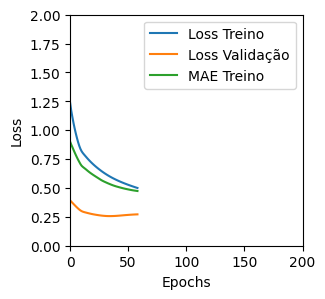

Treinando com LSTM_v2, unit=16, opt=Adam,       timesteps=6, batch=4


'TRAINING set. Loss = 0.19317908585071564 , MAE = 0.3344559967517853'

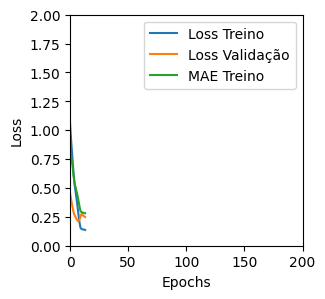

Treinando com LSTM_v3, unit=4, opt=Adam,       timesteps=6, batch=32


'TRAINING set. Loss = 0.49844542145729065 , MAE = 0.47333601117134094'

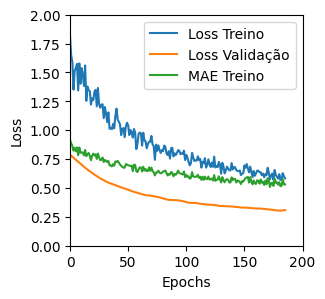

Treinando com GRU_v1, unit=16, opt=Adam,       timesteps=12, batch=4


'TRAINING set. Loss = 0.3467482328414917 , MAE = 0.4790714979171753'

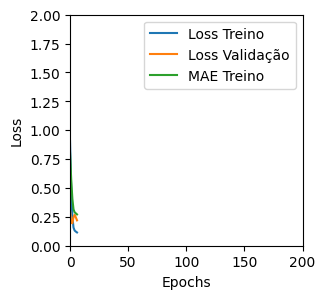

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


Execução número 1
Treinando com LSTM_v1, unit=4, opt=Adam,       timesteps=24, batch=8


'TRAINING set. Loss = 0.21123041212558746 , MAE = 0.31173089146614075'

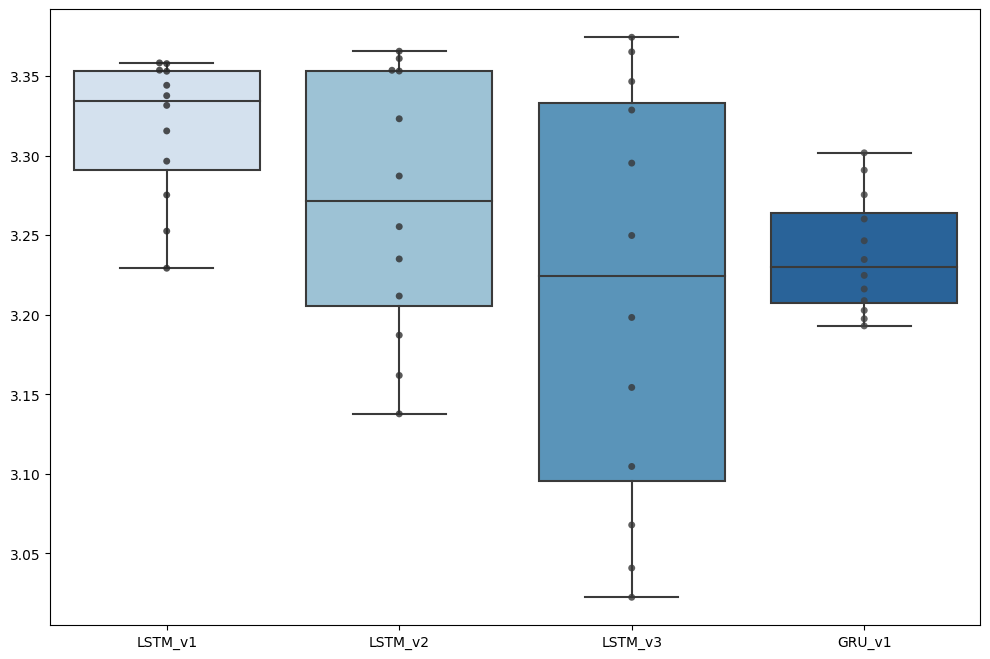

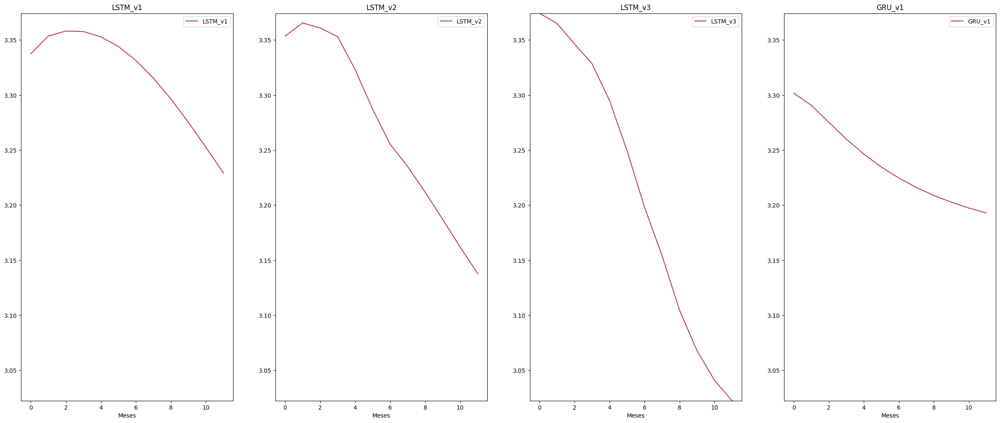

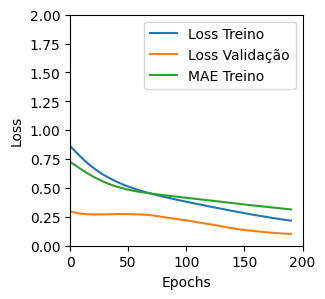

Treinando com LSTM_v2, unit=16, opt=Adam,       timesteps=6, batch=4


'TRAINING set. Loss = 0.174190953373909 , MAE = 0.31684133410453796'

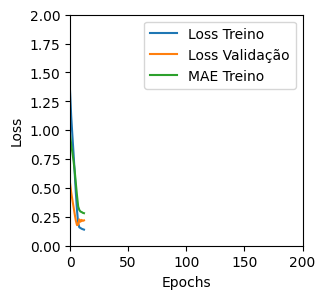

Treinando com LSTM_v3, unit=4, opt=Adam,       timesteps=6, batch=32


'TRAINING set. Loss = 0.20037154853343964 , MAE = 0.343719482421875'

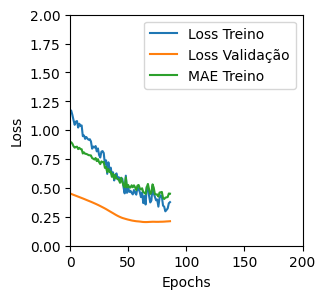

Treinando com GRU_v1, unit=16, opt=Adam,       timesteps=12, batch=4


'TRAINING set. Loss = 0.3282146453857422 , MAE = 0.46047645807266235'

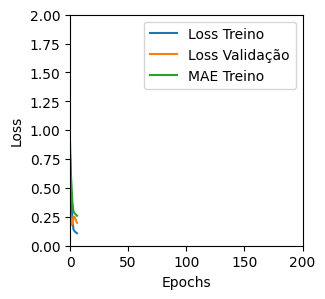

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


Execução número 1
Treinando com LSTM_v1, unit=4, opt=Adam,       timesteps=24, batch=8


'TRAINING set. Loss = 0.589023232460022 , MAE = 0.5759024024009705'

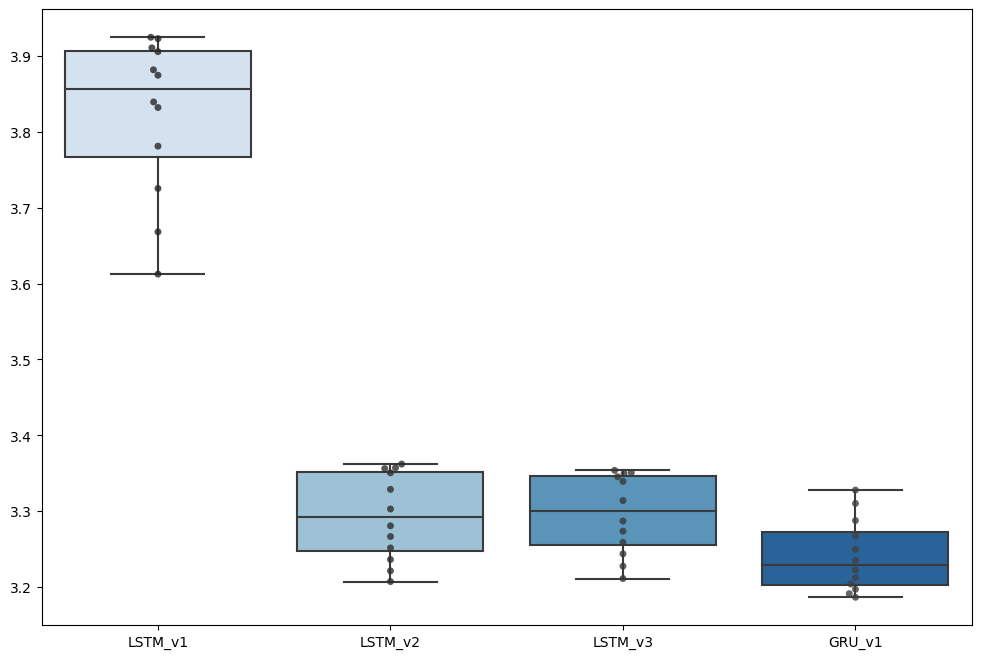

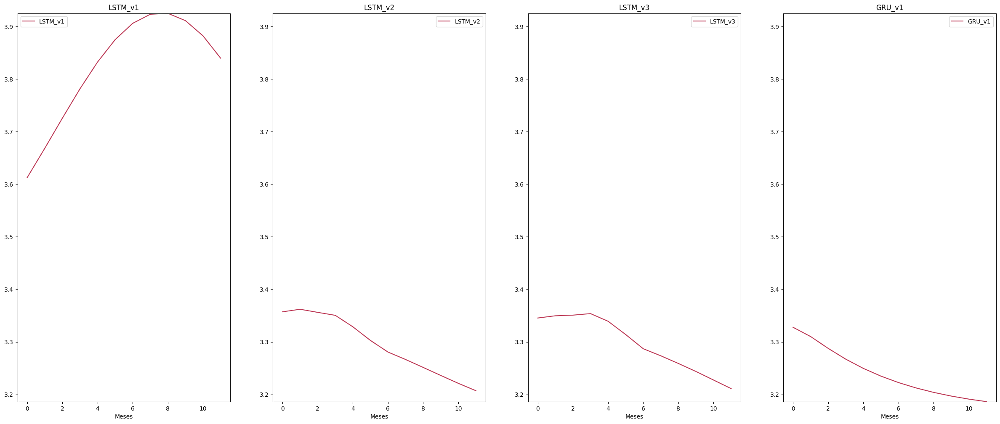

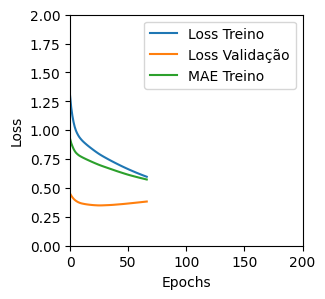

Treinando com LSTM_v2, unit=16, opt=Adam,       timesteps=6, batch=4


'TRAINING set. Loss = 0.20205453038215637 , MAE = 0.33832767605781555'

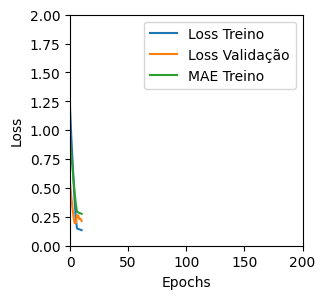

Treinando com LSTM_v3, unit=4, opt=Adam,       timesteps=6, batch=32


'TRAINING set. Loss = 0.1815660148859024 , MAE = 0.3247283101081848'

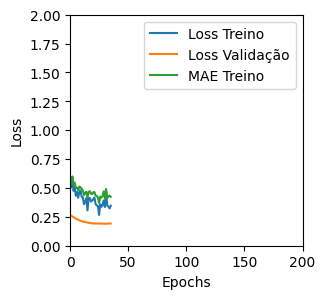

Treinando com GRU_v1, unit=16, opt=Adam,       timesteps=12, batch=4


'TRAINING set. Loss = 0.04509973153471947 , MAE = 0.16328921914100647'

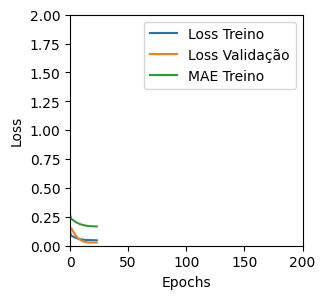

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


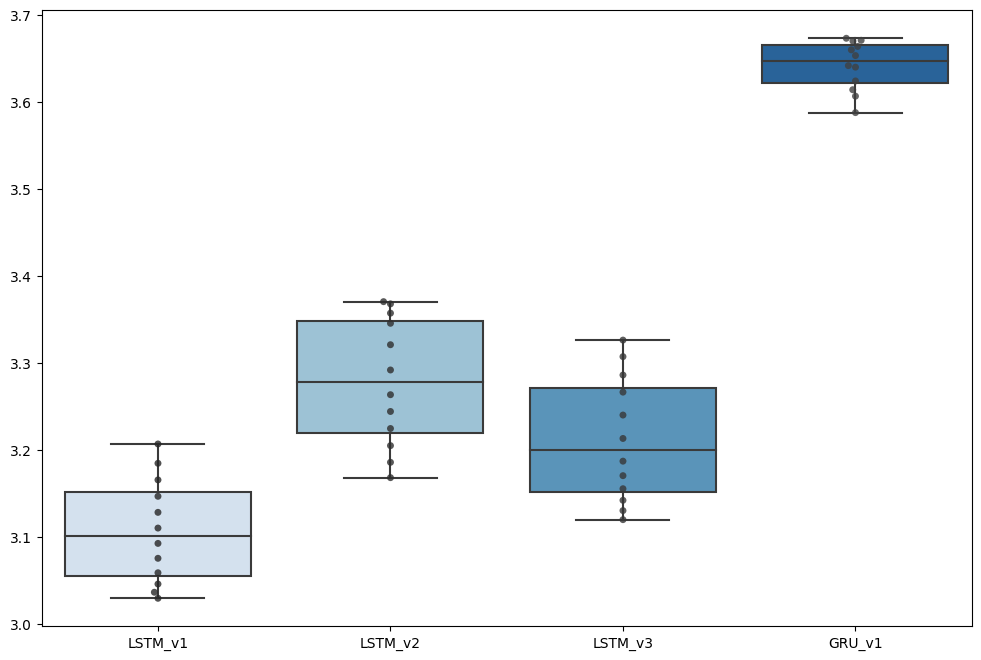

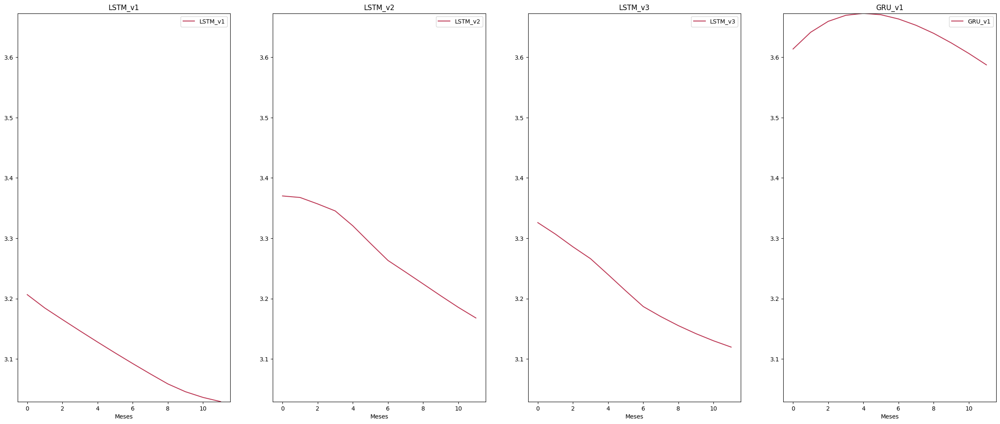

In [18]:
future_size = 12
sharpness = None

for exec_num in range(3):

  print('Execução número 1')
  aval_fut = pd.DataFrame()
  for index, setup in best_models_df.iterrows():

    mod = setup['model']
    print(f'Treinando com {setup["model_type"]}, unit={setup["unit"]}, opt={setup["optimizer"]}, \
      timesteps={setup["timesteps"]}, batch={setup["batch_size"]}')
    scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], 0)
    mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                        epochs=epochs, batch_size=setup['batch_size'], train=True)

    # using last train element
    initial_sequence = X_train[-1]

    # Predict future values iteratively
    predicted_values = []
    for _ in range(future_size):
      # Predict the next step
      next_step = mod.predict(np.array([initial_sequence]), verbose=False)
      # add randomization to model do not converge as a curve
      if sharpness is not None:
        next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
      # Append the predicted value
      predicted_values.append(next_step[0, 0])
      # Update the initial sequence by removing the oldest value and appending the predicted value
      initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
      initial_sequence[-1] = next_step[0, 0]


    y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
    aval_fut[f'{setup["model_type"]}'] = y_pred[:,0]

  box_swarm_plots(aval_fut)
  plot_aval(aval_fut)


# Conclusão

O trabalho estudou a tendência de inadimplência de crédito de uma série temporal curta, de 149 pontos, entre 2011 e 2023.

Foram utilizadas quatro arquiteturas de RNNs e uma busca dos melhores hiperparâmetros foi feita para cada uma destas. A escolha foi baseada na média do MAE em três treinamentos deste notebook. As GRUs apresentaram um melhor MAE na base de testes e as outras arquiteturas LSTMs oscilaram nas próximas colocações (verificado em três execuções deste notebook).

O melhor batch size encontrado foi de tamanho quatro. A quantidade de neurônios e timesteps dos primeiros colocados variaram nas três execuções deste notebook.

Ao final do notebook, foram executados três treinamentos com avaliações da predição futura dos próximos 12 meses. Em geral, em cada execução, a predição de um dos modelo se distanciou da predição dos outros três, independentemente da arquitetura, o que é explicados pela aleatoriedade dos valores iniciais. Os modelos com predições semelhantes apontam para uma tendência leve de queda de sua série, com final previsto para um valor aproximado de 3,2.

Nesta série, foram encontradas duas aparentes sazonalidades de 4 anos, entre 2011 e 2015 e entre 2015 e 2019, que podem indicar as tendências futuras da série. A tendência de queda verificada na predição dos últimos 12 meses provavelmente foi guiada pela queda que ocorre ocorre após uma alta de aproximados 1.25 pontos percentuais entre 2015 e 2017 (pouco mais de 2 anos), pois verifica-se esse mesmo padrão ao final da série, ou seja, uma alta e tamanho de série semelhante ao final da série.

Esta análise foi baseada somente em dados históricos desta série. Em trabalhos futuros, deseja-se introduzir outras séries de fatores que podem influenciar sua predição, como taxa de câmbio, de juros, dentre outros, para um posicionamento mais bem fundamentado sobre a tendência da série de inadimplência.





# REFERÊNCIAS

[1] -  https://repositorio.utfpr.edu.br/jspui/bitstream/1/19605/1/CT_GESFIN_I_2016_07.pdf

[2] - https://repositorio.ufscar.br/bitstream/handle/ufscar/13730/Trabalho_de_Conclusao_de_Curso_Lucas_Vasco.pdf?sequence=2&isAllowed=y

[3] - https://towardsdatascience.com/lstm-framework-for-univariate-time-series-prediction-d9e7252699e

[4] - https://www.datarobot.com/blog/how-much-data-is-needed-to-train-a-good-model/#:~:text=the%20time%20series.-,For%20most%20time%20series%20applications%2C%20this%20means%20that%20the%20submitted,of%20the%20maximum%20expected%20seasonality.&text=For%20example%2C%20if%20you%20have,to%20train%20a%20successful%20model.
